In [ ]:
!pip install visualization


In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import visualizer 
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import StandardScaler
from lightgbm import LGBMClassifier
from xgboost import XGBClassifier
from sklearn.ensemble import RandomForestClassifier, AdaBoostClassifier, ExtraTreesClassifier, BaggingClassifier, StackingClassifier, GradientBoostingClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.neural_network import MLPClassifier
from sklearn.naive_bayes import BernoulliNB, GaussianNB
from sklearn.svm import SVC
from sklearn.model_selection import GridSearchCV, RandomizedSearchCV, cross_val_score
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix, roc_curve, roc_auc_score, recall_score, precision_score, f1_score
import warnings
from sklearn.calibration import calibration_curve, CalibratedClassifierCV
warnings.filterwarnings("ignore")

In [ ]:
pd.set_option('display.max_columns', None)
data = pd.read_csv('../220326COVID19MEXICO.csv')

In [ ]:
data.head(5)

,FECHA_ACTUALIZACION,ID_REGISTRO,ORIGEN,SECTOR,ENTIDAD_UM,SEXO,ENTIDAD_NAC,ENTIDAD_RES,MUNICIPIO_RES,TIPO_PACIENTE,FECHA_INGRESO,FECHA_SINTOMAS,FECHA_DEF,INTUBADO,NEUMONIA,EDAD,NACIONALIDAD,EMBARAZO,HABLA_LENGUA_INDIG,INDIGENA,DIABETES,EPOC,ASMA,INMUSUPR,HIPERTENSION,OTRA_COM,CARDIOVASCULAR,OBESIDAD,RENAL_CRONICA,TABAQUISMO,OTRO_CASO,TOMA_MUESTRA_LAB,RESULTADO_LAB,TOMA_MUESTRA_ANTIGENO,RESULTADO_ANTIGENO,CLASIFICACION_FINAL,MIGRANTE,PAIS_NACIONALIDAD,PAIS_ORIGEN,UCI
0,2022-03-26,z3bf80,2,12,8,2,8,8,37,1,2020-07-28,2020-07-20,9999-99-99,97,2,35,1,97,2,2,2,2,2,2,2,2,2,2,2,2,2,1,1,2,97,3,99,México,97,97
1,2022-03-26,z1e370,1,12,14,1,14,14,85,1,2020-04-22,2020-04-18,9999-99-99,97,2,42,1,2,2,2,2,2,1,2,2,2,2,2,2,2,2,1,2,2,97,7,99,México,97,97
2,2022-03-26,zze974,1,6,24,1,24,24,35,1,2021-02-28,2021-02-20,9999-99-99,97,99,34,1,2,2,2,2,2,2,2,2,2,2,2,2,2,1,1,2,2,97,7,99,México,97,97
3,2022-03-26,zz7067,1,12,9,2,9,9,7,1,2020-08-18,2020-08-17,9999-99-99,97,2,51,1,97,2,2,2,2,2,2,1,2,2,2,2,2,2,1,2,2,97,7,99,México,97,97
4,2022-03-26,z1da1e,1,12,1,2,1,1,1,1,2020-03-09,2020-03-05,9999-99-99,97,99,30,1,97,1,2,2,2,2,2,2,2,2,2,2,2,1,1,2,2,97,7,99,México,97,97


In [ ]:
data.describe()

,ORIGEN,SECTOR,ENTIDAD_UM,SEXO,ENTIDAD_NAC,ENTIDAD_RES,MUNICIPIO_RES,TIPO_PACIENTE,INTUBADO,NEUMONIA,EDAD,NACIONALIDAD,EMBARAZO,HABLA_LENGUA_INDIG,INDIGENA,DIABETES,EPOC,ASMA,INMUSUPR,HIPERTENSION,OTRA_COM,CARDIOVASCULAR,OBESIDAD,RENAL_CRONICA,TABAQUISMO,OTRO_CASO,TOMA_MUESTRA_LAB,RESULTADO_LAB,TOMA_MUESTRA_ANTIGENO,RESULTADO_ANTIGENO,CLASIFICACION_FINAL,MIGRANTE,UCI
count,1.551939e+07,1.551939e+07,1.551939e+07,1.551939e+07,1.551939e+07,1.551939e+07,1.551939e+07,1.551939e+07,1.551939e+07,1.551939e+07,1.551939e+07,1.551939e+07,1.551939e+07,1.551939e+07,1.551939e+07,1.551939e+07,1.551939e+07,1.551939e+07,1.551939e+07,1.551939e+07,1.551939e+07,1.551939e+07,1.551939e+07,1.551939e+07,1.551939e+07,1.551939e+07,1.551939e+07,1.551939e+07,1.551939e+07,1.551939e+07,1.551939e+07,1.551939e+07,1.551939e+07
mean,1.764535e+00,8.838596e+00,1.419242e+01,1.467372e+00,1.542736e+01,1.448029e+01,3.599058e+01,1.077169e+00,8.974827e+01,2.923963e+00,3.857673e+01,1.006698e+00,4.675139e+01,8.669095e+00,8.575800e+00,2.362400e+00,2.419296e+00,2.403320e+00,2.421327e+00,2.320890e+00,3.399993e+00,2.415856e+00,2.327361e+00,2.414408e+00,2.368416e+00,5.110999e+00,1.638377e+00,6.253431e+01,1.346491e+00,3.471095e+01,5.453291e+00,9.840715e+01,8.975073e+01
std,4.242888e-01,3.817907e+00,7.766002e+00,4.989343e-01,1.032516e+01,7.696309e+00,8.241039e+01,2.668596e-01,2.524306e+01,9.671052e+00,1.706855e+01,8.156759e-02,4.743435e+01,2.455567e+01,2.440092e+01,6.499365e+00,6.383159e+00,6.366807e+00,6.391415e+00,6.407150e+00,1.156564e+01,6.382056e+00,6.316998e+00,6.368664e+00,6.436917e+00,1.804886e+01,4.804703e-01,4.579486e+01,4.758518e-01,4.535723e+01,1.972920e+00,7.568233e+00,2.523501e+01
min,1.000000e+00,1.000000e+00,1.000000e+00,1.000000e+00,1.000000e+00,1.000000e+00,1.000000e+00,1.000000e+00,1.000000e+00,1.000000e+00,0.000000e+00,1.000000e+00,1.000000e+00,1.000000e+00,1.000000e+00,1.000000e+00,1.000000e+00,1.000000e+00,1.000000e+00,1.000000e+00,1.000000e+00,1.000000e+00,1.000000e+00,1.000000e+00,1.000000e+00,1.000000e+00,1.000000e+00,1.000000e+00,1.000000e+00,1.000000e+00,1.000000e+00,1.000000e+00,1.000000e+00
25%,2.000000e+00,4.000000e+00,9.000000e+00,1.000000e+00,9.000000e+00,9.000000e+00,7.000000e+00,1.000000e+00,9.700000e+01,2.000000e+00,2.600000e+01,1.000000e+00,2.000000e+00,2.000000e+00,2.000000e+00,2.000000e+00,2.000000e+00,2.000000e+00,2.000000e+00,2.000000e+00,2.000000e+00,2.000000e+00,2.000000e+00,2.000000e+00,2.000000e+00,1.000000e+00,1.000000e+00,2.000000e+00,1.000000e+00,2.000000e+00,3.000000e+00,9.900000e+01,9.700000e+01
50%,2.000000e+00,1.200000e+01,1.100000e+01,1.000000e+00,1.400000e+01,1.200000e+01,1.500000e+01,1.000000e+00,9.700000e+01,2.000000e+00,3.700000e+01,1.000000e+00,2.000000e+00,2.000000e+00,2.000000e+00,2.000000e+00,2.000000e+00,2.000000e+00,2.000000e+00,2.000000e+00,2.000000e+00,2.000000e+00,2.000000e+00,2.000000e+00,2.000000e+00,2.000000e+00,2.000000e+00,9.700000e+01,1.000000e+00,2.000000e+00,7.000000e+00,9.900000e+01,9.700000e+01
75%,2.000000e+00,1.200000e+01,2.000000e+01,2.000000e+00,2.100000e+01,2.000000e+01,3.900000e+01,1.000000e+00,9.700000e+01,2.000000e+00,5.000000e+01,1.000000e+00,9.700000e+01,2.000000e+00,2.000000e+00,2.000000e+00,2.000000e+00,2.000000e+00,2.000000e+00,2.000000e+00,2.000000e+00,2.000000e+00,2.000000e+00,2.000000e+00,2.000000e+00,2.000000e+00,2.000000e+00,9.700000e+01,2.000000e+00,9.700000e+01,7.000000e+00,9.900000e+01,9.700000e+01
max,2.000000e+00,9.900000e+01,3.200000e+01,2.000000e+00,9.900000e+01,3.200000e+01,9.990000e+02,2.000000e+00,9.900000e+01,9.900000e+01,2.660000e+02,2.000000e+00,9.900000e+01,9.900000e+01,9.900000e+01,9.800000e+01,9.800000e+01,9.800000e+01,9.800000e+01,9.800000e+01,9.800000e+01,9.800000e+01,9.800000e+01,9.800000e+01,9.800000e+01,9.900000e+01,2.000000e+00,9.700000e+01,2.000000e+00,9.700000e+01,7.000000e+00,9.900000e+01,9.900000e+01


In [ ]:
# Make a copy of the data frame so that we don't override the original dataframe
df = data.copy()

In [ ]:
# Take a glance at the variables
df.keys()

Index(['FECHA_ACTUALIZACION', 'ID_REGISTRO', 'ORIGEN', 'SECTOR', 'ENTIDAD_UM',
       'SEXO', 'ENTIDAD_NAC', 'ENTIDAD_RES', 'MUNICIPIO_RES', 'TIPO_PACIENTE',
       'FECHA_INGRESO', 'FECHA_SINTOMAS', 'FECHA_DEF', 'INTUBADO', 'NEUMONIA',
       'EDAD', 'NACIONALIDAD', 'EMBARAZO', 'HABLA_LENGUA_INDIG', 'INDIGENA',
       'DIABETES', 'EPOC', 'ASMA', 'INMUSUPR', 'HIPERTENSION', 'OTRA_COM',
       'CARDIOVASCULAR', 'OBESIDAD', 'RENAL_CRONICA', 'TABAQUISMO',
       'OTRO_CASO', 'TOMA_MUESTRA_LAB', 'RESULTADO_LAB',
       'TOMA_MUESTRA_ANTIGENO', 'RESULTADO_ANTIGENO', 'CLASIFICACION_FINAL',
       'MIGRANTE', 'PAIS_NACIONALIDAD', 'PAIS_ORIGEN', 'UCI'],
      dtype='object')

In [ ]:
df_sample=data.head()
df_sample

,FECHA_ACTUALIZACION,ID_REGISTRO,ORIGEN,SECTOR,ENTIDAD_UM,SEXO,ENTIDAD_NAC,ENTIDAD_RES,MUNICIPIO_RES,TIPO_PACIENTE,FECHA_INGRESO,FECHA_SINTOMAS,FECHA_DEF,INTUBADO,NEUMONIA,EDAD,NACIONALIDAD,EMBARAZO,HABLA_LENGUA_INDIG,INDIGENA,DIABETES,EPOC,ASMA,INMUSUPR,HIPERTENSION,OTRA_COM,CARDIOVASCULAR,OBESIDAD,RENAL_CRONICA,TABAQUISMO,OTRO_CASO,TOMA_MUESTRA_LAB,RESULTADO_LAB,TOMA_MUESTRA_ANTIGENO,RESULTADO_ANTIGENO,CLASIFICACION_FINAL,MIGRANTE,PAIS_NACIONALIDAD,PAIS_ORIGEN,UCI
0,2022-03-26,z3bf80,2,12,8,2,8,8,37,1,2020-07-28,2020-07-20,9999-99-99,97,2,35,1,97,2,2,2,2,2,2,2,2,2,2,2,2,2,1,1,2,97,3,99,México,97,97
1,2022-03-26,z1e370,1,12,14,1,14,14,85,1,2020-04-22,2020-04-18,9999-99-99,97,2,42,1,2,2,2,2,2,1,2,2,2,2,2,2,2,2,1,2,2,97,7,99,México,97,97
2,2022-03-26,zze974,1,6,24,1,24,24,35,1,2021-02-28,2021-02-20,9999-99-99,97,99,34,1,2,2,2,2,2,2,2,2,2,2,2,2,2,1,1,2,2,97,7,99,México,97,97
3,2022-03-26,zz7067,1,12,9,2,9,9,7,1,2020-08-18,2020-08-17,9999-99-99,97,2,51,1,97,2,2,2,2,2,2,1,2,2,2,2,2,2,1,2,2,97,7,99,México,97,97
4,2022-03-26,z1da1e,1,12,1,2,1,1,1,1,2020-03-09,2020-03-05,9999-99-99,97,99,30,1,97,1,2,2,2,2,2,2,2,2,2,2,2,1,1,2,2,97,7,99,México,97,97


In [ ]:

df.dtypes

In [ ]:
df.apply(pd.value_counts)

In [ ]:
df1=df
df1.columns=[
    "DATE UPDATE","RECORD_ID","ORIGIN","SECTOR","ENTITY_UM",
    "SEX","ENTITY_NAC","ENTITY_RES","MUNICIPALITY_RES","PATIENT_TYPE",
    "ADMISSION DATE","DATE_SYMPTOMS","DATE_DEF","INTUBATED","PNEUMONIA",
    "AGE","NATIONALITY","PREGNANCY","INDIG_LANGUAGE_SPEAK","INDIGENOUS",
    "DIABETES","COPD","ASTHMA","INMUSUPR","HYPERTENSION","OTHER_COM",
    "CARDIOVASCULAR","OBESITY","RENAL_CHRONIC","SMOKING","ANOTHER CASE",
    "TAKE_LAB_SAMPLE","LAB_RESULT","TAKE_SAMPLE_ANTIGEN",
    "RESULT_ANTIGEN","CLASSIFICATION_FINAL","MIGRANT",
    "COUNTRY_NATIONALITY","COUNTRY OF ORIGIN","ICU"]
df1.head()

,DATE UPDATE,RECORD_ID,ORIGIN,SECTOR,ENTITY_UM,SEX,ENTITY_NAC,ENTITY_RES,MUNICIPALITY_RES,PATIENT_TYPE,ADMISSION DATE,DATE_SYMPTOMS,DATE_DEF,INTUBATED,PNEUMONIA,AGE,NATIONALITY,PREGNANCY,INDIG_LANGUAGE_SPEAK,INDIGENOUS,DIABETES,COPD,ASTHMA,INMUSUPR,HYPERTENSION,OTHER_COM,CARDIOVASCULAR,OBESITY,RENAL_CHRONIC,SMOKING,ANOTHER CASE,TAKE_LAB_SAMPLE,LAB_RESULT,TAKE_SAMPLE_ANTIGEN,RESULT_ANTIGEN,CLASSIFICATION_FINAL,MIGRANT,COUNTRY_NATIONALITY,COUNTRY OF ORIGIN,ICU
0,2022-03-26,z3bf80,2,12,8,2,8,8,37,1,2020-07-28,2020-07-20,9999-99-99,97,2,35,1,97,2,2,2,2,2,2,2,2,2,2,2,2,2,1,1,2,97,3,99,México,97,97
1,2022-03-26,z1e370,1,12,14,1,14,14,85,1,2020-04-22,2020-04-18,9999-99-99,97,2,42,1,2,2,2,2,2,1,2,2,2,2,2,2,2,2,1,2,2,97,7,99,México,97,97
2,2022-03-26,zze974,1,6,24,1,24,24,35,1,2021-02-28,2021-02-20,9999-99-99,97,99,34,1,2,2,2,2,2,2,2,2,2,2,2,2,2,1,1,2,2,97,7,99,México,97,97
3,2022-03-26,zz7067,1,12,9,2,9,9,7,1,2020-08-18,2020-08-17,9999-99-99,97,2,51,1,97,2,2,2,2,2,2,1,2,2,2,2,2,2,1,2,2,97,7,99,México,97,97
4,2022-03-26,z1da1e,1,12,1,2,1,1,1,1,2020-03-09,2020-03-05,9999-99-99,97,99,30,1,97,1,2,2,2,2,2,2,2,2,2,2,2,1,1,2,2,97,7,99,México,97,97


In [ ]:
# Exclude features as described above
# df = df[df.columns[~df.columns.isin(
#     ['id', 'ID_REGISTRO',
#      'FECHA_ARCHIVO', 'FECHA_ACTUALIZACION', 'FECHA_DEF', 'FECHA_INGRESO','FECHA_SINTOMAS',
#      'ABR_ENT', 'ENTIDAD', 'MIGRANTE', 'NACIONALIDAD', 'ORIGEN', 'PAIS_NACIONALIDAD', 'PAIS_ORIGEN',
#      'INTUBADO', 'UCI'] # remove features that are only available while hospitalized
# )]]
columns_keep = ["SEX","AGE","PNEUMONIA","PREGNANCY","DIABETES","COPD",
                "ASTHMA","INMUSUPR","HYPERTENSION","OTHER_COM",
                "CARDIOVASCULAR","OBESITY","RENAL_CHRONIC","SMOKING",
                "ANOTHER CASE",
                "CLASSIFICATION_FINAL"]
df2=df1[columns_keep]
df2.head()

,SEX,AGE,PNEUMONIA,PREGNANCY,DIABETES,COPD,ASTHMA,INMUSUPR,HYPERTENSION,OTHER_COM,CARDIOVASCULAR,OBESITY,RENAL_CHRONIC,SMOKING,ANOTHER CASE,CLASSIFICATION_FINAL
0,2,35,2,97,2,2,2,2,2,2,2,2,2,2,2,3
1,1,42,2,2,2,2,1,2,2,2,2,2,2,2,2,7
2,1,34,99,2,2,2,2,2,2,2,2,2,2,2,1,7
3,2,51,2,97,2,2,2,2,1,2,2,2,2,2,2,7
4,2,30,99,97,2,2,2,2,2,2,2,2,2,2,1,7


In [ ]:
df2.shape

(15519390, 16)

In [ ]:
df2['SEX'].value_counts()

1    8266059
2    7253331
Name: SEX, dtype: int64

In [ ]:
df2['PREGNANCY'].value_counts()

2     8052345
97    7253331
1      155348
98      58356
99         10
Name: PREGNANCY, dtype: int64

In [ ]:
df3=df2
for column in df3.columns:
    
    df3 = df3.drop(df3[df3[column]==98].index, axis=0)
    df3 = df3.drop(df3[df3[column]==99].index, axis=0) 


In [ ]:
df3['PNEUMONIA'].value_counts()

2    14193703
1      657556
Name: PNEUMONIA, dtype: int64

In [ ]:
df3.shape

NameError: name 'df3' is not defined

In [ ]:
df3.head()

,SEX,AGE,PNEUMONIA,PREGNANCY,DIABETES,COPD,ASTHMA,INMUSUPR,HYPERTENSION,OTHER_COM,CARDIOVASCULAR,OBESITY,RENAL_CHRONIC,SMOKING,ANOTHER CASE,CLASSIFICATION_FINAL
0,2,35,2,97,2,2,2,2,2,2,2,2,2,2,2,3
1,1,42,2,2,2,2,1,2,2,2,2,2,2,2,2,7
3,2,51,2,97,2,2,2,2,1,2,2,2,2,2,2,7
5,1,47,2,2,2,2,2,2,2,2,2,2,2,2,1,7
6,2,47,2,97,2,2,2,2,1,2,2,2,2,2,2,6


In [ ]:
df3['CLASSIFICATION_FINAL'].value_counts()

7    8879157
3    5124056
6     449639
1     289997
5      83088
2      14040
4      11282
Name: CLASSIFICATION_FINAL, dtype: int64

In [ ]:

df4=df3
values = [4,5,6]
df4 = df4[df4.CLASSIFICATION_FINAL.isin(values) == False]
df4.head()

,SEX,AGE,PNEUMONIA,PREGNANCY,DIABETES,COPD,ASTHMA,INMUSUPR,HYPERTENSION,OTHER_COM,CARDIOVASCULAR,OBESITY,RENAL_CHRONIC,SMOKING,ANOTHER CASE,CLASSIFICATION_FINAL
0,2,35,2,97,2,2,2,2,2,2,2,2,2,2,2,3
1,1,42,2,2,2,2,1,2,2,2,2,2,2,2,2,7
3,2,51,2,97,2,2,2,2,1,2,2,2,2,2,2,7
5,1,47,2,2,2,2,2,2,2,2,2,2,2,2,1,7
7,2,38,2,97,2,2,2,2,2,2,2,2,2,2,2,7


In [ ]:
df4['CLASSIFICATION_FINAL'].value_counts()

7    8879157
3    5124056
1     289997
2      14040
Name: CLASSIFICATION_FINAL, dtype: int64

In [ ]:
df4.shape

(14307250, 16)

In [ ]:
df5=df4
df5['CLASSIFICATION_FINAL']= df5['CLASSIFICATION_FINAL'].replace({1:1, 2:1,3:1,7:0})
df5.head()

,SEX,AGE,PNEUMONIA,PREGNANCY,DIABETES,COPD,ASTHMA,INMUSUPR,HYPERTENSION,OTHER_COM,CARDIOVASCULAR,OBESITY,RENAL_CHRONIC,SMOKING,ANOTHER CASE,CLASSIFICATION_FINAL
0,2,35,2,97,2,2,2,2,2,2,2,2,2,2,2,1
1,1,42,2,2,2,2,1,2,2,2,2,2,2,2,2,0
3,2,51,2,97,2,2,2,2,1,2,2,2,2,2,2,0
5,1,47,2,2,2,2,2,2,2,2,2,2,2,2,1,0
7,2,38,2,97,2,2,2,2,2,2,2,2,2,2,2,0


In [ ]:
df5['CLASSIFICATION_FINAL'].value_counts()

0    8879157
1    5428093
Name: CLASSIFICATION_FINAL, dtype: int64

In [ ]:
df6=df5
df6= df5.replace({ 2:0,97:0})
df6.head()

,SEX,AGE,PNEUMONIA,PREGNANCY,DIABETES,COPD,ASTHMA,INMUSUPR,HYPERTENSION,OTHER_COM,CARDIOVASCULAR,OBESITY,RENAL_CHRONIC,SMOKING,ANOTHER CASE,CLASSIFICATION_FINAL
0,0,35,0,0,0,0,0,0,0,0,0,0,0,0,0,1
1,1,42,0,0,0,0,1,0,0,0,0,0,0,0,0,0
3,0,51,0,0,0,0,0,0,1,0,0,0,0,0,0,0
5,1,47,0,0,0,0,0,0,0,0,0,0,0,0,1,0
7,0,38,0,0,0,0,0,0,0,0,0,0,0,0,0,0


In [ ]:

df6.isnull().sum()

In [ ]:

df6.isnull()
df6.isnull().sum()
df6.isnull().values.any()
df6.isnull().values.sum()
df6.isnull().any()

In [ ]:
df6 = df6[~df6.isnull().any(axis=1)]

In [ ]:
df6['RESULTADO'] = df6['RESULTADO'].astype(str).str.replace('2','0')
df6['RESULTADO'] = df6['RESULTADO'].astype(str).str.replace('1','1')

In [ ]:
df6 = df6.apply(pd.to_numeric, errors='ignore')

In [ ]:
df6.info()

In [ ]:
df6.describe()

In [ ]:
df6.mean(axis = 0)

In [ ]:
df6.mean(axis = 0)

In [ ]:
df7=df6

In [ ]:
df7.rename(
    columns={'CLASSIFICATION_FINAL': 'target'},
    inplace=True
)

In [ ]:
col_name = 'target'
first_col = df7.pop(col_name)

In [ ]:
df7.insert(0, col_name, first_col)

In [ ]:
df7.head()

In [ ]:
df7.shape

<AxesSubplot:>

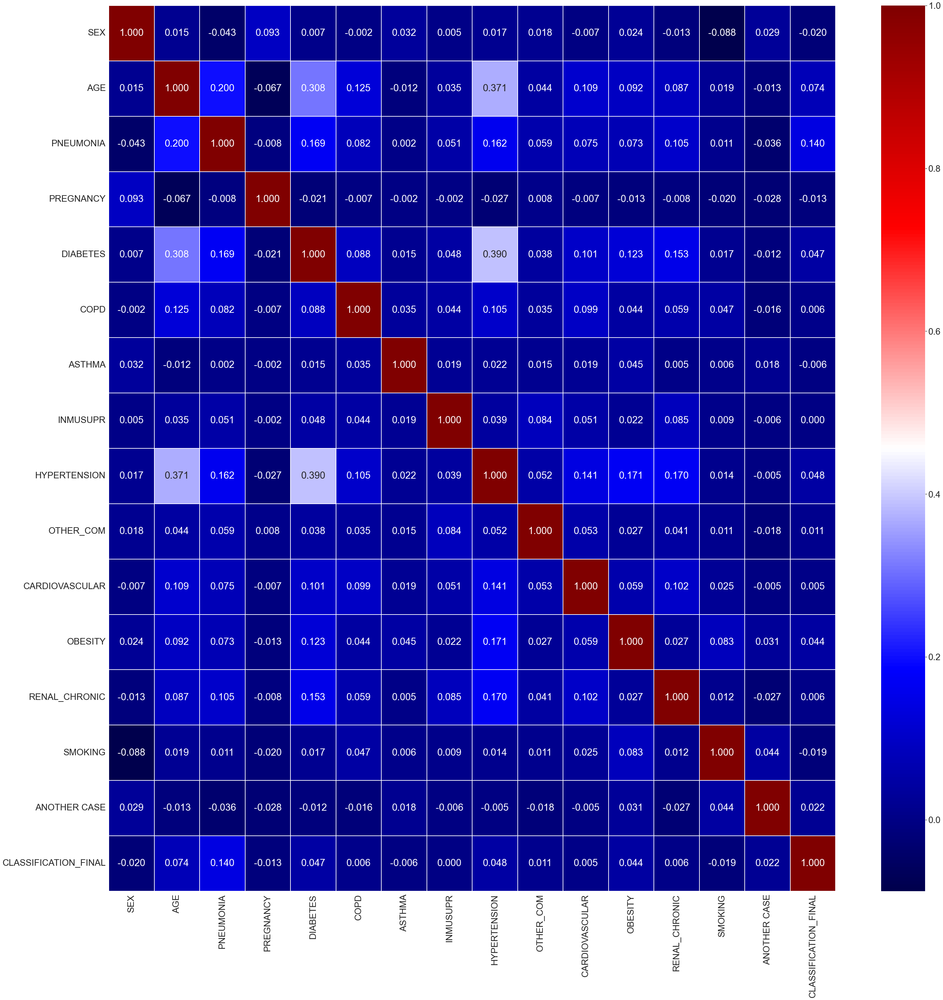

In [ ]:
import seaborn as sns 
import matplotlib.pyplot as plt

corrmat = df6.corr() 
sns.set(font_scale=2.5)  
f, ax = plt.subplots(figsize =(50, 50)) 
sns.heatmap(corrmat, ax=ax, cmap='seismic', linewidths = 0.1,annot=True, fmt=".3f")

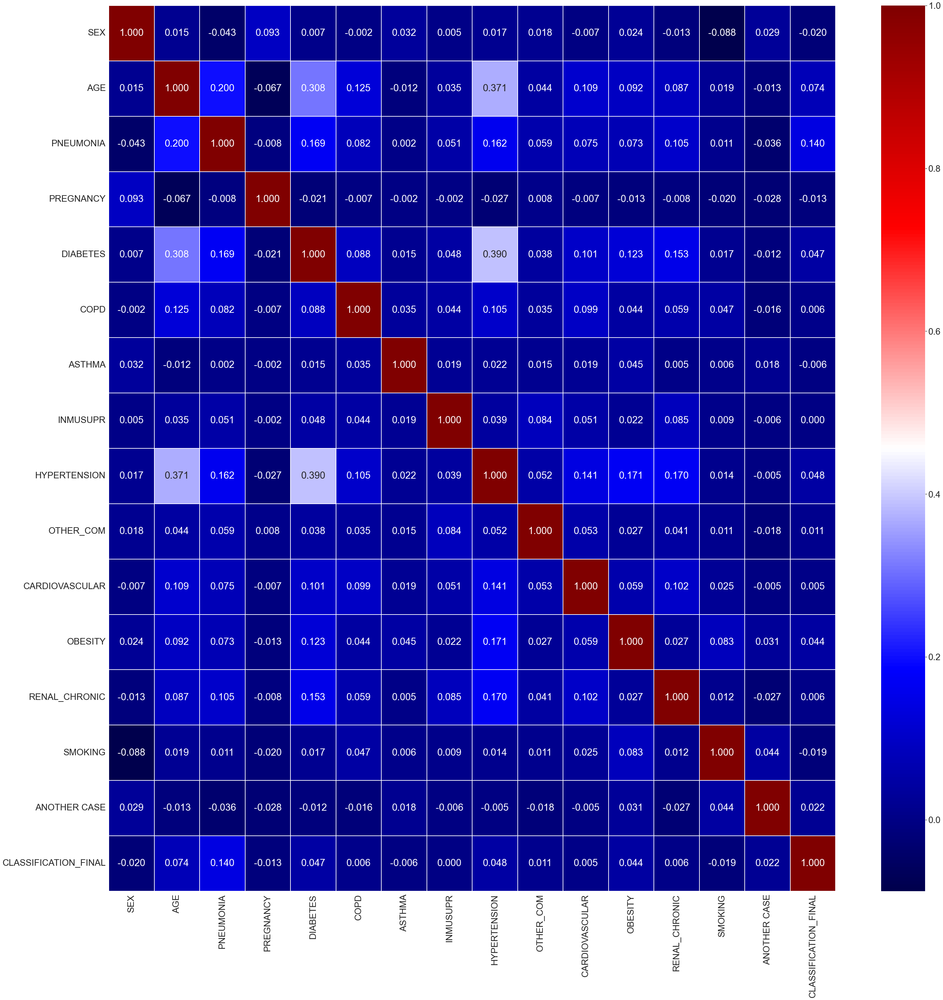

In [ ]:
import seaborn as sns 
import matplotlib.pyplot as plt

corrmat = df6.corr() 
sns.set(font_scale=2.5)  
f, ax = plt.subplots(figsize =(50, 50)) 
sns.heatmap(corrmat, ax=ax, cmap='seismic', linewidths = 0.1,annot=True, fmt=".3f")

f.savefig("foo.png", bbox_inches='tight', dpi=600)

In [ ]:
cmap = cmap=sns.diverging_palette(250, 15, s=75, l=40,

                                  n=9, center="dark", as_cmap=True)

corr= df6.corr()
def magnify():
    return [dict(selector="th",
                 props=[("font-size", "7pt")]),
            dict(selector="td",
                 props=[('padding', "0em 0em")]),
            dict(selector="th:hover",
                 props=[("font-size", "12pt")]),
            dict(selector="tr:hover td:hover",
                 props=[('max-width', '200px'),
                        ('font-size', '12pt')])
]

corr.style.background_gradient(cmap, axis=1)\
    .set_properties(**{'max-width': '80px', 'font-size': '10pt'})\
    .set_caption("Hover to magify")\
    .set_precision(2)\
    .set_table_styles(magnify())

,SEX,AGE,PNEUMONIA,PREGNANCY,DIABETES,COPD,ASTHMA,INMUSUPR,HYPERTENSION,OTHER_COM,CARDIOVASCULAR,OBESITY,RENAL_CHRONIC,SMOKING,ANOTHER CASE,CLASSIFICATION_FINAL
SEX,1.00,0.01,-0.04,0.09,0.01,-0.00,0.03,0.00,0.02,0.02,-0.01,0.02,-0.01,-0.09,0.03,-0.02
AGE,0.01,1.00,0.20,-0.07,0.31,0.13,-0.01,0.04,0.37,0.04,0.11,0.09,0.09,0.02,-0.01,0.07
PNEUMONIA,-0.04,0.20,1.00,-0.01,0.17,0.08,0.00,0.05,0.16,0.06,0.08,0.07,0.11,0.01,-0.04,0.14
PREGNANCY,0.09,-0.07,-0.01,1.00,-0.02,-0.01,-0.00,-0.00,-0.03,0.01,-0.01,-0.01,-0.01,-0.02,-0.03,-0.01
DIABETES,0.01,0.31,0.17,-0.02,1.00,0.09,0.01,0.05,0.39,0.04,0.10,0.12,0.15,0.02,-0.01,0.05
COPD,-0.00,0.13,0.08,-0.01,0.09,1.00,0.03,0.04,0.11,0.03,0.10,0.04,0.06,0.05,-0.02,0.01
ASTHMA,0.03,-0.01,0.00,-0.00,0.01,0.03,1.00,0.02,0.02,0.02,0.02,0.04,0.01,0.01,0.02,-0.01
INMUSUPR,0.00,0.04,0.05,-0.00,0.05,0.04,0.02,1.00,0.04,0.08,0.05,0.02,0.08,0.01,-0.01,0.00
HYPERTENSION,0.02,0.37,0.16,-0.03,0.39,0.11,0.02,0.04,1.00,0.05,0.14,0.17,0.17,0.01,-0.01,0.05
OTHER_COM,0.02,0.04,0.06,0.01,0.04,0.03,0.02,0.08,0.05,1.00,0.05,0.03,0.04,0.01,-0.02,0.01


In [ ]:
df7.mean().round(3)

SEX                0.534
AGE               38.377
PNEUMONIA          0.044
PREGNANCY          0.010
DIABETES           0.076
COPD               0.006
ASTHMA             0.020
INMUSUPR           0.006
HYPERTENSION       0.105
OTHER_COM          0.013
CARDIOVASCULAR     0.010
OBESITY            0.087
RENAL_CHRONIC      0.009
SMOKING            0.065
ANOTHER CASE       0.358
target             0.379
dtype: float64

In [ ]:
df7.mode()

,SEX,AGE,PNEUMONIA,PREGNANCY,DIABETES,COPD,ASTHMA,INMUSUPR,HYPERTENSION,OTHER_COM,CARDIOVASCULAR,OBESITY,RENAL_CHRONIC,SMOKING,ANOTHER CASE,target
0,1,27,0,0,0,0,0,0,0,0,0,0,0,0,0,0


In [ ]:
df7.median()

SEX                1.0
AGE               36.0
PNEUMONIA          0.0
PREGNANCY          0.0
DIABETES           0.0
COPD               0.0
ASTHMA             0.0
INMUSUPR           0.0
HYPERTENSION       0.0
OTHER_COM          0.0
CARDIOVASCULAR     0.0
OBESITY            0.0
RENAL_CHRONIC      0.0
SMOKING            0.0
ANOTHER CASE       0.0
target             0.0
dtype: float64

In [ ]:
df7.std().round(3)

SEX                0.499
AGE               16.884
PNEUMONIA          0.204
PREGNANCY          0.099
DIABETES           0.265
COPD               0.080
ASTHMA             0.141
INMUSUPR           0.075
HYPERTENSION       0.306
OTHER_COM          0.114
CARDIOVASCULAR     0.098
OBESITY            0.282
RENAL_CHRONIC      0.096
SMOKING            0.246
ANOTHER CASE       0.480
target             0.485
dtype: float64

In [ ]:
df7.min()

SEX               0
AGE               0
PNEUMONIA         0
PREGNANCY         0
DIABETES          0
COPD              0
ASTHMA            0
INMUSUPR          0
HYPERTENSION      0
OTHER_COM         0
CARDIOVASCULAR    0
OBESITY           0
RENAL_CHRONIC     0
SMOKING           0
ANOTHER CASE      0
target            0
dtype: int64

In [ ]:
df7.max()

SEX                 1
AGE               122
PNEUMONIA           1
PREGNANCY           1
DIABETES            1
COPD                1
ASTHMA              1
INMUSUPR            1
HYPERTENSION        1
OTHER_COM           1
CARDIOVASCULAR      1
OBESITY             1
RENAL_CHRONIC       1
SMOKING             1
ANOTHER CASE        1
target              1
dtype: int64

In [ ]:
df_final=df7.head()
df_final

,SEX,AGE,PNEUMONIA,PREGNANCY,DIABETES,COPD,ASTHMA,INMUSUPR,HYPERTENSION,OTHER_COM,CARDIOVASCULAR,OBESITY,RENAL_CHRONIC,SMOKING,ANOTHER CASE,target
0,0,35,0,0,0,0,0,0,0,0,0,0,0,0,0,1
1,1,42,0,0,0,0,1,0,0,0,0,0,0,0,0,0
3,0,51,0,0,0,0,0,0,1,0,0,0,0,0,0,0
5,1,47,0,0,0,0,0,0,0,0,0,0,0,0,1,0
7,0,38,0,0,0,0,0,0,0,0,0,0,0,0,0,0


In [ ]:
df_final.to_csv("finaldata.csv",index=False)

TypeError: diverging_palette() got an unexpected keyword argument 'ax'

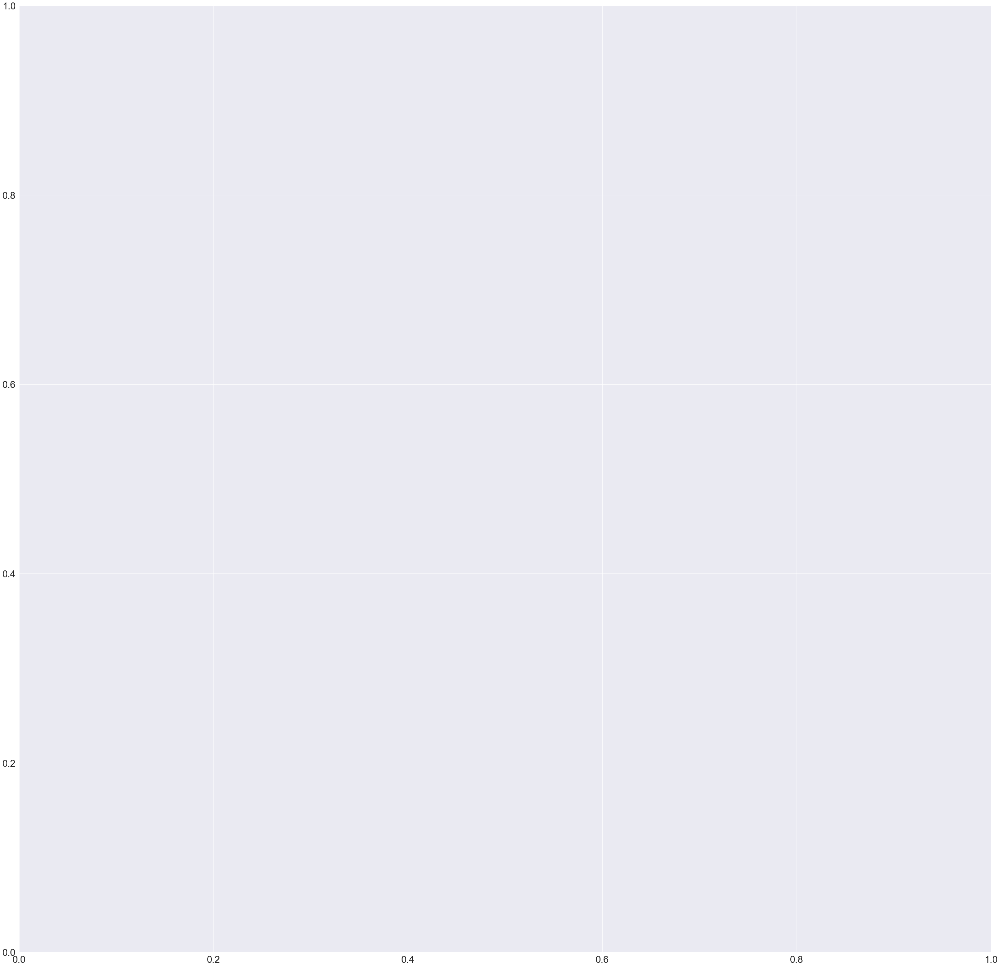

In [ ]:
f, ax = plt.subplots(figsize =(50, 50)) 


cmap = cmap=sns.diverging_palette(250, 15, s=75, l=40,

                                  n=9, center="dark", ax=ax as_cmap=True)

corr= df6.corr()
def magnify():
    return [dict(selector="th",
                 props=[("font-size", "7pt")]),
            dict(selector="td",
                 props=[('padding', "0em 0em")]),
            dict(selector="th:hover",
                 props=[("font-size", "12pt")]),
            dict(selector="tr:hover td:hover",
                 props=[('max-width', '200px'),
                        ('font-size', '12pt')])
]

corr.style.background_gradient(cmap, axis=1)\
    .set_properties(**{'max-width': '80px', 'font-size': '10pt'})\
    .set_caption("Hover to magify")\
    .set_precision(2)\
    .set_table_styles(magnify())

f.savefig("foo.png", bbox_inches='tight', dpi=800)

In [ ]:
df10=df7[['target']]
df10.head()


,target
0,1
1,0
3,0
5,0
7,0


In [ ]:
df10.shape

(14307250, 1)

In [ ]:
for index, row in df10.iterrows():
    print(row['target'])

1
0
0
0
0
0
0
1
0
1
0
1
0
1
1
0
0
0
1
1
1
0
0
1
1
0
0
1
0
1
1
0
0
0
1
1
0
0
1
1
0
0
0
1
1
0
1
1
1
0
1
0
0
1
1
0
0
1
1
0
0
0
1
0
1
0
1
1
1
0
0
0
0
0
1
0
0
1
0
1
0
0
1
0
0
1
0
0
0
0
1
0
0
0
1
0
1
1
0
1
0
0
0
0
0
0
0
0
1
0
1
0
1
0
1
1
1
0
1
0
0
0
0
1
1
0
1
0
0
0
1
1
0
1
1
0
0
0
0
1
0
0
0
0
0
1
0
0
0
0
1
1
0
0
1
0
1
1
0
0
1
1
1
0
0
0
0
1
1
1
1
1
0
0
0
1
1
0
1
1
0
0
0
0
0
1
0
0
0
1
0
0
0
1
1
1
0
0
0
0
0
0
0
1
1
1
1
0
0
0
1
1
0
1
0
1
0
0
1
0
1
0
0
0
1
1
1
1
1
0
0
0
0
0
0
0
0
1
0
1
1
1
1
1
0
0
0
1
1
0
0
0
0
0
1
1
0
0
0
0
0
1
1
0
0
0
1
1
0
0
0
0
0
1
0
0
1
1
1
0
0
0
0
1
0
0
1
1
1
0
1
0
0
1
1
0
0
1
0
1
0
1
1
1
0
1
1
0
0
0
1
0
1
1
0
1
0
0
1
0
0
0
1
0
1
1
0
1
1
0
0
0
0
0
1
0
0
0
0
0
1
0
0
1
1
1
0
1
0
1
1
0
0
1
0
0
0
1
0
0
1
0
1
0
0
1
1
1
1
0
1
1
1
0
1
1
0
0
1
0
1
1
1
1
0
0
0
1
0
0
0
0
0
1
0
0
1
1
0
1
1
0
0
0
0
0
0
1
1
0
0
1
0
0
0
0
0
1
0
1
0
0
0
1
1
1
0
0
0
0
0
1
1
0
0
0
1
0
1
0
0
0
0
0
1
1
1
0
1
1
0
0
1
1
0
0
0
0
0
0
0
1
0
0
1
0
0
0
0
1
0
0
1
1
0
0
0
0
0
0
0
0
0
1
1
0
1
0
1
1
0
0
0
0
0
1
0
1
0
1


0
0
0
1
0
0
0
1
0
0
0
0
0
1
1
1
0
1
0
0
0
1
1
0
1
1
0
0
0
1
0
0
1
1
0
1
0
0
1
0
0
1
0
0
0
1
0
0
0
1
0
0
1
1
0
1
1
0
0
0
1
1
0
0
1
0
0
1
0
0
1
1
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
0
0
1
1
0
0
0
0
1
0
0
0
0
1
0
0
0
1
1
1
0
1
0
0
1
0
0
0
0
0
0
1
0
1
0
1
0
0
0
0
0
0
0
1
0
0
0
0
0
0
0
1
0
0
1
0
0
0
0
1
0
0
0
0
0
0
1
0
0
0
1
1
0
1
1
0
1
1
0
0
0
0
0
1
0
0
1
0
0
0
0
0
0
1
0
1
0
0
0
0
1
0
0
1
1
0
1
1
1
0
1
0
0
1
0
1
1
0
0
0
0
0
1
1
1
0
0
0
0
0
0
0
0
0
1
0
0
0
0
1
0
0
0
0
0
0
0
1
1
0
0
1
0
0
0
0
1
1
0
1
0
0
0
0
0
0
0
1
0
0
0
0
0
1
0
0
0
0
0
1
0
0
0
0
0
0
0
1
0
0
0
0
0
0
0
1
0
1
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
1
0
0
1
0
0
1
1
1
1
0
0
1
0
0
0
0
1
0
1
0
1
1
0
0
1
1
0
0
1
0
0
0
0
0
0
0
0
0
1
0
0
0
1
0
1
0
0
0
1
0
0
1
0
0
1
1
0
0
0
0
0
1
0
0
0
1
0
1
0
1
0
0
1
0
1
0
0
0
0
1
0
0
0
1
0
1
0
1
1
0
1
0
1
1
1
0
0
0
1
0
0
0
1
0
0
0
0
0
1
0
0
0
0
1
0
0
0
0
0
0
0
0
0
0
0
1
0
0
1
1
0
0
0
1
0
1
1
0
0
0
0
0
1
1
1
0
0
0
0
0
1
0
1
1
0
1
0
0
0
0
1
0
0
0
0
0
0
0
0
1
1
0
0
0
0
0
0


0
0
0
0
0
1
1
1
0
1
0
0
0
0
1
1
0
1
0
0
1
0
0
0
1
0
1
0
0
1
0
0
1
0
0
1
1
1
0
1
0
1
1
0
0
1
1
1
1
0
1
0
0
1
0
0
1
0
1
1
1
1
0
0
0
0
0
1
1
0
1
0
1
0
0
0
0
0
0
1
0
1
0
0
0
0
0
0
0
0
0
1
1
1
0
0
0
1
0
1
0
0
0
1
0
1
1
0
1
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
1
1
1
0
0
0
0
1
1
1
1
0
0
0
0
0
0
1
0
0
0
1
0
0
1
0
0
0
0
0
0
1
0
0
0
1
0
0
0
0
0
1
1
1
1
1
1
0
1
1
0
0
1
0
0
0
1
0
0
1
0
0
0
0
0
0
0
0
0
0
0
1
0
1
0
0
0
1
1
1
1
0
0
0
0
0
0
1
0
1
0
1
1
1
0
0
0
1
1
0
0
0
0
1
1
0
1
0
0
1
1
0
0
1
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
0
0
1
0
0
1
0
0
1
0
0
0
0
0
0
0
1
1
0
1
1
1
0
0
0
1
0
0
1
1
0
1
1
0
0
0
0
0
1
0
0
0
0
0
0
0
0
0
0
0
0
1
0
0
1
1
0
1
0
0
1
1
0
0
0
0
1
0
1
1
0
0
0
0
0
0
1
0
1
0
0
1
0
1
0
0
1
0
0
0
0
0
1
0
0
0
0
0
1
0
1
0
0
0
0
0
1
0
0
0
0
0
0
0
0
1
0
1
0
0
1
0
0
0
0
0
1
0
0
1
0
0
0
0
0
0
0
0
1
0
0
0
0
0
0
0
0
1
0
0
0
1
0
0
0
0
0
0
0
0
0
1
0
0
0
0
1
0
1
0
0
0
0
1
0
0
0
0
0
1
1
0
1
0
1
1
1
0
1
0
0
1
0
1
0
1
0
0
0
1
0
0
0
0
1
0
1
0
1
0
0
0
0
0
0
0
1
0
1
0
0
0
0
0
1
0
0
1
0
0
0
1
0
0
1
0
0


0
0
0
0
1
1
1
1
0
1
1
0
1
0
0
0
1
1
0
1
1
0
0
1
0
0
0
0
0
0
1
0
0
0
0
0
1
0
1
1
0
0
1
0
1
0
1
0
1
1
1
1
1
0
0
0
0
0
0
0
0
0
1
0
1
0
0
0
0
0
0
0
1
1
0
0
0
0
0
1
0
0
0
0
0
0
1
0
1
1
0
0
1
1
0
0
1
1
1
0
1
0
0
0
1
1
0
1
1
1
1
0
0
1
0
1
0
0
0
1
0
1
0
0
1
0
0
0
1
0
1
1
0
0
0
0
1
1
0
0
0
0
0
0
0
1
1
1
1
0
0
1
0
0
1
0
0
0
0
1
0
0
1
0
0
1
0
0
0
1
1
0
0
0
0
0
0
1
0
1
0
0
1
0
0
0
0
0
0
1
0
0
0
0
1
1
0
0
0
0
0
1
1
0
1
1
1
0
0
0
0
1
0
0
0
1
1
0
1
0
0
0
1
0
1
0
0
0
0
0
0
0
0
0
0
0
1
0
1
1
1
0
1
1
0
0
0
0
0
0
1
0
1
0
0
0
0
0
0
1
0
1
1
0
0
0
0
0
1
0
0
0
0
1
0
0
0
0
0
0
0
0
0
0
0
0
0
1
0
0
1
1
1
1
1
0
1
0
0
0
1
1
0
0
0
1
0
0
1
1
1
1
0
0
0
0
0
0
0
0
0
0
0
0
1
0
1
0
1
0
1
0
0
1
0
0
0
0
0
0
0
1
1
0
0
1
1
0
0
1
0
1
1
0
0
0
0
0
0
1
0
0
1
0
0
0
1
0
1
1
1
0
0
1
1
1
1
0
1
0
0
0
1
1
0
1
1
1
1
0
0
0
0
0
1
0
0
0
1
0
1
1
1
0
1
0
0
1
1
0
0
0
0
1
0
1
0
1
1
0
0
0
0
1
0
1
1
0
0
0
0
0
0
1
0
0
1
0
1
0
0
1
0
0
1
1
1
1
1
0
0
0
1
0
0
1
1
0
0
0
1
1
1
0
1
0
0
0
0
1
0
0
0
0
1
0
0
0
0
1
0
1
1
1
0
0
1
0
1
0
1
0
0
1
0
0
0
0
0
1


1
0
1
1
0
0
1
0
0
1
0
0
1
0
0
0
0
0
0
0
0
0
0
0
1
1
1
0
0
1
0
0
1
0
0
0
0
0
1
1
0
0
0
0
0
0
0
0
0
1
0
0
0
0
0
1
1
0
0
0
1
0
0
0
0
0
1
1
0
1
0
1
1
0
0
0
1
0
0
0
0
0
0
1
0
0
0
0
0
1
1
0
0
1
0
1
0
0
1
0
1
0
0
0
0
1
0
0
0
0
0
0
0
0
1
1
1
0
0
0
0
0
0
0
0
0
0
0
0
1
0
1
1
1
0
1
0
0
0
1
0
0
0
1
0
0
0
0
0
0
0
1
0
0
1
0
0
1
1
0
0
0
1
1
0
0
0
1
1
0
0
1
1
0
1
0
1
0
1
1
0
0
1
1
0
1
0
1
0
0
1
0
0
0
0
1
0
0
0
0
0
1
1
1
0
0
1
1
0
0
1
0
0
1
0
0
0
1
1
1
0
0
0
0
0
0
1
0
0
0
0
1
0
1
0
0
0
0
0
0
1
0
1
0
0
0
1
0
0
0
0
1
0
0
0
0
0
0
0
1
0
1
1
0
1
0
0
0
0
0
0
1
0
1
0
0
0
0
0
0
0
0
0
1
0
0
0
0
1
0
1
0
0
0
0
0
0
1
0
0
1
0
0
1
0
0
0
1
1
0
0
0
0
0
0
1
1
0
0
0
1
1
0
0
0
0
0
0
0
0
1
1
0
1
0
0
0
1
0
0
0
1
1
0
1
0
0
0
1
0
0
0
1
1
0
0
0
0
0
0
0
0
0
1
0
0
1
0
0
0
1
1
0
0
0
1
0
0
0
1
0
0
1
1
0
0
0
0
1
1
0
1
1
0
1
0
0
0
0
0
0
0
0
0
0
0
0
0
1
0
0
0
0
0
1
1
0
1
0
0
0
1
1
0
1
0
0
0
0
1
0
0
1
0
0
1
1
0
0
0
0
0
0
0
0
1
1
1
0
0
0
0
0
0
0
0
1
0
0
0
0
1
0
0
0
0
0
0
0
0
0
1
0
1
0
0
0
1
1
0
1
1
0
1
1
1
1
0
0
0
1
0
0
0
0
0
0
0
0
1


1
1
0
0
0
1
0
1
0
1
0
0
0
0
1
0
0
0
1
1
1
1
0
0
1
1
1
1
0
0
0
0
1
0
0
1
0
0
1
1
0
1
0
0
0
0
0
1
0
1
1
1
0
1
0
0
0
0
0
0
0
0
0
1
1
0
0
0
1
0
0
1
0
1
0
0
1
0
1
1
0
0
0
0
0
1
1
1
0
0
0
0
0
0
0
1
0
1
0
0
0
1
0
0
0
0
0
0
1
0
0
1
0
0
0
1
1
0
1
1
0
0
0
0
1
0
0
0
0
0
0
0
1
1
1
0
1
0
0
0
1
1
1
0
0
0
1
0
1
0
0
0
0
0
1
0
1
0
0
0
1
0
0
0
0
1
1
1
1
0
0
1
0
0
1
1
0
1
0
0
0
0
1
0
0
0
0
1
0
0
0
0
0
0
0
0
1
0
0
0
0
1
1
0
0
0
0
0
1
1
0
0
0
0
0
0
0
0
0
0
1
0
1
0
1
0
0
0
0
0
0
0
0
0
0
1
1
0
0
1
0
1
1
0
1
1
1
1
1
1
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
1
0
1
0
0
0
0
1
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
0
1
0
1
0
0
1
0
0
0
1
1
0
0
1
0
0
1
1
1
1
0
0
0
0
0
0
0
0
0
0
0
0
1
0
0
0
0
1
0
0
1
0
1
0
0
1
1
0
0
1
0
0
0
0
1
1
0
0
0
1
0
0
0
0
0
1
0
0
0
1
1
0
0
0
0
1
1
0
0
0
0
0
0
0
0
1
0
0
1
0
0
0
0
1
0
0
0
0
0
0
0
0
0
0
0
0
0
1
0
0
1
0
0
0
1
0
0
1
0
1
0
0
0
1
0
0
0
0
1
0
0
1
0
0
0
0
0
0
0
0
1
0
1
1
1
1
0
0
1
0
0
0
0
0
1
0
0
0
1
1
0
0
1
1
0
0
1
1
0
0
0
0
0
0
0
1
0
0
0
1
0
0
0
1
0
0
0
1
0
0
0
0
0
0
0
0
0
1
0
1
0
1
0


0
1
0
0
1
1
0
0
1
1
0
0
0
0
0
1
1
0
1
1
1
0
0
0
1
1
0
0
1
0
0
1
0
0
0
1
0
1
1
0
0
1
0
1
0
0
0
1
0
1
1
1
0
1
0
0
1
1
1
0
1
1
0
0
1
1
0
0
0
1
1
1
0
1
0
1
0
1
1
0
1
0
1
1
1
0
0
0
1
1
1
0
1
1
0
0
1
1
0
1
0
1
0
0
0
1
0
0
1
0
1
0
0
1
1
0
0
1
0
0
0
1
0
0
0
0
0
0
1
0
1
1
0
1
1
1
0
0
0
0
0
1
1
0
1
0
1
1
0
1
1
1
0
0
0
0
0
0
1
1
0
1
0
0
1
1
0
0
1
0
0
1
1
0
0
0
0
0
0
0
0
0
0
0
0
1
0
0
1
1
0
0
0
0
0
0
0
0
1
1
0
0
1
1
0
1
1
0
1
0
1
0
0
1
0
1
0
0
0
0
0
1
0
1
1
0
0
1
0
1
1
1
1
1
1
0
0
0
0
0
1
1
0
0
1
0
0
0
1
1
0
0
1
0
0
0
0
0
0
0
1
1
1
1
1
1
0
0
0
0
1
1
0
0
1
0
0
0
0
0
0
0
0
1
0
1
1
0
1
0
1
0
1
1
1
0
1
1
0
0
1
1
1
0
0
1
1
0
0
0
0
0
1
0
0
0
1
1
0
1
1
0
0
1
1
1
0
0
1
0
1
0
0
1
1
0
0
0
0
1
0
0
0
1
0
0
0
1
0
1
0
0
0
0
0
0
1
0
1
0
0
0
0
0
1
0
0
1
0
0
1
1
1
0
1
1
1
0
0
1
0
1
1
0
1
0
0
0
0
1
0
1
0
0
0
1
1
0
0
0
0
0
0
1
0
1
0
1
0
1
0
1
1
1
1
0
0
1
0
0
1
1
0
1
0
0
1
1
1
0
1
1
0
0
1
1
0
0
0
0
0
0
0
1
0
0
0
0
1
0
1
1
0
1
1
1
1
0
1
1
1
1
0
0
1
0
1
1
1
1
0
1
0
0
0
0
1
1
0
1
1
0
1
1
0
0
0
1
1
0
1
0
0
0
1
0
1
0
1
1


0
1
1
1
0
0
1
1
0
0
0
1
1
0
0
0
1
1
0
0
1
0
1
0
0
0
1
1
1
0
1
0
1
1
1
1
0
0
0
0
0
0
1
0
0
0
0
0
1
1
1
1
0
0
0
0
0
0
0
1
0
0
1
1
1
0
0
0
1
0
0
0
0
0
1
0
0
0
0
0
0
0
0
0
0
0
0
1
1
1
0
1
0
0
1
0
1
0
0
0
0
1
0
1
0
1
1
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
0
1
0
0
1
0
0
0
0
1
0
0
0
0
1
0
0
0
1
0
0
0
0
0
0
0
0
0
0
0
0
0
1
1
1
0
0
0
1
0
0
1
0
0
0
0
0
1
0
0
1
1
0
1
0
1
1
0
0
0
0
0
0
0
0
0
0
0
0
1
0
1
0
0
1
1
0
0
1
0
0
0
0
0
0
1
0
0
1
1
0
0
1
0
0
0
0
0
0
0
1
0
0
0
0
0
1
0
1
0
0
0
1
0
1
0
0
1
1
0
0
0
0
1
1
0
0
0
1
0
1
1
0
1
0
1
0
0
1
0
0
1
1
0
0
1
1
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
0
1
0
1
0
0
0
1
1
0
1
1
0
0
0
0
1
0
0
0
0
0
0
0
1
0
0
0
1
1
0
0
0
0
0
0
0
0
1
1
0
1
0
0
0
0
1
0
0
1
0
0
0
0
1
0
0
0
0
1
0
0
0
0
1
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
0
0
1
0
1
1
0
1
0
1
0
1
1
0
1
0
0
0
0
0
0
0
1
1
1
0
0
0
1
0
0
0
0
0
0
1
0
0
0
0
0
0
1
0
1
0
0
1
0
0
0
1
1
1
1
0
0
1
0
0
0
0
1
0
0
0
1
0
1
0
0
0
0
0
0
1
0
0
1
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
1
1
0
0
0
0
0
0
0
0
1
1
0
0
0
0
1
0
0
1
0
0
0
1
0
0
0


0
0
0
0
0
0
1
1
1
0
1
0
0
1
0
1
0
0
0
1
0
0
0
0
0
0
0
0
1
1
0
1
0
0
0
0
1
0
0
1
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
0
1
0
0
0
1
0
0
0
0
0
1
0
0
1
0
1
0
0
1
1
0
0
1
0
0
0
0
0
0
0
1
1
0
0
0
0
0
0
0
0
1
0
0
0
0
0
1
0
0
0
0
0
0
0
0
1
1
0
1
0
0
0
1
1
1
0
0
0
1
1
0
1
0
0
1
0
0
0
1
0
0
1
0
1
0
0
0
0
1
0
0
0
0
0
0
1
0
0
0
0
0
1
0
0
0
0
0
0
0
0
0
0
1
0
0
0
0
0
0
0
0
1
0
0
1
0
1
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
0
1
0
0
1
0
1
1
1
1
0
0
0
0
0
0
0
0
0
0
0
0
0
1
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
1
1
0
1
1
0
0
0
0
0
0
1
1
0
0
1
1
0
0
0
0
1
0
1
0
1
0
0
0
1
1
0
0
0
0
0
1
1
0
1
1
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
1
1
1
0
0
0
1
1
0
1
0
0
1
0
0
1
1
0
1
0
0
0
0
0
1
1
1
0
1
0
1
0
1
0
0
0
0
0
1
0
0
1
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
0
0
0
0
0
0
1
0
0
0
0
0
0
1
0
0
0
1
0
0
0
0
0
0
0
0
1
0
0
1
0
0
0
0
1
0
0
0
0
1
0
0
0
0
1
0
0
0
0
0
0
0
0
1
1
0
0
0
0
0
0
1
0
0
0
0
0
0
0
0
1
1
0
0
1
0
0
1
0
0
1
1
0
0
0
0
1
1
1
0
0
0
0
1
1
0
1
0
0
1
0
1
0
0
0
0
0
0
0
1
0
0
0


0
0
0
0
0
0
0
1
1
1
0
0
1
1
1
0
0
1
0
0
1
0
0
1
0
0
1
1
0
1
0
0
1
1
0
0
1
0
0
1
0
0
0
0
1
0
1
1
0
0
1
1
0
1
1
0
1
0
0
0
0
0
0
1
0
0
0
0
1
0
0
0
1
0
0
0
0
1
1
1
0
0
0
0
1
1
0
0
1
0
0
0
0
0
0
0
1
1
1
0
0
0
1
0
1
1
0
1
1
1
1
0
0
0
0
0
0
0
0
0
0
1
1
1
0
1
0
0
1
0
0
0
1
0
1
0
1
0
0
0
0
0
0
0
0
0
1
0
0
1
0
0
0
0
0
0
0
0
0
0
0
0
1
0
1
1
1
1
1
0
0
1
0
0
1
0
1
0
0
0
0
0
0
0
0
0
0
0
1
1
1
1
1
0
0
0
0
1
0
0
0
0
0
0
0
1
1
0
0
0
0
1
1
0
1
1
0
0
0
0
0
0
0
1
0
0
1
1
1
0
0
1
1
0
0
1
1
0
1
1
0
1
0
0
0
0
0
0
0
0
1
1
1
0
0
0
1
0
0
0
0
1
0
1
0
0
0
0
0
0
0
0
0
0
0
0
1
1
0
0
0
0
0
0
0
0
1
1
1
0
1
0
1
0
1
0
1
0
1
0
0
1
0
0
1
1
0
0
1
0
0
0
1
0
0
1
0
1
0
1
1
1
1
0
0
0
0
1
1
0
0
1
0
0
0
1
0
1
0
0
0
0
0
0
0
0
0
1
0
0
1
0
1
0
1
0
0
0
1
1
1
0
1
0
0
0
0
0
1
0
1
1
0
0
0
1
0
1
0
0
0
0
1
0
0
1
1
0
0
0
0
0
0
0
0
0
0
1
1
0
1
0
1
1
0
1
1
0
1
1
0
0
0
0
1
1
0
0
0
0
0
0
0
1
1
0
0
1
1
1
1
0
0
1
1
0
0
0
1
0
1
0
0
1
0
0
0
0
0
1
0
0
1
0
0
0
1
0
1
1
1
1
0
0
0
0
0
0
0
1
0
0
0
1
1
1
0
1
0
1
1
0
1
0
0
0
1
1
0
0
0
0
0
0
0
1
0
1
0
1


0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
0
0
0
0
0
1
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
1
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
1
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
0
0
0
0
0
0
0
0
0
0
0
0
0
1
0
0
1
0
0
0
0
0
0
1
0
0
0
0
0
0
0
0
1
0
0
0
1
0
0
0
0
0
0
0
0
0
0
0
1
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
0
0
0
1
0
1
0
0
0
0
0
0
0
0
1
0
0
0
0
0
0
1
1
0
0
0
0
1
0
0
0
0
0
0
1
0
0
0


0
0
1
0
0
0
0
0
0
0
0
1
0
0
0
0
0
0
0
0
0
0
0
1
0
0
0
0
0
0
1
1
0
1
0
0
0
1
0
0
0
0
0
0
0
0
1
0
0
0
0
1
0
1
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
0
0
0
0
0
0
0
0
0
0
1
0
0
0
0
0
0
0
0
0
1
1
0
0
0
0
1
1
0
0
0
1
0
1
1
0
0
0
0
0
0
0
0
1
0
0
0
0
0
0
0
0
0
0
1
0
0
0
1
0
0
1
0
0
0
0
0
1
0
1
1
0
0
0
1
0
1
1
0
0
0
1
1
0
0
1
0
0
0
1
0
0
0
0
0
0
0
0
0
0
1
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
1
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
1
0
0
0
1
0
1
1
0
0
1
0
0
0
1
0
0
0
0
1
0
0
0
1
0
0
1
1
1
0
0
0
0
1
0
0
0
0
0
1
1
0
1
0
0
0
0
1
0
0
0
1
0
0
1
0
1
0
0
0
1
0
0
0
0
0
0
0
0
0
0
0
1
0
0
0
0
0
0
1
0
0
0
0
0
0
0
0
1
1
0
0
0
1
1
0
0
0
0
0
0
0
0
1
0
1
0
0
1
0
0
0
0
1
0
0
0
1
0
0
0
0
1
0
0
0
0
1
0
0
1
0
1
0
0
0
0
1
1
0
0
0
0
0
0
1
1
1
0
0
0
0
1
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
1
0
0
0
0
0
0
1
0
1
0
0
1
0
0
0
0
0
0
0
0
0
0
0
0
0
1
0
0
1
0
0
1
0
1
0
0
0
0
0
1
0
0
1
0
0
0
0
1
0
0
0
0
1
0
0
0
1
0
0
0
0
1
0
0
0
1
1
0
0
0
1
0
0
0
0
0
1
1
0
1
1
0
1
0
0
1
0
1
0
0
0
0
1
0
0
0
0
1
0
0
0
0
0
0
0
0
1
0
1
1
0
0
0
0
1
0
0
1
1
0
0
0


0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
0
0
1
0
0
1
0
1
0
1
1
0
1
0
1
0
1
1
0
0
0
1
1
0
0
0
0
0
0
0
1
0
0
0
0
0
1
0
1
1
1
0
0
0
0
0
0
1
1
1
1
0
0
0
0
0
1
1
0
1
1
0
1
0
1
0
1
0
0
0
1
0
0
0
0
0
0
0
0
0
1
1
0
0
0
0
1
0
0
0
0
1
1
0
1
0
0
0
1
0
0
0
1
1
0
0
0
0
0
1
0
0
1
1
0
1
1
0
0
1
0
0
1
0
0
0
0
0
0
1
0
1
0
1
0
0
0
1
0
0
1
1
1
0
0
1
1
0
0
0
0
0
1
1
0
0
0
1
1
0
0
0
1
1
0
0
0
1
0
0
0
0
0
1
0
0
0
0
0
0
1
1
0
0
0
0
1
0
0
1
1
0
0
0
0
0
0
0
0
1
1
0
0
0
1
0
0
0
0
0
0
0
0
0
0
0
0
0
1
0
0
0
1
1
0
0
0
0
0
0
0
0
0
1
0
0
1
0
0
0
0
0
0
0
0
0
1
0
1
1
0
1
0
0
0
1
0
0
1
1
0
0
0
0
0
0
1
0
0
0
1
0
0
0
0
0
1
0
0
0
0
1
0
0
0
1
1
0
0
0
0
1
0
1
0
1
0
0
0
0
0
1
1
1
0
0
0
0
1
1
1
1
0
0
0
0
0
0
0
0
0
0
1
1
0
0
1
0
0
0
1
0
0
1
0
0
0
0
0
0
0
1
0
1
0
0
1
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
0
0
0
0
0
1
0
1
1
0
0
0
0
0
0
1
0
1
1
0
1
0
0
1
0
1
0
0
0
0
0
0
0
1
0
0
0
0
0
0
0
0
0


0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
0
0
0
0
0
0
0
1
0
1
0
1
0
0
0
1
1
0
1
0
1
0
0
0
1
0
0
1
0
0
0
0
0
1
1
1
0
0
0
0
0
0
0
0
0
0
0
0
0
1
0
0
0
1
1
1
0
0
0
0
0
0
0
0
1
1
0
0
1
1
1
0
0
0
0
0
0
0
0
0
0
0
0
0
1
0
0
0
0
0
0
0
0
0
1
0
0
1
1
0
0
0
0
0
0
0
0
1
1
0
0
0
0
0
0
0
0
0
1
0
1
1
1
1
1
0
1
0
0
0
0
0
0
1
1
0
0
0
0
0
0
1
0
0
0
0
0
0
0
0
0
1
0
0
0
0
0
0
0
0
0
1
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
0
1
0
0
1
1
1
0
1
0
0
0
1
0
0
0
1
0
0
0
0
0
1
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
0
0
0
0
0
0
0
0
1
0
0
1
0
0
0
0
0
0
0
0
0
0
0
0
1
0
0
0
0
0
0
0
0
0
1
0
0
0
0
0
0
0
1
1
0
0
0
0
1
0
0
1
1
1
0
0
0
0
0
0
1
0
1
0
0
1
0
0
0
0
0
0
1
1
0
0
0
0
1
0
0
1
0
0
0
1
0
1
0
0
1
0
0
0
1
1
0
1
0
0
0
1
0
0
0
0
0
0
0
0
0
1
1
1
0
0
0
1
1
0
0
0
1
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
0
0
0
0
0
0
1
0
0
0
1
0
0
0
0
0
0
1
0
0
0
1
0
0
1
0
1
0
1
1
0
0
0
0
0
0
1
0
0
0
0
0
1
0
0
0
0
1
0
0
0
1
0
0
1
1
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
0
0
0
0
0
0
0
0
0
1
0
0
1
0
1
1
1
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
0
0
0
0
1
0
1
0
0
0
0
0
0
0
0
0


0
0
1
0
0
1
0
0
1
1
0
0
0
0
0
0
0
0
1
1
0
0
0
0
1
0
0
1
0
0
1
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
1
0
0
0
0
0
0
1
0
0
0
1
0
0
0
1
0
0
0
1
0
1
0
0
0
0
0
1
0
0
0
0
0
0
0
0
0
0
0
0
0
1
0
0
0
0
1
0
0
1
0
0
1
0
0
1
0
1
0
0
0
1
0
1
0
0
0
1
1
0
0
0
0
0
0
0
0
0
0
0
0
1
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
1
0
0
0
1
0
0
0
1
0
0
0
0
1
0
0
0
0
1
0
1
1
0
0
0
1
0
0
1
0
0
1
0
0
0
0
0
0
1
0
0
0
1
0
1
0
0
0
0
1
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
1
0
0
1
0
0
1
0
0
0
1
0
1
0
0
1
1
0
0
0
0
0
0
0
0
0
0
1
1
1
1
0
0
0
0
0
0
1
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
0
0
0
0
1
1
0
0
0
0
0
1
1
0
0
0
0
1
0
0
1
0
0
0
0
0
0
0
0
1
1
1
0
0
0
0
0
1
0
1
0
1
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
0
1
0
0
1
0
0
0
0
0
1
0
1
1
0
0
0
1
0
0
0
0
0
0
0
1
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
0
0
0
1
0
1
1
0
1
1
0
0
0
0
0
1
0
1
0
1
0
1
0
1
0
1
1
0
1
0
0
0
0
1
0
0
1
0
0
1
1
0
0
0
0
0
0
0
1
0
1
1
1
1
0
0
0
0
1
0
1
0
0
0
1
0
0
1
0
0
1
0
0
0
0
0
0
1
1
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
0
0
0
1
0
0
0
0
0
0
0
0
1
0
0
0
0
1
0
1
0
1
0
0
0
0
0
1
0
0
0
0
0
0
0


0
1
0
0
0
1
0
0
0
0
0
0
0
0
1
0
0
0
0
1
1
0
1
1
0
1
0
1
0
0
0
1
1
1
1
0
0
1
1
0
0
0
1
1
0
0
0
0
1
0
0
1
0
0
0
0
1
1
1
1
1
0
1
1
0
0
0
0
1
0
0
0
1
0
0
1
0
0
1
1
0
0
0
0
1
1
1
0
1
0
0
0
1
0
0
0
0
1
0
0
0
0
0
1
1
0
0
0
0
0
0
1
1
0
0
1
0
0
0
1
0
0
0
0
0
0
1
1
0
0
0
0
0
1
1
1
1
0
0
1
1
1
0
0
0
0
0
0
0
0
0
1
1
0
0
0
0
0
0
1
0
1
1
1
0
0
0
0
1
1
0
1
0
0
0
1
1
1
0
1
0
0
1
0
1
0
0
1
0
0
0
1
0
0
0
1
0
0
0
0
0
0
0
1
1
0
0
0
1
1
0
0
0
0
1
0
0
1
0
1
0
1
0
0
1
0
1
0
1
0
0
0
1
0
0
1
0
0
0
0
0
0
0
1
0
0
1
0
0
0
1
0
1
1
1
1
0
0
0
0
1
0
0
0
0
1
1
0
0
1
0
1
0
0
0
0
0
1
0
0
1
1
0
0
0
0
0
0
0
1
0
0
0
1
0
0
0
0
0
0
1
0
0
1
0
0
0
1
0
0
0
0
0
0
1
0
0
0
1
1
1
0
0
1
0
0
0
1
0
1
0
0
0
0
0
1
0
0
0
0
1
1
0
0
0
1
0
0
0
0
0
0
0
1
1
1
1
0
0
1
0
1
1
0
1
0
1
0
0
0
1
1
1
0
1
0
0
0
1
0
0
0
0
0
0
0
1
0
0
1
0
0
0
1
0
0
0
1
0
1
1
1
0
0
1
0
0
0
1
1
0
0
0
0
0
1
1
0
0
0
0
1
0
1
0
0
1
1
0
0
1
1
0
0
0
0
0
0
1
0
0
0
0
0
0
1
0
1
0
0
0
0
0
0
0
0
1
0
0
0
0
0
0
0
0
1
0
0
1
0
0
1
1
0
1
0
1
1
0
0
1
0
0
1
1
1
0
0
0
0
0
1
0
0
0
0
0
0
1
0


0
0
0
1
0
0
1
0
0
0
0
1
0
1
0
0
0
0
0
0
1
0
0
0
0
1
0
0
0
0
1
0
0
0
1
1
1
0
0
0
0
0
0
0
0
1
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
0
0
0
0
0
0
0
0
0
1
0
1
0
0
0
1
0
1
1
1
1
0
0
0
0
1
1
0
1
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
0
0
1
0
0
0
0
0
0
0
0
0
0
0
1
0
0
1
1
0
0
0
1
0
0
0
0
0
0
0
0
0
0
0
1
0
0
0
0
0
1
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
0
0
0
0
1
0
0
0
0
0
0
0
0
0
0
1
0
0
1
0
0
1
1
1
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
0
0
1
0
0
0
1
0
0
1
0
0
0
0
0
0
1
0
0
1
1
1
1
0
0
0
0
1
1
0
0
0
0
0
0
0
0
1
0
0
0
0
0
0
0
0
0
0
0
1
0
0
1
1
0
0
0
0
0
1
1
0
0
0
1
0
0
0
0
0
0
0
0
1
0
0
0
1
0
0
1
0
0
1
0
0
0
0
0
1
0
0
0
0
0
0
0
0
0
1
0
0
0
0
0
0
0
0
0
0
0
1
1
0
0
0
1
0
0
0
0
0
0
0
0
1
1
0
0
0
0
0
0
0
0
0
0
0
0
1
1
0
1
0
0
0
1
1
1
0
0
0
0
0
0
0
1
0
0
0
0
0
0
0
0
0
0
0
0
0
1
1
0
0
0
0
0
0
0
0
0
1
0
0
1
0
0
1
0
1
0
0
0
0
0
0
0
0
0
0
0
1
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
0
0
0
0
0
1
0
0
0
0
0
0
0
0
0
1
1
0
0
0
1
0
0
0
0
0
0
0
0
0
0
1
0
0
0
0
0
0
0
1
1
0
1
0
0
0
0
0
1


0
0
0
0
0
0
0
0
1
1
0
0
0
0
0
1
0
1
1
1
0
0
0
0
0
1
0
0
0
0
1
0
0
0
0
1
0
0
0
0
0
0
0
1
0
1
0
0
0
1
1
0
0
1
1
0
0
1
0
1
1
1
0
0
0
0
0
0
1
0
1
0
0
1
1
0
0
0
0
0
0
0
0
1
0
0
0
0
1
0
1
1
0
0
1
0
0
0
1
0
0
1
0
0
0
0
0
1
0
0
0
1
1
0
0
0
1
1
1
1
1
0
0
0
0
0
0
0
1
0
0
0
0
0
0
0
1
0
0
0
1
0
0
1
0
1
0
1
1
1
0
0
0
0
1
0
0
1
1
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
1
0
0
0
0
0
0
0
0
0
1
1
0
0
0
1
0
0
0
0
0
0
0
1
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
1
0
0
0
0
1
0
0
0
0
0
0
0
1
0
0
1
1
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
1
0
1
0
0
0
0
0
0
0
0
1
0
0
0
0
0
1
0
0
0
0
0
1
0
0
0
0
0
0
0
0
1
0
1
0
0
0
0
0
0
0
1
0
1
1
0
0
0
0
1
0
0
0
0
0
0
1
0
0
0
0
0
0
0
0
0
0
0
1
1
1
1
0
0
0
0
1
1
1
0
0
0
1
0
0
0
0
1
1
1
0
1
0
0
0
0
1
0
0
1
0
0
0
1
0
0
0
1
1
0
0
0
0
0
0
0
0
0
1
0
1
0
0
0
0
0
0
0
0
1
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
0
0
0
1
1
0
0
1
0
0
0
0
0
0
0
0
0
0
0
0
1
0
1
0
0
0
0
0
0
0
0
0
0
0
0
0
1
0
1
0
1
0
0
0
1
1
0
1
0
1
0
0
0
0
1
0
1
0
0
0
0
0
0
0
0
0
1
0
0
0
0
0
0
0
1
0
0
0
0
1
0
0
0
0
0
0
1
0
0
0


0
0
1
1
0
1
0
1
0
0
0
1
1
1
1
1
1
0
1
1
0
1
1
0
0
0
0
0
0
0
0
0
0
1
0
0
0
0
0
1
1
0
1
0
1
0
0
0
0
0
1
0
0
0
0
0
1
0
0
1
1
0
0
0
0
0
0
0
0
0
0
1
0
0
0
1
0
0
0
1
1
0
0
1
0
1
1
0
1
1
0
0
0
1
0
0
0
0
1
0
0
1
1
0
0
0
1
0
0
0
0
0
0
0
0
0
0
0
1
0
0
0
1
0
0
0
0
1
1
1
0
0
1
1
1
1
0
0
0
0
1
1
0
0
1
0
0
0
0
0
1
1
1
1
1
0
0
0
1
1
1
0
0
0
0
1
0
0
0
1
0
0
0
1
0
0
0
1
1
0
0
0
0
0
0
1
1
0
1
0
0
0
1
1
0
1
0
0
0
0
0
0
1
0
1
1
0
0
1
1
1
0
0
1
1
0
0
0
0
0
0
0
0
0
0
1
0
1
0
0
0
0
1
0
0
0
1
0
0
0
0
0
1
0
1
0
0
0
0
0
0
1
0
1
1
0
0
0
1
1
0
0
0
0
1
0
0
0
0
0
0
0
1
1
1
0
1
0
1
0
0
1
0
1
0
0
1
1
1
1
1
0
1
0
0
0
1
1
1
1
0
0
0
1
0
0
0
1
0
1
1
0
0
0
0
0
0
0
0
0
0
0
0
1
0
1
0
1
1
1
1
0
1
0
1
0
0
1
0
1
1
1
0
0
1
1
1
1
1
1
1
0
0
0
0
0
1
0
0
0
1
0
0
1
1
0
1
1
0
1
1
0
0
0
0
0
1
1
0
0
1
0
1
0
0
0
1
0
0
0
1
1
0
0
0
0
0
0
0
0
1
1
0
0
0
0
0
0
0
0
0
0
0
0
0
1
1
1
1
1
0
0
0
1
0
1
0
0
0
0
1
0
0
1
0
1
0
1
1
0
0
0
0
1
1
1
0
0
1
0
1
0
0
1
0
0
0
0
1
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
1
0
0
0
0
0
0
0
1
0
1
0
0
0
1
0
0
0
0
0
0
0
0
0
0
0


0
1
0
0
1
0
0
0
0
0
0
0
1
0
0
0
0
0
1
0
1
0
0
0
0
0
0
1
0
1
0
0
0
0
0
1
1
0
0
0
0
1
0
1
0
0
0
0
0
0
0
1
1
1
1
0
0
1
1
1
1
0
0
0
1
0
0
0
0
0
0
0
0
0
0
1
0
0
0
1
0
0
0
0
0
0
0
0
1
0
0
0
1
0
0
0
1
1
0
0
0
0
0
0
0
0
0
0
1
1
0
0
0
1
1
0
0
0
0
0
0
1
0
0
0
1
0
0
0
1
0
0
0
0
0
0
0
0
0
1
0
1
1
0
1
0
0
1
1
0
0
0
1
0
0
1
0
0
0
0
0
0
0
0
0
0
0
1
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
0
0
0
0
0
0
1
0
1
0
0
0
0
0
0
1
0
0
0
0
0
0
0
0
1
0
0
0
0
0
0
0
1
0
0
0
0
0
0
1
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
0
1
1
1
0
0
0
0
0
0
1
0
0
1
0
0
0
0
0
1
0
0
0
0
0
0
0
0
0
0
0
1
0
0
0
1
0
0
1
1
0
1
1
0
0
1
1
0
0
0
1
1
0
1
0
1
0
0
0
0
1
0
1
0
0
0
0
0
1
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
1
1
1
1
0
0
0
0
0
0
1
0
0
0
0
0
0
0
1
0
0
0
0
0
0
0
0
0
0
0
1
1
1
0
0
0
0
0
0
0
1
0
0
0
0
1
1
0
0
0
1
0
0
0
0
0
0
0
0
0
1
0
1
0
0
0
1
0
0
0
0
1
0
1
0
0
0
0
0
0
1
1
0
0
0
1
0
1
1
0
0
0
0
0
0
1
0
1
1
0
0
0
0
0
0
0
0
0
0
0
1
0
0
1
0
0
0
0
0
1
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
1
1
0
0
1
0
1
0
0
0
1
0
0
0
0
0
0
0
0
1
0
0
0
0
0
1
0
0
1
1
0
0
0
1
0
0
1
0


0
0
0
0
0
0
0
0
0
0
0
1
0
0
1
1
0
0
0
0
0
0
0
1
1
1
0
0
0
1
1
1
1
1
0
0
0
0
0
0
0
0
1
0
0
0
0
0
0
0
0
0
0
1
1
0
0
0
1
0
0
0
0
0
0
0
1
0
0
0
0
0
0
0
0
0
0
1
0
1
0
0
0
0
0
0
0
0
0
0
0
1
1
0
0
0
0
1
1
1
1
0
0
0
0
1
0
0
0
0
1
0
1
0
0
1
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
0
0
0
1
0
0
0
1
0
0
0
0
0
1
1
0
0
1
0
0
0
0
0
1
0
0
0
0
1
0
1
0
1
0
1
0
0
0
1
0
0
0
0
0
1
0
0
0
0
0
1
0
0
0
0
1
1
1
1
0
0
0
1
0
0
1
0
1
0
0
0
0
0
0
0
1
0
0
0
0
0
0
0
0
1
0
0
0
1
1
0
0
0
0
1
0
0
0
0
0
0
0
0
1
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
0
0
0
1
0
0
0
0
0
1
0
1
0
0
0
0
1
1
0
1
0
1
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
0
1
1
1
0
0
1
0
1
0
0
0
0
1
0
0
0
1
0
1
0
0
0
1
0
0
0
1
1
0
0
0
0
1
1
0
0
0
0
1
0
1
0
0
0
0
0
0
0
0
0
0
0
1
0
0
0
0
0
1
0
0
1
0
0
0
0
0
0
0
0
0
0
0
0
1
0
0
0
0
0
1
1
0
0
0
0
0
0
1
1
0
0
0
0
0
0
0
1
0
0
0
0
1
0
0
0
0
0
0
1
0
0
0
1
0
0
1
0
0
1
1
0
0
1
1
1
0
1
0
0
0
0
0
0
0
1
0
0
0
0
0
1
0
0
0
0
0
0
0
0
0
0
0
1
1
1
0
0
0
0
0
0
0
1
0
1
1
1
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
0
0
1
0
0
0
1
1
0
1
0
0
0
0
1
0
0
0
0
0
0
1
0
0
0


0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
0
0
0
0
0
0
1
0
0
0
0
0
0
1
0
0
0
0
0
0
1
0
0
1
0
0
1
0
1
0
0
1
0
1
0
0
0
0
0
0
0
0
1
0
0
0
0
0
0
0
0
0
0
0
0
1
1
0
0
0
0
0
0
0
1
0
1
1
0
0
0
0
1
0
0
0
0
0
0
1
0
1
0
0
1
0
1
1
0
0
0
0
1
1
1
0
0
0
0
1
0
1
1
0
0
0
0
0
0
1
1
0
0
0
0
0
0
1
0
0
0
1
0
0
0
0
0
0
0
0
1
0
0
1
1
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
0
0
0
1
0
0
0
0
0
1
0
0
0
0
1
0
1
0
0
0
0
0
1
1
0
0
0
0
0
0
0
0
0
1
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
1
0
0
1
1
0
0
0
0
0
0
1
0
0
1
0
1
0
1
0
0
0
0
0
0
0
0
0
0
0
0
1
0
0
1
0
0
0
0
0
1
1
0
1
0
0
0
0
0
1
0
0
0
1
0
0
0
0
0
0
0
0
1
0
0
0
0
1
0
0
0
1
0
0
1
1
0
0
0
0
1
1
0
0
0
0
0
0
0
1
0
1
1
1
1


0
0
0
1
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
0
0
1
1
0
0
0
0
0
1
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
0
0
0
0
0
1
1
1
0
0
1
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
0
0
0
1
0
0
0
0
0
0
0
0
0
1
0
0
0
0
0
0
1
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
0
0
0
0
0
0
0
0
0
0
1
0
0
0
0
0
0
0
0
0
0
1
0
0
0
0
0
0
0
1
0
0
0
0
0
0
0
1
0
1
0
0
0
0
0
1
0
1
1
0
0
0
0
0
0
1
0
0
0
0
1
0
1
0
0
1
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
0
1
0
0
0
0
0
0
0
0
0
0
0
0
1
0
0
0
0
0
0
0
0
1
0
0
0
0
0
0
1
1
0
0
1
0
0
0
0
0
0
0
0
0
0
0
0
1
0
0
0
0
0
1
0
0
0
0
0
0
0
0
0
0
1
0
1
0
0
0
0
0
0
0
1
0
0
0
0
0
1
0
0
1
0
0
0
1
0
0
1
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
0
0
0
0
0
1
0
0
0
1
0
0
0
0
0
0
0
0
0
0
0
0
0
1
0
1
0
0
0
0
0
0
0
0
0
0
0
1
0
0
1
0
0
0
0
0
0
0
0
1
0
0
0
0
0
0
0
1
0
0
0
1
0
0
0
1
0
1
0
0
0
0
0
0
0
0
0
0
1
0
0
1
0
1
0
0
0
0
0
0
0
1
0
1
0
0
0
0
0
0
0
1
0
0
0
0
1
0
0
0
0
0
0
0
0
0
0
0
0
0
1
0
0
0
1
1
0
0
0
0
0
0
1
1
0
1
1
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
0
0
0
1
0
0
0
0
0
0
0
0
0
0
0
0
1
1


1
1
0
0
1
1
0
0
0
0
0
0
0
0
0
0
0
0
1
0
0
0
0
0
0
0
0
1
1
1
0
1
1
0
0
1
0
1
0
0
0
0
1
0
0
0
1
0
1
0
1
1
0
0
0
0
0
0
0
0
0
0
0
1
1
0
0
1
0
0
0
1
0
0
0
1
0
0
0
0
0
1
1
0
0
0
0
1
1
0
1
1
1
0
0
1
0
1
0
0
0
0
0
0
1
1
0
1
0
1
0
0
0
0
0
0
1
1
0
1
1
0
1
0
1
0
0
0
1
0
1
1
0
0
0
0
0
0
0
0
0
0
0
1
1
0
1
0
0
0
0
0
0
0
0
1
0
1
0
1
1
0
1
1
0
1
0
0
1
0
1
0
1
0
0
0
0
0
0
0
1
1
1
0
0
0
0
1
0
0
1
0
0
0
1
1
0
0
0
0
0
0
1
1
0
0
1
0
0
1
0
0
0
0
0
0
1
1
1
1
1
0
0
0
0
1
0
0
0
0
0
0
0
0
1
1
1
1
0
0
1
1
0
1
0
1
0
0
0
0
0
0
1
1
0
1
0
0
0
0
1
0
0
1
0
0
0
1
0
0
0
1
0
1
0
0
0
0
0
0
0
0
1
1
0
0
1
1
0
1
0
1
0
0
1
0
0
0
0
0
1
1
0
0
1
0
0
0
1
0
0
1
0
0
0
1
0
1
0
0
1
1
1
1
1
0
1
1
0
0
0
1
1
1
1
0
0
0
0
0
1
1
1
1
1
0
0
0
0
0
0
0
0
0
0
1
0
0
1
0
0
0
0
0
1
0
0
1
1
0
0
0
1
0
0
0
0
1
0
0
0
0
1
0
0
1
0
1
1
1
1
1
1
0
0
1
0
0
1
0
1
0
0
1
0
0
1
1
1
1
0
1
0
0
1
1
1
1
1
1
0
0
0
1
0
0
1
0
0
0
0
0
1
0
1
0
0
0
0
0
0
0
0
0
0
0
0
1
0
0
0
0
0
0
1
1
1
1
1
0
0
1
0
0
0
0
0
0
0
0
0
1
0
1
0
1
0
1
1
0
1
0
1
1
0
0
0
1
0
1
1
0
0
1
1
0
1
1
0
0


0
0
0
0
0
0
0
0
0
0
0
1
0
0
0
0
1
0
0
0
0
0
0
0
0
0
0
0
0
1
0
1
0
1
0
0
0
0
0
0
0
1
0
1
0
1
0
0
0
0
0
0
0
0
0
0
1
0
0
0
0
0
1
0
0
1
1
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
0
0
0
0
0
0
0
0
0
0
0
0
1
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
0
0
0
0
1
0
0
0
0
0
0
1
0
0
0
1
0
0
0
1
1
0
1
1
0
1
1
0
1
1
0
0
0
0
0
0
1
1
1
0
0
0
0
0
0
1
1
0
0
0
1
0
0
0
0
1
0
0
0
0
0
0
0
0
0
0
1
0
1
1
0
0
0
1
0
0
1
0
0
0
0
0
1
0
0
1
0
0
0
1
0
0
0
0
0
1
0
0
0
0
0
0
1
0
0
0
1
0
0
1
1
0
0
1
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
0
0
1
0
0
0
0
0
0
1
0
0
1
0
0
0
0
1
0
1
0
0
0
0
0
0
0
0
0
1
0
0
1
0
0
0
0
0
1
0
0
0
0
1
0
0
0
0
0
0
0
0
0
0
0
0
1
0
0
0
0
0
0
0
0
0
0
1
0
0
1
0
0
0
0
1
0
1
0
0
1
0
0
0
0
0
0
1
1
0
0
1
0
0
0
0
0
0
0
0
0
0
1
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
1
0
0
0
0
0
0
0
1
0
0
0
1
0
0
0
0
1
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
0
0
0
0
0
1
0
0
0
1
0
0
1
0
0
0
0
0
1
1
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
1
0
1
0
0
1
0
1
0
0
0
0
1
1
0
0
1
1
1
1
0
0
0
0
1
0
0


0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0


1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
0
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
0
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1


1
0
0
0
1
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
0
0
0
0
0
0
0
0
0
0
0
1
0
0
0
0
0
0
0
0
0
0
0
0
0
1
0
0
0
0
1
0
0
0
0
0
1
0
1
1
0
1
0
0
0
0
0
0
0
0
0
0
0
0
1
1
0
0
0
0
0
0
0
0
1
1
1
0
0
1
0
0
1
1
1
0
0
0
0
0
0
0
1
1
0
1
0
0
0
0
0
0
0
0
0
0
1
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
0
0
0
0
0
0
1
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
0
0
0
0
1
0
0
0
0
0
0
0
0
1
0
0
1
0
0
0
0
0
1
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
0
0
0
0
0
0
1
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
0
0
0
0


0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
0
0
0
0
0
1
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
1
0
1
0
0
0
0
0
0
0
1
0
0
1
0
0
1
0
0
1
0
0
0
0
0
0
0
0
1
0
0
0
0
0
0
0
0
0
1
0
0
1
0
0
0
0
1
1
0
0
0
0
0
1
0
0
0
1
0
0
0
0
0
0
0
0
0
0
0
0
1
0
0
0
0
1
0
0
0
1
0
0
0
0
0
0
1
0
0
0
1
0
0
0
0
0
0
0
0
0
0
0
1
0
0
0
1
1
1
0
0
0
0
0
0
0
0
0
1
0
0
0
0
0
0
1
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
0
0
0
0
0
0
0
0
1
0
1
0
0
0
0
0
1
0
1
1
0
0
0
0
0
0
0
0
0
0
0
0
0
1
0
0
0
0
1
1
0
0
0
1
1
1
0
0
0
0
0
0
0
0
0
0
0
1
0
0
1
0
0
0
0
0
0
0
0
1
0
1
0
0
0
1
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
1
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
0
0
0
0
0
0
0
1
0
1
0
0
0
0
0
0
1
1
0
0
0
1
1
0
0
0
0
0
0
0
0
0
1
0
0
0
1
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
0
0
0
0
1
0
0
0
1
1
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
0
0
0
0
0
0
1
0
0
0
0
0
0
0
0
0
0
1
0
0
0
0
0
1
1
0
0
0
0
0
0
0
0
0
1
0
0
0
1
0
0
0
0
1
0
0
0
0
0
0
1
0
0
0
1
1
1
0
0
1
0
1
0
0
0
1
0
1
0
0
0
0
0
0
0
1
0
0
0
0
0
0
0
0
0
0
1
0
0


1
0
0
0
0
0
0
0
1
0
0
0
0
0
1
1
0
1
0
0
0
1
0
0
0
0
1
0
0
0
0
0
0
0
0
0
0
1
0
0
0
0
0
1
1
0
0
0
1
1
0
1
1
1
0
0
1
0
1
0
0
1
0
0
0
0
1
1
0
0
0
0
1
1
0
0
0
1
0
0
0
0
0
0
0
0
0
0
0
0
0
1
1
0
0
0
0
1
0
1
0
1
1
0
0
0
0
1
0
0
0
0
0
0
0
1
0
0
0
0
0
0
0
0
0
1
0
0
0
0
0
1
1
1
0
0
1
0
0
0
0
0
0
1
0
1
0
0
1
0
0
0
1
0
1
1
0
0
0
0
1
0
1
0
0
0
0
0
1
0
0
0
1
0
1
0
0
0
0
0
0
0
1
0
0
0
0
1
1
0
0
1
0
0
0
0
0
0
0
0
0
0
1
0
0
1
0
0
0
0
0
0
0
1
0
1
0
0
0
0
1
0
1
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
0
0
0
1
1
1
1
0
1
0
0
1
0
0
0
1
0
0
0
0
0
0
0
0
0
1
1
0
1
0
0
0
1
0
1
0
0
0
0
0
0
0
0
0
0
0
0
1
0
0
0
0
0
0
0
1
0
0
0
1
0
1
0
0
0
0
0
0
0
0
0
0
0
1
0
0
0
0
0
0
0
1
0
0
0
0
0
0
0
1
0
1
1
1
0
0
1
0
1
0
0
1
0
0
0
0
0
0
0
0
0
0
0
0
1
0
0
0
0
0
0
0
1
0
1
0
0
0
0
1
0
0
0
1
0
0
0
0
0
1
0
1
1
0
0
0
0
1
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
1
0
1
1
0
0
1
0
0
0
1
0
0
0
0
1
0
0
0
0
1
0
1
0
1
0
0
0
0
0
1
0
0
0
0
0
1
1
0
0
1
0
0
0
1
0
0
1
0
0
0
0
0
1
0
0
0
0
0
0
1
0
0
0
0
0
0
0
0
0
0
1
0
0
0
0
1
0
1
0
0
0
0
1
1
0
1
1
1
0
0
0


1
0
1
0
0
1
0
0
1
0
1
1
0
0
0
0
0
0
0
1
0
0
1
0
0
1
0
0
1
1
0
0
0
0
0
0
1
0
0
1
0
0
1
0
0
0
1
1
0
0
1
0
1
1
0
1
0
1
0
1
0
0
0
1
1
0
0
0
0
0
0
0
0
1
0
1
0
0
1
0
0
0
0
1
1
0
0
0
0
0
0
1
0
0
1
0
0
0
0
1
0
0
1
0
0
1
1
0
0
0
0
0
0
1
0
0
0
0
0
0
1
0
0
0
0
0
0
1
0
0
0
0
1
0
0
1
0
1
1
1
0
1
1
1
1
0
0
0
0
0
0
0
0
0
1
0
0
0
0
0
0
0
0
1
0
0
0
1
0
1
0
0
1
1
0
0
0
0
1
0
1
1
0
0
0
1
0
0
0
0
0
0
1
1
0
1
1
0
0
0
0
1
0
0
1
1
1
0
0
0
0
0
1
1
1
0
0
0
0
0
0
0
1
0
0
0
1
0
0
0
0
0
1
1
1
0
1
0
0
1
1
0
1
0
0
0
1
1
1
0
0
0
1
1
0
0
1
0
0
0
0
1
1
0
0
0
0
1
0
0
0
0
1
1
1
1
0
0
1
0
0
0
0
0
0
0
0
0
0
0
0
1
0
1
0
1
0
1
0
0
0
0
0
0
1
0
1
0
0
1
1
0
0
1
0
0
0
0
0
0
1
1
1
0
1
1
0
0
0
0
0
1
1
0
1
0
1
0
0
1
0
0
0
1
1
1
0
0
0
1
0
0
0
0
0
1
0
0
0
0
0
0
0
0
1
1
1
0
1
1
1
1
0
0
0
1
0
0
1
0
0
1
0
0
0
0
0
1
0
1
0
0
0
0
0
0
1
0
1
0
1
0
0
0
1
0
0
0
1
0
0
1
1
0
0
1
1
0
0
0
1
0
1
1
0
0
0
0
0
0
1
0
0
0
0
1
1
0
0
0
1
0
0
0
1
1
0
1
0
0
1
0
0
0
0
1
0
0
0
1
0
0
0
1
0
1
1
1
0
0
0
0
0
0
0
0
0
0
0
1
1
0
1
1
1
0
1
1
1
1
0
0
1
0
1
0
0
0
0
0


0
0
1
1
0
0
0
1
0
1
0
0
0
1
1
1
0
0
0
0
1
0
0
0
0
0
1
0
0
0
1
0
0
0
0
1
0
0
0
1
0
0
0
1
1
1
0
0
0
0
0
0
1
1
1
0
1
1
0
0
0
0
0
0
0
0
0
1
0
0
0
0
0
1
0
1
0
1
0
0
0
0
1
0
0
0
0
1
0
0
0
0
1
1
0
0
0
0
0
0
0
0
0
0
0
1
0
0
0
0
0
0
1
1
0
1
0
1
0
1
0
0
0
1
0
0
0
0
0
0
0
0
1
1
0
0
0
0
0
0
0
0
1
1
0
0
0
0
0
0
1
0
0
0
0
1
1
0
0
0
1
1
1
0
0
0
0
0
0
1
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
0
0
1
1
0
1
1
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
0
0
1
0
0
0
0
0
0
0
1
0
1
0
0
0
1
1
1
0
0
0
1
0
0
1
0
1
0
0
0
0
0
0
0
0
0
1
0
1
0
1
1
0
0
1
0
0
0
0
1
1
1
1
1
0
0
0
0
0
1
1
1
1
1
0
0
1
1
0
1
1
0
0
1
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
0
1
0
0
0
0
0
0
1
1
0
0
0
0
1
1
0
0
1
0
0
1
1
0
0
0
0
0
0
0
1
0
0
1
0
0
0
1
1
0
0
0
0
0
0
1
0
1
0
1
0
0
0
0
0
0
0
0
1
1
0
0
0
0
0
1
1
0
1
1
0
0
1
0
0
0
1
0
0
0
0
0
1
0
0
1
0
1
0
1
0
1
0
0
0
0
0
0
0
0
1
1
0
0
0
0
0
0
0
1
1
0
1
0
0
0
0
0
0
1
0
0
0
0
0
0
0
0
1
0
0
0
1
0
0
0
1
1
0
0
0
0
1
0
0
0
0
1
0
0
0
1
1
0
0
1
1
0
0
0
0
1
0
0
0
0
1
0
0
0
0
0
0
1
0
0
0
0
0
0
1
0
0
0
1
0
1


0
0
0
1
0
0
0
0
0
0
0
1
0
0
0
0
1
1
0
0
0
0
0
1
0
0
0
0
0
1
0
1
0
0
0
0
0
0
0
0
1
1
1
1
0
0
0
0
0
0
0
0
0
1
0
0
0
1
0
1
0
0
1
0
0
0
1
0
1
0
0
1
0
1
0
1
1
0
0
0
1
1
0
0
1
0
0
1
0
0
0
0
0
0
0
1
1
0
0
0
1
1
0
1
0
0
0
0
0
0
1
0
1
0
1
1
0
1
0
0
0
0
0
0
0
1
0
0
0
1
1
0
0
1
0
1
0
0
0
0
1
1
1
0
0
0
1
1
0
0
0
1
0
0
1
0
1
0
0
0
1
0
0
0
0
0
0
1
0
1
0
0
0
1
1
1
0
1
1
0
0
0
0
0
0
1
1
0
0
0
1
1
0
1
1
0
0
0
0
0
1
0
0
1
0
0
0
0
0
0
0
1
1
1
1
1
1
1
1
0
1
0
0
0
1
1
1
0
0
0
0
0
1
1
1
0
0
0
1
0
1
0
0
0
1
1
1
0
0
0
0
1
1
0
0
1
1
0
0
1
1
1
1
0
1
0
1
0
1
1
0
1
0
0
1
1
1
0
1
0
1
1
1
1
1
0
0
0
0
0
0
0
0
0
0
1
0
1
1
1
1
0
0
0
0
0
0
0
1
0
0
1
1
0
0
1
1
0
0
1
0
0
0
0
0
1
1
1
0
0
0
0
0
1
0
0
0
0
0
1
0
0
1
1
0
0
0
1
1
0
0
1
0
0
1
0
0
0
0
1
1
0
0
0
0
0
0
0
0
0
0
0
1
1
1
1
1
1
1
0
0
1
0
0
0
0
0
1
0
0
1
0
1
0
0
1
1
1
1
1
1
1
1
0
0
1
0
0
1
1
0
0
0
0
0
1
1
1
1
1
0
0
0
0
1
0
0
0
0
1
0
0
0
0
0
1
0
1
1
0
1
1
0
1
0
0
0
1
0
1
0
1
0
0
1
0
0
0
0
0
0
1
0
0
1
1
1
0
1
0
0
1
0
1
0
0
1
1
0
0
0
0
0
1
1
0
1
0
0
0
1
1
0
0
0
0
0
1
1
0


0
0
0
0
0
1
0
0
1
1
0
0
0
0
1
1
0
0
0
0
0
1
0
0
1
1
1
1
0
0
0
0
1
0
0
0
0
0
1
1
0
1
1
0
1
1
0
1
0
0
0
1
1
1
0
0
0
1
1
1
0
0
1
1
1
0
1
1
0
0
0
1
0
1
1
0
0
0
0
0
0
1
0
0
1
0
0
1
1
0
1
0
0
1
1
1
0
1
1
1
0
0
0
0
1
1
0
0
0
1
0
1
0
0
1
1
0
1
0
0
0
0
1
0
0
0
1
0
1
0
1
1
1
1
0
0
0
1
0
1
1
1
0
0
1
1
1
0
0
1
0
0
1
0
1
1
0
1
0
0
0
1
1
0
1
0
0
0
0
0
0
0
0
0
1
0
0
0
0
0
1
0
1
1
0
0
0
0
1
0
0
0
0
1
1
0
0
0
0
1
0
0
1
0
0
1
1
0
0
1
1
1
0
1
0
0
1
1
0
0
0
0
0
1
0
1
0
1
1
1
1
0
0
0
0
0
1
0
0
0
1
1
0
0
1
0
0
1
1
0
0
0
0
1
1
1
1
0
0
0
0
0
0
1
1
1
0
1
0
1
0
0
0
0
0
1
0
1
0
0
0
1
1
0
0
0
1
0
1
0
0
1
1
0
0
1
0
0
0
1
0
0
1
0
0
1
0
0
0
0
0
0
1
0
1
1
1
1
1
0
0
1
0
0
0
0
0
0
0
0
0
0
0
1
0
1
0
0
0
0
1
1
0
0
0
0
1
1
0
0
1
0
0
0
1
1
0
0
0
0
0
0
0
0
0
0
1
0
1
0
1
1
0
0
1
1
1
1
0
0
1
0
1
0
0
0
1
1
0
0
1
0
1
0
0
1
0
0
1
0
0
0
0
1
1
0
0
0
0
1
1
1
1
0
0
0
0
0
0
0
1
1
0
0
0
1
0
0
1
1
0
0
0
1
0
1
0
0
1
0
0
1
1
1
0
1
0
0
0
0
0
0
0
0
0
0
0
1
0
0
0
1
0
0
0
0
0
0
0
1
0
1
0
0
1
1
1
0
0
1
0
1
0
1
1
0
0
1
1
0
0
0
0
0
1
1
1
0
1
1


0
0
0
1
0
0
1
1
1
1
0
0
0
0
0
0
0
1
0
0
1
1
0
0
1
1
1
0
0
0
1
1
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
1
1
1
0
0
0
0
0
1
1
1
0
0
0
1
1
0
0
1
0
0
0
0
0
1
1
1
1
1
0
0
0
0
1
0
0
1
0
1
0
0
0
1
0
0
0
0
0
0
1
0
1
0
0
0
1
0
1
1
0
1
0
0
0
0
0
0
0
0
0
0
1
0
0
1
1
0
0
1
0
0
0
1
0
1
1
1
0
0
0
0
0
1
0
1
0
1
1
0
0
1
0
0
0
1
1
0
1
0
0
0
0
0
0
0
0
0
0
1
0
0
0
0
1
0
0
0
0
0
0
1
0
0
0
0
1
1
0
1
0
1
0
0
1
0
0
0
0
1
1
1
1
1
0
0
1
0
0
1
1
1
0
0
0
0
0
1
0
0
1
1
1
0
0
1
0
0
1
1
1
0
0
1
1
0
0
0
0
0
0
0
0
1
0
1
1
0
0
0
0
0
1
1
1
1
0
0
0
1
0
0
0
0
0
1
0
0
1
1
0
1
1
0
1
0
0
0
0
0
0
1
0
0
0
1
0
0
0
1
0
1
0
0
0
0
1
1
1
0
0
0
0
0
1
0
1
1
0
1
0
0
0
0
1
1
1
0
0
0
1
0
1
1
1
0
0
0
0
0
0
1
1
0
0
1
0
1
0
0
0
1
0
1
0
0
0
1
0
1
1
0
0
1
0
1
0
1
1
0
0
0
0
1
0
0
1
0
0
0
0
0
0
0
0
0
1
1
0
0
0
1
1
0
0
1
0
0
0
0
1
1
1
1
0
0
0
1
1
1
0
0
0
1
0
0
1
0
0
0
1
1
0
0
1
1
0
0
0
0
0
0
0
0
0
0
0
1
0
1
0
1
0
0
0
1
1
0
0
1
0
0
1
0
1
0
0
0
1
0
1
0
0
0
1
0
0
0
0
0
0
0
1
0
1
1
0
0
1
1
0
1
0
1
1
1
0
0
1
0
1
1
1
0
1
0
1
0
0
0
0
1
0
0
1
0
0
0
0
0
1
1
0
0


1
0
0
0
1
1
1
1
1
0
0
0
0
0
1
0
0
0
0
0
1
0
1
1
0
1
1
0
0
0
0
1
0
1
0
0
0
1
1
0
0
1
0
0
0
1
0
0
1
0
1
0
1
0
1
0
0
0
0
0
0
0
1
1
0
1
1
1
0
0
0
1
0
1
0
0
0
0
1
0
1
0
0
1
1
1
1
1
1
0
0
0
0
0
1
0
0
0
1
0
0
0
0
1
0
0
0
1
1
1
0
0
0
0
1
0
0
1
0
0
0
1
1
1
0
1
0
0
1
0
0
0
1
0
1
1
1
0
0
1
1
0
0
0
0
0
1
0
0
0
0
1
0
0
0
1
0
1
0
1
0
1
1
1
1
0
1
0
1
0
0
0
1
0
0
0
0
0
1
0
1
0
0
1
0
0
0
0
0
0
1
1
1
1
0
1
1
1
0
1
0
0
0
1
1
1
1
0
1
0
1
1
0
0
1
0
0
1
0
0
0
1
0
0
0
1
0
0
0
0
1
1
1
0
1
1
1
0
1
0
1
1
0
0
0
0
0
1
1
1
0
0
1
0
1
1
0
0
0
1
0
1
1
1
0
0
1
0
0
1
1
1
1
0
0
1
0
0
1
1
1
0
0
1
0
1
0
0
1
1
1
0
1
0
0
1
1
1
0
0
1
1
0
1
1
0
1
0
1
1
0
1
1
1
1
0
0
1
1
0
0
0
1
1
1
0
0
1
1
0
1
0
1
0
1
0
0
1
0
0
1
0
1
0
1
0
0
0
1
0
0
1
1
1
1
1
0
1
1
1
1
0
1
0
1
0
0
1
1
0
1
1
0
0
1
1
1
1
0
0
1
1
1
0
0
0
1
1
1
1
1
1
1
1
0
1
0
0
1
1
1
1
0
1
0
1
0
0
0
0
0
0
0
0
1
1
0
0
1
0
0
0
0
1
1
0
0
0
1
1
0
0
1
1
1
1
0
1
0
0
1
0
0
0
1
0
0
1
0
0
0
0
1
0
1
0
0
0
0
0
0
1
0
1
1
0
0
0
1
0
0
0
1
1
0
0
0
0
0
1
0
1
0
0
1
1
1
0
0
1
1
0
1
1
1
0
0
1
0
1


1
1
0
0
1
0
1
0
0
0
0
0
1
0
0
0
1
0
0
0
0
1
0
0
1
1
1
0
1
1
0
1
0
1
1
0
1
0
1
0
0
0
0
0
0
1
1
0
1
0
1
0
1
0
0
0
0
1
1
0
1
0
0
1
0
0
0
0
0
0
1
1
0
0
0
0
1
0
1
0
1
1
0
1
0
0
0
1
1
1
0
0
1
0
1
1
1
0
0
0
1
1
0
0
0
0
0
1
0
0
0
1
0
0
0
1
0
0
1
1
0
0
0
1
0
0
0
0
0
1
1
0
0
1
0
0
1
0
0
0
1
1
0
1
0
1
0
0
1
0
0
0
0
0
0
0
1
0
0
0
1
0
0
1
0
0
0
0
0
0
0
1
1
1
0
0
1
0
1
1
0
0
0
1
1
0
0
1
1
0
0
0
0
1
0
0
0
0
1
1
0
0
1
1
0
1
1
1
1
0
0
1
0
0
1
0
1
0
1
0
1
1
0
0
0
0
0
0
0
1
1
1
0
0
0
0
0
0
0
0
1
0
0
0
0
0
0
0
0
1
0
1
1
1
1
0
0
1
1
1
0
0
0
0
0
1
0
0
0
1
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
0
0
1
0
1
0
0
0
0
1
0
1
1
0
1
0
1
0
0
0
0
1
1
0
1
0
0
0
1
0
0
1
1
0
1
0
0
0
1
0
1
0
0
1
0
0
0
0
0
0
0
1
0
0
0
0
1
0
1
0
0
1
1
0
0
0
1
0
1
0
1
0
0
1
0
0
1
0
1
1
1
1
0
0
1
0
0
0
0
1
0
1
0
0
1
1
0
0
0
0
1
0
1
0
1
0
0
1
1
1
1
0
1
0
0
1
0
1
0
0
1
0
0
0
0
1
0
0
0
0
1
0
1
1
0
1
1
1
0
1
0
0
0
0
0
0
0
1
0
1
0
1
1
1
1
0
1
0
0
0
0
1
1
1
0
0
0
0
0
1
0
1
1
0
0
0
0
0
0
1
1
0
1
0
0
1
1
0
0
1
0
0
0
0
0
0
0
1
0
0
1
0
0
1
1
0
0
0
1
0
1
1
0
1
0


0
1
1
1
0
1
0
0
0
0
0
0
1
0
1
0
0
0
0
1
0
1
0
0
0
0
1
0
0
0
1
0
1
1
0
0
0
0
0
1
0
0
1
0
0
1
0
0
1
1
1
1
0
0
0
1
1
0
1
0
1
0
0
1
0
1
1
1
1
1
1
0
0
0
0
0
0
1
0
0
1
0
1
0
0
1
1
0
0
0
0
0
0
0
1
0
1
0
0
0
0
0
0
0
1
1
1
1
0
0
1
1
1
0
0
0
1
0
0
1
0
1
0
0
0
0
1
1
0
1
0
0
0
0
1
0
1
1
0
1
0
0
0
0
1
0
1
0
1
1
0
0
0
1
1
0
0
0
0
0
0
1
0
1
0
0
0
0
0
1
0
1
0
0
0
1
0
0
0
1
1
1
1
1
1
1
0
0
0
1
1
0
0
0
0
0
1
0
0
0
0
0
0
1
1
0
1
0
0
0
0
0
1
0
0
1
0
1
1
0
0
0
1
0
1
0
1
0
0
0
0
0
1
0
0
0
0
1
1
1
0
1
1
1
1
1
1
0
1
0
1
1
1
1
1
0
1
0
0
0
1
0
0
0
1
1
0
0
1
0
0
1
0
0
0
0
0
0
0
0
1
0
1
1
0
1
0
0
1
0
1
0
0
0
1
0
0
1
0
0
1
0
0
1
1
1
0
1
0
0
0
1
0
1
0
0
0
0
0
0
0
1
1
0
0
0
1
0
0
0
0
1
0
0
1
1
0
1
0
1
1
1
0
0
0
0
0
0
0
0
0
1
0
0
0
0
1
1
0
1
0
0
0
1
0
1
1
1
0
1
0
1
0
0
1
0
1
1
1
1
0
0
1
0
0
1
0
0
0
0
1
1
0
0
0
1
1
0
1
1
0
1
1
1
1
1
0
0
0
0
1
0
0
1
0
1
1
1
0
0
0
1
0
0
0
1
0
0
0
0
0
1
0
0
0
0
0
1
1
0
0
1
0
0
0
1
0
1
1
0
1
0
0
0
0
0
1
1
0
0
0
0
1
1
1
0
0
0
0
0
1
0
0
1
0
1
0
0
0
1
0
1
0
0
0
1
1
0
0
0
0
0
0
0
0
0
0
0
0
0


0
0
1
1
0
1
0
0
0
1
0
0
0
0
0
1
1
1
0
0
1
1
1
1
1
0
0
1
1
0
0
0
0
0
1
1
1
0
0
1
0
1
0
0
0
0
0
1
0
1
0
0
1
0
1
0
0
1
0
1
0
1
0
0
0
0
0
1
1
0
0
0
0
0
0
1
1
0
1
1
1
0
0
0
1
0
0
0
0
0
0
1
0
0
0
0
0
1
0
0
0
1
0
0
0
0
1
0
1
0
0
0
1
0
0
0
0
0
0
0
0
0
1
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
1
1
1
0
1
0
0
0
1
0
0
0
0
1
0
1
0
0
0
1
0
0
1
1
0
0
1
0
0
0
0
0
0
0
1
0
0
1
1
0
0
0
0
0
1
0
0
0
1
1
1
0
0
1
1
0
1
0
0
0
0
0
1
0
0
0
0
1
1
0
0
1
0
0
0
0
0
0
0
0
0
0
1
0
1
1
0
0
1
0
0
0
0
0
0
1
0
1
0
0
0
0
0
1
0
1
0
1
0
0
0
0
0
0
0
0
0
0
0
0
0
1
1
1
0
0
1
1
0
1
0
1
1
1
0
0
1
0
1
0
0
0
0
0
0
0
0
0
0
0
1
1
0
0
0
1
1
0
0
0
0
0
0
0
1
1
0
1
0
1
0
1
1
1
0
0
0
0
0
1
1
0
1
0
0
1
0
0
0
0
0
0
0
1
1
1
0
1
0
0
0
0
1
0
1
0
1
0
1
1
0
1
0
0
0
0
0
1
0
0
0
0
0
0
0
0
1
0
0
0
0
1
0
1
0
0
0
0
0
0
0
0
0
0
1
1
0
0
0
1
0
0
0
1
0
1
0
0
1
0
0
1
0
1
0
0
0
0
0
0
1
0
1
0
1
0
0
0
0
1
1
0
1
1
1
0
0
0
0
0
0
0
0
0
0
0
1
1
0
0
1
1
1
1
0
0
0
1
0
1
0
1
1
0
1
1
1
0
0
0
0
0
0
0
1
0
1
0
1
0
1
0
1
0
0
1
0
0
1
0
0
0
1
0
0
1
0
0
0
1
0


0
0
0
0
0
0
0
1
1
1
1
1
1
0
1
0
0
1
0
0
1
1
0
1
0
1
0
1
0
1
1
1
1
1
1
1
0
1
0
0
0
1
0
1
0
0
0
0
1
1
0
0
1
0
1
1
0
0
0
1
1
1
0
1
1
0
1
0
1
1
1
1
0
0
0
0
1
0
0
0
0
0
1
0
0
0
0
1
1
1
0
1
0
0
0
1
1
0
1
0
0
1
0
0
1
0
0
0
0
1
0
0
0
1
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
0
1
1
0
0
0
0
1
0
1
0
1
1
0
0
0
0
0
1
0
1
0
0
0
0
0
1
1
0
0
0
0
0
0
1
0
0
0
0
1
0
0
0
0
0
0
0
1
0
0
0
0
0
0
0
0
0
0
1
0
0
0
0
1
0
1
0
0
0
0
1
0
0
0
0
1
0
1
0
0
0
1
0
1
0
0
0
0
1
0
0
1
0
0
1
1
0
1
0
0
0
0
0
0
1
1
0
1
0
0
0
0
1
1
1
0
1
0
0
0
0
0
1
0
0
1
0
0
1
1
1
1
1
0
0
0
0
1
1
0
0
1
0
1
1
0
0
0
0
0
1
1
0
1
1
0
1
1
1
1
0
1
0
1
0
1
1
0
0
0
1
1
0
0
1
0
0
0
0
0
1
0
0
0
1
0
0
0
0
0
1
0
1
1
1
0
1
0
0
1
0
0
0
0
1
0
0
1
0
1
0
0
0
0
1
1
0
1
0
1
1
0
0
0
0
0
0
0
0
1
0
0
1
0
1
0
1
1
0
1
0
0
0
0
0
0
1
0
1
0
0
0
0
1
1
0
0
0
0
1
1
0
1
1
0
1
0
1
1
0
0
0
0
1
1
0
1
1
0
1
1
0
1
0
0
0
0
1
0
0
1
1
0
0
0
0
0
0
0
1
1
1
0
0
1
0
1
0
1
0
0
0
0
1
0
1
1
0
1
1
1
0
1
0
1
0
0
0
0
0
1
0
1
0
0
0
0
1
0
0
0
1
1
0
0
0
0
1
1
0
0
0
0
1
1
0
1
1
1
1
1
0
1
0
1
0
1
1
0
0
0


1
1
0
0
0
0
0
0
1
0
0
1
0
0
0
0
0
1
0
1
1
0
1
0
0
0
0
1
0
0
0
0
0
0
0
0
1
0
0
0
1
0
0
0
0
0
0
1
0
1
0
1
0
0
0
0
0
0
0
0
1
0
1
0
0
0
0
0
0
0
0
1
1
0
1
1
0
0
0
0
1
1
1
1
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
0
0
0
1
0
0
1
0
1
0
0
0
0
0
1
0
1
0
1
1
0
0
1
0
0
1
1
0
1
0
1
1
0
0
1
1
0
1
1
1
0
0
0
0
0
0
1
0
0
1
0
0
1
0
0
0
0
0
0
0
0
0
1
0
1
0
0
0
0
0
0
0
0
1
1
1
0
0
0
0
0
0
0
1
0
0
0
1
1
0
1
1
0
1
0
1
0
0
0
0
0
1
0
1
0
1
1
1
1
0
0
0
0
0
0
0
1
0
0
0
0
0
0
1
0
0
0
1
1
0
0
0
1
0
0
1
1
1
1
0
1
0
1
0
1
0
1
0
1
0
0
1
1
0
0
1
0
0
1
0
1
0
0
1
0
0
1
0
1
0
0
0
0
1
0
0
0
1
0
0
1
1
1
1
1
0
0
1
0
1
0
1
0
0
1
0
0
1
0
1
0
1
1
0
1
0
0
0
0
1
0
0
0
0
1
1
1
0
0
1
0
0
0
1
1
0
0
0
0
1
0
1
1
0
0
1
0
0
0
0
1
1
0
1
0
1
0
0
1
1
0
1
0
0
1
1
0
0
0
0
0
0
0
0
1
1
0
1
0
0
1
0
1
1
0
1
1
0
1
0
0
0
0
0
0
1
1
1
0
0
0
0
1
0
0
0
0
1
0
0
1
0
0
1
0
1
1
0
0
0
0
1
0
1
0
1
1
0
0
1
1
0
0
1
0
0
1
0
0
1
0
1
1
1
0
1
0
0
0
1
1
0
1
0
0
0
0
0
0
0
1
1
0
0
0
0
0
1
0
0
1
1
0
1
0
0
1
0
1
1
1
1
0
0
0
1
0
1
0
0
0
0
1
1
0
0
0
1
1
1
0
1
0
0
0
1
1
0
0
0
0


1
0
0
0
0
1
1
1
0
1
0
0
0
0
0
1
0
0
0
1
0
0
0
1
0
0
1
0
1
0
1
0
0
0
1
0
0
0
1
1
0
1
0
1
0
1
0
1
1
0
1
0
1
0
0
1
0
1
0
0
0
0
1
0
0
0
0
1
1
0
1
1
0
1
0
1
1
0
0
0
1
0
1
0
0
1
1
0
1
0
1
0
0
1
1
1
1
0
0
0
0
0
0
0
0
1
0
0
0
0
1
0
1
1
0
0
0
1
0
1
1
0
0
1
1
1
0
0
0
1
0
0
1
1
0
0
0
1
0
1
0
1
1
0
0
1
1
0
1
0
0
1
1
0
1
0
1
1
0
0
0
0
1
0
0
1
0
0
0
1
0
0
0
0
0
1
0
0
0
0
1
0
1
0
0
0
0
1
0
1
0
0
1
1
1
0
0
0
0
0
1
0
1
0
0
0
1
1
0
1
0
1
0
1
0
1
0
0
0
1
0
1
0
1
0
1
0
0
1
0
0
0
0
1
0
0
0
0
0
0
0
0
0
0
0
0
1
0
0
0
0
1
0
0
0
1
1
1
1
0
1
0
1
0
1
0
1
1
0
1
0
0
0
0
0
0
1
1
0
0
0
0
1
0
1
1
1
0
1
1
1
0
0
1
0
0
0
1
1
0
0
0
0
1
1
0
1
0
0
1
0
0
1
0
1
1
1
0
1
0
1
0
1
1
0
1
1
1
0
1
0
0
0
0
1
0
0
1
0
0
1
1
0
0
0
0
0
0
1
0
0
1
0
1
1
1
1
0
1
0
0
1
1
0
1
1
1
1
0
0
0
1
1
1
0
1
0
1
0
0
0
1
0
0
1
1
0
0
1
0
0
1
1
0
0
1
0
0
0
0
0
0
0
0
0
1
0
1
1
0
1
1
0
0
1
0
0
1
0
0
0
1
1
0
0
1
1
0
1
0
0
1
1
0
0
1
0
1
1
1
1
0
0
0
1
0
1
1
1
1
1
1
1
1
1
1
0
1
1
0
1
0
0
0
1
0
1
1
0
1
1
1
0
1
1
0
1
1
0
0
1
0
1
0
0
1
1
1
1
0
0
1
1
0
1
1
1
0
1
0


1
0
0
1
0
0
0
0
1
1
1
1
0
0
0
0
0
1
0
1
0
1
0
0
0
0
1
0
0
0
0
0
0
1
1
0
0
1
0
0
1
1
0
0
1
1
0
0
0
0
0
0
1
0
0
0
0
0
1
1
0
1
0
0
0
0
1
0
0
0
1
1
1
0
0
0
0
1
1
0
0
1
0
0
0
0
0
0
1
0
0
1
0
0
0
1
1
1
0
1
1
1
0
0
1
1
0
0
0
0
0
0
0
0
1
0
1
0
1
1
0
0
0
0
0
0
0
1
0
1
0
0
0
1
0
0
0
0
0
0
1
0
0
0
0
0
0
0
0
0
1
0
0
1
1
1
0
1
1
0
0
1
0
0
1
0
1
0
1
0
0
1
1
0
1
0
1
0
0
0
0
0
1
1
0
0
0
0
0
0
0
0
0
0
0
0
1
1
0
1
1
0
0
0
0
0
0
1
0
0
1
1
0
1
1
0
0
0
0
1
0
0
0
0
0
1
1
0
1
1
0
0
0
0
1
0
1
0
0
1
1
1
0
0
1
1
0
0
1
1
1
1
1
0
0
0
0
1
0
1
0
0
0
0
1
1
0
1
1
0
0
0
0
0
1
1
1
1
0
0
0
1
0
0
0
1
1
0
0
0
0
0
0
0
0
1
0
0
0
1
0
0
1
0
1
0
1
0
0
0
0
1
1
0
1
0
0
0
1
1
1
0
0
1
0
0
0
0
0
0
0
1
0
1
0
0
0
0
1
0
0
0
0
0
1
0
0
0
1
0
0
0
0
0
1
1
1
1
0
0
1
0
1
0
0
1
0
0
0
1
0
0
0
0
0
0
1
1
1
0
0
0
0
1
0
0
1
0
0
0
0
0
0
0
0
1
0
1
0
1
1
0
1
1
0
0
1
0
0
1
1
0
0
0
0
1
0
0
0
1
0
0
1
0
0
1
0
0
0
0
0
0
1
1
0
1
1
0
1
1
0
0
0
0
0
1
0
0
0
1
0
0
0
0
0
0
0
0
1
0
1
0
0
0
0
0
0
0
0
1
0
0
0
0
0
0
0
1
1
0
0
0
1
0
0
0
0
0
0
1
1
1
0
0
1
0
0
1
0
0


0
0
0
0
0
0
0
1
1
0
0
0
0
0
0
0
0
1
0
0
0
0
0
0
0
1
1
0
1
1
0
0
1
0
1
0
0
0
0
0
0
0
0
0
0
0
0
0
1
0
0
0
1
0
0
0
0
0
0
0
0
0
0
0
1
1
1
1
0
0
0
0
1
1
0
0
0
0
0
1
0
0
0
1
0
0
1
1
0
0
1
1
0
0
0
0
0
1
1
0
0
1
0
1
0
0
1
0
0
0
0
0
0
1
0
0
0
1
1
0
0
1
0
0
1
0
0
0
0
0
0
1
0
1
0
0
1
1
1
0
1
0
0
1
1
1
0
0
0
0
1
1
1
0
0
0
0
0
0
0
0
1
0
1
0
0
0
1
0
1
0
0
1
0
0
0
1
0
1
0
0
0
1
1
0
0
1
0
1
0
0
1
0
0
0
0
0
0
0
0
0
1
1
0
1
1
0
0
1
1
1
1
0
1
0
0
0
0
1
0
0
0
0
1
0
1
1
1
0
0
0
0
1
1
0
0
0
1
0
0
1
1
1
0
1
1
1
1
1
0
1
0
0
0
0
0
1
1
0
0
0
0
0
0
1
0
0
0
0
1
1
0
0
0
1
0
1
0
0
0
0
0
1
1
0
0
0
0
0
0
0
0
0
1
0
1
1
0
0
1
0
1
0
0
0
0
0
0
1
1
1
0
0
1
0
0
0
0
1
0
0
0
0
0
0
0
1
1
0
0
1
1
1
0
1
0
0
1
0
0
0
0
0
0
1
0
1
1
1
1
1
0
1
0
1
0
1
1
1
0
0
0
0
1
0
0
1
0
0
1
0
1
0
1
1
0
0
0
0
1
1
1
0
0
0
0
0
1
0
0
1
1
0
1
1
0
1
0
0
1
1
1
0
1
1
1
0
0
1
0
1
0
0
0
1
0
1
1
0
0
0
0
1
0
1
0
1
1
0
0
1
0
1
0
0
0
0
1
0
0
0
0
1
1
1
0
0
0
1
0
1
0
1
0
1
0
1
1
1
1
0
1
0
1
0
0
0
1
0
0
1
0
0
0
0
0
0
0
1
0
1
1
0
1
1
1
1
0
0
0
0
0
0
1
0
0
1
0
1
1


0
0
0
0
0
0
1
1
1
0
0
0
1
0
0
0
0
1
1
0
1
0
1
0
1
0
1
0
0
0
0
0
0
0
0
0
1
0
1
1
0
1
1
0
0
0
1
1
1
0
0
0
1
0
1
0
0
0
1
0
0
0
0
0
0
0
1
0
0
0
0
0
1
0
0
0
1
0
1
0
0
1
0
0
0
0
1
0
0
0
0
1
0
1
1
0
1
0
0
0
0
0
0
0
0
1
0
0
0
0
0
0
0
1
0
0
0
0
1
0
0
1
0
0
0
0
1
1
1
0
0
0
0
0
0
0
0
0
0
0
1
1
0
0
1
0
0
0
1
0
0
0
0
0
0
1
0
0
1
1
0
0
1
0
0
0
1
0
0
0
0
1
1
0
0
0
0
0
1
1
1
0
1
1
1
1
1
0
1
0
1
0
0
0
1
0
1
0
1
0
0
1
0
0
1
0
1
1
0
0
0
0
1
1
0
0
0
1
0
0
0
1
0
1
0
0
1
0
1
1
0
1
0
0
1
0
0
0
0
1
0
0
0
0
1
0
0
1
0
1
0
0
0
0
1
0
1
1
0
0
0
0
0
0
1
1
1
0
0
0
1
0
1
0
1
0
0
0
0
1
0
1
0
0
0
0
1
0
0
0
1
0
0
1
0
1
1
0
1
0
1
0
0
1
0
1
0
0
0
0
0
1
1
1
1
0
1
1
0
1
0
1
0
0
1
0
0
1
0
0
1
1
0
0
0
1
1
1
0
0
1
0
0
0
1
0
0
1
1
0
1
1
1
0
0
0
0
0
0
0
0
1
0
0
1
0
1
0
1
1
1
0
1
0
1
1
0
0
1
0
0
0
0
1
0
0
0
1
0
0
0
1
0
0
1
0
1
0
1
0
1
1
0
1
1
1
1
1
0
1
1
0
0
1
0
0
0
0
1
0
1
1
0
0
1
1
1
1
1
0
0
0
0
0
1
0
0
0
0
1
0
1
0
0
0
1
0
0
0
1
0
1
0
0
0
0
0
0
0
0
1
0
0
0
0
0
1
0
0
1
1
0
0
1
0
1
0
0
0
0
1
0
0
0
0
1
0
0
0
0
1
0
1
0
0
0
0
0
0
0


0
0
1
1
1
0
0
0
0
0
1
0
1
0
0
0
0
0
1
1
0
0
0
1
0
0
1
1
0
0
0
0
1
1
0
1
0
0
0
0
0
1
0
0
1
0
1
0
0
1
0
1
1
0
0
0
1
0
0
0
0
0
1
0
1
1
0
0
1
0
0
0
0
0
1
1
1
0
0
1
0
1
0
1
0
1
0
0
1
1
0
1
1
0
1
0
1
0
0
1
1
1
0
1
0
0
1
0
0
1
0
1
1
0
0
1
1
0
0
1
1
0
1
0
1
0
1
0
1
0
1
1
1
0
0
0
0
0
0
0
1
1
0
0
0
0
0
0
0
0
1
1
0
0
0
1
1
0
0
0
0
0
0
0
1
0
1
1
0
0
0
0
1
1
0
0
0
1
0
0
0
0
1
0
1
0
0
1
1
0
1
0
0
0
0
1
1
1
0
0
0
0
0
0
0
0
0
0
0
0
1
0
1
0
1
1
1
1
1
1
1
0
0
0
0
0
0
0
0
1
1
1
0
0
0
0
1
0
1
1
0
0
0
1
1
0
1
0
0
0
0
1
0
0
0
1
0
0
0
1
1
0
1
0
0
0
0
1
0
0
1
0
0
1
1
1
0
0
1
0
0
1
0
1
0
0
0
0
1
0
1
0
0
0
0
1
0
1
0
0
0
1
0
0
0
1
0
1
0
1
0
0
1
0
0
0
1
0
0
0
0
1
1
0
0
0
1
0
0
0
0
0
0
0
0
0
0
0
0
1
0
0
0
0
1
0
1
1
0
1
1
0
0
0
1
0
0
1
0
0
1
0
0
0
1
1
1
0
0
0
0
0
0
0
1
0
0
0
1
0
1
0
1
0
0
1
1
0
0
0
0
0
0
0
1
1
1
0
0
0
0
0
1
1
1
0
1
0
0
1
0
1
1
1
1
0
0
1
1
0
1
0
0
1
0
0
1
0
1
0
1
1
1
0
1
1
1
1
0
0
0
1
0
1
0
0
0
0
0
1
1
0
1
1
0
0
0
1
0
1
0
0
0
0
1
1
0
1
0
1
0
0
0
0
0
1
0
0
1
0
0
0
1
1
1
0
0
0
1
1
0
0
1
0
1
0
1
1
0
1


1
0
1
0
0
0
0
1
1
1
0
0
0
0
1
0
1
0
1
1
1
1
0
1
0
0
1
0
0
0
0
1
0
0
1
0
1
1
0
0
1
0
0
0
0
0
0
1
0
0
0
1
0
1
0
1
1
0
1
0
1
1
1
1
0
1
1
0
0
1
1
0
0
1
1
0
0
1
0
1
0
0
0
1
1
0
1
1
0
0
1
0
1
0
0
0
0
0
0
1
1
0
1
0
1
0
0
1
0
0
1
1
0
1
0
0
1
1
1
0
0
0
0
0
1
1
0
0
0
1
1
0
0
1
0
0
0
1
1
1
0
0
0
0
0
1
0
0
0
0
0
0
0
1
0
0
0
0
0
0
0
1
1
1
1
0
0
1
0
1
0
0
0
0
1
0
1
1
0
0
1
1
0
1
0
0
0
0
0
1
0
0
0
0
0
1
1
1
0
1
0
0
1
0
0
0
1
1
1
0
1
0
1
1
0
0
1
0
0
1
1
0
0
0
1
0
1
0
0
1
0
1
1
0
1
0
0
0
1
0
0
0
0
1
0
0
0
1
1
0
1
0
0
0
0
1
0
1
0
1
1
0
1
1
0
1
0
1
1
1
0
0
0
0
1
0
0
0
0
1
0
1
0
1
1
0
0
0
0
0
1
0
0
0
1
1
0
1
0
0
0
1
0
0
0
1
0
1
0
0
0
0
0
0
0
0
1
0
1
0
0
0
1
0
0
0
1
0
1
1
0
1
1
0
0
1
0
1
0
1
0
0
0
1
1
1
1
1
1
0
0
1
0
0
0
1
1
1
0
0
0
0
0
1
1
0
1
1
1
0
0
0
1
0
0
0
0
0
0
0
1
0
0
0
1
0
0
0
1
0
1
0
0
1
0
0
0
1
0
0
0
0
0
1
1
0
0
0
0
0
1
0
1
0
1
0
1
0
1
1
0
0
0
0
0
0
0
0
1
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
0
0
0
0
0
0
1
0
1
0
0
0
0
0
0
1
0
0
0
1
0
0
1
0
0
0
1
1
1
0
0
0
0
0
0
1
1
0
0
0
0
0
0
1
0
1
0
0
1
0
1
1
1
0
0


1
0
0
0
1
0
0
0
0
1
1
1
0
0
1
1
0
0
1
1
0
1
0
0
0
1
1
1
0
1
1
1
0
0
0
0
1
0
0
0
0
0
1
0
0
0
0
0
0
0
0
0
0
0
0
1
0
0
0
1
0
0
1
0
0
1
1
1
1
0
0
1
0
0
1
0
0
1
1
0
0
0
0
1
1
1
1
1
1
1
0
0
1
0
0
0
0
0
0
0
0
1
0
0
0
0
0
1
0
0
1
0
0
0
0
0
0
0
0
0
0
1
0
0
0
0
0
0
0
0
0
1
0
1
0
1
0
1
1
0
0
1
0
1
0
0
0
0
1
1
0
0
1
1
0
1
1
0
0
0
0
0
1
1
0
0
1
0
1
1
0
0
1
0
0
0
1
0
0
0
0
1
1
1
0
1
1
0
0
1
1
0
0
0
0
1
1
0
0
0
1
0
1
0
0
1
0
1
0
0
1
0
1
1
1
0
0
0
1
1
0
1
1
0
0
1
0
0
1
0
0
1
0
1
0
0
0
0
0
1
0
0
1
0
1
0
0
0
0
1
0
1
0
1
1
0
0
1
1
0
1
1
0
1
0
0
0
0
0
0
1
1
1
1
0
0
0
0
1
0
0
0
1
0
0
1
0
1
0
1
1
0
0
1
0
0
1
0
0
0
1
0
1
0
1
0
0
0
0
0
1
0
0
1
0
1
0
1
0
0
1
0
0
0
0
0
1
0
0
1
1
0
1
1
1
1
1
1
1
0
0
0
1
0
0
0
0
0
1
1
0
0
0
0
0
0
0
0
1
0
1
1
1
0
0
0
0
1
0
0
0
0
1
0
1
0
0
1
1
1
0
0
0
1
1
0
1
0
0
0
0
1
0
1
1
0
0
0
1
0
0
0
0
0
0
1
1
1
0
1
0
1
1
1
0
0
1
0
0
0
0
0
1
0
1
0
0
0
1
0
1
0
1
0
0
0
0
1
0
1
0
0
0
0
0
1
0
1
0
0
1
0
0
0
0
1
1
0
0
0
1
0
1
1
0
0
1
0
0
0
1
0
0
0
1
1
1
1
0
0
0
0
0
1
1
1
1
0
0
0
1
1
0
1
0
1
1
1
1
0


1
0
0
1
1
0
0
0
0
0
1
0
0
1
1
0
1
0
1
0
0
1
0
0
1
0
0
0
1
1
1
1
0
0
1
1
0
0
1
1
1
0
1
1
0
0
0
0
0
0
0
0
1
1
1
0
0
1
0
1
0
1
0
1
0
0
0
1
0
1
0
0
1
0
1
0
0
0
0
1
0
0
0
0
0
0
0
1
0
0
0
1
0
0
1
0
1
0
0
0
0
0
1
0
0
0
1
0
0
0
0
0
1
1
1
0
1
1
1
1
0
0
0
1
1
0
1
0
0
1
1
1
0
0
0
0
0
1
0
1
1
0
1
1
1
0
1
1
1
0
0
1
0
1
1
0
1
0
0
1
1
0
0
1
0
1
0
1
1
0
1
0
1
1
0
0
0
0
1
1
1
0
0
0
0
1
0
0
1
0
1
1
0
1
1
0
0
1
1
1
0
0
0
0
0
1
0
0
0
0
0
0
0
0
1
0
0
1
1
0
0
0
0
0
1
0
1
1
1
1
0
0
0
0
0
0
0
0
0
1
0
1
0
1
0
0
1
1
1
1
0
1
0
0
0
1
1
1
0
1
0
1
0
1
0
0
0
1
1
1
0
1
0
1
1
0
1
0
0
0
0
0
0
0
0
0
1
1
0
1
0
0
0
1
1
0
1
0
0
0
0
0
0
0
0
1
0
0
1
0
0
0
0
0
1
1
1
0
0
0
1
0
0
1
1
0
0
1
0
1
0
0
1
1
1
0
0
0
1
0
1
0
0
1
0
0
1
1
0
0
1
1
1
1
1
0
1
0
1
0
0
0
0
0
0
1
1
0
0
1
1
0
0
1
0
0
1
1
0
0
0
1
0
0
1
0
1
0
0
1
0
1
1
0
0
0
1
0
0
1
0
1
1
0
0
0
1
0
1
0
0
1
0
0
1
0
0
1
1
0
0
0
1
1
0
0
0
0
0
0
0
0
1
0
0
1
0
0
0
0
0
1
1
0
1
0
1
0
0
0
1
0
0
1
1
0
0
1
0
1
1
1
0
1
1
0
1
0
0
0
0
1
0
1
0
0
1
0
1
0
0
0
0
0
0
0
0
0
1
0
0
0
0
0
0
0
0
0
0
0


0
0
0
0
0
0
1
1
0
0
1
0
0
1
1
0
1
0
0
1
1
0
0
0
1
0
0
0
0
0
0
0
0
0
1
0
1
0
0
0
0
0
1
1
0
0
1
0
1
1
0
1
1
0
0
1
0
1
0
1
1
0
0
1
0
0
1
0
0
0
0
0
0
0
0
1
0
0
0
1
0
1
0
0
1
0
1
0
1
1
0
1
0
0
1
0
0
0
0
1
1
0
0
0
1
1
1
0
0
0
0
1
0
0
0
1
0
0
1
1
0
0
0
0
0
0
1
0
0
0
1
0
1
1
0
1
1
0
1
0
0
0
1
0
0
1
0
1
0
0
0
0
1
0
1
1
1
1
0
0
0
1
1
0
0
0
0
0
1
0
0
1
0
0
0
0
0
0
0
0
1
1
1
1
0
1
1
1
0
1
0
0
0
0
0
0
0
0
0
1
0
1
0
1
1
1
1
1
0
1
0
1
1
1
1
0
1
1
1
1
0
0
0
1
1
0
1
1
0
1
0
0
0
1
0
1
0
0
0
0
0
0
0
0
0
0
0
0
1
1
1
1
1
1
0
1
0
1
1
1
1
0
1
0
1
1
0
0
0
0
1
0
0
0
1
0
0
0
1
1
1
1
1
1
0
1
0
1
0
0
1
0
0
0
0
0
0
1
0
0
0
0
0
0
0
1
0
1
0
0
0
1
0
1
0
1
0
1
0
1
0
1
1
0
0
0
0
1
1
1
0
1
1
1
0
1
0
0
1
1
1
1
1
0
1
0
0
1
1
1
0
1
0
0
0
0
1
0
0
0
0
0
0
1
0
0
0
1
1
1
1
0
0
0
0
0
0
1
1
1
0
1
0
0
0
1
1
1
0
1
0
0
1
1
0
1
0
1
1
1
0
0
1
0
0
0
1
0
1
1
1
1
0
0
0
0
0
0
0
0
1
1
1
0
0
1
1
1
1
1
1
0
0
0
1
1
0
1
1
0
0
0
1
0
0
0
1
0
0
1
0
0
1
0
0
0
0
1
1
1
1
1
1
0
0
0
0
1
0
1
1
0
0
0
1
0
0
0
1
0
0
0
1
1
0
1
1
1
1
1
1
0
1
0
1
0
0
0
0
0


1
0
0
1
0
1
1
1
0
1
0
1
0
1
0
0
0
0
1
0
0
0
1
0
1
0
0
1
0
0
0
1
0
0
0
0
1
0
1
1
1
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
1
1
0
0
0
1
1
0
0
1
0
0
0
0
0
1
0
1
0
1
0
1
0
0
0
1
1
0
0
0
0
0
0
1
0
0
0
0
1
0
0
1
0
0
1
1
0
0
0
0
0
0
0
0
1
1
0
0
0
1
0
1
0
0
0
0
1
1
1
0
0
1
0
0
0
0
1
1
0
1
1
1
0
0
0
1
1
0
0
0
0
0
0
0
1
1
0
0
0
1
0
0
0
0
0
1
0
0
1
0
1
0
0
1
1
0
1
0
0
1
0
1
0
0
1
0
0
0
0
1
0
0
0
1
1
1
0
1
1
0
1
0
1
1
0
0
0
0
1
0
0
0
0
0
1
0
0
1
0
1
0
0
0
0
0
0
0
1
1
1
1
1
1
0
1
0
0
1
1
1
0
1
0
1
0
0
0
0
0
0
0
1
0
1
1
1
0
1
0
0
0
1
1
0
0
0
1
0
0
0
1
0
0
1
0
1
0
0
1
1
0
0
0
0
0
0
0
1
0
0
1
1
1
0
0
1
0
0
0
0
1
0
1
0
1
1
0
0
1
1
0
0
1
0
1
1
0
0
0
0
0
1
1
0
0
1
1
1
0
0
0
0
1
1
0
1
0
1
1
1
0
1
1
1
0
0
1
1
0
0
0
1
1
0
1
0
1
0
1
0
0
0
1
0
0
1
0
0
1
0
0
0
0
0
1
1
1
1
1
0
0
1
0
0
0
0
0
0
0
0
1
0
1
0
0
0
0
1
0
0
1
0
0
1
1
0
1
1
0
1
1
0
1
0
0
0
1
1
0
1
1
1
0
1
0
1
0
0
0
1
1
1
1
0
1
1
0
1
1
1
0
0
0
0
1
1
1
1
1
0
1
0
0
0
0
0
0
0
0
1
0
1
0
0
0
0
1
0
0
0
1
1
0
1
0
0
0
0
0
0
1
0
0
0
0
0
1
0
1
1
1
0
1
0
0
0
0
0
0
0
0
0
1
0


1
0
1
0
1
0
0
0
1
1
0
1
0
0
1
0
0
0
0
0
0
0
1
0
0
0
0
0
0
0
0
0
0
0
1
0
1
0
0
0
0
0
1
0
0
0
0
0
0
0
0
1
0
1
0
0
1
0
1
0
1
0
1
0
1
0
0
1
1
1
0
0
0
0
0
0
0
0
0
0
0
0
1
0
0
0
0
0
0
0
0
1
1
1
1
1
0
0
1
0
0
0
1
0
0
0
1
0
0
1
0
0
0
0
0
0
0
0
0
0
0
0
1
0
0
0
1
0
0
0
0
0
1
1
0
0
0
1
0
0
0
0
1
0
0
0
1
1
0
1
0
0
1
0
0
0
0
0
0
1
1
1
0
0
1
0
0
0
0
0
1
0
0
1
0
0
0
0
1
0
0
0
0
0
0
0
0
0
0
1
0
1
1
1
0
1
0
1
1
1
0
1
1
0
0
1
1
0
0
0
1
1
1
0
0
0
0
0
0
0
1
0
1
0
0
1
1
1
0
1
0
0
0
1
1
1
0
0
0
0
0
0
0
0
0
1
0
1
0
1
0
1
1
0
0
1
0
0
0
0
1
0
1
0
1
0
0
0
0
1
0
0
1
0
0
1
0
0
0
1
0
0
0
1
0
0
1
1
0
0
0
0
0
1
1
0
0
0
0
1
0
0
1
0
0
0
0
0
0
0
0
0
1
1
1
0
1
1
1
0
1
1
0
0
0
0
1
0
1
0
1
0
1
0
0
1
0
0
0
0
0
1
1
0
0
0
1
1
1
1
0
0
1
1
1
1
0
1
1
1
0
0
0
1
1
1
0
1
1
0
0
0
0
0
1
0
1
0
1
0
1
0
0
0
0
1
0
1
1
1
0
0
0
0
1
1
0
0
1
0
0
0
1
1
0
0
1
1
0
1
0
1
0
1
1
1
1
0
1
0
0
1
0
0
0
0
1
0
1
1
0
0
0
1
1
0
1
1
1
0
1
0
0
1
0
1
1
1
1
0
1
1
0
1
0
0
1
0
1
0
0
0
1
0
0
0
1
1
0
1
1
1
0
1
0
0
0
1
0
0
0
1
0
1
0
0
0
1
1
0
1
0
1
1
0
1
1
1
0
0


0
1
0
1
0
0
0
0
1
0
1
1
0
0
1
1
1
0
0
0
1
1
0
1
0
1
0
0
0
0
0
1
0
1
0
0
1
0
0
1
1
0
0
0
1
0
1
0
0
0
1
0
0
1
1
0
1
1
1
0
1
1
1
1
0
0
0
1
0
0
0
1
0
1
0
1
1
0
0
1
0
1
0
0
1
0
1
1
1
0
1
0
1
0
1
1
0
1
0
0
1
0
0
1
1
0
1
0
0
0
0
1
1
1
0
0
0
1
1
0
1
0
1
0
1
1
0
1
1
1
0
1
0
0
0
1
0
1
0
0
0
1
1
0
0
0
0
1
1
0
1
1
0
1
0
1
0
1
0
0
1
1
0
0
0
0
1
0
0
0
1
0
0
1
0
1
0
0
0
0
0
0
0
1
1
0
0
1
0
1
1
0
0
0
0
1
0
1
0
0
0
0
1
0
1
1
0
1
1
1
1
1
1
1
0
1
1
1
1
1
1
1
1
1
1
1
1
0
1
0
1
1
0
1
0
1
1
0
1
0
1
1
0
1
1
0
1
0
1
1
0
1
1
0
0
1
0
1
0
0
1
0
1
1
0
1
0
1
1
0
1
1
1
1
0
0
0
1
1
1
0
0
1
1
0
1
0
0
1
1
1
1
0
1
1
1
1
1
0
1
1
1
1
1
0
1
0
1
0
0
0
1
1
1
0
1
0
1
1
1
1
0
0
1
1
0
1
1
1
0
1
0
1
0
0
0
0
1
0
0
1
0
0
1
1
0
1
1
0
1
1
0
1
1
1
1
1
1
0
1
1
1
0
1
1
1
1
1
1
0
1
1
0
1
1
1
1
1
1
1
1
0
0
0
0
1
0
0
1
0
1
1
0
1
1
0
1
1
1
1
1
1
1
1
1
1
1
1
1
0
1
1
1
1
1
1
0
0
1
0
1
1
1
1
1
1
1
0
0
1
0
0
0
0
1
0
0
0
0
1
1
1
0
1
0
0
1
0
1
0
0
0
0
0
0
1
1
1
0
0
0
0
1
0
0
1
0
1
1
0
1
0
0
0
1
0
1
0
0
1
0
0
0
0
0
1
0
1
0
0
1
0
0
1
1
0
0
0
0
1


1
1
1
1
0
1
0
1
1
1
0
1
0
1
0
1
1
1
0
0
1
0
0
0
1
1
0
0
1
1
1
1
1
0
0
0
1
0
1
1
0
0
1
0
1
0
0
1
1
0
0
0
1
1
1
0
0
0
0
1
0
1
0
0
0
0
1
1
1
0
0
1
0
1
1
1
1
1
1
1
1
0
0
0
0
0
1
1
1
1
1
0
0
0
1
1
0
1
0
1
0
1
1
0
1
0
0
0
0
1
1
0
0
0
0
0
0
0
0
0
0
1
0
1
1
1
1
0
0
0
0
1
0
1
1
0
0
0
1
0
0
1
0
1
0
0
0
0
1
1
0
0
1
0
1
1
0
0
0
0
1
1
0
0
1
1
1
0
0
0
1
0
1
1
1
1
0
0
1
0
0
1
1
0
1
0
0
0
1
0
0
0
0
0
1
1
1
0
1
1
0
1
0
1
0
0
0
1
1
1
0
1
1
0
1
0
1
0
0
0
1
0
1
0
0
1
0
0
1
1
0
1
0
0
0
1
1
0
0
1
1
1
0
1
1
0
1
1
0
0
0
1
1
0
0
1
1
0
0
0
1
1
0
1
0
1
1
0
0
1
0
0
0
0
0
0
1
0
0
1
1
1
1
0
0
0
0
0
0
0
1
0
0
1
1
0
1
1
0
0
1
0
0
1
1
0
0
1
0
1
0
0
1
0
0
0
1
1
0
0
0
0
1
1
1
1
0
0
0
0
1
1
1
0
1
0
0
0
1
1
0
0
1
0
1
0
0
0
1
1
0
0
0
0
1
1
0
1
0
0
1
0
0
0
0
1
1
1
0
0
1
0
1
0
0
1
1
1
1
0
0
0
0
0
0
1
0
0
1
1
0
1
0
1
0
0
0
0
0
0
1
1
0
0
0
1
0
1
0
0
0
1
0
0
0
1
0
0
0
0
1
0
1
0
0
1
1
0
1
0
0
1
0
0
0
0
0
0
1
1
1
0
0
1
0
0
0
1
1
1
1
0
0
0
0
0
1
0
1
1
1
1
1
0
0
0
0
1
1
0
0
0
1
0
1
0
1
0
0
1
0
0
0
0
1
0
0
0
1
0
1
0
1
0
1
1
1
1
0
0


1
0
1
0
0
1
0
1
0
0
1
0
0
0
1
0
0
1
1
1
1
0
0
1
1
0
0
1
1
1
0
0
0
1
0
0
0
0
1
1
0
0
1
0
1
1
0
1
0
1
1
1
1
1
0
1
1
0
0
0
1
0
1
1
1
0
1
0
1
1
1
0
1
1
0
1
0
0
0
0
0
1
0
0
1
0
1
0
0
1
1
0
1
0
0
1
1
1
0
0
1
1
0
1
1
1
0
0
1
1
0
0
1
0
0
0
0
1
1
1
1
1
0
1
1
0
1
1
0
1
0
1
0
1
1
1
1
0
1
1
1
1
1
0
0
1
1
0
0
0
0
0
0
0
1
0
0
0
1
0
1
0
1
1
1
1
0
0
1
0
1
0
1
1
0
0
1
0
1
1
0
0
0
1
1
1
1
1
0
1
1
1
0
0
1
0
1
0
1
0
0
0
1
1
0
0
1
1
1
1
1
1
1
1
0
0
0
0
1
1
0
0
0
1
1
1
0
0
1
0
0
1
1
1
0
0
0
1
0
1
1
0
0
0
0
1
0
1
0
0
1
1
1
0
1
0
0
0
1
0
0
0
1
1
0
0
0
1
0
0
0
0
0
0
1
1
0
1
0
1
0
0
0
0
0
1
0
1
0
0
1
1
1
0
1
1
0
1
0
0
0
1
0
0
0
1
0
0
1
1
1
1
0
1
0
0
0
0
1
0
0
1
1
0
0
1
1
0
1
0
1
0
0
0
0
0
0
0
0
1
1
0
0
1
0
0
0
0
0
0
0
1
1
0
0
1
0
0
0
0
0
0
1
0
1
1
0
0
0
0
1
0
0
0
0
0
1
1
0
1
0
1
0
0
0
0
0
0
0
1
0
0
0
0
1
1
1
0
0
1
0
1
0
0
0
1
0
0
1
1
1
1
0
1
1
0
0
0
0
0
0
0
0
0
1
1
0
0
1
0
0
0
0
1
0
0
0
1
0
1
0
1
0
0
0
0
1
0
1
1
1
1
1
1
0
1
0
0
0
0
0
0
0
0
1
1
0
0
0
0
0
0
0
0
1
0
0
0
1
1
1
0
1
1
1
1
1
0
0
1
1
0
1
1
1
0
0
0
1
0


0
0
0
1
1
0
1
1
1
1
1
0
0
1
0
0
0
1
1
0
0
1
1
1
1
1
0
1
0
1
0
1
1
0
0
1
0
1
1
1
1
0
0
0
0
0
0
0
0
1
0
1
1
0
0
0
1
0
0
0
1
0
0
1
1
1
0
0
0
1
0
0
1
0
1
0
1
1
1
1
0
0
0
0
1
0
1
0
1
1
0
1
0
0
1
1
0
0
1
0
0
0
0
0
1
0
0
0
0
0
1
1
1
0
0
1
1
1
0
0
1
0
1
0
0
1
1
1
0
0
1
0
0
1
0
1
0
1
1
0
0
1
1
0
0
0
1
0
0
1
1
1
1
0
0
1
0
1
0
0
0
0
1
1
0
0
0
1
0
1
0
0
0
0
1
1
0
1
1
0
1
0
1
1
1
0
0
0
1
0
1
0
0
0
1
0
1
1
0
0
1
0
1
1
0
1
0
1
1
0
0
0
1
1
1
0
0
0
1
0
1
1
0
1
1
1
1
0
0
0
0
1
1
1
0
1
0
1
1
0
0
1
1
0
1
1
0
1
0
1
1
0
0
1
1
0
1
0
1
0
1
0
1
0
1
0
0
1
0
0
1
0
0
1
1
1
0
0
1
1
1
0
0
0
0
1
1
1
1
1
0
1
1
0
0
0
1
0
1
0
1
0
0
0
0
1
0
1
1
1
0
1
1
0
1
0
0
0
0
0
1
1
0
0
0
1
0
0
1
1
0
1
0
1
1
1
1
0
0
1
1
0
0
1
1
1
1
0
1
0
1
1
0
0
0
0
1
1
1
1
1
0
0
1
0
0
0
0
0
0
1
1
1
1
0
1
0
0
0
0
0
1
1
1
0
1
0
0
1
1
0
0
0
0
1
0
0
0
1
0
0
0
0
0
0
1
1
1
1
1
0
0
1
0
0
1
1
0
0
0
1
1
0
0
0
0
0
1
1
1
0
1
0
0
0
0
0
0
0
0
1
0
0
1
0
0
0
1
0
0
0
1
1
0
1
0
0
0
0
1
1
1
0
0
1
1
0
0
0
1
0
1
0
0
0
1
0
0
0
0
0
0
0
1
0
0
0
0
0
1
1
0
0
1
1
0
0
1
1
1


0
0
0
1
0
0
0
1
0
0
1
0
1
1
0
0
0
0
1
1
0
1
0
0
0
0
1
0
1
1
0
0
1
0
0
0
1
1
0
1
1
0
1
1
0
0
1
1
0
0
0
0
0
1
0
0
1
0
1
1
1
0
0
0
0
0
0
1
0
0
0
0
0
1
0
0
1
1
0
1
1
0
0
0
1
1
1
0
0
0
0
0
0
0
0
0
1
1
0
1
0
1
0
1
1
1
1
1
1
0
0
1
0
0
1
0
0
1
0
0
0
0
1
1
0
1
0
1
1
1
0
1
1
0
0
1
0
0
1
1
0
0
0
0
0
1
1
0
1
1
1
0
0
0
0
0
0
0
0
0
1
0
0
1
1
1
0
0
0
1
1
1
0
0
1
0
0
1
1
1
0
1
1
0
0
0
1
1
0
1
0
1
0
1
0
0
1
0
1
0
1
0
1
0
1
1
0
1
1
1
1
1
0
1
0
0
1
1
1
1
0
1
0
1
0
1
0
1
0
0
0
0
0
0
0
0
1
0
0
1
0
0
1
0
1
1
0
0
0
1
0
0
1
0
1
1
0
1
0
0
0
0
1
1
0
0
0
1
0
0
0
1
0
0
0
0
1
0
0
1
0
1
1
0
1
0
0
1
0
0
0
0
1
0
0
0
1
0
0
0
0
0
1
0
0
1
1
1
1
0
1
1
1
1
0
1
0
1
1
0
0
1
1
0
1
1
1
0
0
1
0
0
1
0
1
0
0
1
0
1
0
1
0
1
0
1
0
0
0
1
0
1
1
0
0
0
1
0
0
1
0
1
0
0
0
0
1
0
0
1
1
0
1
1
1
1
0
1
1
0
0
1
0
0
0
1
1
1
0
0
0
0
0
0
0
1
1
0
0
0
1
0
0
1
0
0
1
0
1
1
1
0
0
0
0
0
0
0
1
0
1
0
0
0
0
0
0
1
1
0
1
0
0
1
0
0
0
0
0
0
1
1
0
0
0
1
0
1
1
1
1
1
0
1
1
0
0
1
0
0
1
1
0
0
1
0
1
1
1
0
1
1
0
1
0
0
1
0
1
1
0
1
0
0
0
1
0
1
1
1
0
1
0
1
1
1
1
1
0
0


1
1
0
1
0
1
0
0
0
0
0
1
0
1
0
1
0
0
0
1
0
0
0
1
0
0
0
0
0
1
0
1
0
1
1
0
0
1
0
1
1
1
1
1
1
1
1
0
0
1
0
1
0
0
0
1
1
1
0
0
1
0
0
0
0
1
1
1
0
1
0
0
0
0
1
0
0
1
0
0
1
0
1
0
1
1
0
1
1
0
0
1
0
0
1
0
1
0
0
0
0
0
1
1
0
1
1
1
1
1
0
1
0
0
0
0
0
0
0
0
0
1
1
0
1
1
0
1
1
1
1
1
1
0
1
1
1
0
1
0
0
0
1
0
0
0
1
0
0
1
0
0
1
0
1
0
0
0
0
1
0
1
1
0
1
1
0
1
1
1
1
0
0
0
1
0
0
1
0
0
0
1
1
0
0
1
1
0
0
0
0
1
1
1
1
0
1
0
0
1
1
0
0
0
0
0
0
0
0
1
0
1
0
1
1
0
0
0
1
0
1
1
0
1
1
0
0
0
0
1
1
0
1
0
1
0
1
0
1
1
0
1
0
0
1
1
1
0
1
0
1
0
0
0
1
0
0
0
1
1
0
1
1
1
1
0
0
1
0
1
0
1
1
1
0
1
1
0
1
0
0
0
1
0
0
1
0
0
1
0
1
0
1
1
0
0
0
1
1
1
0
0
0
1
1
1
0
1
0
0
1
0
1
1
1
1
1
1
1
1
0
0
0
1
0
1
1
0
0
0
0
1
1
0
1
0
1
1
1
1
1
0
0
0
0
1
0
0
0
1
0
1
1
1
0
1
0
1
0
0
1
0
0
1
1
0
0
0
1
0
0
1
0
0
0
0
1
1
1
0
0
0
1
0
0
0
1
1
1
0
0
1
1
1
0
0
0
0
1
0
0
0
1
0
1
1
0
1
0
0
0
0
0
0
1
0
0
1
0
0
1
1
1
1
1
0
0
1
1
0
0
1
0
1
0
0
1
0
1
1
0
1
1
0
0
0
1
0
0
1
0
0
0
1
1
0
0
0
1
1
0
0
0
1
1
1
0
0
1
1
0
1
0
1
1
0
1
0
0
1
0
0
0
1
1
0
0
0
0
0
0
0
0
1
0
1
0
1
0
1


0
1
1
0
1
1
0
0
0
0
1
1
0
0
1
1
0
1
1
1
1
0
0
1
0
1
0
0
1
0
0
0
0
0
1
0
0
1
0
0
0
0
0
0
1
1
1
0
0
1
1
0
1
1
0
0
0
1
1
1
1
0
0
0
0
1
0
1
1
0
0
0
0
0
0
1
1
1
0
0
1
0
1
1
1
0
1
0
1
0
1
0
0
1
0
0
1
0
1
0
1
0
0
0
0
1
1
1
1
0
1
1
0
0
0
1
1
1
1
0
1
0
0
1
0
0
0
0
1
1
1
0
0
0
0
1
0
0
1
1
0
1
0
1
0
1
0
0
0
1
1
1
1
1
1
0
0
0
1
0
0
0
1
1
1
1
0
0
1
0
1
0
0
1
0
0
0
1
1
0
1
1
0
0
0
0
0
1
0
0
1
1
1
0
1
1
1
1
1
1
1
1
0
0
0
0
1
0
1
0
0
1
0
1
0
1
1
1
0
0
0
0
0
1
1
1
1
1
1
0
0
1
0
0
0
0
1
1
1
1
0
1
1
0
1
0
1
0
0
0
0
1
0
0
1
0
1
1
0
0
0
1
0
1
0
0
0
0
0
0
0
0
1
0
0
1
1
0
0
1
1
0
1
0
1
1
0
0
0
1
1
1
0
0
0
1
0
1
0
0
0
0
0
0
1
1
1
1
0
1
0
0
1
1
1
1
0
1
0
0
1
1
0
0
0
1
0
0
1
1
1
1
1
0
0
0
0
1
1
0
0
0
1
0
1
0
1
1
0
1
1
1
1
1
0
0
0
0
1
1
0
0
0
0
1
1
0
1
0
0
0
0
0
1
1
0
1
1
1
1
1
0
1
0
1
1
1
1
1
1
0
0
0
0
0
0
1
0
1
1
0
0
0
0
0
1
1
1
1
1
1
1
0
0
0
1
0
0
1
0
0
0
0
0
0
1
1
0
0
0
1
1
1
0
0
1
1
0
0
0
0
1
1
1
1
1
0
0
0
0
1
1
1
1
0
0
1
0
0
1
1
1
0
1
1
1
1
0
0
0
0
1
1
0
1
0
0
1
0
1
1
1
0
0
0
0
0
1
0
0
0
1
0
0
0
1
1
1
1
1


0
0
1
0
0
0
0
0
1
0
0
0
1
0
0
1
0
0
1
1
0
0
1
0
1
1
1
1
1
0
0
1
0
0
0
0
1
1
0
1
1
1
0
0
0
1
1
1
1
0
1
0
1
0
0
0
0
0
0
1
0
1
0
0
0
0
1
1
0
0
1
0
0
0
1
1
1
0
0
1
0
0
0
0
1
1
1
0
0
0
0
1
0
1
0
1
0
0
1
0
0
1
1
0
0
0
0
1
0
1
1
0
0
0
0
1
1
0
0
1
0
0
1
0
0
1
0
0
0
0
0
0
0
1
0
0
0
1
0
1
1
0
1
0
1
1
1
0
0
0
0
0
0
0
0
0
1
0
0
0
0
0
1
0
1
1
0
0
0
0
0
1
1
0
1
0
0
1
1
0
0
0
0
0
0
0
1
0
0
1
0
0
0
1
0
0
0
1
0
0
0
1
0
0
1
1
1
0
0
0
0
0
0
0
0
0
1
0
1
0
1
0
0
1
1
0
0
0
0
0
0
1
1
0
0
0
1
1
1
0
0
0
1
0
0
0
0
1
1
0
1
1
0
1
0
1
0
1
1
0
1
0
0
1
1
0
0
0
1
0
1
1
1
0
1
0
0
1
1
0
1
1
1
0
0
1
0
0
0
0
0
1
0
0
0
1
1
0
0
0
0
0
0
0
0
0
0
0
0
1
1
1
0
1
0
0
0
0
1
1
0
0
0
0
1
0
1
0
0
0
1
1
0
0
1
0
0
0
0
1
0
1
0
0
1
0
0
0
0
0
1
1
0
0
1
1
1
0
0
1
1
1
1
0
1
0
0
0
1
1
0
0
1
0
0
1
1
1
1
0
1
0
0
1
0
1
1
0
0
0
0
0
0
1
0
0
0
0
1
1
0
0
1
0
0
0
1
1
0
0
0
0
1
1
0
0
1
0
1
0
1
0
1
0
1
0
1
0
0
0
0
0
0
0
0
0
0
0
1
1
0
1
1
1
0
0
0
0
0
1
1
1
1
0
1
1
1
1
0
0
0
1
0
0
0
0
1
0
0
0
1
0
1
0
0
0
1
0
0
1
0
0
1
1
1
1
0
0
0
1
1
1
0
1
0
0
0
1
1
0


0
1
0
0
0
1
1
1
1
1
0
0
1
0
0
0
0
1
0
1
1
0
1
1
1
0
1
0
0
0
0
0
1
0
0
1
1
1
1
1
0
1
0
1
0
1
0
1
1
1
0
0
1
0
1
1
0
0
0
0
1
1
1
0
0
0
0
1
1
0
1
0
1
0
0
0
1
0
0
0
1
1
1
0
0
1
1
0
0
1
0
1
1
0
0
0
0
1
1
1
0
0
1
1
0
0
0
1
0
0
1
0
1
0
0
1
0
0
0
0
0
0
0
0
0
1
0
0
0
1
1
0
0
0
0
0
0
1
1
1
1
0
1
0
0
0
0
0
0
0
1
1
0
1
1
0
1
1
0
0
0
0
1
1
0
0
0
1
0
0
0
0
1
0
0
0
0
0
0
0
1
0
0
1
0
1
0
1
0
1
0
0
0
0
1
1
1
1
1
0
1
0
1
1
0
0
0
0
1
0
0
1
1
0
0
0
0
0
1
1
1
0
0
0
0
0
1
0
1
0
0
0
0
1
0
1
0
1
1
1
0
1
0
1
1
1
1
1
0
0
1
0
0
1
0
1
1
0
0
0
0
1
0
0
1
0
0
0
0
0
0
0
0
1
1
1
0
0
0
0
0
0
0
1
1
0
0
1
1
1
0
0
0
1
0
0
1
0
0
0
1
0
0
1
1
0
1
1
1
0
0
0
1
1
0
0
0
1
0
0
0
0
0
1
1
0
0
0
0
0
0
0
0
0
1
0
1
1
1
1
0
0
1
1
0
0
1
0
0
1
1
0
1
0
0
1
0
0
0
0
0
0
0
0
0
0
1
0
1
1
1
0
0
0
0
1
0
0
0
1
1
1
1
0
0
1
1
0
1
0
1
1
0
0
0
1
0
0
0
0
0
0
1
0
1
1
0
1
1
1
1
1
0
1
0
0
1
0
0
0
0
1
0
0
1
0
0
0
0
1
0
1
0
1
0
1
0
0
1
1
0
0
1
0
1
0
1
0
0
0
1
1
0
0
1
1
0
0
0
0
1
0
0
1
1
0
0
1
0
0
1
1
1
0
0
0
0
0
0
0
1
1
0
1
1
1
0
1
0
0
0
0
1
0
1
1
0
0
0
0


1
1
1
0
0
0
0
0
0
0
0
1
1
0
0
0
1
0
1
1
1
1
0
0
0
1
0
0
1
1
0
1
0
0
0
0
1
1
0
0
1
0
0
0
1
1
0
1
1
1
0
1
1
1
1
0
0
1
1
0
1
1
1
1
0
0
1
1
0
0
1
0
0
0
0
1
0
0
0
0
1
0
1
1
1
1
0
1
1
1
1
1
0
0
1
1
0
1
0
1
1
1
0
0
1
1
1
1
1
0
0
0
0
0
0
1
0
1
1
1
1
1
0
0
1
0
1
1
1
1
1
1
1
0
1
0
1
0
1
0
1
0
0
0
1
0
0
0
0
0
1
0
0
0
1
0
0
1
1
1
1
1
1
0
0
0
0
0
1
0
0
0
1
1
1
0
0
1
0
1
1
0
0
0
1
0
1
0
1
1
1
1
1
0
0
1
0
1
1
0
0
1
0
0
1
1
0
1
0
1
0
0
0
0
1
0
1
1
0
0
1
0
1
0
1
0
1
1
1
0
1
0
1
0
0
1
1
0
0
0
0
1
0
0
0
0
1
0
0
0
1
1
0
0
1
0
1
0
1
0
0
1
1
0
0
0
1
0
1
0
1
1
0
0
0
0
0
0
0
1
0
1
0
1
1
0
1
1
1
0
0
0
1
0
0
1
1
1
1
0
0
1
1
1
1
1
0
1
1
0
0
0
0
0
1
1
0
0
1
1
0
0
1
0
1
1
0
0
1
1
0
1
1
1
1
0
1
1
0
0
0
0
1
0
0
1
1
0
0
1
1
0
0
0
0
1
0
0
1
0
0
1
1
0
1
1
1
1
1
0
1
0
0
0
1
1
1
0
1
1
1
0
1
1
0
1
0
0
0
1
0
0
0
0
1
0
1
0
0
0
0
0
0
1
0
1
1
1
1
1
0
1
0
1
1
0
1
1
0
1
1
0
0
1
1
1
0
0
1
0
0
1
0
1
0
0
1
1
1
0
0
1
0
1
0
1
0
0
1
0
1
0
1
0
1
1
1
0
0
1
0
0
0
1
1
0
1
1
1
1
0
0
0
1
0
0
0
0
0
1
1
1
1
0
0
0
1
1
1
0
0
0
1
1
1
1
1
1
0
0


0
0
1
1
0
0
0
0
0
0
0
1
1
1
1
1
0
0
0
0
1
1
0
1
0
0
1
1
0
0
0
0
1
1
1
0
0
1
1
0
1
0
0
1
0
1
0
1
1
0
0
0
1
0
1
1
1
0
0
0
0
1
0
1
0
0
1
0
1
0
0
0
0
1
1
1
0
0
0
1
0
1
0
0
0
1
0
1
0
0
1
1
0
0
0
0
1
1
0
1
1
1
0
1
0
0
1
1
0
0
0
1
0
0
0
0
0
1
0
0
1
1
0
1
1
1
0
1
0
0
0
0
0
0
1
0
0
1
0
1
1
0
1
1
1
0
0
0
0
1
0
0
0
0
1
1
0
1
0
1
0
0
1
0
0
1
1
0
1
0
0
0
0
1
0
0
0
1
1
1
1
1
0
1
1
1
1
1
0
0
0
1
1
0
0
1
0
0
0
1
0
0
0
1
0
0
1
1
1
1
0
0
0
1
1
0
0
0
0
1
1
0
0
1
1
0
1
1
1
0
1
0
0
1
0
0
0
1
1
0
1
1
0
0
1
0
1
1
0
1
0
1
0
1
0
0
1
0
1
0
1
0
0
0
1
0
0
0
1
1
1
1
1
0
1
1
0
1
1
0
0
1
1
0
0
1
0
0
1
0
0
0
1
1
0
0
0
0
0
1
0
0
1
0
0
1
0
0
1
1
1
0
0
1
0
1
0
1
1
0
1
1
0
0
0
0
1
0
0
0
1
1
0
1
0
1
0
1
0
0
1
0
1
0
1
0
0
1
0
0
1
0
1
0
0
0
1
0
0
1
1
0
1
1
1
1
0
0
0
1
0
1
0
1
0
1
0
0
1
1
0
1
1
0
0
1
0
1
0
0
1
1
0
0
0
0
1
0
0
1
0
0
0
1
1
0
0
0
1
1
1
1
1
0
0
1
1
0
0
1
1
0
0
1
1
0
1
0
1
0
0
0
0
0
0
1
0
0
0
0
0
0
1
1
0
1
1
1
1
0
1
1
1
0
1
1
1
0
1
0
1
0
1
0
0
0
0
0
0
1
1
0
1
1
0
0
1
0
0
0
0
0
0
0
0
0
0
0
0
1
1
0
0
1
0
0
1
1
1
0


0
1
0
0
0
1
1
0
0
0
0
0
1
0
0
0
1
0
0
0
1
0
0
1
0
0
1
0
0
0
0
1
1
1
1
1
0
1
1
0
0
0
1
1
1
1
1
0
1
1
0
0
0
0
0
0
1
0
0
0
0
0
1
1
1
1
0
0
1
0
1
0
0
0
1
0
0
0
1
0
0
0
0
1
0
1
0
0
1
1
0
1
1
0
1
1
0
0
0
1
1
0
1
1
0
1
0
1
0
0
0
0
0
0
0
1
1
0
1
0
1
0
0
0
0
0
0
1
0
0
1
1
0
0
0
1
0
1
0
1
0
1
0
1
0
1
0
0
0
1
0
0
1
1
1
1
0
0
0
0
1
0
1
1
0
1
0
1
1
1
0
1
0
1
0
1
0
1
0
0
0
0
1
0
1
0
1
0
1
1
1
0
0
1
1
0
1
1
0
0
0
0
0
1
1
1
0
0
0
0
0
1
0
0
1
0
1
0
1
1
0
1
0
0
1
0
1
0
0
0
1
0
0
0
0
0
1
0
1
1
1
0
0
1
1
0
0
0
0
0
1
1
0
1
0
0
1
1
0
0
1
0
0
0
0
0
1
1
0
0
1
0
1
1
1
1
1
0
0
0
0
0
1
0
1
1
1
0
1
1
0
0
1
0
1
1
1
0
0
0
0
1
1
1
1
0
1
1
0
0
0
0
1
0
1
0
0
0
0
0
0
1
1
1
0
0
1
1
1
1
0
0
1
1
1
1
1
1
0
1
1
1
1
1
0
0
1
1
0
1
0
1
1
0
0
1
0
0
0
1
0
1
1
1
0
1
0
1
0
1
0
0
0
1
0
0
0
0
0
0
1
1
0
1
1
0
1
1
0
0
0
0
1
1
1
1
0
0
1
0
0
0
0
1
0
0
0
1
0
1
0
0
0
1
0
1
0
0
0
0
1
1
0
0
1
0
1
1
0
1
0
0
0
0
0
1
1
1
0
0
1
0
1
1
1
1
0
0
0
0
0
0
0
0
1
0
0
0
1
0
0
0
0
0
0
1
0
0
0
0
0
0
0
1
1
1
1
1
1
1
0
0
0
1
0
1
1
0
1
0
0
0
1
0
1
0
1
0
1
0


0
0
1
1
1
1
1
0
1
1
1
0
1
0
0
1
1
1
1
0
1
1
0
1
1
1
1
0
1
1
1
0
0
0
1
0
1
0
1
1
0
0
1
0
1
1
1
1
1
1
1
0
1
1
0
1
0
0
1
1
1
1
1
1
0
0
0
1
0
0
1
0
1
0
1
1
0
1
0
1
1
0
1
0
1
1
1
1
1
0
0
0
1
0
1
1
0
1
0
0
1
0
1
1
0
0
0
1
1
0
1
1
1
1
1
1
0
1
0
0
0
0
1
1
1
1
1
0
1
1
1
0
1
0
1
1
0
1
0
0
1
0
0
1
0
0
0
0
0
0
0
1
1
1
1
1
1
0
0
1
0
0
0
0
1
1
1
0
0
1
1
1
1
1
1
0
0
0
0
1
1
1
0
1
0
0
0
0
0
1
1
1
1
1
1
0
0
0
0
0
1
0
0
1
0
1
1
0
1
1
0
0
1
1
0
1
0
0
0
0
0
1
0
0
1
1
1
0
1
0
1
1
0
0
0
1
1
1
0
1
0
1
1
0
0
1
0
0
0
0
0
1
1
1
0
1
1
0
0
1
1
0
1
1
1
1
1
0
0
0
0
1
0
0
0
1
1
1
0
1
0
1
0
0
0
0
1
0
0
1
1
1
0
1
0
1
1
0
1
0
0
1
0
0
0
0
0
1
0
0
0
1
1
1
1
1
0
0
0
0
1
0
0
1
1
0
0
0
0
1
1
1
0
1
0
1
1
0
1
1
1
0
0
1
0
1
0
0
0
0
0
1
1
1
0
0
1
1
0
1
0
0
0
0
0
0
0
0
0
0
1
1
0
0
1
1
1
0
1
1
1
0
1
0
0
0
1
0
1
0
0
1
1
1
1
1
0
0
0
0
1
0
1
0
1
0
1
0
1
1
1
1
1
0
1
1
1
1
1
0
1
0
0
1
1
0
1
1
1
1
1
1
0
1
0
1
1
1
0
1
1
0
1
0
1
1
1
0
1
1
1
0
1
1
1
0
0
1
0
0
1
1
0
1
0
0
1
0
0
0
0
1
1
1
0
0
1
1
0
1
1
0
0
1
0
1
0
0
1
1
1
1
0
0
1
1
1
1
0
0


1
0
0
1
0
0
0
1
1
0
1
1
1
1
0
0
1
1
0
1
0
1
1
1
1
1
0
0
1
0
1
0
0
1
0
0
0
1
0
0
0
0
1
0
1
1
0
1
1
0
1
0
0
0
0
1
0
0
1
0
1
0
1
0
0
0
0
0
0
0
1
0
0
1
0
1
1
1
1
0
0
0
0
0
1
1
0
1
1
0
1
1
0
0
1
0
0
0
0
0
1
0
1
0
0
0
1
0
1
1
1
1
1
0
1
0
0
1
0
1
1
1
0
0
0
0
1
0
1
1
1
1
0
0
0
0
1
1
0
1
0
0
0
1
0
1
0
1
0
1
1
0
0
0
1
0
1
0
0
0
0
1
0
0
1
1
0
1
0
1
1
1
0
0
0
0
0
1
0
1
0
0
0
0
0
1
1
0
1
0
0
0
0
0
1
1
1
0
1
1
1
0
1
0
1
1
0
1
0
1
1
0
0
0
0
1
0
0
1
0
0
0
1
1
0
1
1
1
0
1
1
1
1
1
0
1
1
1
0
0
0
0
0
0
1
0
0
0
0
0
1
1
0
0
0
0
0
1
0
0
0
1
0
0
1
0
1
1
1
1
1
1
0
0
0
1
0
0
0
0
0
1
1
1
0
1
1
1
1
1
1
0
1
1
1
0
0
1
1
1
0
0
1
1
0
0
1
0
0
1
1
0
1
0
1
0
0
0
1
1
0
0
1
0
0
0
1
0
0
0
0
1
0
1
1
0
0
1
0
1
0
0
1
0
0
0
1
0
1
0
1
0
1
0
0
0
1
0
0
1
0
0
0
0
1
1
0
0
0
1
1
1
0
1
0
0
0
1
1
0
0
0
0
1
0
0
0
1
0
0
0
0
1
0
1
1
0
0
0
1
0
1
1
1
0
0
0
0
0
1
1
1
0
1
0
0
1
0
1
1
0
0
0
0
1
0
0
0
0
0
1
0
0
0
1
1
1
0
0
0
0
0
0
1
0
0
0
0
1
0
1
1
0
1
0
0
1
0
0
1
0
0
0
0
1
1
0
1
0
0
0
1
1
0
1
1
1
0
1
1
0
1
0
1
1
1
1
0
0
0
0
1
1
0
1
0
1
0
1
1


1
0
1
0
1
0
0
0
1
1
1
1
0
0
1
1
0
1
1
0
1
0
1
0
0
1
0
1
0
0
1
1
1
1
0
1
1
1
0
0
0
1
0
1
0
0
1
1
1
1
1
1
0
0
0
0
0
1
0
1
1
0
0
1
1
1
1
1
0
1
0
1
1
0
1
0
0
0
1
1
1
0
0
1
0
1
1
0
0
0
1
1
0
0
0
0
0
0
1
1
1
0
0
1
1
0
1
0
1
1
0
1
1
1
1
1
0
0
0
0
0
1
1
1
0
1
0
1
1
1
1
0
1
1
1
0
0
1
0
1
1
0
1
1
0
1
1
0
1
1
0
1
1
0
1
0
0
1
1
0
0
1
1
1
1
1
0
1
0
1
1
1
0
1
1
1
0
0
1
0
1
1
1
1
1
1
0
1
1
1
1
1
1
0
1
0
1
1
1
0
1
1
1
0
0
0
1
1
1
0
1
1
1
1
1
1
0
0
1
1
1
0
1
0
0
0
1
1
1
1
1
1
1
0
1
0
0
0
1
1
1
1
1
1
1
0
1
1
1
1
1
0
1
0
1
1
1
0
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
0
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
0
1
0
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1


1
1
0
0
1
0
1
0
0
1
0
1
0
0
0
0
0
1
1
1
1
0
1
0
1
0
1
1
0
1
1
0
0
0
1
1
1
1
0
0
1
1
1
1
1
0
0
0
1
0
1
0
1
0
1
0
0
0
0
1
0
1
0
1
0
0
1
0
1
1
1
1
0
1
1
0
0
1
0
1
0
0
0
1
0
0
1
0
1
1
1
0
0
0
0
1
0
0
1
1
0
0
1
0
1
1
0
0
0
1
1
0
1
1
0
0
0
1
0
1
1
1
0
1
1
0
1
0
0
1
0
1
0
1
0
0
1
0
0
0
1
1
1
1
0
0
1
1
0
0
1
1
1
0
0
1
1
1
0
0
0
1
1
1
1
1
1
0
1
0
1
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
0
0
0
1
1
0
1
1
0
1
0
1
0
0
1
0
0
0
0
0
1
0
0
0
1
0
0
0
0
0
0
0
0
1
1
1
0
0
1
0
1
0
1
1
0
1
0
0
0
0
0
0
1
0
0
1
1
0
0
0
1
1
0
1
1
1
0
0
1
0
0
0
0
0
1
1
0
0
0
0
0
0
1
1
0
0
1
0
1
0
1
0
0
0
0
0
0
0
1
1
0
0
0
0
0
1
0
1
0
1
1
1
0
1
1
0
0
0
1
0
0
0
0
0
0
0
1
0
0
0
0
0
1
1
0
1
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
0
0
1
0
1
1
0
0
0
1
0
0
1
1
0
1
0
0
1
1
1
0
1
0
0
0
0
0
0
0
0
1
1
0
1
1
1
0
0
0
0
0
1
0
1
0
1
0
1
1
1
0
1
0
0
0
0
1
0
0
1
1
0
0
1
1
0
0
0
1
1
0
1
0
0
0
0
1
0
1
0
0
0
1
0
0
0
0
0
1
0
0
0
0
0
0
1
0
1
1
1
1
0
0
0
0
1
0
0
1
0
1
0
1
1
0
0
1
0
0
0
0
0
1
0
1
1
0
0
0
0
1
0
0
0
1
0
1
1
0
1
1
1
0
0
1
0
1
0
0
0
0
0
1
1
0
0
1
1
0


1
0
1
0
0
0
1
1
1
1
0
0
1
0
0
0
1
0
0
0
0
0
0
0
0
0
0
0
1
1
1
1
1
0
0
1
1
0
0
0
0
1
0
0
0
0
0
0
0
1
1
1
0
1
0
0
0
0
1
1
1
0
0
1
1
1
1
1
0
0
0
1
0
1
1
1
0
0
1
1
0
0
0
1
1
0
1
1
0
1
0
0
1
0
0
0
0
0
0
1
0
1
0
0
0
1
1
0
0
0
1
0
0
1
1
0
0
1
0
0
1
0
1
0
1
0
0
1
1
0
0
0
0
0
0
1
1
1
0
0
0
0
1
1
0
0
0
1
1
0
0
1
1
1
0
0
0
0
0
0
0
1
1
1
0
0
1
1
1
0
0
0
1
0
1
0
0
0
0
0
1
1
0
1
0
1
1
0
1
0
1
1
0
1
0
0
0
1
1
1
0
1
1
0
1
0
1
0
0
1
0
0
1
0
0
1
0
0
1
0
0
0
1
1
0
0
1
1
1
1
0
0
1
1
0
1
0
0
0
0
0
0
1
1
1
1
1
1
0
1
0
1
1
1
0
0
0
0
0
0
1
0
1
1
0
1
0
0
1
0
1
0
1
1
0
0
0
0
1
0
0
1
0
1
0
0
0
0
0
0
0
0
0
0
0
0
1
0
1
1
1
1
1
0
0
0
0
1
0
0
1
1
1
0
0
0
0
1
0
1
0
0
0
0
1
1
0
1
1
0
0
0
0
1
1
0
1
0
1
1
1
0
0
0
0
1
0
0
0
0
1
0
1
0
0
1
1
1
1
1
1
1
0
1
0
1
0
1
0
0
0
1
0
1
0
1
1
0
0
1
0
1
0
0
0
1
1
0
0
1
1
0
1
1
1
1
1
0
1
1
1
0
1
1
1
1
1
1
0
1
1
0
0
1
1
0
0
1
0
1
0
0
0
1
0
0
0
1
0
1
0
0
0
0
0
0
1
1
0
1
1
0
0
1
1
0
0
1
1
1
0
1
1
1
1
1
1
1
0
0
0
1
1
0
0
0
1
1
1
0
1
0
1
0
0
0
0
1
0
0
0
0
0
0
0
1
0
1
1
0
0
0
0
0
1
1
0
1
0
0


0
0
0
1
0
0
0
0
1
0
0
0
0
0
0
1
0
0
0
0
0
0
0
1
0
1
0
0
1
0
0
0
0
1
1
0
0
0
1
1
0
0
1
0
1
0
1
0
1
1
0
0
0
1
1
1
0
0
0
1
0
1
0
1
0
1
0
0
0
1
1
1
0
0
0
1
0
1
0
1
1
1
0
0
0
0
1
1
1
0
0
1
0
0
0
0
0
1
0
1
0
0
0
0
1
0
1
0
0
0
1
1
0
1
1
1
0
1
0
1
0
1
0
0
1
0
1
0
0
1
0
0
1
0
1
0
0
0
0
1
0
0
0
0
0
1
0
1
1
0
0
1
0
0
1
1
1
0
1
1
0
1
0
1
0
0
1
0
1
0
0
1
1
0
1
1
0
0
1
0
0
1
0
0
0
0
1
0
0
0
0
0
0
0
0
1
1
1
0
1
1
1
0
1
0
1
1
0
0
1
0
1
1
0
1
1
1
0
0
1
1
0
0
1
1
0
0
1
0
1
1
0
1
1
0
1
1
0
0
0
0
1
1
0
0
0
0
0
0
0
0
0
0
1
1
0
1
1
0
1
1
0
1
1
0
0
0
0
0
0
0
1
1
0
1
1
1
1
1
0
1
1
0
1
0
1
0
0
0
0
0
0
0
0
0
1
1
1
0
1
0
0
1
1
0
1
1
0
0
0
0
1
1
0
0
1
1
1
0
1
1
0
1
1
0
0
1
0
1
1
1
1
1
1
0
1
1
0
1
1
0
1
1
0
1
1
0
1
0
0
1
1
0
1
0
1
1
0
0
1
0
0
1
1
1
1
0
1
1
1
1
1
0
1
1
0
1
0
0
0
1
0
1
0
0
1
0
1
1
0
1
1
0
1
1
1
1
1
0
1
0
1
1
1
0
0
0
1
0
0
1
0
1
0
1
1
1
1
0
0
0
0
1
0
0
1
0
0
0
1
0
1
0
1
0
1
0
0
0
0
0
0
1
1
1
0
1
0
0
1
0
1
1
0
0
0
1
1
1
1
1
1
1
1
0
0
1
1
1
0
0
0
0
0
1
1
0
0
0
1
0
0
1
1
0
0
0
0
0
1
1
1
1
0
1
0
0
0
0
1


1
0
0
1
0
1
0
0
0
0
0
0
1
1
0
1
0
0
0
0
0
1
1
0
0
0
0
1
0
1
1
0
0
1
1
0
1
0
1
0
0
0
0
1
0
1
0
0
0
0
0
0
0
1
0
0
1
1
0
0
1
1
0
0
0
1
0
1
0
0
0
1
1
1
0
1
1
0
1
0
0
1
1
0
0
1
1
0
0
0
1
1
0
1
1
0
0
0
1
0
0
1
0
0
1
0
1
1
1
1
0
1
0
1
1
1
1
0
0
0
1
1
0
0
1
1
1
1
0
0
0
0
1
0
0
0
0
1
1
0
0
0
0
0
1
0
1
1
0
0
1
0
0
0
0
0
1
1
0
1
1
0
1
1
0
1
1
1
0
1
1
0
0
1
1
1
1
1
0
0
1
0
0
0
1
1
1
1
0
1
1
0
0
1
0
1
1
1
1
0
1
0
0
0
1
0
1
0
0
1
1
1
0
0
0
1
0
0
0
1
0
0
1
0
0
0
1
0
1
1
1
0
1
1
0
0
1
1
1
0
1
0
1
1
1
1
0
1
1
0
1
1
0
1
1
0
1
1
1
1
1
1
0
0
1
1
0
0
1
1
1
0
1
1
0
0
0
1
0
1
0
0
1
1
1
0
1
1
0
1
1
1
1
0
0
1
1
1
1
1
0
1
0
0
0
1
1
1
0
1
0
1
1
0
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
0
1
1
1
1
0
1
1
1
1
0
0
0
1
1
1
1
0
1
1
1
1
1
0
1
0
1
0
1
1
1
1
0
1
0
1
1
0
0
1
0
1
1
1
0
0
1
1
1
0
1
1
1
0
1
0
1
1
0
0
1
1
0
1
0
0
0
1
1
1
1
0
0
1
0
1
1
0
1
1
1
0
1
0
1
0
0
1
0
1
1
0
0
1
0
1
1
1
0
1
0
0
0
0
1
0
0
0
1
0
0
1
1
1
1
0
1
1
0
1
0
1
0
0
0
0
1
1
0
0
0
1
1
0
1
1
0
1
0
0
1
0
0
1
1
0
1
1
1
0
1
1
1
1
1
1
1
1
1
0
0
0
1
0
0
1
0
1
1
0


1
0
1
0
1
0
0
0
0
1
1
0
1
0
0
0
0
1
0
0
1
1
1
0
0
0
1
1
0
1
0
0
0
0
0
0
0
1
0
1
0
1
0
0
0
0
0
1
0
1
0
1
0
0
1
0
0
1
1
0
1
0
1
0
0
1
1
1
1
0
1
1
0
0
0
1
1
0
0
0
1
1
1
1
0
0
0
1
1
0
0
1
0
0
0
0
0
0
1
1
1
0
1
1
1
0
1
0
1
0
1
0
0
1
0
1
0
1
0
1
1
0
1
0
1
1
1
0
0
0
0
0
1
1
1
1
0
1
0
0
0
0
0
0
1
0
1
0
1
0
0
0
1
0
1
0
0
1
0
1
1
0
1
0
1
1
1
0
1
0
0
0
0
1
0
0
0
1
0
1
1
0
1
1
1
0
0
1
0
1
0
1
1
1
1
1
0
0
0
0
0
1
1
1
0
1
0
0
0
0
0
0
0
0
0
1
1
1
1
1
0
1
0
1
0
0
0
1
1
0
1
1
1
1
0
1
0
0
0
0
1
1
1
0
1
0
1
1
0
1
1
1
1
1
0
0
0
1
1
1
1
1
1
0
0
1
1
0
0
0
0
1
0
1
0
0
1
0
0
1
0
0
0
1
1
1
0
0
1
0
1
0
1
0
0
0
1
0
1
1
1
0
1
0
1
1
1
0
1
0
1
1
1
1
1
0
0
1
1
0
1
0
1
0
1
0
0
1
0
0
0
0
0
0
0
0
0
0
1
0
0
1
0
0
0
0
0
1
0
0
0
1
0
0
1
0
0
1
1
1
1
0
0
1
1
1
1
1
1
0
1
1
0
1
0
0
0
0
0
0
1
0
0
0
1
0
0
0
1
1
1
1
0
1
0
0
0
1
0
1
0
1
0
1
0
1
0
0
1
1
0
1
0
0
1
0
0
1
1
1
1
1
1
1
0
0
0
1
0
1
0
0
0
0
1
1
1
1
1
1
1
1
0
1
0
0
1
1
1
0
0
0
1
1
0
1
1
0
0
0
1
0
1
1
0
1
0
1
1
0
0
0
1
1
0
1
1
0
1
0
0
0
1
0
0
1
1
1
0
0
1
0
1
1
0
0
0
0
1
1


0
0
0
0
1
0
1
1
0
0
1
1
1
1
0
0
1
0
0
0
0
0
1
1
0
1
1
0
0
0
1
1
1
1
0
0
0
0
0
1
1
0
1
0
1
1
1
1
1
0
1
0
0
1
0
0
0
1
1
1
0
0
0
0
1
0
0
0
1
1
0
1
0
0
1
1
0
0
1
1
1
1
1
1
0
1
0
0
1
1
1
0
0
0
1
1
0
0
0
0
0
0
0
1
0
1
0
0
0
1
0
0
0
1
0
1
0
0
0
0
1
1
0
1
0
1
1
0
0
1
0
1
1
1
1
1
1
0
0
1
0
0
1
1
0
0
1
0
0
1
0
0
1
1
0
0
0
0
0
1
1
1
0
0
1
1
0
0
1
1
0
1
1
0
1
1
1
0
1
1
0
0
0
0
1
1
0
1
0
0
1
0
0
0
0
1
0
0
0
1
0
0
0
0
0
1
0
0
0
1
1
1
1
0
1
0
1
1
0
1
1
0
0
1
1
0
1
0
0
0
1
1
0
1
0
1
1
1
1
1
0
0
0
0
1
1
0
1
1
1
1
0
0
0
0
1
1
0
1
1
0
0
1
1
0
0
0
0
0
1
1
0
0
0
0
1
0
0
0
0
1
1
1
0
1
0
0
1
1
1
0
1
1
0
0
1
0
0
0
1
0
0
0
0
0
0
0
1
1
1
0
1
1
0
1
1
0
0
1
0
0
1
1
1
0
1
1
1
0
1
1
0
0
1
0
1
1
0
1
0
1
0
0
1
0
0
0
1
0
0
1
0
0
0
0
0
0
0
1
0
0
0
1
0
1
1
0
1
0
1
0
1
1
1
0
0
0
1
0
0
0
1
1
1
0
0
0
1
0
1
1
0
1
1
0
0
1
1
0
1
0
0
1
1
0
0
1
1
0
0
0
1
1
1
0
1
1
1
1
0
0
1
0
1
1
0
1
0
1
0
0
1
1
0
0
0
0
0
0
0
1
1
1
0
1
0
0
0
1
0
1
1
0
1
0
1
1
0
0
0
0
1
1
0
0
1
0
1
1
0
0
0
1
1
1
0
1
1
1
0
1
1
1
0
0
1
1
0
0
0
1
0
0
1
1
1
1
1
1
0


1
0
1
1
1
0
0
1
0
1
1
0
0
1
1
1
0
1
0
0
0
1
0
0
1
1
1
1
1
1
1
0
0
0
1
0
0
1
1
0
0
0
1
1
1
1
1
0
0
0
0
1
0
0
0
0
0
0
0
0
1
1
1
1
1
0
0
0
1
0
0
0
0
0
0
1
0
1
0
0
0
1
0
1
1
1
0
1
0
0
0
1
1
1
1
0
0
1
0
1
0
1
0
0
0
1
0
0
0
1
1
1
0
1
0
0
0
1
0
0
0
1
1
1
0
0
1
0
1
1
1
0
1
0
0
1
0
1
0
1
0
1
1
1
1
1
1
1
0
0
0
0
0
1
1
0
1
1
1
0
1
1
0
1
0
1
1
1
0
0
0
0
0
0
1
0
1
1
1
1
1
1
1
0
1
1
0
1
1
0
0
0
0
0
0
0
0
0
1
1
0
0
0
0
0
0
1
1
1
0
0
0
0
0
1
1
1
1
0
0
0
0
0
0
1
1
1
0
1
1
1
1
1
1
0
0
0
1
0
0
0
1
1
0
0
1
1
1
0
0
1
1
1
0
0
0
0
0
1
1
1
1
1
1
1
0
0
1
0
1
0
1
1
0
1
1
0
0
1
1
0
0
0
0
0
0
1
0
1
1
1
1
0
0
0
0
0
1
1
0
1
0
1
1
0
1
0
0
1
1
1
1
0
0
0
1
1
0
1
0
0
1
1
1
1
0
0
0
0
0
0
0
1
1
0
1
1
0
0
1
1
0
0
0
1
0
1
0
1
0
0
0
0
0
1
1
1
0
0
1
1
0
0
1
1
0
1
1
0
1
0
1
0
1
0
1
0
0
1
1
1
0
1
1
1
1
0
0
1
1
1
0
0
1
1
0
0
0
0
0
1
1
1
1
1
1
0
0
1
0
0
1
0
0
0
1
1
1
1
0
1
0
1
0
1
0
1
1
0
0
1
0
0
1
1
1
1
0
1
1
0
0
1
1
0
1
1
0
1
1
1
0
0
0
1
1
0
1
0
1
0
1
1
0
0
0
1
1
1
1
1
1
1
1
0
0
1
1
1
1
0
1
1
1
1
1
1
1
1
0
1
0
0
0
0
1
0
0
1
1


0
1
0
0
1
1
0
1
1
0
1
0
0
1
1
0
1
0
1
1
0
1
0
0
1
1
1
0
1
1
1
1
0
1
0
0
1
1
0
0
1
1
0
0
0
0
0
0
1
1
0
0
1
0
1
1
0
0
1
1
0
1
0
1
0
0
0
1
1
1
0
1
0
0
0
0
0
0
1
0
1
0
1
0
1
0
1
1
0
0
1
1
0
1
0
1
1
0
1
0
0
0
0
0
1
1
0
0
1
0
0
0
0
1
1
1
0
1
1
1
1
1
0
0
0
1
1
1
1
1
1
1
1
0
0
1
0
0
0
0
0
0
0
0
1
0
0
0
1
1
1
1
0
0
1
1
1
1
0
1
0
1
0
0
1
1
1
1
0
1
0
0
0
0
0
0
1
0
1
0
0
0
1
0
1
0
1
1
1
0
0
1
0
0
0
1
0
0
1
1
1
0
1
0
1
0
0
0
1
0
1
0
0
0
1
0
1
0
1
0
1
1
0
1
1
1
1
0
1
0
1
0
1
1
0
0
0
0
0
0
0
0
1
1
1
1
0
0
0
0
0
0
0
0
1
1
0
0
1
0
1
0
1
0
0
0
1
1
1
0
0
0
1
0
0
0
1
0
1
0
0
1
1
0
1
1
1
0
1
1
0
0
1
1
0
0
0
0
1
0
0
1
0
1
1
1
1
1
1
0
0
0
0
1
1
1
1
1
0
1
1
0
1
1
1
0
0
1
1
0
0
0
0
0
1
0
1
1
1
0
0
0
0
0
1
1
1
0
1
0
0
1
0
0
0
1
1
0
0
1
0
1
0
1
0
1
0
1
0
1
1
1
1
1
1
0
1
1
0
0
0
1
0
0
0
0
1
0
1
0
1
1
0
0
0
0
0
1
0
1
1
1
0
1
1
1
1
0
0
1
1
0
1
0
0
0
0
0
0
1
0
0
0
1
1
1
0
0
1
0
1
0
1
1
0
0
1
1
0
1
1
0
1
0
0
0
0
1
1
0
1
0
0
1
0
1
0
1
1
1
0
0
1
0
0
0
1
1
0
1
0
0
0
0
1
1
1
1
1
1
1
0
1
1
1
0
1
0
1
1
0
1
0
1
0
1
1
0
0
1


0
1
0
1
1
1
0
1
1
0
1
0
1
0
0
0
0
1
1
1
1
1
1
0
0
0
1
0
0
1
1
0
1
1
0
1
0
0
0
0
0
0
1
0
1
1
0
1
0
1
0
0
0
1
0
0
0
1
1
0
1
0
1
1
0
1
0
1
0
1
0
1
1
1
0
0
0
0
0
1
0
0
0
1
0
1
0
1
1
0
0
0
1
1
1
0
1
0
1
1
0
1
0
0
0
1
1
0
0
0
0
1
0
0
1
0
1
1
1
0
1
0
0
0
0
1
1
1
0
1
1
0
0
0
0
0
0
0
1
1
0
0
1
0
0
0
0
0
0
0
1
0
0
0
0
0
1
1
0
1
0
0
1
1
1
1
1
0
1
1
0
0
0
0
0
0
1
0
0
0
0
0
0
0
0
1
1
1
1
0
0
0
0
0
0
1
1
0
1
0
1
0
0
0
0
0
1
0
1
0
0
0
0
1
0
0
0
0
0
1
0
0
0
1
0
0
0
0
1
0
0
0
0
0
1
1
1
1
1
1
1
1
0
1
0
0
1
0
1
1
1
1
1
1
0
0
1
1
1
1
1
1
0
1
0
1
0
0
0
1
0
0
1
1
0
1
1
0
0
0
0
0
1
0
1
1
0
0
1
1
0
1
0
1
0
0
1
1
1
1
1
0
1
0
1
1
1
0
1
1
1
0
1
0
0
0
0
1
0
0
0
0
0
1
1
1
1
1
0
0
0
0
0
0
0
1
1
1
0
0
0
0
1
0
1
0
0
0
0
1
0
0
1
0
1
0
0
1
1
1
0
1
1
1
1
0
0
1
0
0
0
0
0
0
0
1
0
0
1
1
1
0
1
1
0
0
1
1
0
1
1
1
0
0
0
1
1
0
0
0
0
1
0
1
1
0
0
0
0
0
0
0
0
1
0
0
1
1
0
0
1
0
0
0
0
1
0
0
1
1
1
0
0
1
0
0
1
0
1
0
1
1
1
0
1
0
1
1
0
0
0
1
1
0
0
0
1
1
0
0
0
0
0
1
0
0
0
0
0
0
0
1
0
0
0
0
0
1
0
1
1
1
0
0
1
0
1
1
0
1
1
0
0
0
1
0
1
0
1
0


0
1
0
0
0
1
0
1
1
0
1
0
0
1
1
1
0
1
0
0
1
0
1
0
0
0
1
0
1
0
0
0
0
0
1
1
1
1
1
0
1
1
1
1
1
0
0
1
0
0
1
0
1
1
1
1
0
0
0
0
1
0
0
0
0
0
1
1
0
1
1
1
0
0
1
0
0
1
1
0
0
1
1
0
1
1
0
1
1
0
1
0
1
0
1
1
0
1
1
1
1
0
0
1
0
1
1
1
0
1
0
1
0
0
1
0
0
0
1
0
1
0
0
0
0
1
0
0
1
0
1
0
1
1
0
1
0
0
0
1
0
0
0
1
0
1
1
0
1
0
0
0
1
1
0
0
1
0
1
0
1
0
0
1
1
1
0
1
0
0
0
1
1
0
1
1
1
1
1
0
1
1
1
1
1
0
0
1
0
1
1
0
0
0
0
1
1
1
0
0
0
0
1
1
0
1
0
0
1
0
0
1
1
1
0
0
1
1
0
1
0
0
1
0
0
1
1
0
1
0
1
0
0
1
0
0
1
0
1
1
0
1
0
1
0
0
0
1
0
1
0
0
0
1
0
1
0
1
1
1
0
0
1
1
1
0
0
0
1
0
1
0
0
0
1
1
0
0
1
0
0
1
0
0
0
1
1
0
1
0
0
1
0
0
1
0
1
0
0
0
1
1
0
0
0
1
1
1
0
0
1
0
0
1
1
1
1
1
0
0
0
1
1
0
0
0
1
0
1
1
0
0
1
0
1
0
0
0
1
1
0
0
0
0
0
0
1
1
0
1
0
0
0
0
0
0
0
1
0
1
1
1
0
0
0
0
1
1
0
1
0
0
1
1
0
0
1
0
1
0
1
0
0
0
0
0
1
0
0
0
0
1
0
0
0
0
1
0
1
0
0
0
0
0
1
0
1
1
0
0
0
1
1
0
1
0
0
0
0
0
0
0
1
1
0
0
1
0
1
1
1
1
1
0
0
0
1
1
1
0
1
1
0
1
1
0
0
0
1
0
0
1
0
0
0
1
0
1
0
1
0
1
0
0
0
0
0
0
0
0
0
1
0
1
1
0
0
1
1
0
0
1
0
1
0
0
0
0
0
0
0
0
1
1
0
0
1
0
1
0


1
1
0
0
0
1
1
1
0
0
1
0
1
1
0
1
0
1
0
0
0
0
1
0
1
1
0
0
0
1
1
1
1
1
0
0
1
0
0
0
0
0
0
1
0
1
0
1
1
1
1
0
1
1
0
0
0
0
1
1
0
1
0
1
1
1
0
0
0
1
1
0
0
0
0
1
1
0
1
0
0
0
1
0
1
0
1
1
0
0
0
1
1
1
1
1
0
0
1
1
1
1
1
0
1
1
1
1
1
0
0
0
1
0
1
1
1
0
0
0
1
1
1
1
0
0
1
1
0
0
0
0
1
1
0
0
1
1
1
0
0
1
0
1
0
0
1
1
0
0
0
1
1
1
0
1
1
0
0
0
0
1
0
0
0
1
1
0
0
0
1
0
1
0
0
0
1
1
1
0
0
0
0
1
1
0
0
0
0
1
0
1
1
1
0
1
0
0
0
1
0
1
1
0
0
1
1
1
0
1
1
0
1
0
0
0
0
1
1
1
1
0
0
1
0
1
1
1
1
0
1
0
0
0
0
1
1
0
1
1
0
1
0
0
0
1
1
0
1
0
0
0
0
1
1
1
1
0
1
0
0
0
0
0
0
0
1
0
1
1
0
0
1
1
1
0
1
0
1
0
1
0
1
1
0
0
1
0
0
1
1
0
1
1
0
1
1
0
0
1
1
1
1
0
0
0
0
1
1
0
1
1
0
0
0
1
1
0
1
0
1
0
1
1
1
0
0
0
0
1
0
0
1
1
0
1
0
0
0
0
0
0
1
0
1
1
1
0
1
0
0
0
0
0
1
1
1
1
1
1
0
1
1
0
0
1
0
0
0
0
0
0
0
0
0
1
0
0
0
1
0
0
0
1
0
0
0
1
1
1
0
0
1
1
1
0
1
1
0
0
1
1
1
1
0
1
1
0
0
0
1
0
0
1
0
1
1
0
0
0
0
1
0
1
0
0
0
1
1
1
1
1
0
0
0
1
0
0
0
1
0
1
0
1
0
1
0
1
1
0
1
1
0
0
1
1
1
0
1
1
0
1
1
0
1
1
0
1
0
0
1
1
0
1
0
1
0
1
1
0
0
1
1
1
0
0
1
1
0
1
0
0
1
1
0
1
1
0
0
0


1
0
1
1
0
0
0
1
0
0
0
1
0
0
1
1
0
0
1
0
1
0
1
1
1
1
1
0
0
0
1
0
0
1
1
0
1
1
0
0
1
1
0
0
0
0
1
1
1
1
0
0
0
1
0
0
1
0
0
0
1
1
0
1
1
1
1
0
1
0
1
0
1
1
0
1
0
1
1
0
0
1
0
1
0
0
0
0
0
0
0
0
0
1
0
0
0
1
0
1
0
1
0
1
1
1
1
1
0
0
0
0
0
0
1
0
1
0
0
0
0
0
0
0
0
0
0
1
1
0
1
1
1
0
1
0
0
1
1
1
0
0
1
0
1
0
1
1
0
0
1
0
1
0
0
1
0
1
0
0
0
0
0
1
0
0
1
0
0
0
0
1
1
0
1
0
0
1
0
0
1
1
1
0
1
0
0
1
0
1
0
1
0
1
1
0
0
0
0
1
0
0
0
0
1
0
0
1
1
1
0
0
1
0
1
1
1
1
0
0
1
0
1
1
1
0
1
0
0
0
1
0
1
1
1
0
1
1
1
0
1
0
1
0
0
0
0
0
1
0
1
0
1
1
0
1
1
1
0
1
1
0
0
0
0
0
1
1
0
0
0
0
0
1
0
0
0
1
0
1
0
1
0
0
0
0
1
0
0
0
1
0
0
0
0
0
0
0
1
0
0
1
0
0
1
0
0
0
0
1
0
0
1
0
1
0
0
0
0
0
1
0
0
0
0
0
1
1
1
1
1
1
0
0
1
0
0
1
0
0
0
1
0
0
1
0
1
1
1
0
0
0
1
1
1
1
1
1
0
1
1
0
0
1
0
1
0
0
0
0
1
0
0
1
0
0
0
0
1
1
1
0
0
1
0
0
0
0
0
1
0
1
0
1
0
0
1
1
1
1
0
0
0
1
1
0
0
0
1
0
1
0
1
1
1
0
1
0
1
1
0
0
0
1
1
0
1
0
1
0
1
0
0
0
0
1
1
1
0
1
0
1
1
1
1
0
0
0
0
1
0
0
0
0
0
0
0
0
1
1
0
0
0
1
1
1
0
0
0
0
0
1
0
1
0
1
1
1
1
0
0
0
0
0
1
1
0
0
1
0
1
0
1
0
0
0
1
0
1
1


0
1
0
0
0
0
1
1
0
0
0
1
0
1
0
0
0
0
0
0
0
0
0
0
1
1
0
0
0
0
0
0
1
0
0
1
0
1
1
0
0
0
1
1
1
0
0
1
0
0
0
0
0
1
0
1
0
0
1
0
1
1
1
0
1
0
0
0
0
1
1
0
0
1
1
0
1
0
0
0
0
0
0
0
1
0
0
0
0
0
1
1
1
1
0
1
0
0
0
0
1
0
1
0
0
0
0
1
0
0
1
1
0
1
1
1
0
0
0
0
1
1
0
0
0
1
1
1
0
1
0
0
1
1
0
0
0
0
1
1
1
0
0
1
1
0
0
0
1
0
1
1
0
0
0
1
0
0
1
0
1
1
1
0
0
0
1
1
1
1
0
1
1
0
0
0
0
1
1
1
0
0
0
1
1
0
0
1
0
0
1
0
0
1
0
0
0
0
1
0
1
1
1
0
1
0
1
1
0
1
0
1
0
0
1
1
0
1
0
0
0
1
0
1
0
0
1
1
0
1
1
0
0
0
1
1
1
1
1
1
0
1
0
1
1
0
0
0
0
0
1
0
1
1
0
1
1
1
0
0
0
0
1
1
0
0
0
1
0
1
0
1
1
0
0
0
0
0
0
0
1
0
0
0
0
1
0
0
0
0
0
1
1
1
1
1
0
1
0
0
1
1
1
1
1
0
0
1
1
0
1
1
0
0
1
1
0
0
0
1
1
0
1
0
0
1
1
0
0
1
0
0
1
0
0
0
1
0
0
0
1
0
1
1
0
0
0
0
0
0
0
0
0
0
1
1
0
1
0
1
0
0
0
1
1
0
1
0
0
1
1
1
0
0
0
1
0
1
0
0
1
0
1
1
1
0
1
1
1
1
1
0
0
0
0
0
1
0
1
0
0
1
0
0
1
0
1
0
0
1
1
1
0
0
0
0
1
0
0
1
1
1
1
0
0
0
1
1
0
1
1
0
0
0
0
1
1
1
0
1
0
1
1
1
0
0
0
0
0
1
1
1
0
0
1
0
1
1
0
1
1
0
1
1
0
0
1
1
0
0
0
0
0
0
1
1
0
0
1
1
0
1
0
0
1
0
0
1
1
0
1
1
1
0
1
1
0
0
1
1


1
0
1
0
0
0
0
1
1
1
0
0
1
1
0
0
1
1
0
0
1
0
0
0
0
0
0
0
0
1
1
0
0
1
0
1
1
1
0
1
0
0
0
0
1
0
1
0
0
1
1
0
0
1
0
0
0
0
0
0
0
1
0
1
1
1
1
0
1
1
0
0
0
0
0
0
0
1
0
1
0
0
1
0
1
0
0
1
1
1
1
0
0
1
1
0
0
0
1
0
1
0
1
1
0
0
1
0
0
1
1
0
0
0
0
0
1
1
0
1
1
0
1
0
0
0
0
1
1
1
0
1
0
0
1
0
1
0
1
0
0
1
0
1
1
1
1
1
0
0
0
0
0
0
0
1
0
0
1
1
1
0
1
0
1
0
0
0
1
0
1
1
0
1
1
0
0
1
0
0
0
1
0
0
1
0
1
1
1
0
0
1
1
0
0
0
1
0
0
0
1
0
0
0
1
0
1
0
0
1
0
1
0
1
1
0
0
0
0
0
1
1
1
1
0
0
0
1
1
0
1
0
0
1
1
0
0
0
1
1
0
1
1
0
1
0
0
0
0
1
0
0
0
0
1
0
0
1
0
1
0
0
0
0
1
1
0
0
1
0
1
0
0
1
1
0
0
0
0
0
0
0
1
1
1
0
1
0
1
1
1
0
1
0
0
1
1
0
0
1
0
1
0
0
0
0
1
0
0
0
0
0
0
0
0
0
1
1
1
0
1
1
1
0
0
1
1
0
1
0
1
0
1
0
0
0
0
1
1
0
1
1
1
1
0
0
0
0
0
1
0
1
0
0
1
1
0
0
1
0
0
0
0
1
1
0
0
1
1
1
1
0
0
0
0
0
1
1
0
1
0
1
0
1
0
1
1
1
0
0
0
1
0
0
1
1
1
0
0
1
1
0
0
0
1
1
1
0
0
1
1
0
0
0
0
1
0
1
1
0
0
1
0
0
0
1
1
1
0
0
0
0
1
1
1
0
1
0
1
1
0
0
1
0
1
0
0
0
0
0
0
0
1
1
0
0
0
1
1
0
1
1
1
1
1
0
1
0
0
1
1
0
1
1
0
0
1
1
0
0
0
1
0
0
0
1
0
0
0
1
0
0
1
0
0
1
0
1
0
1


0
1
0
1
0
0
1
1
0
0
1
0
0
1
0
0
0
1
1
1
0
0
1
0
0
1
0
1
1
0
0
0
0
0
1
1
0
0
0
1
0
0
1
1
1
0
0
0
0
0
1
0
0
0
0
0
0
1
1
1
0
1
0
1
1
0
0
0
0
0
0
1
0
1
0
1
1
0
0
1
1
0
1
0
1
0
0
1
1
0
0
1
1
0
0
0
0
0
1
1
1
0
0
0
0
0
0
0
0
0
1
1
0
0
1
0
0
0
1
0
1
1
1
0
0
0
1
0
0
0
0
1
1
1
0
0
0
0
0
0
0
1
1
1
0
0
1
1
1
0
1
1
0
0
1
0
1
0
1
0
0
1
0
1
0
1
0
0
1
1
0
0
0
1
0
0
1
0
0
1
1
0
0
0
1
0
0
1
1
0
1
1
0
1
1
0
1
0
0
0
1
1
1
0
1
0
1
1
0
0
0
0
1
0
0
0
1
0
0
1
0
0
1
1
0
0
0
1
0
0
1
0
0
1
0
0
1
1
0
1
1
0
0
0
0
1
0
1
1
0
0
0
0
1
0
0
1
1
1
1
0
1
0
0
0
0
0
1
1
0
0
0
1
1
0
0
1
0
1
0
0
0
0
1
0
0
0
1
0
0
1
1
0
1
0
1
0
1
0
0
0
1
0
1
1
0
1
1
1
0
0
1
1
0
0
1
0
1
0
1
0
1
1
0
1
0
0
0
0
1
1
0
0
1
1
1
0
0
0
0
0
1
0
1
0
0
1
1
1
1
1
1
1
0
0
0
1
0
1
1
0
0
1
0
0
0
1
0
1
0
0
1
0
0
0
1
0
0
1
1
1
0
0
0
1
0
1
0
1
0
1
1
1
1
0
0
0
1
0
1
1
0
1
1
1
1
0
0
0
1
0
1
1
0
1
1
0
0
1
1
0
0
1
0
0
0
1
0
1
0
1
1
0
0
0
1
0
1
1
1
0
0
0
1
0
1
0
0
0
1
1
0
1
1
1
0
1
0
0
0
1
1
1
0
0
1
0
0
1
0
1
1
1
1
0
1
1
1
1
0
1
1
1
1
1
0
1
0
0
0
0
0
1
1
0
0
0
0
0
0


1
1
1
1
0
1
0
1
1
1
1
0
1
0
0
1
1
1
1
0
1
0
0
0
0
1
0
0
0
1
1
1
1
0
0
1
0
0
0
0
1
0
0
0
1
1
0
1
1
0
0
1
0
0
1
1
0
0
0
1
1
0
0
0
1
1
0
0
1
1
0
1
1
0
1
0
0
0
0
0
0
0
1
0
0
0
1
0
1
1
1
1
1
0
1
0
0
1
1
1
0
1
0
0
1
0
0
1
0
0
0
1
1
0
0
1
1
0
1
1
1
0
0
1
1
1
0
0
1
1
0
1
1
0
1
1
0
1
1
1
0
1
1
0
0
1
0
0
1
0
1
1
0
1
0
0
0
1
1
0
0
0
0
1
0
0
1
1
0
0
0
0
0
1
1
1
0
0
1
1
1
0
0
1
1
1
1
0
0
0
1
0
0
0
1
0
1
0
1
0
1
0
1
0
1
0
0
1
0
0
1
1
0
1
1
1
1
1
1
0
0
0
0
1
1
0
1
0
1
0
1
1
0
1
0
1
1
0
1
1
1
1
0
0
1
0
0
1
0
0
1
1
0
1
1
1
1
0
1
0
1
0
1
0
1
0
1
1
0
1
1
1
1
0
0
0
0
1
0
0
0
0
0
1
0
1
1
1
0
0
0
0
0
1
1
1
0
0
1
1
1
1
1
0
1
1
1
0
0
0
1
1
1
0
0
1
0
1
0
0
1
1
1
1
0
1
1
0
1
0
1
0
0
0
0
0
0
0
0
0
1
1
1
0
1
0
0
1
1
0
0
1
0
0
0
0
0
0
0
0
0
1
0
0
0
0
1
0
1
0
1
0
1
0
1
1
0
1
1
1
0
1
1
0
1
0
1
0
0
1
0
1
1
1
0
1
1
0
0
0
1
0
0
0
1
1
1
1
0
0
1
0
1
1
1
1
0
1
1
1
0
1
1
0
0
0
0
0
1
0
0
0
1
0
0
1
0
0
0
0
1
0
1
0
0
0
0
1
0
1
1
0
0
1
0
1
1
0
1
0
0
0
0
0
1
0
1
1
1
1
0
0
0
0
1
0
1
0
1
1
0
0
0
1
1
1
0
0
0
0
0
0
1
0
0
1
1
1
0
0


1
0
1
1
0
1
0
1
1
0
1
0
1
0
1
0
0
1
0
0
0
0
0
1
0
0
1
0
0
0
0
0
1
0
1
1
0
1
1
1
0
0
1
0
1
0
0
0
1
1
0
1
0
0
0
1
0
0
1
1
1
1
0
1
1
0
0
1
1
1
1
0
1
0
1
1
1
0
1
0
0
0
0
0
0
0
1
0
0
0
0
0
1
1
0
0
1
0
1
0
1
0
0
0
1
0
1
0
1
0
1
1
0
1
0
1
1
1
0
0
0
0
0
0
0
0
1
0
1
1
0
0
1
0
1
0
1
0
1
1
0
1
1
0
0
1
1
0
0
1
1
0
0
1
1
0
1
0
0
0
1
1
0
0
1
1
0
1
0
0
1
0
1
1
0
1
1
0
1
0
0
0
0
1
0
0
0
1
1
0
0
0
1
1
0
1
0
1
1
0
0
1
1
0
0
0
1
1
1
0
0
0
0
0
0
1
0
0
0
0
0
1
0
1
1
0
0
1
0
1
0
1
1
0
1
1
0
0
0
0
1
0
1
0
1
0
1
1
1
1
1
0
0
0
1
0
1
0
0
0
0
0
0
0
0
0
0
1
1
1
1
1
1
1
0
0
0
0
1
1
1
1
1
0
0
0
1
0
1
1
0
0
1
0
0
0
0
1
1
1
1
0
0
1
1
0
1
0
0
0
0
1
0
1
0
0
0
0
0
1
1
1
1
0
1
0
0
1
1
1
0
1
0
0
0
1
1
1
1
0
0
1
0
0
0
1
0
0
1
1
0
0
1
0
1
1
0
0
1
1
0
1
1
1
1
1
0
1
0
1
0
1
0
1
1
1
0
0
0
1
0
1
0
1
1
0
1
0
0
1
1
0
1
0
0
1
0
0
0
1
1
1
0
1
1
1
0
1
0
0
1
1
1
0
0
1
0
0
0
0
0
1
1
1
0
1
0
1
1
0
0
1
1
1
0
0
1
0
0
0
0
0
0
0
1
1
1
0
1
0
1
1
1
1
1
0
1
1
1
1
0
0
1
1
0
1
0
1
1
0
0
0
0
0
0
1
1
0
0
0
1
0
1
0
0
1
1
1
0
1
0
1
0
0
1
0
1
1
0
1


0
0
0
0
0
0
0
0
0
0
0
1
0
0
0
0
1
0
0
1
1
1
0
1
0
0
0
0
0
0
0
1
1
0
1
1
0
0
0
1
0
0
1
0
0
0
0
0
1
1
1
0
1
0
0
1
0
1
1
0
0
0
0
0
1
0
0
0
0
1
1
0
0
0
0
1
0
0
1
0
0
0
1
1
0
0
0
0
0
0
1
0
0
1
0
1
0
1
1
0
0
0
1
1
1
0
0
0
1
1
1
1
1
1
0
1
1
0
1
0
1
0
0
0
0
1
0
0
0
0
0
1
0
1
0
0
0
0
0
0
0
0
0
1
0
0
0
0
0
0
0
0
1
0
1
1
1
1
1
0
0
0
1
0
0
0
1
0
1
0
0
0
1
0
1
1
0
1
1
1
0
1
1
0
1
0
1
0
1
0
1
0
1
1
0
0
0
0
0
0
0
1
0
0
0
0
0
1
1
1
1
0
1
0
0
1
1
1
1
0
0
0
0
1
1
1
0
1
1
0
1
1
0
0
0
0
0
1
0
0
1
1
0
1
1
0
1
0
0
1
0
0
0
0
1
0
0
0
1
1
0
1
1
1
0
0
0
0
0
0
1
1
1
0
0
1
1
0
0
0
1
1
1
1
1
1
1
1
0
1
0
1
0
0
0
0
1
1
0
0
0
1
0
0
0
1
1
0
1
1
0
1
1
0
0
0
0
0
0
0
1
0
0
0
0
0
0
0
1
1
0
1
1
0
0
0
0
0
0
1
0
1
0
1
1
0
1
0
1
0
0
0
1
1
1
1
1
0
1
0
0
1
1
0
0
1
1
1
0
1
0
0
0
1
0
1
1
1
0
0
0
0
1
1
0
1
1
1
1
0
1
1
0
1
0
0
1
0
0
0
0
1
0
0
1
0
1
0
0
0
0
0
0
1
1
1
1
1
1
1
1
0
0
0
0
0
1
1
0
0
0
0
1
0
0
1
1
0
1
1
0
0
1
1
1
0
0
1
1
1
1
0
0
1
0
0
1
0
0
1
1
0
1
0
0
1
0
0
0
1
1
0
0
1
0
1
1
1
1
0
0
0
1
1
1
1
1
1
0
1
0
1
1
1
1
0
1
0
0
1


0
0
1
0
0
0
1
0
1
1
1
1
0
0
1
0
1
1
1
1
1
1
1
1
1
0
0
0
0
0
1
0
0
1
1
0
1
1
0
0
0
0
0
0
0
0
0
0
1
1
0
0
1
1
0
0
1
1
0
0
0
0
0
0
1
0
0
1
1
1
0
0
0
0
0
0
0
0
0
0
0
1
0
1
0
0
0
0
1
1
1
1
0
0
1
1
0
0
0
1
0
0
0
0
0
0
0
0
1
1
0
1
0
1
0
1
1
1
0
0
0
0
1
1
1
1
1
0
0
0
0
0
1
1
0
0
1
0
0
0
1
1
1
0
1
0
0
0
1
1
0
1
0
1
1
0
0
0
0
0
0
1
0
0
1
0
0
0
1
0
1
0
0
0
0
1
0
0
0
0
0
1
0
1
0
1
1
0
0
0
0
1
0
1
1
1
0
0
1
0
0
1
1
1
0
1
0
0
1
1
0
0
0
0
0
0
1
0
0
0
0
1
0
0
0
0
1
1
0
0
1
1
0
1
0
0
1
0
0
0
0
1
1
0
0
1
1
1
0
1
0
1
1
0
1
1
0
1
0
0
0
1
0
1
0
0
1
0
1
0
0
0
0
0
1
0
1
1
1
1
1
0
1
0
1
0
0
1
0
0
0
1
1
1
0
0
1
0
1
0
1
1
1
0
1
1
0
0
0
1
0
1
0
1
1
1
0
0
1
0
1
1
0
0
0
1
1
0
0
0
1
1
0
1
1
0
0
1
1
0
0
0
1
0
0
0
1
1
0
1
0
1
0
1
0
0
0
1
0
0
1
1
1
0
1
0
0
0
0
0
0
0
1
1
0
0
1
0
0
0
0
1
1
1
1
1
0
0
1
0
1
1
0
0
0
1
0
1
0
1
0
1
1
1
0
0
1
1
0
1
1
1
0
0
0
1
1
1
1
0
1
0
0
0
1
0
0
0
0
1
0
0
0
0
0
0
0
0
0
0
1
0
0
0
0
1
0
0
1
0
0
1
1
0
0
0
0
0
1
1
1
0
0
0
1
1
0
0
0
1
1
1
1
0
0
0
0
0
0
0
0
0
1
0
0
1
1
0
0
1
1
0
0
0
1
0
1
1
1
0


0
0
0
1
0
1
1
0
1
1
0
0
0
1
1
0
0
0
1
0
0
0
0
0
0
0
1
0
0
1
1
0
0
0
1
1
0
0
1
1
1
1
1
1
1
1
1
0
0
1
0
0
1
1
0
0
0
1
1
0
1
0
0
0
0
0
0
0
0
1
1
1
1
0
0
1
0
0
0
1
1
0
1
0
1
0
0
1
1
1
1
0
1
1
0
0
0
1
1
0
0
0
0
0
1
0
0
0
0
0
0
1
1
1
0
0
0
1
0
1
1
1
1
0
0
1
1
0
1
0
0
0
0
1
1
1
0
0
1
1
1
1
0
0
0
0
0
0
1
0
0
1
0
1
0
0
0
1
0
0
1
0
1
0
1
0
1
0
0
1
0
0
0
1
0
0
1
0
1
0
1
1
0
1
1
0
1
1
1
1
0
1
1
0
0
0
0
0
0
1
1
1
0
1
0
1
0
0
1
0
0
1
1
0
0
0
0
1
0
1
0
0
0
1
0
0
1
0
0
1
1
1
1
1
0
0
1
0
0
0
1
0
0
1
0
0
1
0
1
1
1
1
0
0
0
1
0
1
0
0
0
1
1
0
0
1
1
0
1
0
0
1
1
0
0
0
0
0
1
1
0
1
1
1
1
0
1
0
0
0
0
1
0
0
1
0
1
1
0
1
1
1
0
0
0
0
0
0
0
0
0
1
1
0
1
0
0
0
0
0
1
1
0
0
1
0
1
0
0
1
0
1
1
1
0
1
1
0
0
1
1
0
0
0
0
0
1
1
0
0
1
0
0
0
1
1
0
1
0
1
0
1
1
1
1
0
0
0
1
0
0
1
0
0
1
0
0
0
0
1
0
1
1
1
0
1
0
0
0
1
0
0
0
1
0
0
1
1
0
1
0
1
1
1
1
1
1
1
1
0
0
0
0
0
0
1
0
0
0
1
0
1
0
0
0
0
0
0
0
1
1
1
1
0
0
0
0
1
1
1
1
1
1
1
1
0
1
0
1
0
0
0
0
0
0
0
0
1
0
1
1
1
0
1
0
1
0
0
0
1
0
1
0
1
0
1
0
1
0
1
1
1
0
0
0
1
0
1
0
0
0
0
1
0
0
0
1
1
1
0


1
0
1
0
0
1
0
0
0
0
1
0
0
1
0
1
0
0
0
0
1
0
0
1
0
1
1
1
1
0
0
1
0
0
0
1
1
0
0
0
0
1
1
1
0
1
1
1
1
0
0
1
0
0
0
0
0
1
1
0
0
1
0
0
0
0
1
0
0
0
0
1
0
0
1
0
1
0
1
0
0
0
0
1
0
1
1
0
1
1
0
0
0
1
1
1
0
0
1
0
1
0
0
1
1
0
0
0
1
0
1
0
1
1
0
1
0
0
0
1
0
1
0
0
0
0
1
0
1
0
1
0
0
0
0
1
0
0
0
0
0
0
0
0
0
1
1
0
1
0
0
1
0
1
0
0
1
0
1
0
1
0
0
1
0
1
0
1
1
0
1
0
1
1
0
0
1
0
0
1
1
0
1
0
0
0
0
1
0
0
0
1
1
0
0
0
0
1
0
0
1
0
0
0
0
0
0
0
1
0
1
1
0
1
1
1
0
0
1
1
0
0
0
1
0
1
1
0
0
0
0
0
0
1
0
0
0
0
0
0
0
0
0
1
1
1
0
0
1
0
1
1
0
0
0
0
1
0
0
0
1
1
0
0
0
0
1
1
1
0
1
1
1
1
1
1
1
1
1
0
0
0
0
1
0
1
0
0
1
0
1
0
1
0
0
0
0
1
1
0
1
1
0
0
1
0
0
0
0
0
0
0
1
1
1
0
1
1
0
0
1
1
0
0
0
1
1
0
0
0
0
0
1
0
1
0
1
1
0
0
1
0
1
1
0
0
0
0
0
1
1
0
0
1
1
0
0
0
0
0
1
1
0
1
0
1
1
0
0
0
1
1
0
1
0
0
0
0
1
0
1
0
1
0
0
1
0
1
0
0
1
1
1
1
1
1
1
0
1
0
1
1
1
1
0
1
0
0
0
1
0
0
0
1
1
1
0
0
0
0
0
0
0
0
1
1
1
0
1
0
0
0
0
1
0
1
0
1
0
1
1
1
0
1
0
1
1
0
0
1
0
0
1
0
0
1
0
1
0
0
1
1
1
1
0
0
0
1
0
1
0
1
1
0
0
0
1
0
1
0
1
1
0
1
0
0
0
1
0
1
1
1
1
0
0
1
0
0
0
1


0
1
1
1
0
0
0
1
0
1
0
0
1
1
0
0
0
0
1
1
0
0
0
0
0
1
0
1
1
0
1
1
0
0
1
0
0
1
1
0
1
0
1
1
1
0
1
1
1
1
0
0
1
1
0
1
1
1
0
0
1
0
0
1
0
1
1
0
0
0
1
0
0
0
1
1
0
0
0
1
0
0
1
0
0
1
0
1
1
1
0
0
1
1
0
0
0
0
1
1
1
0
0
1
1
0
0
0
0
0
1
0
0
0
0
0
0
0
1
0
0
1
1
1
1
0
0
0
1
1
1
1
1
0
0
0
0
1
1
1
1
1
1
0
1
1
1
0
0
0
0
0
0
1
1
0
0
1
0
1
0
1
1
0
0
1
1
1
0
1
1
0
1
0
1
0
0
0
0
1
1
1
1
0
1
1
1
0
0
1
1
0
0
1
1
0
1
1
0
1
1
0
1
0
1
1
0
0
1
1
1
0
0
0
0
1
0
1
0
1
0
0
1
0
1
1
1
0
1
1
1
1
0
0
1
0
1
1
1
0
0
1
1
0
1
0
0
0
1
1
0
0
1
0
1
0
1
0
0
0
1
0
1
0
1
0
0
1
0
0
1
0
0
1
1
1
0
0
0
1
0
0
1
0
1
0
1
0
1
0
1
0
0
1
0
1
0
1
0
0
1
0
1
1
0
0
1
1
0
1
0
0
0
0
0
1
0
1
1
1
1
0
0
0
1
0
1
0
0
0
1
1
1
1
0
1
0
0
1
1
1
1
0
1
0
1
1
0
0
1
0
0
0
1
0
0
0
1
1
0
0
1
0
0
1
1
1
0
1
1
0
1
0
0
0
0
1
0
0
0
1
1
1
1
1
0
0
0
1
0
1
1
1
1
0
0
1
0
0
0
1
0
1
1
0
0
0
1
0
0
1
1
0
0
1
1
1
0
0
0
1
1
0
0
0
0
1
1
0
1
0
0
1
1
0
1
0
1
1
0
0
0
1
1
1
0
1
0
0
1
1
0
0
1
1
0
0
0
1
1
0
0
0
0
1
0
0
1
0
0
0
0
1
0
1
0
0
0
0
0
1
1
1
0
0
1
0
0
0
0
0
0
0
0
0
1
0
0
1
0


1
0
0
1
0
0
0
0
1
1
1
0
0
0
1
0
1
1
0
1
0
0
0
1
1
0
1
0
0
0
0
0
0
0
0
0
1
0
1
0
0
0
1
1
0
1
0
1
1
1
0
1
1
0
0
0
1
1
1
0
0
1
0
1
0
1
0
0
0
1
0
1
0
0
1
0
1
1
1
0
0
0
1
0
0
0
1
0
1
0
1
0
1
1
0
0
0
0
0
0
1
0
0
0
1
1
0
0
0
0
0
0
0
1
0
0
1
1
0
0
1
0
0
1
1
0
0
0
1
0
0
1
1
0
1
0
1
1
0
0
0
0
0
1
0
1
0
1
0
0
1
1
0
1
1
1
0
1
0
0
1
0
0
1
1
1
1
0
1
1
0
0
1
1
1
0
1
1
0
1
1
0
1
1
0
0
1
0
0
0
1
0
1
1
0
1
1
1
1
0
0
0
1
1
1
0
0
0
1
1
0
0
0
0
0
0
0
1
0
0
0
0
1
0
0
1
0
1
0
1
0
0
0
1
0
0
0
0
0
0
1
0
1
0
0
1
1
0
0
0
0
1
0
0
0
0
1
1
1
0
0
1
0
0
0
1
1
0
0
0
0
0
1
0
1
0
1
1
0
0
0
0
0
0
0
1
1
1
0
0
0
0
0
0
1
1
0
1
0
0
0
0
1
1
1
0
0
1
0
1
1
0
1
0
0
1
1
1
0
0
1
1
0
1
0
0
0
0
0
1
0
0
0
0
0
1
0
0
0
1
1
1
1
0
0
1
0
0
0
0
1
1
0
0
0
0
0
0
0
0
0
1
0
1
0
1
0
0
0
1
0
1
1
1
0
0
1
0
0
0
1
0
1
1
1
0
0
0
0
1
1
0
0
1
1
1
0
0
0
0
0
1
0
0
0
0
0
1
0
1
0
1
1
0
0
0
1
1
0
1
0
0
0
0
0
1
0
1
1
1
0
0
0
1
1
0
0
0
0
0
0
0
0
0
1
0
0
0
0
0
0
0
0
0
1
0
1
0
1
0
1
0
1
0
0
1
1
1
0
0
0
0
1
0
0
0
1
0
0
0
1
1
0
0
1
1
0
0
1
1
0
0
1
1
1
1
0
1
1
1


0
1
1
0
1
1
0
0
1
0
0
0
0
0
1
0
1
1
0
0
1
0
0
0
0
0
0
0
1
0
0
0
0
1
1
0
0
0
0
0
0
0
0
0
1
0
0
1
0
0
0
1
0
1
1
0
1
0
0
0
0
1
1
1
1
1
0
1
1
0
1
0
1
0
0
0
0
1
0
0
0
1
1
0
0
1
0
1
0
1
0
1
1
1
1
1
0
0
0
1
0
0
1
0
1
0
1
1
0
0
1
0
1
1
0
1
0
1
0
1
1
1
1
0
1
0
0
0
0
0
1
0
0
1
1
0
0
0
1
0
1
0
0
0
0
0
1
0
1
1
1
0
0
1
0
1
0
1
0
0
1
0
1
1
0
0
0
0
0
0
0
0
1
1
0
0
1
1
0
1
0
1
0
0
0
1
0
1
0
0
0
1
1
0
1
1
0
1
0
1
1
0
0
0
0
1
0
0
0
0
1
1
0
0
1
0
1
0
0
1
1
0
1
0
0
1
0
0
0
1
0
0
1
0
0
0
1
1
1
1
1
0
0
0
0
0
1
1
0
1
0
0
1
1
0
1
1
1
0
0
1
0
1
1
0
1
0
0
0
0
0
1
0
0
0
1
0
0
0
1
1
0
0
1
0
0
0
1
0
0
1
0
0
0
0
0
1
0
1
1
1
0
0
1
0
0
0
0
0
0
1
0
0
0
0
0
0
1
1
1
1
0
0
0
0
1
1
0
0
1
1
0
1
0
1
1
0
0
0
0
0
0
1
0
0
0
0
0
0
0
1
0
1
1
1
1
1
1
1
0
1
1
1
0
0
1
0
0
0
0
1
0
0
0
0
1
0
1
0
0
1
0
0
0
0
1
1
1
0
0
1
0
1
1
0
0
0
1
1
0
0
0
1
0
1
0
0
0
0
1
1
1
1
1
0
1
1
0
1
1
1
0
1
1
1
1
1
0
1
1
0
1
1
1
1
0
1
0
1
0
1
0
0
0
0
0
0
1
0
1
1
0
0
1
1
1
1
0
0
1
1
1
1
0
0
0
0
1
1
1
0
0
0
0
0
0
1
1
1
0
1
0
1
0
0
0
0
1
0
1
1
0
0
0
0
1
0
1
0
0


0
1
1
0
0
0
0
0
0
1
1
1
0
0
1
1
1
0
0
1
1
1
0
1
1
0
0
1
1
0
1
1
1
0
1
1
1
0
1
0
1
0
1
1
1
0
1
1
1
0
0
0
0
0
1
1
0
1
0
0
0
1
1
1
0
0
0
1
1
0
1
0
0
1
0
0
0
1
1
1
0
0
1
1
0
0
0
0
1
0
1
1
0
1
0
0
0
1
0
1
0
0
1
0
1
0
0
0
0
0
1
0
0
1
0
1
1
0
1
1
0
0
0
1
0
1
1
0
0
0
0
0
1
1
0
1
0
0
1
1
0
0
0
0
1
0
0
1
0
0
0
1
0
1
0
1
0
1
0
0
0
1
1
1
0
1
0
1
0
0
1
1
1
0
1
0
0
0
1
1
1
1
1
0
0
0
1
0
0
1
1
1
1
0
0
1
1
1
1
0
0
0
0
0
0
0
0
1
1
0
0
0
1
0
0
1
1
0
1
0
0
1
0
1
0
0
0
0
0
1
1
0
0
0
0
0
0
1
1
1
0
0
1
0
1
0
0
1
0
0
0
1
1
1
0
0
1
0
1
0
0
0
1
1
1
0
1
0
0
0
0
0
1
1
0
1
1
1
1
1
0
1
0
0
0
1
0
0
1
1
1
1
1
0
1
0
1
0
0
0
0
0
1
0
0
1
1
0
0
1
0
0
0
0
0
0
1
1
1
0
0
1
1
1
1
0
1
1
1
0
0
0
0
1
1
1
0
0
0
0
1
0
1
0
1
1
0
1
0
1
0
0
0
0
1
1
0
0
0
1
1
1
1
0
1
1
0
0
0
1
1
1
1
0
0
0
1
1
1
1
0
1
0
1
0
0
1
1
0
1
0
0
0
1
0
1
0
0
1
0
1
1
1
1
0
1
0
1
0
0
0
0
1
1
1
0
0
1
1
1
0
0
1
0
0
0
1
0
1
1
1
0
1
0
1
0
1
1
1
1
0
1
1
1
0
1
0
0
0
1
0
1
0
0
1
0
1
1
0
0
1
1
0
1
0
1
0
1
1
0
0
0
0
0
1
0
0
0
0
0
1
1
0
0
0
1
0
0
1
1
0
0
0
0
1
0
1
0
0
1


1
0
0
0
1
0
1
0
0
1
1
1
0
1
1
0
1
0
1
0
0
0
1
0
0
1
0
1
0
0
0
0
1
0
0
1
0
0
0
0
1
1
0
1
1
0
0
0
1
0
1
1
0
1
1
1
0
1
0
1
1
0
1
1
0
1
0
1
1
1
0
0
1
1
0
1
1
0
1
0
0
0
0
0
1
0
0
0
1
0
1
1
1
1
0
1
0
1
0
0
1
1
1
1
1
1
1
1
1
1
0
1
0
1
1
1
0
1
0
0
1
1
0
0
1
0
0
1
0
1
0
0
1
1
1
0
0
0
1
0
1
0
0
1
0
0
1
0
1
1
1
0
0
0
1
0
0
0
1
0
1
0
1
0
0
1
1
1
0
1
0
1
0
1
0
0
1
0
1
0
1
1
1
1
1
0
0
1
1
0
1
1
1
1
0
1
1
1
1
0
0
1
0
0
1
1
1
1
0
1
1
1
0
1
0
1
0
0
1
0
1
1
1
0
1
0
1
1
0
1
1
1
1
0
0
1
0
1
0
1
1
0
1
0
0
1
0
1
1
0
1
1
1
1
1
1
1
0
0
1
0
1
1
1
1
1
1
1
0
0
0
0
0
0
1
0
0
0
0
1
0
1
1
0
1
1
1
1
1
0
1
1
1
1
1
1
1
1
0
1
1
1
0
1
1
1
0
0
0
1
0
0
0
1
1
1
0
0
1
1
1
0
1
0
0
0
1
0
1
1
0
1
0
1
0
0
1
1
1
0
1
1
1
1
1
1
1
0
1
1
1
0
1
0
0
1
1
1
1
1
1
1
1
1
0
0
0
1
1
1
0
1
1
1
0
1
0
1
1
1
1
1
1
1
1
1
1
0
0
1
0
1
1
0
1
0
0
1
1
1
0
1
1
1
1
1
0
1
1
1
1
1
1
0
1
0
0
1
1
1
1
1
1
0
0
1
0
1
1
1
0
1
0
1
0
1
0
1
0
0
0
1
0
1
0
0
0
0
1
1
1
0
1
1
0
1
0
1
1
0
1
1
0
0
1
1
0
1
1
0
0
0
1
1
0
1
0
1
0
0
0
1
1
0
1
1
0
1
1
0
0
1
0
0
1
1
0
1
0
1


1
0
0
0
0
1
1
0
1
1
1
0
1
1
0
1
1
0
1
0
1
0
1
0
0
0
1
0
1
0
1
0
1
0
1
0
0
1
1
1
1
1
0
1
0
0
0
0
1
1
0
1
1
0
0
0
0
1
1
0
0
0
0
0
0
0
1
1
1
1
0
0
1
1
1
1
0
1
0
0
0
0
1
1
0
0
1
0
0
1
0
1
0
1
1
0
1
0
0
1
0
0
0
0
0
1
0
0
1
1
0
1
1
0
0
1
0
0
1
0
1
0
0
0
0
1
1
0
1
1
0
0
0
0
0
1
1
0
0
0
1
0
0
1
1
0
1
1
0
1
0
1
0
1
0
0
1
1
1
1
0
0
0
1
0
1
1
1
0
0
1
1
0
0
1
0
1
1
0
0
0
1
0
0
0
1
0
0
0
1
1
1
0
1
1
1
1
0
0
0
1
1
0
1
1
0
1
0
0
0
1
1
1
1
1
1
1
0
0
1
0
0
0
0
1
1
0
0
0
0
1
0
0
0
0
0
0
0
1
1
1
0
0
1
0
0
1
1
0
0
0
0
0
0
1
0
1
0
0
0
1
1
1
0
0
1
0
0
1
1
1
0
1
1
1
0
1
0
0
1
0
1
0
0
1
1
1
1
1
1
1
0
1
1
1
0
0
1
0
0
1
0
1
1
0
0
0
0
0
0
1
0
0
1
1
0
1
0
1
1
0
0
0
1
1
0
0
0
1
0
0
1
1
0
1
0
0
1
0
0
0
0
0
0
0
1
1
1
1
1
1
0
1
1
1
1
1
1
1
0
0
0
0
1
1
0
1
0
1
1
0
0
0
0
0
1
1
0
0
1
0
0
1
1
1
0
0
0
1
1
0
1
1
1
1
0
0
1
1
0
0
0
0
1
0
0
1
0
1
1
0
0
1
0
0
0
0
1
0
1
0
1
0
1
1
0
1
1
0
0
0
0
0
1
0
1
1
1
0
0
0
0
0
1
1
1
1
1
1
0
0
0
1
1
1
0
1
0
0
0
1
0
1
0
0
1
0
1
1
0
1
0
0
0
0
0
0
1
0
1
1
0
0
0
0
0
1
1
1
0
1
0
0
1
0
0
1
0
0
1


0
1
1
0
1
1
0
1
0
0
1
0
0
0
1
0
1
0
0
1
1
0
0
1
1
0
0
0
1
0
0
0
0
0
1
1
1
1
0
1
0
0
0
1
1
1
0
0
0
0
1
0
1
1
0
1
1
0
1
0
0
1
0
1
1
0
1
0
1
0
0
0
1
0
0
1
0
1
1
0
0
0
1
1
0
0
0
1
0
0
1
0
0
1
1
1
1
1
1
0
0
0
1
0
0
1
0
1
1
0
0
0
1
1
1
0
0
0
0
1
1
0
1
1
1
0
1
1
1
0
0
0
1
1
0
1
0
1
1
1
0
1
0
0
1
0
1
0
0
1
0
1
1
1
1
1
1
1
1
0
0
1
1
0
0
1
1
0
0
1
1
0
0
1
0
0
1
0
1
1
0
1
1
0
1
1
0
1
1
0
0
0
1
0
1
1
1
1
0
0
1
0
1
1
0
1
0
0
1
1
0
1
0
1
1
0
0
1
0
1
0
1
0
1
0
0
1
1
1
0
0
1
1
1
1
0
1
1
0
0
1
1
1
0
0
1
0
1
0
1
0
1
0
1
1
0
0
0
0
1
0
1
0
0
0
1
1
0
0
0
1
1
1
1
1
0
0
0
0
1
0
1
0
1
1
1
0
1
1
0
1
0
1
1
0
0
1
1
0
0
1
1
1
1
1
0
0
0
0
1
1
0
0
0
1
0
0
0
1
0
1
1
1
0
1
1
1
0
0
1
0
0
1
0
0
0
1
1
0
1
1
0
1
1
0
0
1
0
0
1
1
1
1
0
1
1
0
1
1
1
1
0
1
1
0
0
1
1
0
0
0
0
0
0
0
1
1
1
1
1
1
0
0
1
0
0
1
1
0
1
1
1
1
0
0
1
0
1
1
1
0
0
0
0
0
1
0
1
0
1
1
0
0
0
1
1
1
1
1
0
0
1
1
1
1
0
1
1
0
1
0
1
0
0
0
0
1
1
0
1
1
1
0
0
0
1
1
0
0
0
1
0
0
1
1
0
0
0
0
1
0
1
1
1
1
1
1
0
0
0
0
0
1
0
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
0
0
0
1
1
1
0
1


1
1
0
1
0
0
0
1
0
0
0
0
1
0
0
0
1
1
1
0
0
0
1
1
1
0
0
0
0
0
1
0
1
0
0
0
1
1
1
0
1
0
0
0
1
0
0
1
0
0
0
0
0
1
0
0
0
0
1
0
1
0
1
0
1
0
0
1
0
1
0
0
0
1
1
0
1
0
0
0
0
1
1
1
0
0
0
1
1
1
0
1
0
1
0
1
0
0
1
0
0
1
1
0
1
0
0
1
0
0
1
0
0
0
1
1
1
1
1
0
0
1
0
0
0
0
0
0
1
0
1
1
0
0
1
0
1
1
1
0
1
1
0
0
1
1
1
0
1
0
1
1
0
0
1
0
0
1
0
0
0
0
0
0
1
1
1
0
0
1
1
1
0
1
1
1
0
1
0
1
0
1
1
1
0
1
0
1
1
0
0
0
1
1
1
1
1
1
0
0
0
0
1
0
0
1
1
0
0
0
0
1
1
1
1
1
0
1
0
1
1
1
1
1
1
0
1
1
0
1
0
0
1
1
0
1
0
1
0
0
0
0
0
0
0
0
1
1
0
1
1
1
0
1
1
0
0
1
0
0
1
0
0
1
0
0
1
0
1
1
1
1
0
0
0
1
0
1
0
1
0
1
0
0
0
1
1
1
1
1
0
1
1
0
1
1
0
1
1
0
0
1
0
0
0
0
0
1
1
1
1
0
0
0
0
1
1
0
0
0
0
0
0
1
0
0
0
1
0
1
0
0
1
0
1
0
0
0
0
1
0
1
0
1
0
0
0
1
0
1
0
0
0
1
0
1
0
0
1
0
0
1
0
0
1
1
0
1
0
1
1
1
1
0
0
1
1
0
1
1
0
0
0
1
0
1
1
1
0
0
0
1
1
0
0
0
1
1
1
0
1
1
1
0
1
1
0
0
0
0
1
0
1
1
0
0
0
0
0
0
1
1
0
0
0
0
0
1
0
0
0
1
0
0
0
0
0
1
0
0
1
1
1
1
0
0
1
1
0
0
1
0
0
1
0
0
1
0
1
0
0
0
1
0
0
0
1
0
1
1
1
0
0
1
0
1
1
1
0
1
1
0
1
0
0
1
0
0
1
0
0
1
0
1
1
1
1
1
1
1


0
1
1
1
0
1
1
1
1
1
1
1
1
0
1
0
1
0
1
1
1
0
0
0
0
0
1
0
0
0
0
1
0
1
1
0
0
1
1
1
0
0
1
1
0
0
1
1
1
0
0
1
1
0
0
1
1
1
0
0
0
1
1
0
1
0
0
0
1
0
1
0
0
1
1
0
0
0
1
1
0
0
1
1
0
1
1
0
1
0
0
0
0
0
1
0
0
0
0
0
0
0
0
0
0
0
1
1
0
0
0
0
0
1
1
0
0
0
0
1
1
0
1
0
0
1
1
1
0
0
1
0
1
0
1
0
0
0
0
1
1
0
0
0
1
0
0
1
0
0
1
0
0
1
0
1
0
1
1
1
1
0
0
0
0
0
1
0
1
0
0
0
1
0
1
0
1
1
1
0
0
0
1
1
0
0
0
0
0
1
1
0
1
1
0
0
1
0
1
0
1
1
1
0
1
0
0
1
1
1
0
1
1
1
1
1
1
0
0
1
0
0
1
0
1
1
1
1
0
1
1
1
1
1
1
1
1
0
1
0
0
1
1
1
0
1
1
0
1
1
0
1
0
0
0
1
1
1
0
1
0
0
1
1
1
0
1
1
1
0
1
0
0
0
1
1
1
0
0
0
1
0
0
1
0
1
1
1
0
0
0
1
1
0
1
1
0
1
0
0
0
1
0
1
0
1
1
1
0
1
0
0
1
1
1
0
0
1
1
1
0
0
1
1
1
1
1
0
1
1
1
0
1
0
0
0
0
1
1
1
0
0
1
1
1
0
0
1
1
0
1
1
0
0
0
0
0
1
1
0
0
0
1
0
1
1
1
1
0
1
1
1
1
1
1
1
1
1
0
1
0
0
1
1
1
0
1
0
1
0
1
1
1
0
1
1
1
0
1
1
0
1
1
1
0
0
0
0
0
0
0
0
1
1
1
1
1
0
1
1
0
0
0
1
1
0
1
1
0
0
1
1
0
1
0
1
0
0
0
1
1
0
1
0
1
1
0
1
0
1
1
1
1
0
1
1
1
0
0
0
0
1
1
0
1
0
1
1
0
1
1
0
0
1
0
0
0
1
1
0
0
0
0
1
0
0
1
1
1
0
1
0
1
0
1
0
0
1
0
1


0
1
1
1
1
1
0
1
1
0
0
1
1
0
1
0
1
1
0
0
0
1
1
1
0
0
0
1
0
0
1
0
0
1
0
0
1
0
0
1
1
1
0
1
1
1
1
1
1
1
0
1
1
0
0
0
0
0
1
0
0
1
0
1
0
0
0
0
0
0
0
0
0
1
0
0
0
0
0
1
0
0
0
1
0
1
1
1
0
1
0
0
1
1
0
1
1
1
0
1
0
1
1
0
1
1
0
0
1
0
1
1
0
0
1
1
1
1
1
1
1
1
0
0
0
0
1
1
0
1
1
1
1
0
0
1
0
1
1
0
1
1
0
0
0
0
1
1
1
0
0
0
1
1
0
0
0
0
0
0
0
0
1
1
0
0
0
0
1
1
0
0
0
1
0
1
1
1
1
0
1
0
0
1
1
0
1
0
1
1
0
0
0
1
1
1
0
1
1
0
0
1
1
0
0
0
1
1
1
0
1
1
0
1
0
1
1
1
0
1
0
1
1
0
0
1
0
1
0
1
1
1
1
1
0
0
0
0
1
1
1
0
0
0
1
0
0
0
1
1
1
0
0
0
1
0
0
0
0
1
0
0
0
1
1
1
0
0
0
0
0
0
0
0
1
1
0
0
1
1
0
1
0
0
0
0
0
0
1
0
0
0
1
1
0
1
1
1
0
1
1
1
1
0
1
0
0
1
0
1
1
0
1
0
1
0
0
0
1
0
1
1
1
0
0
0
1
0
0
1
1
0
0
1
1
0
0
1
1
1
0
1
1
0
1
1
0
1
1
0
0
0
0
1
1
0
0
1
1
1
0
0
0
1
1
0
0
1
1
0
1
1
0
1
1
1
1
1
1
1
1
0
1
0
1
1
0
1
0
0
1
0
0
1
1
0
0
0
1
0
1
0
0
1
0
1
0
0
0
0
1
1
1
1
0
0
0
1
1
1
0
1
1
1
0
1
0
0
0
0
0
0
0
0
0
0
1
1
0
0
0
0
1
0
1
1
1
0
0
0
0
1
0
0
0
0
1
0
0
0
1
0
0
0
1
1
0
1
0
0
1
0
1
1
1
0
0
0
0
1
0
1
0
0
0
0
0
1
0
0
0
1
1
0
0
0
0
0
0
1


1
0
0
1
0
0
0
1
1
1
1
1
0
0
0
1
0
0
0
0
0
1
1
1
0
1
1
0
1
0
1
1
0
0
0
0
0
0
1
0
0
0
0
0
0
0
0
1
0
1
0
1
0
1
1
0
1
1
1
0
0
0
0
0
0
1
1
1
1
1
1
0
0
1
0
1
0
1
1
1
0
1
1
1
1
0
0
0
0
1
1
1
0
0
0
1
0
1
1
1
0
0
0
0
0
0
1
1
1
0
1
1
0
1
1
0
1
1
0
1
1
0
0
0
1
1
0
1
0
0
1
0
1
1
1
1
0
0
1
1
0
1
0
0
0
0
1
1
0
0
1
1
1
1
1
1
1
1
1
1
0
1
1
0
1
1
0
0
0
0
1
1
0
1
0
1
1
0
1
1
0
0
1
0
1
1
1
0
1
0
0
1
1
1
0
1
0
1
0
1
1
1
0
1
0
1
0
1
1
1
0
1
1
1
0
0
0
0
0
1
0
0
1
0
1
0
0
1
0
0
1
0
1
1
1
0
0
1
0
1
1
1
1
1
0
1
0
1
0
1
0
1
1
1
0
0
0
1
1
1
0
1
0
1
1
0
0
1
1
1
1
0
1
0
0
0
0
0
0
1
0
1
1
1
1
1
1
1
0
1
0
0
1
0
0
0
1
0
0
0
1
0
1
0
0
0
1
0
0
1
1
1
1
1
0
1
1
0
0
0
0
1
1
1
0
0
0
0
1
0
1
0
1
0
1
1
0
1
1
0
0
1
0
0
1
0
0
0
1
1
1
0
0
0
0
0
0
1
1
0
0
0
0
0
0
1
0
1
0
1
0
0
0
0
0
1
0
1
1
1
0
0
1
1
0
1
0
0
0
1
1
0
1
1
1
0
0
1
1
1
1
0
0
0
1
1
1
0
1
1
0
1
1
1
1
0
1
1
1
0
0
0
1
1
1
0
1
0
1
1
0
0
1
0
0
1
1
1
1
0
0
1
1
0
1
1
1
1
0
0
0
1
0
1
0
1
0
1
1
0
0
0
1
0
0
0
0
1
0
1
0
1
1
0
0
1
0
0
1
0
1
0
0
0
1
1
0
0
1
0
0
1
0
0
1
0
1
1
0
1


0
0
0
0
0
0
1
1
0
0
1
0
0
0
0
1
0
1
0
0
0
0
0
1
1
1
1
0
0
1
1
0
1
0
0
1
0
1
1
0
0
1
0
0
1
0
1
1
0
1
1
0
0
0
1
0
0
1
1
1
0
1
0
1
0
0
0
0
1
1
0
1
1
1
0
1
0
0
0
0
0
0
1
0
1
0
0
1
0
0
1
0
0
0
1
1
1
0
0
1
0
0
1
0
0
0
1
0
0
0
0
1
1
0
1
0
0
0
1
0
1
0
1
1
1
1
1
0
1
1
0
1
1
0
0
0
1
0
1
0
1
0
0
1
0
1
1
1
1
1
0
0
1
0
1
0
0
1
1
0
0
1
1
1
1
0
0
1
0
0
1
1
0
1
0
0
1
1
1
0
0
0
1
0
1
1
1
0
1
1
0
1
1
0
0
0
1
0
1
0
0
1
0
1
0
0
1
0
1
1
1
0
1
0
0
0
0
1
1
0
0
0
1
1
0
0
1
1
0
0
1
0
0
1
0
0
0
1
0
1
0
0
1
1
1
0
0
1
0
1
1
0
1
1
1
0
1
0
0
0
0
0
0
1
0
1
1
1
0
0
1
0
1
1
0
0
0
0
0
1
1
0
0
0
0
1
1
0
1
1
1
0
1
1
0
1
0
0
1
1
0
0
1
1
0
1
1
1
0
1
1
1
0
0
0
0
0
1
1
0
0
0
0
0
0
1
1
0
1
1
1
0
0
0
1
1
0
0
1
0
0
1
0
0
0
0
0
0
1
0
1
0
1
1
0
0
1
1
0
1
0
0
1
0
0
1
1
0
1
0
0
0
0
1
1
0
0
0
0
1
0
1
0
1
1
0
1
1
0
1
0
0
1
0
1
1
0
1
0
0
0
1
1
0
1
0
0
0
0
1
1
1
1
0
1
0
0
0
1
1
0
0
0
0
1
0
1
0
0
0
0
1
1
0
1
1
1
1
0
0
1
1
0
1
1
1
1
1
1
1
0
0
0
1
1
1
1
0
0
0
1
1
0
0
1
0
0
0
1
1
1
0
0
1
1
1
1
0
1
1
0
1
1
0
0
0
1
0
0
0
1
1
1
1
0
1
0
0
0
0


0
0
0
0
1
1
0
0
1
0
1
0
0
0
1
0
0
0
1
1
0
1
1
0
1
1
1
1
0
0
1
0
1
0
0
0
1
0
0
0
0
1
0
0
1
1
1
1
1
0
0
0
0
0
0
1
1
1
1
0
1
1
1
0
1
1
1
0
1
1
0
1
0
1
1
1
0
1
0
0
1
1
0
0
0
1
0
0
0
1
0
1
0
1
1
0
1
0
1
1
0
1
0
0
0
0
0
1
0
1
0
0
1
0
0
1
1
1
1
1
0
1
1
0
0
1
1
1
0
1
0
1
0
0
1
1
0
0
0
1
1
1
0
1
1
0
1
1
1
0
1
1
1
1
1
1
1
0
0
1
1
1
1
0
0
0
0
1
1
0
0
1
1
0
1
0
1
0
1
0
0
1
1
1
0
1
0
1
0
0
0
0
0
1
1
0
0
0
1
0
1
0
0
0
1
0
0
1
1
1
1
0
0
0
1
1
0
1
1
1
0
0
0
1
0
0
1
1
1
0
1
1
0
0
0
1
0
0
0
0
0
1
1
0
1
1
1
0
1
1
1
1
1
1
1
1
1
0
0
1
0
1
0
1
0
0
0
0
1
0
1
1
0
1
0
1
0
0
0
1
1
0
1
0
1
1
1
1
0
0
1
1
1
1
1
0
1
1
0
0
0
0
0
0
1
1
0
1
0
1
1
0
1
1
1
0
1
0
1
1
1
1
1
1
0
1
1
1
1
1
0
0
0
0
0
0
0
1
1
0
1
1
1
1
1
0
0
0
0
1
1
0
1
1
1
0
0
1
1
1
1
0
1
1
1
0
0
0
1
1
0
0
0
1
0
0
0
1
1
1
0
1
1
0
0
0
1
1
0
0
1
0
1
0
1
1
0
0
0
1
1
0
1
0
1
0
1
0
1
1
1
0
1
1
1
1
1
0
1
1
0
0
0
1
1
0
1
0
1
1
1
1
0
1
1
0
0
0
0
0
1
0
1
0
0
1
0
1
1
0
0
0
0
0
0
1
0
1
0
1
1
0
1
0
1
1
0
1
0
1
1
0
1
0
0
1
0
1
0
0
1
1
1
0
0
0
1
1
0
0
0
1
1
1
1
1
0
1
1
0


0
0
0
0
1
0
1
1
0
0
1
1
1
0
1
0
1
0
0
1
0
1
1
1
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
0
0
0
1
1
0
1
1
0
0
1
0
0
0
0
1
0
1
0
1
1
1
0
0
0
0
1
1
1
1
0
0
1
0
0
1
1
1
1
0
1
0
1
0
0
1
0
0
1
1
0
0
0
0
1
0
0
1
1
0
1
1
0
0
0
1
0
0
1
1
0
0
1
1
1
0
1
0
0
0
1
0
1
0
0
0
0
0
1
1
0
1
1
0
1
0
1
1
0
1
0
1
1
1
0
1
0
1
1
0
0
0
0
0
1
0
0
0
1
1
0
1
1
1
0
0
1
1
0
0
0
0
0
1
1
1
1
0
0
0
0
0
0
0
1
0
1
1
1
0
0
0
0
1
0
1
0
1
1
1
1
0
1
0
1
0
1
0
0
1
0
1
0
0
1
0
1
1
1
0
1
0
0
1
0
0
0
1
0
0
1
1
0
0
0
1
0
0
0
1
0
0
1
0
0
0
0
1
0
0
0
0
1
1
0
0
1
0
1
1
1
0
0
1
0
0
0
1
1
1
1
0
1
0
1
1
0
0
0
1
1
1
0
1
1
0
0
1
0
1
0
0
0
0
1
0
0
0
1
0
0
1
0
1
1
1
0
1
0
0
0
0
0
1
0
1
1
1
1
1
0
0
0
1
1
0
1
1
1
0
1
0
0
0
1
0
0
0
0
1
1
0
0
0
1
0
1
1
1
0
1
0
0
1
1
0
1
1
1
1
1
0
0
0
0
1
0
0
0
0
1
0
1
1
0
1
0
1
1
1
1
0
1
0
1
0
0
1
0
1
0
1
0
1
1
1
1
1
0
1
1
0
0
0
0
1
1
0
1
0
0
0
0
0
0
0
0
0
0
0
1
0
0
0
0
0
0
0
1
0
0
1
1
0
1
1
0
1
1
1
0
1
1
0
0
0
1
0
1
1
0
1
1
1
1
0
1
1
0
0
1
1
1
1
1
1
1
0
1
0
0
0
0
0
1
1
1
0
0
0
0
0
1
0
1
1
0
1
0
0
1
1
0
0
1
0
1
0
0
0
0


1
1
0
1
0
0
1
1
1
0
0
1
1
1
0
1
1
0
0
1
1
1
1
1
1
0
0
0
1
1
0
1
0
0
0
1
1
1
0
0
1
0
1
1
1
1
1
1
1
0
0
0
1
1
0
0
0
1
1
0
1
1
0
1
0
0
0
0
1
0
0
0
0
0
0
1
1
0
0
0
1
1
1
1
1
1
1
0
1
1
0
0
1
1
1
0
0
1
1
1
1
1
1
0
1
0
0
0
0
1
1
1
1
1
0
0
1
1
0
0
0
1
0
0
0
0
0
1
1
0
0
0
0
0
1
1
1
1
0
0
1
0
1
1
1
1
1
1
1
0
1
0
0
1
1
1
0
1
0
0
1
1
0
1
1
1
1
1
1
1
1
0
0
0
0
1
0
1
1
0
0
0
1
0
0
0
1
1
1
0
0
1
1
1
1
0
0
0
1
0
1
1
1
0
1
1
0
0
0
1
0
0
0
1
0
1
0
0
0
0
0
1
0
0
0
1
1
0
1
0
0
0
0
1
0
1
0
1
1
0
0
1
1
1
1
1
1
0
0
0
0
0
1
0
0
1
0
1
0
0
1
0
0
1
1
1
1
0
1
1
0
1
1
1
0
1
1
1
1
1
1
1
1
1
1
1
0
1
0
0
1
1
1
1
1
0
0
1
1
1
0
0
0
0
1
0
0
1
1
0
1
0
1
0
1
0
0
0
1
1
0
1
0
1
1
0
0
1
0
0
1
1
1
0
1
0
0
0
0
1
1
0
0
1
0
0
1
1
0
1
1
0
0
0
1
1
1
1
0
0
0
1
0
1
0
0
0
0
1
1
1
1
1
1
1
1
0
0
1
0
1
1
1
1
0
1
0
1
0
1
0
0
0
0
0
1
1
0
1
0
0
1
0
1
1
1
1
1
0
0
0
1
0
1
0
0
0
0
1
0
0
1
1
1
0
0
1
0
1
1
1
1
0
0
1
1
0
1
0
1
1
1
1
0
0
1
0
1
0
0
1
0
0
1
0
0
1
0
1
1
1
0
0
1
0
0
1
0
1
0
1
1
1
1
1
0
0
0
0
1
0
0
1
1
1
1
1
0
0
1
1
0
1
0
0
1
0
1
0
0


0
1
0
0
0
1
1
0
0
1
0
0
0
0
0
1
1
0
1
0
1
0
1
1
1
1
1
0
1
0
1
1
0
1
1
0
1
0
1
0
0
1
1
0
1
0
1
0
0
1
0
1
1
0
0
1
1
1
1
1
1
1
0
1
1
1
0
0
1
0
0
0
0
1
0
0
1
1
0
0
1
0
0
0
0
0
1
1
0
0
1
1
1
0
1
0
0
1
1
1
1
0
1
0
0
0
0
1
1
0
0
1
1
1
0
1
1
1
0
1
1
0
1
1
0
0
1
0
1
1
0
1
1
0
1
0
0
1
1
0
0
1
1
0
0
0
1
0
1
0
0
1
0
0
0
0
1
0
1
0
0
1
1
1
0
0
0
0
1
1
1
1
1
1
0
1
0
0
0
1
0
0
0
1
0
1
1
1
0
1
0
0
0
0
1
1
1
0
0
1
0
1
0
0
0
1
1
1
1
0
0
1
0
0
1
0
1
0
1
0
0
0
0
1
1
0
0
1
1
0
1
1
0
0
0
0
0
0
0
0
0
1
0
0
1
1
1
0
0
0
1
0
0
0
1
1
1
1
1
1
1
1
0
1
0
0
1
0
0
1
1
1
0
0
1
0
1
0
1
0
0
0
1
1
1
1
0
0
1
1
0
1
1
0
1
0
1
1
0
1
0
1
0
0
0
0
1
0
0
0
1
0
1
1
0
0
1
1
1
1
1
1
0
1
1
0
0
1
0
0
0
1
0
1
1
1
1
1
1
1
1
0
0
0
1
0
1
1
0
1
0
0
0
1
0
0
0
1
0
1
1
0
1
1
1
0
0
0
1
0
0
1
0
1
1
0
0
0
1
1
1
0
0
0
1
0
1
1
1
1
1
0
0
0
0
1
1
0
1
0
1
1
1
0
0
1
0
0
1
1
1
0
0
1
0
0
0
0
1
0
1
0
0
1
0
1
1
0
1
0
0
1
1
1
1
1
0
0
1
0
0
0
1
0
1
0
1
0
1
1
1
1
0
0
1
1
0
0
1
1
1
1
1
0
1
0
0
0
1
1
1
0
0
1
1
1
0
0
0
1
1
1
0
1
0
1
0
0
0
1
0
0
1
0
1
0
1
0
0
1


0
1
1
1
1
0
1
1
1
1
1
1
1
1
1
1
0
1
0
1
1
1
0
1
1
1
1
0
1
1
0
1
0
1
1
1
1
0
0
0
1
0
1
0
0
1
1
0
1
1
1
1
0
0
1
1
1
0
1
1
0
1
1
1
0
1
0
1
1
1
1
1
0
1
1
0
0
1
1
1
0
1
1
1
1
1
1
0
1
0
0
0
1
1
0
1
1
0
1
1
1
1
0
0
1
1
0
1
0
0
1
1
1
0
1
1
1
0
1
0
1
0
0
1
0
0
1
1
1
0
0
0
1
0
0
0
1
0
1
1
0
0
1
1
0
0
1
1
0
1
1
1
1
1
0
0
1
1
0
1
1
1
0
1
0
1
0
0
0
1
0
0
1
1
1
0
1
0
1
1
1
1
0
0
1
1
1
0
1
1
1
1
1
1
1
1
1
0
1
0
1
0
0
1
0
1
0
1
1
1
1
0
1
0
1
0
0
1
0
1
0
1
1
1
0
1
0
0
1
0
0
0
0
0
1
0
1
0
1
0
0
1
0
1
1
1
1
1
0
0
1
1
1
1
0
1
1
1
1
1
1
0
1
1
0
0
0
0
1
0
0
0
1
1
1
1
1
1
1
1
1
1
1
0
0
1
1
1
1
0
1
1
1
1
1
1
0
0
1
1
1
0
1
1
1
1
0
1
1
0
1
1
1
1
1
1
1
1
0
1
1
1
0
1
1
0
1
1
1
0
1
1
0
0
1
1
1
1
1
0
0
1
0
1
0
1
1
0
1
1
1
1
0
1
0
1
1
1
0
0
0
0
0
0
1
1
1
1
0
1
1
1
1
0
0
1
0
0
0
0
0
1
0
1
0
1
1
1
1
1
0
1
0
1
1
1
1
0
0
1
0
0
1
0
0
1
1
1
0
1
1
1
0
1
0
1
1
1
0
0
1
0
1
1
0
0
0
0
1
1
1
1
1
1
0
0
1
1
1
0
1
1
0
0
0
0
0
0
1
1
0
0
0
0
0
0
1
1
1
1
1
0
0
1
1
0
0
0
1
0
1
0
0
0
0
0
1
1
0
0
0
0
0
1
1
1
0
0
1
1
0
1
0
0
1
1
1
1
0
1


0
1
1
1
1
1
0
0
1
1
0
1
1
0
0
1
0
0
0
0
0
0
1
0
1
0
1
1
1
0
0
0
1
1
1
1
0
1
1
1
0
1
1
0
1
0
0
1
0
0
0
1
1
0
1
1
1
1
1
1
0
1
1
1
1
0
1
1
0
1
0
1
1
0
1
0
1
0
0
1
0
0
0
0
0
1
1
0
0
0
1
0
0
0
1
0
0
1
0
0
0
1
0
0
1
0
1
0
1
0
0
1
1
0
1
0
1
1
0
1
1
0
1
1
1
0
0
1
0
1
0
0
0
1
0
0
1
0
1
1
0
0
1
0
1
1
0
0
1
1
1
1
1
0
0
0
0
1
0
1
0
0
1
0
0
1
0
0
1
1
1
0
0
0
1
1
1
1
1
0
0
0
0
1
0
0
0
0
0
0
1
1
1
0
0
0
0
1
0
1
1
1
1
1
1
0
0
1
1
1
0
1
0
0
1
1
0
1
0
0
0
1
0
0
1
1
0
0
0
1
0
1
1
0
1
1
0
0
0
0
1
1
1
1
0
1
1
1
1
0
0
1
0
1
1
0
0
1
0
1
0
1
0
1
1
1
1
1
1
0
1
0
1
1
1
0
1
1
0
1
0
0
0
1
1
0
1
1
0
0
0
0
1
1
1
1
1
0
1
0
0
0
1
0
1
1
1
0
1
1
1
0
0
0
0
1
1
0
1
0
1
0
0
0
1
0
1
0
0
1
0
0
0
1
1
0
1
0
1
0
1
1
0
0
0
1
1
0
1
0
0
0
0
0
1
1
0
1
0
0
0
0
1
0
1
0
1
0
1
0
0
0
0
1
0
0
1
0
0
1
0
1
1
1
0
0
1
1
1
1
0
1
0
0
1
0
1
1
1
0
0
1
1
0
0
1
0
0
0
0
1
0
0
0
1
0
0
0
0
0
0
0
1
1
1
1
1
1
0
0
1
1
1
1
0
1
0
0
0
0
0
0
0
0
1
0
0
0
0
1
1
0
1
0
0
0
0
0
1
1
1
1
0
0
1
0
1
1
1
1
0
0
1
1
1
0
1
1
0
1
0
1
1
1
1
1
1
0
0
0
1
0
1
1
1
1
0
0
1
1


0
0
0
0
0
0
1
1
0
1
1
1
0
1
1
1
0
1
1
0
1
1
1
1
1
1
0
0
1
1
1
1
1
1
1
0
1
0
1
0
0
1
0
0
1
1
1
1
1
0
0
0
0
1
0
1
0
1
0
1
1
0
1
1
0
1
1
0
1
0
1
1
1
1
1
1
0
1
0
1
0
0
1
1
0
1
1
0
1
1
0
1
1
0
0
0
1
0
1
0
1
0
0
1
1
0
1
0
1
0
1
1
0
0
1
1
1
0
0
1
1
0
1
0
0
1
0
1
1
1
0
1
0
1
0
1
1
1
1
1
0
0
1
0
1
0
1
0
1
1
0
1
1
1
0
0
0
1
1
0
1
0
0
1
0
0
1
1
0
0
1
1
0
1
1
1
1
1
1
0
1
0
1
0
1
1
1
0
0
1
1
1
1
0
1
1
1
1
1
0
0
0
1
0
0
0
1
1
1
0
0
0
0
1
1
1
1
0
1
1
0
0
0
0
1
1
0
1
1
0
1
1
1
1
1
0
1
1
1
0
1
1
0
1
0
1
0
1
1
0
1
1
1
0
1
1
1
1
0
1
1
0
1
1
1
1
0
1
1
0
1
1
1
0
1
0
0
1
0
0
1
1
0
1
1
0
0
1
1
1
1
1
0
0
1
0
0
1
1
1
0
1
1
1
1
0
1
1
0
1
1
1
1
0
0
0
1
0
1
0
1
1
0
1
0
0
0
0
1
0
1
1
0
0
1
1
1
1
1
1
0
0
1
1
0
0
1
0
1
0
0
1
1
1
1
1
1
0
0
0
1
1
1
0
1
0
0
0
0
1
1
1
1
0
0
1
0
0
0
1
1
0
0
1
1
1
1
0
1
1
0
0
0
1
1
0
1
1
0
0
1
0
1
1
1
1
1
0
0
1
0
0
0
0
0
1
1
0
0
1
1
1
1
1
0
1
0
0
1
0
1
1
0
0
0
0
1
0
0
0
1
1
0
1
1
1
1
1
1
0
0
0
0
1
1
0
1
0
0
1
1
1
1
0
1
1
0
0
1
0
0
0
0
1
0
1
1
1
0
0
0
0
0
0
0
1
1
1
1
1
0
1
0
1
1
1
1
1
1
1


0
1
1
0
0
1
1
1
1
0
1
1
0
1
1
0
0
0
1
1
0
0
1
0
1
1
0
1
0
0
0
0
1
1
1
1
0
1
1
1
0
0
0
1
0
0
0
0
0
1
0
0
0
1
0
1
0
0
0
0
1
1
1
1
0
0
0
0
1
0
1
1
1
0
0
1
0
0
1
1
1
0
0
0
0
1
0
0
1
0
0
1
1
0
1
1
0
1
0
1
0
0
1
0
1
1
1
1
1
1
0
1
1
1
1
0
1
0
0
0
1
0
1
1
0
0
1
0
0
1
0
1
0
0
1
0
0
0
1
1
0
1
1
1
0
0
0
0
0
0
0
1
0
0
1
0
1
0
1
1
0
1
0
0
1
0
0
0
1
0
0
0
1
0
1
1
1
1
0
0
0
1
1
1
0
0
1
1
0
1
0
0
1
0
0
1
1
1
0
1
0
0
0
0
1
1
0
1
0
1
1
0
1
1
0
0
0
0
1
1
0
0
1
0
1
1
1
1
1
1
1
1
1
1
1
1
0
0
0
1
1
0
1
1
0
0
1
0
0
1
1
1
0
1
1
0
1
0
0
0
0
1
0
0
0
1
0
0
1
1
0
0
0
1
1
0
0
1
1
0
0
0
1
1
1
0
0
0
1
0
0
1
0
1
1
0
0
1
0
0
1
0
0
0
0
1
0
1
0
1
1
0
1
1
0
0
1
1
0
0
0
0
1
0
0
0
0
1
1
1
1
0
1
0
0
0
0
1
0
0
1
1
0
1
0
1
0
1
1
1
0
0
0
1
0
1
0
0
0
0
0
1
0
0
1
1
1
0
1
0
1
1
0
1
1
0
1
0
1
1
1
0
0
1
0
1
0
0
0
1
1
1
0
0
0
0
1
1
1
1
0
1
1
1
0
1
0
0
0
0
0
0
1
1
0
1
1
1
0
1
1
1
1
0
1
0
0
0
0
0
1
0
1
0
0
0
1
0
0
1
1
0
0
1
1
0
0
1
0
1
0
1
1
1
0
0
1
0
0
0
1
1
1
0
0
0
1
1
0
0
0
1
0
0
1
1
0
0
0
0
0
1
1
0
1
1
1
0
0
1
1
0
0
1
1
1
0
0
0
0


1
1
0
1
0
1
1
1
1
1
0
0
0
1
1
0
0
0
0
1
0
0
0
0
0
0
1
1
1
0
1
0
1
1
0
1
0
0
1
1
0
0
1
1
0
1
0
1
0
0
0
1
1
0
0
0
0
0
0
0
1
1
0
1
0
0
0
1
0
0
1
0
1
1
1
1
1
0
0
0
1
0
0
1
1
1
0
0
1
0
1
1
1
0
1
0
0
0
1
1
0
1
0
0
1
0
0
1
1
0
1
0
0
0
1
0
0
0
0
1
0
1
1
0
1
1
1
0
0
0
0
1
1
0
1
1
0
1
1
1
0
1
0
0
1
0
1
1
0
0
0
0
1
1
0
0
1
0
0
1
1
1
0
0
1
1
0
1
0
0
1
1
0
1
1
0
0
1
1
0
1
1
1
0
1
1
0
0
0
0
1
1
0
0
0
1
0
0
0
0
0
1
1
1
0
0
0
1
0
0
0
1
0
1
0
1
1
1
1
0
1
0
0
0
1
1
1
1
0
1
1
0
0
1
1
1
0
0
1
0
1
0
1
0
0
1
1
1
0
1
0
0
1
0
0
0
1
0
0
1
0
1
0
0
1
0
1
1
0
0
0
1
0
0
0
0
1
0
1
1
1
0
0
0
1
0
0
0
1
0
1
0
0
0
1
0
1
0
0
1
1
1
1
0
0
0
1
1
1
1
1
0
1
1
0
1
1
1
0
0
0
1
1
0
1
1
0
0
1
0
0
1
0
0
0
0
1
0
0
0
0
0
0
0
1
1
1
0
0
1
0
0
0
0
0
1
1
0
1
0
1
0
0
0
1
1
1
0
0
1
0
0
0
1
1
1
0
1
1
0
0
0
0
1
0
0
0
1
0
0
1
0
0
0
0
0
1
0
1
0
1
0
1
1
0
1
1
0
1
0
1
0
0
0
1
1
1
1
1
0
1
0
0
1
0
1
1
0
0
0
1
0
1
1
1
0
0
1
1
0
1
0
1
1
1
1
1
0
0
0
0
1
1
0
1
0
1
1
0
0
0
0
1
1
0
0
0
0
1
1
1
1
0
0
0
1
1
0
0
0
0
1
0
1
1
1
1
1
1
1
0
0
0
1
0
1
0
0
1
0


0
0
0
0
0
0
1
1
0
1
0
1
0
0
0
0
1
0
1
0
1
0
1
1
0
0
1
0
1
1
0
1
1
0
1
1
0
1
0
1
1
0
1
0
0
1
0
1
0
1
0
1
0
0
0
1
1
1
0
0
0
0
1
1
0
0
1
0
0
1
1
1
0
1
1
0
0
0
1
0
0
0
0
0
1
0
1
1
0
1
1
1
0
0
0
1
0
1
0
0
1
0
1
1
0
1
0
1
1
0
0
0
0
0
1
1
1
1
1
0
0
0
1
0
1
1
0
1
0
1
1
0
0
0
0
1
0
1
0
1
0
1
1
1
0
0
1
1
1
0
0
0
1
1
1
0
1
1
0
0
0
0
0
0
0
0
1
0
1
1
1
0
1
1
1
0
1
0
0
0
1
1
1
0
0
0
0
0
1
0
0
0
0
0
0
0
1
0
1
1
0
1
1
1
0
1
0
1
0
0
1
0
1
0
0
0
1
1
1
1
1
1
0
0
0
0
1
1
0
0
0
1
0
1
0
0
1
1
0
1
0
1
0
1
1
1
0
1
0
0
0
0
0
1
1
1
0
1
0
1
0
1
1
1
1
1
1
1
0
1
0
0
0
0
1
1
0
1
1
1
0
0
0
1
1
0
1
0
0
0
1
1
0
1
0
1
1
0
1
0
1
0
0
0
0
1
0
0
0
0
0
0
1
0
1
1
1
0
1
0
0
1
1
0
0
1
1
1
0
1
0
0
1
1
0
1
1
1
1
1
1
0
1
1
0
1
0
1
1
1
0
0
0
0
1
0
0
0
0
0
0
0
0
0
1
0
0
0
0
1
0
0
1
1
0
1
0
0
1
0
1
0
1
1
0
0
0
0
0
1
1
0
1
1
1
1
0
1
1
1
0
0
0
1
1
0
0
0
0
0
1
0
1
0
1
1
0
1
0
0
0
1
0
0
1
1
0
1
1
1
1
0
0
1
1
0
0
1
0
0
0
1
0
0
0
0
1
1
1
0
0
0
1
0
0
0
1
0
1
1
0
1
1
1
1
1
0
0
0
0
0
0
1
0
1
1
0
0
0
0
1
0
0
1
0
1
1
1
1
1
1
1
0
0
1
0
1
0
1
0


0
1
0
1
0
1
0
1
1
0
0
1
1
0
0
1
1
1
0
1
0
0
1
1
1
0
1
0
1
0
1
1
0
0
0
0
0
1
0
0
1
1
1
0
1
0
0
0
0
1
1
0
1
1
1
0
1
0
1
0
0
0
1
1
0
0
1
0
0
1
1
0
0
1
1
0
0
1
1
0
0
0
1
1
0
0
1
0
1
1
1
1
0
1
0
1
1
1
1
0
0
0
0
1
1
0
0
1
0
0
0
1
1
0
0
1
0
1
0
0
0
1
0
1
1
1
0
1
1
1
1
1
0
1
0
1
1
0
1
0
0
1
1
0
1
0
0
0
1
1
1
0
0
1
1
0
1
1
1
0
0
1
0
0
1
0
1
1
0
0
1
0
0
0
1
0
0
0
0
0
0
0
1
0
1
0
1
0
0
0
0
1
1
0
1
0
1
0
0
1
1
0
1
1
1
1
1
1
1
0
1
1
1
0
1
1
0
1
0
1
1
1
0
1
0
0
1
1
1
1
0
1
1
1
1
1
0
0
0
0
0
1
1
0
1
0
1
1
1
1
0
1
0
0
0
0
0
0
1
1
1
1
0
1
1
0
1
0
1
1
1
1
1
0
0
0
0
1
1
1
1
1
1
1
1
1
0
0
0
0
0
1
0
1
0
1
0
0
1
1
0
0
1
0
1
0
1
1
1
1
0
0
0
0
0
1
0
1
0
1
1
0
1
1
0
1
1
0
1
0
0
0
0
0
1
1
1
0
0
1
0
1
1
1
0
1
1
1
0
0
0
1
0
1
0
1
0
0
1
0
1
0
1
1
0
0
1
0
1
1
1
1
1
1
0
1
1
0
0
0
1
0
1
0
1
1
0
1
0
1
1
1
1
1
1
1
0
0
1
0
1
1
0
1
0
1
0
1
0
1
1
0
1
0
0
0
1
0
1
0
1
1
1
0
0
0
0
0
1
0
1
1
0
0
1
0
1
0
0
1
1
1
0
1
1
1
1
0
1
0
0
1
1
1
1
0
0
0
0
0
0
1
0
1
1
1
0
0
0
1
1
0
0
1
1
1
1
1
0
0
0
1
1
0
0
0
1
0
1
1
0
1
1
1
1
1
0
1
1
1


0
0
1
1
0
0
0
1
1
0
1
1
0
0
1
1
0
0
1
0
1
0
0
1
0
1
0
0
1
0
1
0
0
0
0
0
0
0
0
0
0
1
0
0
0
1
0
0
0
0
0
1
0
0
1
0
1
0
0
1
1
0
0
1
1
1
0
0
0
1
0
0
0
0
0
0
0
1
0
0
1
0
1
0
1
0
0
0
1
0
0
0
0
0
1
0
1
0
1
1
1
1
1
0
0
0
1
0
0
1
0
0
1
0
0
1
0
0
0
0
0
0
0
0
0
1
0
0
1
1
1
0
0
0
0
1
0
0
1
1
0
0
0
0
0
1
1
1
1
1
1
0
1
1
1
1
1
1
0
1
1
0
1
0
1
1
0
1
0
0
1
0
0
0
1
0
0
1
1
1
1
1
0
0
0
0
1
0
0
1
1
0
0
0
0
0
1
0
0
0
1
0
0
1
0
0
0
0
0
0
1
0
0
0
1
1
1
0
1
1
1
0
0
1
1
1
1
0
0
0
0
0
1
0
1
0
1
1
0
0
0
1
0
1
0
0
0
0
0
1
0
1
1
1
0
0
0
0
1
0
0
0
0
0
1
1
1
0
1
1
1
0
1
1
1
0
0
1
1
1
0
0
0
1
0
0
0
0
1
1
1
1
0
0
1
0
0
1
1
0
1
0
1
0
1
0
0
0
1
0
0
1
1
1
0
1
0
0
0
1
0
0
0
1
1
0
0
1
0
0
0
1
0
0
0
1
0
1
0
1
1
0
1
0
1
0
1
1
0
0
1
0
1
0
0
1
1
0
0
1
0
0
0
0
1
1
1
0
1
0
1
0
0
0
1
0
0
0
1
0
1
0
0
1
1
1
0
0
0
1
0
1
0
1
0
1
0
1
0
0
0
1
1
0
1
0
1
1
0
0
0
0
0
0
0
1
0
1
0
0
0
1
0
0
0
0
1
1
1
1
1
1
1
0
0
0
1
0
1
1
0
0
0
0
0
0
0
1
0
1
0
0
1
1
0
0
0
1
1
1
0
0
0
1
0
1
0
0
1
1
0
0
1
1
0
0
1
1
0
1
1
0
0
0
0
1
1
0
1
0
1
1
1
0
0
0
1
0
1
0


1
0
0
1
1
0
0
0
0
0
1
1
1
0
1
1
0
0
0
1
1
1
1
0
0
0
1
1
0
1
0
0
1
0
0
1
1
1
1
1
1
1
1
0
1
0
1
1
1
0
0
1
0
0
1
0
0
0
0
1
0
1
0
0
0
0
1
1
1
1
0
1
1
1
0
1
0
0
1
0
1
1
1
0
1
0
0
0
0
0
1
0
0
1
1
0
1
0
1
1
0
0
0
1
0
0
0
1
0
0
0
1
1
0
1
1
0
0
1
1
1
1
1
1
1
1
1
1
0
1
1
0
0
0
1
0
1
1
0
1
1
0
1
1
1
1
1
1
0
0
1
1
0
1
0
1
0
1
0
1
1
1
0
1
1
1
1
1
0
1
1
0
1
0
0
1
0
0
1
0
1
1
1
1
0
1
1
0
1
1
0
1
1
0
1
1
1
1
0
1
1
0
0
1
0
1
1
0
1
1
1
0
0
1
1
1
1
0
0
0
1
0
0
1
1
1
0
1
0
0
0
0
0
1
1
1
0
0
0
1
0
0
0
1
1
1
0
0
0
1
0
1
1
0
1
0
1
1
1
0
1
0
0
0
0
1
0
0
0
0
1
0
1
1
1
1
1
0
1
0
0
1
1
1
1
1
1
0
0
0
1
1
0
1
0
0
1
0
0
0
0
1
1
0
1
0
0
0
0
1
1
0
1
0
1
0
1
0
0
1
1
0
0
1
1
0
0
1
1
0
0
0
0
1
1
1
0
0
0
1
0
1
1
0
0
1
0
1
1
1
1
0
0
0
1
0
0
1
0
0
0
1
1
1
1
1
1
1
0
1
0
0
0
1
0
0
1
0
0
0
0
1
1
1
0
1
0
1
0
1
1
1
1
0
1
0
0
1
0
0
1
0
0
1
0
0
0
1
1
0
0
1
1
0
0
0
1
0
0
1
0
0
0
0
1
1
0
1
1
0
1
0
0
0
0
1
1
1
1
1
0
1
0
0
1
0
0
0
1
1
0
0
1
1
0
1
0
0
0
1
0
1
1
0
1
1
1
1
0
0
0
1
1
1
0
0
1
1
1
0
0
1
1
1
1
0
0
1
1
0
0
1
1
1
1
1
1
1
0
0


1
0
0
1
0
1
0
0
1
1
0
0
1
1
1
1
0
1
1
0
1
0
1
1
0
0
1
1
0
0
1
0
1
0
0
1
0
0
0
0
0
0
1
1
0
1
1
0
1
1
0
1
0
0
1
0
0
0
0
1
1
1
1
1
0
0
1
1
0
0
0
0
1
0
0
0
1
0
0
1
0
1
0
0
1
0
0
1
0
0
1
0
1
0
0
0
1
0
0
1
0
1
0
0
1
0
0
0
0
0
1
0
0
0
0
1
0
0
0
0
1
0
1
0
1
1
0
1
0
0
0
1
1
1
0
1
1
0
0
0
0
0
0
1
0
1
0
0
1
0
1
0
0
0
0
1
0
1
0
0
1
0
1
0
0
0
1
0
0
1
1
0
0
0
0
1
0
0
0
1
0
0
0
1
1
0
0
0
1
0
1
1
0
1
0
1
1
0
1
1
0
0
1
1
1
0
0
0
1
0
1
0
0
1
0
0
0
1
0
1
0
0
1
0
1
1
1
1
0
0
0
1
0
0
0
0
0
0
1
0
1
1
0
1
0
1
0
1
0
1
0
0
1
1
1
1
0
1
0
0
0
0
1
1
1
0
0
0
1
1
0
0
0
0
0
0
1
0
0
0
0
0
0
1
0
0
1
0
1
0
1
0
0
1
1
0
1
1
1
0
0
0
0
1
0
1
1
0
1
1
0
1
1
1
1
0
0
1
1
0
1
0
0
0
1
1
0
0
1
0
1
0
1
0
1
1
1
0
0
1
0
0
0
0
0
0
1
0
1
1
1
1
0
1
1
1
1
1
0
1
1
1
0
0
1
1
0
1
0
1
0
1
0
0
1
1
1
1
0
0
0
1
0
0
0
1
1
0
0
0
1
1
0
0
0
1
0
0
0
1
0
0
0
0
1
0
1
0
1
0
1
1
1
1
0
1
0
0
1
0
0
0
0
1
0
0
0
0
0
0
1
0
1
0
1
0
1
0
0
0
1
1
1
0
0
0
1
1
0
0
0
1
0
1
0
0
1
0
1
1
0
1
0
0
1
1
0
0
1
0
0
0
1
0
0
0
1
1
0
1
0
0
0
1
0
0
1
0
1
0
1
0
0
0
0
1
1
0
1
1


0
0
0
0
0
0
0
1
1
1
1
0
1
1
0
0
1
1
1
0
0
0
1
1
0
0
1
0
1
1
1
1
0
0
1
1
0
0
1
0
0
1
0
0
1
0
1
1
0
1
1
1
1
0
0
0
0
1
0
1
0
1
0
0
0
1
1
1
1
1
0
1
1
0
1
0
1
0
0
0
0
0
1
0
0
0
1
0
1
1
0
0
0
1
0
1
0
1
0
0
0
1
1
0
0
0
0
0
1
1
0
1
1
1
0
1
0
1
1
0
0
0
1
0
0
0
1
1
0
0
0
1
1
0
1
1
0
0
1
1
0
0
0
1
1
1
1
1
1
1
0
0
1
0
0
0
0
0
1
1
1
0
1
1
0
0
1
1
1
1
1
1
1
0
1
1
0
1
1
1
1
1
1
0
1
1
1
1
0
1
0
0
1
1
0
1
0
0
1
0
0
0
1
0
1
1
1
0
1
0
1
1
0
1
1
0
0
0
1
1
0
1
0
0
1
0
0
0
0
0
1
0
0
1
1
0
1
1
1
1
0
0
1
1
1
0
0
0
1
1
0
0
0
1
1
1
0
1
1
0
0
1
1
0
1
0
1
0
0
0
0
0
0
1
1
1
0
0
1
0
1
0
0
0
1
1
1
0
1
0
0
1
0
0
1
1
0
0
0
0
0
1
1
1
0
0
0
1
1
0
0
0
1
0
0
0
1
1
0
1
0
1
1
1
0
0
1
1
1
0
1
0
0
0
0
0
0
0
0
0
0
0
0
0
1
0
0
0
1
1
1
0
0
1
0
0
1
0
0
0
0
1
0
1
0
1
0
1
0
0
1
1
0
1
1
0
0
0
1
0
1
0
0
0
0
1
0
1
0
1
0
0
0
0
0
1
0
0
1
0
1
0
1
1
1
0
1
0
0
1
0
0
1
1
1
1
1
0
1
0
0
1
0
1
0
0
0
1
1
0
0
1
0
0
0
1
1
1
1
1
1
1
1
1
1
0
0
0
0
1
0
0
0
0
1
0
1
1
0
1
0
1
0
0
0
0
1
1
1
1
1
1
0
1
0
1
1
0
1
1
1
0
0
0
1
0
1
1
1
1
1
0
0
0
0
1
0
1
0
0


1
1
0
0
1
1
1
0
0
1
1
0
1
0
1
0
0
0
1
0
1
0
1
1
0
1
0
1
1
0
0
1
0
0
1
1
0
0
0
1
0
0
1
1
1
1
0
1
0
0
0
0
1
1
1
0
0
0
0
1
1
1
1
1
1
0
0
0
0
1
1
1
1
0
0
0
0
1
1
1
1
1
1
1
0
1
0
0
1
0
0
1
0
1
0
1
1
0
0
1
1
1
0
0
1
1
0
0
1
0
0
1
0
1
1
1
1
1
1
1
1
0
1
0
0
0
1
0
1
0
0
0
0
1
0
0
0
0
1
1
0
0
1
1
0
0
0
1
0
0
1
1
0
0
1
1
1
0
1
0
0
0
0
1
1
0
0
1
1
1
0
1
1
1
0
1
1
0
1
1
0
0
0
0
1
1
0
1
0
0
0
1
0
1
1
1
1
0
0
0
0
0
0
1
0
0
0
0
0
1
1
0
0
0
0
1
0
1
1
1
0
0
0
0
1
0
0
0
1
1
0
1
1
1
0
1
0
0
0
0
0
1
1
1
0
0
0
1
1
0
1
1
1
0
1
0
0
1
0
0
0
1
1
1
0
0
1
0
0
0
0
0
0
0
1
0
1
0
1
1
0
0
1
0
0
1
0
0
1
1
1
0
0
1
1
0
0
0
0
0
1
1
0
0
1
0
0
1
0
0
0
1
0
0
0
0
0
1
1
0
0
1
1
0
0
1
1
0
0
0
1
0
0
0
0
0
0
0
0
0
0
1
0
0
1
1
0
0
1
1
0
0
0
1
1
0
1
0
0
0
0
1
1
0
1
0
0
1
0
1
1
0
0
0
0
0
0
0
1
0
1
0
0
0
1
1
1
1
0
0
1
0
0
0
0
1
1
0
1
0
0
0
0
1
0
1
1
0
1
1
1
0
0
0
1
1
1
0
0
1
1
1
0
0
0
1
0
0
0
1
0
1
0
0
1
0
0
0
1
0
0
0
1
1
1
0
0
0
1
1
0
1
1
0
0
1
1
0
1
0
1
0
0
0
1
1
1
0
0
1
1
0
0
1
0
1
1
0
0
1
1
0
1
0
1
0
1
0
0
0
1
0
1
1
0
1
0
1
1
0


0
1
1
1
1
0
0
0
0
1
1
0
1
0
0
0
1
1
1
0
0
1
1
0
0
0
1
0
1
0
0
1
0
0
0
1
0
1
0
0
0
1
1
1
0
1
1
0
1
1
0
0
1
1
1
0
1
0
1
1
0
1
1
1
1
1
0
0
1
1
1
1
0
0
0
0
0
1
1
1
1
0
1
0
0
0
1
1
0
0
0
1
1
1
1
0
1
1
0
0
1
0
0
1
0
1
1
1
1
0
0
1
1
1
1
1
1
1
0
0
0
1
1
1
0
0
0
1
1
0
0
0
1
1
0
1
1
1
0
0
0
1
1
0
0
1
1
1
1
1
0
0
1
1
0
1
1
0
1
1
0
0
0
0
0
0
1
1
1
1
1
1
0
0
1
1
0
0
0
1
0
1
0
0
0
1
1
1
1
1
1
1
0
1
0
0
0
0
1
1
1
0
0
1
1
0
0
1
1
1
1
0
1
1
1
1
1
0
1
0
0
0
1
0
1
1
0
0
0
1
0
0
0
0
1
0
1
1
0
0
0
0
1
0
0
1
0
0
0
0
0
1
0
1
1
1
0
0
0
1
1
1
0
1
0
0
1
0
0
0
1
1
0
1
1
0
0
1
1
0
0
1
1
0
1
1
0
1
0
1
0
1
0
1
1
1
0
1
0
0
0
1
0
1
1
1
1
0
1
1
1
1
0
0
1
0
0
1
0
0
1
1
0
1
1
1
1
1
1
0
1
0
0
0
0
1
1
0
1
1
0
1
1
1
1
1
0
0
0
0
0
0
1
1
1
0
1
0
0
0
1
1
0
0
0
0
0
1
0
0
0
1
0
0
0
1
0
0
1
0
0
1
1
0
0
0
0
1
0
0
1
0
0
0
0
1
1
1
0
1
0
1
1
0
0
0
0
0
1
1
0
0
1
0
0
1
0
1
1
0
1
1
0
0
1
1
1
0
1
1
0
1
1
0
0
1
1
0
1
1
0
0
1
1
0
1
0
0
1
1
0
0
0
1
1
1
1
0
1
0
0
1
0
0
1
1
0
1
0
1
1
0
1
0
0
1
1
1
0
1
0
1
0
0
0
1
1
0
0
1
1
1
1
0
0
1
0
0
0
1


0
0
1
0
0
0
1
0
1
1
1
0
0
1
0
1
0
0
0
0
1
0
1
1
0
1
0
1
0
1
1
1
1
1
0
1
0
0
0
0
0
0
1
0
1
0
0
1
0
1
1
1
1
1
0
0
0
0
1
0
0
1
0
0
0
1
0
0
1
1
0
1
0
0
0
1
0
0
0
0
0
0
1
0
0
0
0
0
0
1
0
0
1
1
1
1
1
0
0
1
0
1
1
0
0
1
1
0
0
0
1
1
1
0
0
1
1
0
0
0
0
0
0
0
1
1
0
0
0
0
1
1
0
0
1
0
0
1
1
0
0
0
0
0
1
0
0
1
1
0
0
0
1
1
0
0
1
0
1
0
0
0
1
0
0
1
1
0
0
0
0
1
0
1
1
1
1
0
1
1
1
1
1
1
0
1
1
0
0
1
1
0
1
1
1
0
0
1
0
1
1
1
1
1
0
0
0
1
1
0
0
1
1
1
1
1
1
0
1
0
1
0
0
1
0
0
0
0
1
1
0
1
0
0
1
0
0
1
0
0
1
1
0
0
1
1
0
0
1
1
1
0
1
1
0
0
0
1
1
1
0
1
1
1
0
0
0
1
1
0
0
0
0
1
1
0
1
1
1
0
0
0
0
0
1
0
0
0
0
1
1
1
0
0
1
0
0
1
0
1
1
1
0
0
0
1
1
0
0
1
1
0
0
1
0
1
0
1
0
0
0
0
0
0
0
0
0
0
0
1
0
0
1
1
0
1
0
0
1
0
0
0
1
0
1
0
0
1
0
1
0
1
0
0
1
0
1
1
1
0
1
1
0
1
0
1
1
1
1
1
0
0
0
0
0
1
1
0
0
0
1
0
0
0
0
1
0
0
1
1
0
0
1
0
1
0
0
0
1
1
1
0
1
1
0
0
0
1
1
0
0
0
0
1
1
1
0
0
0
1
1
1
0
0
0
0
0
1
1
0
0
1
0
0
0
1
1
0
0
1
0
1
0
1
1
0
0
0
0
1
0
1
0
1
0
0
1
1
1
0
1
1
0
0
0
0
0
1
0
1
1
0
0
0
0
0
0
1
0
0
0
1
1
0
1
0
1
0
0
1
0
1
0
0
1
1
1
0
1
1


1
1
1
0
0
1
0
0
0
0
1
0
1
0
1
0
1
0
1
1
1
1
0
0
0
0
1
1
1
1
0
0
1
0
1
0
1
0
1
0
1
1
1
0
0
1
0
1
1
1
0
0
0
0
0
0
0
1
0
0
0
1
0
1
1
0
0
1
0
0
1
1
0
0
1
1
1
0
1
0
1
0
0
1
1
1
0
0
0
0
1
1
1
0
0
1
0
1
0
0
0
1
0
0
1
0
0
1
0
0
0
1
0
0
1
1
1
1
0
1
1
0
0
1
1
0
1
1
1
1
0
0
1
1
1
1
1
1
1
0
1
0
1
0
1
1
1
0
1
0
1
1
0
0
1
0
0
1
1
1
1
1
0
1
0
1
1
0
1
0
0
1
0
0
0
0
0
1
1
0
1
1
0
0
0
0
0
0
1
0
0
0
1
1
1
0
1
1
0
0
0
0
1
1
1
0
1
0
0
0
0
0
0
0
0
1
0
0
1
0
1
1
1
0
0
0
0
1
1
0
0
0
1
0
1
1
0
0
0
0
1
1
1
0
1
0
0
0
1
1
0
0
0
1
1
1
0
1
0
1
1
0
0
0
0
1
1
1
1
0
0
1
0
0
1
1
0
0
0
1
0
0
0
1
1
1
0
0
1
0
0
0
1
0
0
0
0
0
1
1
0
0
0
0
0
1
1
0
1
0
1
0
0
0
0
0
1
0
0
0
0
1
0
0
1
0
0
0
1
0
0
1
0
1
0
0
0
1
1
1
1
1
1
0
1
0
0
1
1
1
1
0
0
0
0
1
1
1
1
0
1
0
1
1
1
0
1
1
1
0
0
1
0
0
1
0
0
0
0
0
1
1
0
0
0
0
0
1
0
0
1
1
0
1
1
0
1
0
0
0
0
1
1
1
1
0
0
0
1
0
0
1
1
1
0
1
0
0
0
0
0
0
1
1
1
1
1
0
0
0
0
0
0
1
0
0
0
0
0
0
0
1
1
0
1
0
0
1
1
1
0
1
1
1
0
0
1
0
0
0
0
0
1
0
1
0
0
0
1
0
0
1
0
0
0
0
1
0
1
0
1
0
0
0
0
1
0
0
1
1
0
1
0
0
1
1
0
1
0
0


0
0
0
1
0
1
1
1
1
1
1
1
0
0
1
0
0
1
1
0
0
1
1
1
1
1
1
0
0
0
0
1
0
0
1
0
1
1
1
1
0
1
1
1
1
0
1
1
1
1
0
1
1
1
0
0
1
1
1
0
1
1
1
1
1
1
0
0
0
1
0
1
1
1
1
0
1
1
0
1
1
0
1
0
1
0
1
1
1
1
0
0
1
0
0
1
0
0
1
0
1
1
1
1
0
1
1
0
1
0
1
0
1
1
1
0
0
1
1
0
0
1
0
1
1
0
1
0
1
1
1
0
1
0
0
0
1
1
1
1
0
1
1
1
1
1
1
0
0
1
0
1
1
1
1
1
0
1
1
0
0
1
1
1
1
1
0
1
0
0
0
1
0
1
1
1
1
0
1
1
1
1
0
0
1
0
1
0
1
1
1
1
1
0
0
0
1
0
1
1
1
1
1
1
1
1
1
1
1
1
1
0
0
1
0
0
0
0
1
1
0
1
0
1
1
1
0
1
0
1
1
1
0
0
1
1
1
0
0
0
1
1
1
1
1
1
0
0
1
0
0
0
0
0
1
1
0
1
1
1
1
1
1
0
1
1
0
0
1
0
1
0
0
0
1
1
0
1
1
1
1
0
1
1
0
0
0
1
0
0
1
1
1
1
0
1
1
0
1
1
1
1
1
1
0
1
1
0
1
1
1
1
1
1
0
1
1
1
1
1
1
1
1
1
0
1
1
0
1
1
1
1
0
0
0
1
1
0
1
1
1
1
0
1
0
1
1
0
1
0
0
1
0
0
1
1
1
1
1
1
0
0
1
0
0
1
1
0
1
1
1
0
1
0
1
0
1
0
1
0
1
0
0
1
0
1
1
1
1
0
1
0
1
0
1
0
0
1
1
1
1
1
0
0
0
1
0
0
0
0
0
1
0
1
1
0
0
0
1
1
0
0
1
1
0
0
1
0
1
0
1
1
1
0
0
0
0
0
1
0
0
0
1
0
0
1
1
1
1
1
0
1
0
1
1
1
1
0
1
0
0
1
1
0
0
1
1
1
0
1
1
1
1
0
1
1
1
0
1
1
1
0
1
1
1
1
1
1
0
1
1
1
0
0
1
1
1
0
1
1


0
0
0
0
1
1
0
0
0
0
0
0
0
1
1
1
0
1
0
0
0
0
1
0
0
1
0
1
0
1
1
1
1
1
1
0
1
0
0
0
0
1
1
1
0
0
0
1
0
0
0
1
1
1
0
0
0
0
1
0
0
0
1
1
1
1
1
1
0
0
0
1
1
1
0
1
1
1
1
1
1
0
1
0
0
0
0
1
0
1
1
1
0
1
1
0
0
1
0
1
1
1
1
0
0
0
1
0
0
0
0
0
0
0
1
1
0
1
1
0
1
0
1
0
0
0
0
0
0
0
0
1
1
1
0
1
1
1
0
0
0
1
0
0
0
0
1
1
0
1
0
1
1
0
0
1
0
0
1
0
0
0
0
1
0
1
1
0
1
0
1
0
0
1
1
0
0
0
1
1
0
0
0
1
0
0
1
0
0
0
0
1
0
1
0
1
0
1
1
0
1
0
0
0
1
0
0
1
0
0
1
0
1
0
1
0
1
1
0
0
0
1
1
0
1
0
1
0
1
1
1
1
0
0
1
0
0
0
1
0
1
1
1
0
0
0
1
0
1
1
0
0
1
0
0
1
1
0
1
0
1
1
1
1
1
1
0
1
0
0
0
0
1
1
0
0
0
1
0
1
1
1
1
1
1
0
1
1
1
0
0
0
0
1
0
1
1
1
0
0
0
0
0
0
0
1
0
1
1
1
0
0
0
0
1
0
0
0
0
1
1
1
0
0
1
0
1
1
1
0
1
1
1
1
1
1
0
0
1
1
0
0
0
0
0
1
0
1
1
1
0
0
0
1
0
0
1
0
0
1
1
0
0
0
0
1
1
0
0
0
0
0
0
1
1
0
1
0
1
1
1
0
1
0
1
1
0
0
1
0
0
0
0
1
0
0
0
0
0
1
0
0
0
0
1
1
0
0
1
1
0
0
0
1
0
1
1
0
0
0
1
0
0
0
0
0
0
0
1
0
0
0
0
0
1
0
0
0
0
1
1
0
1
1
0
0
1
1
0
1
1
0
0
1
1
1
1
0
1
0
1
0
1
0
0
1
0
1
0
0
1
0
1
0
1
1
1
1
0
0
0
1
0
0
0
0
0
1
1
1
1
1
0
0
1
1
1
0
1
0


0
0
1
1
1
1
0
1
0
0
1
1
1
0
0
0
0
0
1
1
1
1
1
1
1
1
1
0
1
0
1
0
0
1
0
0
0
0
0
0
0
1
0
1
1
0
1
1
1
0
0
0
1
1
0
1
0
1
0
1
1
0
1
1
0
1
1
1
0
1
1
0
0
1
0
1
1
1
1
1
0
1
0
0
1
1
0
1
0
0
0
0
0
0
0
1
0
0
1
1
0
0
0
1
1
1
0
1
1
1
0
0
1
1
0
1
1
1
0
0
1
0
0
1
1
0
1
1
0
1
0
0
1
1
0
0
0
1
1
1
1
1
1
0
1
0
1
1
0
0
1
1
1
1
1
1
0
1
1
1
0
1
1
0
0
0
0
1
0
1
0
0
1
0
1
0
1
0
1
0
0
1
1
1
0
1
1
1
0
0
1
0
1
1
1
0
1
1
1
1
1
0
1
1
1
0
1
1
1
0
1
0
1
1
0
0
0
1
0
1
0
0
0
1
1
1
1
0
1
1
1
0
1
0
0
1
1
1
1
0
1
1
1
1
1
0
1
0
1
1
1
1
1
0
0
1
1
1
1
0
0
1
1
0
1
0
1
1
1
1
0
1
0
0
0
1
1
0
1
1
1
0
0
1
1
0
0
0
1
1
1
1
0
0
0
1
1
1
1
0
1
1
1
0
1
1
0
1
1
0
1
1
1
0
0
1
1
1
1
0
0
1
1
0
1
1
1
0
0
0
1
1
1
0
0
1
0
0
0
1
1
1
1
1
1
1
1
1
1
0
1
1
0
0
1
0
1
0
0
0
1
1
0
1
1
1
1
0
1
0
1
0
1
0
0
1
1
0
1
1
1
0
0
0
0
0
1
1
1
1
0
1
1
1
1
0
1
1
0
0
1
1
0
1
1
1
1
1
1
0
1
1
0
1
1
1
0
1
1
0
0
1
0
0
1
0
1
1
0
1
1
1
0
0
0
1
1
1
1
1
1
1
1
0
1
1
0
0
1
1
0
1
1
0
1
1
1
0
1
0
0
1
1
0
1
1
1
1
0
1
1
1
1
0
1
0
0
1
0
0
1
1
0
1
1
1
1
1
0
0
1
1
1
1
0
0
0
1
1
0


0
0
1
1
0
1
0
0
1
1
1
0
1
0
0
0
0
1
0
1
0
1
0
0
0
0
0
0
0
0
1
1
1
0
0
0
1
1
1
0
0
1
1
0
1
0
0
0
0
1
0
1
0
0
0
0
1
0
0
1
1
0
0
1
1
0
1
1
0
1
1
0
1
0
0
1
0
1
1
1
0
1
1
0
1
1
0
0
1
1
0
0
1
0
0
1
0
0
0
0
1
0
1
1
0
1
1
1
0
1
1
0
1
0
0
0
0
1
0
1
1
0
0
1
0
0
0
0
0
0
0
1
0
0
0
0
1
0
0
1
1
0
1
0
1
0
1
1
1
1
1
0
1
1
1
0
0
0
1
0
0
1
0
1
1
1
0
0
1
0
0
1
0
0
1
0
0
0
0
1
1
1
0
0
1
1
0
1
1
0
1
0
0
0
0
0
0
0
0
0
1
0
1
0
1
1
0
1
0
0
0
1
1
0
0
0
0
1
1
0
0
0
1
0
1
1
0
1
0
0
0
1
1
1
1
1
0
1
0
1
1
0
0
1
0
0
1
0
1
1
0
0
0
1
0
0
0
0
1
0
0
1
0
0
0
0
1
1
1
0
0
1
0
1
1
1
0
0
1
1
1
1
0
0
0
1
1
1
1
0
1
1
0
0
0
0
1
0
1
0
0
0
0
1
0
0
1
0
1
1
1
1
0
0
0
1
0
1
0
1
0
0
1
0
0
0
1
1
0
0
0
0
0
0
1
1
1
0
0
0
0
1
0
1
1
1
1
0
1
0
0
1
0
1
0
1
1
0
0
0
0
0
1
0
0
0
0
0
1
0
0
0
0
0
0
1
0
1
0
0
1
1
0
1
1
1
0
1
0
0
1
1
0
0
0
0
1
1
1
0
1
0
0
0
0
0
1
0
1
1
1
1
0
0
1
1
0
1
0
0
0
1
0
1
0
0
0
1
1
0
0
1
1
0
1
0
1
0
1
1
0
0
1
0
1
1
0
0
1
1
0
0
1
1
0
0
1
0
0
0
0
0
1
1
1
1
0
0
0
1
1
0
1
0
0
1
0
0
0
0
0
0
1
0
0
1
0
1
0
1
0
1
0
1
1
0
1
1
0
0


1
1
0
0
1
0
1
1
0
1
0
1
1
1
1
1
1
0
1
0
1
0
1
1
0
1
0
0
1
0
1
1
0
0
0
0
0
1
1
1
0
1
1
0
0
0
0
1
1
0
1
1
0
1
0
1
0
1
1
0
1
1
0
0
1
0
1
1
1
1
1
0
0
0
1
1
1
0
0
0
0
1
0
1
1
1
1
1
0
0
0
0
0
0
1
0
0
0
1
0
0
1
1
0
0
1
1
0
1
1
1
0
0
0
0
0
0
1
0
0
1
0
0
0
0
1
0
0
1
1
0
1
1
1
1
0
1
1
0
0
1
0
1
0
1
0
0
1
1
0
1
1
0
0
0
1
1
0
0
0
0
0
1
0
0
1
0
1
0
1
0
1
1
0
1
0
1
1
1
1
0
1
1
0
1
0
0
1
0
1
1
1
1
1
0
0
0
1
1
1
0
1
1
0
0
1
0
0
0
0
0
0
0
1
1
0
1
1
1
1
0
0
1
0
1
0
1
1
1
1
0
1
1
1
0
0
1
1
1
0
0
1
1
0
1
0
0
1
1
1
1
1
1
0
0
1
1
0
0
0
1
0
1
0
0
0
0
0
0
1
1
0
0
0
0
0
1
1
1
1
0
1
0
0
1
0
1
1
1
1
1
0
1
1
1
1
0
1
1
1
1
1
0
1
1
0
1
0
1
0
1
0
1
0
0
1
0
0
0
1
0
1
0
1
1
0
1
0
0
1
1
0
0
1
1
1
1
0
0
0
0
1
1
1
1
1
0
0
0
1
0
1
0
1
0
1
0
1
1
0
0
0
1
0
1
1
0
1
0
0
1
0
1
0
1
1
1
0
0
0
0
0
1
0
0
0
0
1
1
1
0
1
1
0
1
1
0
0
1
0
1
0
1
0
0
1
1
0
0
0
0
1
1
1
1
0
0
0
0
0
0
1
1
0
0
1
0
1
1
0
0
0
0
0
0
0
0
0
0
0
1
0
0
1
0
1
0
0
0
1
1
0
1
0
1
0
1
0
1
0
0
1
0
1
0
1
0
1
1
0
0
0
0
0
1
1
0
1
0
0
1
0
0
0
1
1
0
1
0
1
0
1
0
1
0
0
0
1
0
0


1
1
0
0
0
0
0
0
1
0
0
1
0
0
1
1
1
0
0
0
0
0
1
0
1
0
0
0
1
0
1
0
1
1
1
0
1
0
1
0
1
0
1
1
1
1
1
0
1
0
1
0
1
0
0
0
1
0
1
0
1
1
0
1
0
0
1
0
1
0
1
0
0
1
0
0
1
0
1
0
1
1
1
0
1
0
1
1
1
0
0
1
0
1
0
0
1
0
1
1
1
0
1
1
0
1
0
0
0
1
0
1
1
1
0
0
0
0
1
1
0
1
0
0
1
1
0
0
1
0
0
0
1
0
0
1
0
1
1
1
1
0
1
0
0
1
1
1
1
1
0
1
1
1
1
1
1
0
1
1
1
0
1
1
0
1
0
1
0
1
0
0
0
1
1
1
1
0
1
1
1
0
0
1
0
1
1
1
0
1
0
1
0
1
0
0
1
1
1
0
1
0
1
1
1
0
0
1
1
1
0
0
1
1
0
1
0
1
1
1
0
1
1
1
0
0
0
1
1
1
1
1
0
1
1
1
1
0
1
1
0
0
1
1
1
0
1
1
1
1
0
1
1
1
0
0
0
0
0
0
0
1
0
1
1
1
0
0
1
1
1
0
0
1
0
1
0
1
0
0
0
0
1
1
0
1
1
1
0
0
0
0
1
0
0
0
1
0
0
1
1
0
0
1
1
0
0
0
0
1
1
0
1
0
0
0
1
0
0
0
1
0
0
0
0
0
0
0
0
1
0
0
0
0
1
1
0
0
1
0
0
1
0
0
1
0
0
0
0
0
0
0
0
0
1
0
0
1
0
1
0
1
0
1
0
1
1
0
0
0
1
1
1
0
1
0
0
1
0
0
1
1
0
0
1
0
1
1
1
0
1
0
1
0
0
1
1
0
0
1
0
1
0
1
0
0
0
1
1
0
1
0
1
1
0
0
1
0
1
0
0
0
1
0
0
0
0
0
0
0
1
0
0
0
0
0
1
0
0
0
1
0
0
1
0
0
1
1
0
0
0
0
1
1
1
0
0
0
1
1
1
0
1
0
0
1
1
1
0
0
0
0
0
0
0
0
0
0
0
0
1
0
1
0
1
1
0
0
1
0
1
0
0
0
1
1
0
0
0
0


0
1
1
1
0
0
0
0
0
1
0
0
0
0
0
0
1
0
1
0
0
1
1
0
0
0
1
0
1
1
0
0
1
1
0
1
0
0
0
1
1
1
1
1
0
1
0
1
0
0
1
0
0
1
1
0
0
0
0
1
0
1
1
1
1
0
0
0
0
0
0
0
1
1
0
1
0
1
0
0
1
0
0
0
0
1
0
0
0
1
0
0
1
0
0
1
0
1
1
1
1
1
0
0
0
1
0
1
1
0
0
1
0
1
0
0
1
0
0
0
1
0
0
0
0
1
0
0
1
0
0
1
0
1
1
0
1
1
1
1
0
0
1
0
1
1
1
0
0
0
0
1
0
1
1
1
0
0
0
1
0
0
0
0
1
1
1
0
0
1
1
0
0
1
1
1
0
0
1
1
0
1
1
0
0
1
0
1
1
0
1
0
1
0
1
0
0
0
0
1
1
1
1
1
0
1
0
0
0
0
0
0
0
1
1
1
0
1
0
1
1
1
1
0
0
0
0
1
0
1
0
1
0
0
1
0
1
0
0
1
1
0
0
0
0
0
0
0
0
0
1
1
0
1
1
1
1
0
0
1
1
1
1
0
1
0
1
0
1
0
0
0
0
1
1
1
0
0
0
0
0
1
1
1
0
0
0
1
1
1
1
1
1
0
0
1
0
1
1
0
1
1
0
0
0
0
0
1
1
0
0
1
0
1
0
1
1
1
1
1
1
0
1
0
1
0
1
0
1
0
1
0
0
0
0
0
0
0
0
0
1
0
0
1
1
1
1
1
0
0
0
0
1
0
0
1
0
1
1
1
0
1
1
1
0
1
0
0
0
0
0
0
1
0
0
1
1
1
0
0
1
0
1
0
1
0
0
1
1
0
0
1
0
1
1
0
0
1
0
0
0
0
1
0
0
1
0
0
1
1
0
0
0
1
1
0
1
1
0
1
0
0
0
1
0
0
1
1
0
1
1
0
0
1
0
0
0
1
0
1
0
0
1
0
0
1
0
1
1
1
1
1
1
1
0
1
0
1
1
0
0
1
0
0
0
1
1
0
0
0
1
1
1
1
1
1
1
0
1
1
1
1
1
1
0
0
0
0
1
1
1
1
1
1
0
1
0
0
0
0


1
1
0
0
0
1
1
1
1
0
0
1
0
0
1
0
0
1
1
0
1
1
0
0
1
0
0
0
1
0
0
1
1
1
1
1
1
1
1
0
0
1
1
1
1
0
0
1
1
0
1
0
1
0
1
0
0
1
0
0
0
0
0
1
0
0
1
1
0
0
0
1
1
0
1
1
0
1
0
1
0
0
1
0
0
0
1
1
0
1
0
0
1
0
1
1
1
1
0
0
0
1
0
0
1
1
1
0
0
0
1
1
1
0
1
0
1
0
1
1
1
1
1
0
0
1
0
1
1
0
0
1
0
1
0
1
1
1
0
0
1
0
1
1
0
1
0
1
0
0
0
0
1
0
1
1
1
1
1
0
1
1
1
0
1
1
0
1
0
0
0
0
1
0
0
1
1
1
1
1
1
1
1
1
0
0
1
0
1
1
1
1
1
0
0
0
0
1
0
1
1
1
1
1
1
1
1
1
0
1
1
1
0
0
1
1
0
0
0
1
0
0
1
1
1
1
0
1
0
0
0
0
0
1
0
0
0
0
1
0
1
0
1
1
0
1
0
0
0
1
0
0
1
0
1
1
0
0
1
1
1
1
0
1
0
0
0
0
1
1
0
1
0
0
0
0
0
1
0
0
1
1
0
0
1
1
0
1
1
1
0
1
1
1
0
0
1
0
1
1
0
0
0
0
1
0
1
1
0
0
0
0
1
0
1
1
0
1
1
1
0
1
0
1
1
0
1
1
1
0
0
1
1
1
0
0
1
0
1
0
1
0
0
0
0
0
0
0
0
0
1
0
0
0
0
0
1
0
0
0
1
1
0
0
1
0
1
0
0
0
1
1
0
0
0
0
1
0
1
1
0
0
0
1
1
0
0
0
1
1
1
0
0
0
0
1
0
1
0
1
0
1
1
0
1
1
0
0
0
0
1
0
0
1
0
1
1
0
0
0
0
0
0
0
0
0
1
1
1
0
1
0
1
0
1
1
0
0
0
0
0
0
0
1
1
0
1
1
0
0
0
0
0
0
0
0
1
0
1
1
0
1
0
1
1
1
0
0
0
0
1
1
0
0
1
1
0
1
1
1
1
1
0
1
1
1
0
1
0
1
0
0
1
1
0
1
1
1
1
1


0
1
1
0
0
0
1
0
1
1
0
0
1
0
1
1
1
0
0
0
1
0
0
0
1
1
0
1
0
0
1
1
1
1
1
1
0
0
1
1
0
0
1
0
1
1
1
0
1
1
1
0
1
0
0
0
1
1
0
0
0
0
0
0
1
0
0
1
1
1
1
1
0
0
1
0
0
1
1
0
0
1
0
0
1
1
0
0
0
1
1
1
0
0
1
1
0
1
1
1
0
1
1
0
0
1
1
1
0
1
0
0
0
0
1
0
1
1
1
0
1
1
1
0
0
0
0
1
0
0
0
1
0
0
0
1
0
0
1
1
0
0
0
0
0
0
0
0
0
1
0
0
0
1
1
0
0
1
1
0
0
1
0
1
0
1
0
0
1
0
1
1
0
1
0
1
1
0
1
1
0
1
0
1
1
0
0
0
0
0
0
0
1
0
1
1
1
0
1
0
1
1
0
1
1
1
0
1
1
0
0
1
0
1
0
0
1
0
0
1
0
0
1
0
0
0
0
1
0
0
0
1
1
0
1
0
0
0
0
1
0
0
1
1
0
1
1
1
0
0
0
0
0
1
1
0
0
1
1
0
0
1
0
0
1
1
1
1
1
1
0
1
1
0
1
0
0
0
1
0
0
0
0
1
1
1
1
1
0
0
1
0
0
0
1
0
0
0
0
0
1
1
1
1
1
0
1
0
0
0
0
0
1
1
0
0
0
1
1
0
1
0
0
0
1
1
0
0
0
1
1
0
0
1
1
1
1
1
0
0
1
1
1
0
0
1
1
1
1
0
0
1
1
0
0
0
1
1
1
0
0
0
1
0
0
1
0
0
1
0
1
1
1
0
0
0
0
1
0
1
0
0
1
0
0
0
1
0
0
0
0
1
0
1
1
1
1
1
1
1
0
0
0
1
0
1
1
1
1
1
1
1
1
0
0
0
0
0
0
0
0
0
0
0
1
0
1
1
0
0
0
1
0
1
0
1
0
1
1
1
1
1
1
1
0
0
1
1
0
1
1
0
1
1
1
1
0
0
0
1
1
0
1
1
1
1
0
0
0
0
0
0
0
1
1
1
0
1
0
0
1
0
0
1
1
0
0
0
1
0
1
0
1
1
1
1
0
0
0
0


1
0
1
1
0
0
1
1
0
1
1
0
0
0
0
0
0
0
0
1
0
1
1
1
0
1
0
0
1
1
0
0
1
0
0
1
1
1
1
1
0
1
0
1
0
0
1
0
0
1
1
1
0
1
0
0
1
0
0
1
0
0
0
1
1
1
1
0
0
0
1
1
0
1
0
0
0
0
0
0
0
1
0
1
0
0
0
0
0
0
1
1
0
1
1
1
0
1
1
1
0
1
1
0
0
1
1
1
0
0
0
0
0
0
0
0
0
0
0
1
1
1
0
0
0
1
0
0
0
0
0
1
0
1
1
1
1
0
1
0
0
1
1
1
0
1
1
1
0
0
0
0
0
0
0
0
0
1
0
0
0
0
0
0
0
0
0
0
0
0
1
0
1
1
0
0
0
0
1
0
0
1
0
0
0
1
1
1
1
0
1
0
0
1
0
1
1
1
0
1
1
0
0
0
1
0
0
1
1
1
0
0
0
0
0
1
0
0
0
0
1
0
0
0
0
0
0
1
1
1
1
0
0
1
0
0
1
0
1
0
1
1
1
1
1
1
0
0
0
0
0
0
0
0
0
0
1
0
1
0
1
1
0
0
1
0
0
1
1
1
0
0
0
1
1
0
1
0
1
1
1
0
1
0
1
0
0
1
1
1
1
1
1
1
1
1
0
1
1
0
1
1
1
1
0
0
1
0
0
1
1
0
0
0
0
0
0
1
0
0
0
0
1
0
1
1
0
0
0
0
0
0
1
0
1
0
1
1
0
0
0
1
1
1
0
1
0
1
0
0
0
1
1
0
0
0
0
0
1
1
1
0
0
1
0
1
1
1
0
1
0
0
1
0
1
1
0
1
0
0
0
0
1
0
1
1
0
1
0
0
1
1
0
1
1
1
1
1
1
1
0
1
1
1
0
0
1
1
0
0
1
1
1
1
1
1
1
1
0
0
1
0
0
1
1
1
1
1
0
0
1
0
0
1
0
0
1
1
1
0
1
0
0
0
0
0
0
1
1
1
0
1
0
1
0
1
0
0
1
0
1
0
0
1
0
0
1
0
0
1
1
0
0
1
1
1
1
0
0
0
1
0
0
0
0
1
0
0
1
0
1
1
0
0
0
0
1
0
1
1


0
0
1
1
1
1
0
1
1
1
1
1
1
0
1
0
1
1
0
1
0
1
0
0
1
1
0
0
1
0
1
1
1
1
0
0
0
0
1
1
1
1
0
1
1
1
1
0
0
1
0
1
1
0
0
0
0
1
0
1
1
0
0
0
0
0
0
0
1
0
1
0
1
1
0
0
1
1
1
1
1
1
0
1
0
1
1
1
1
1
0
0
1
1
0
1
0
1
0
1
0
0
1
0
0
0
0
1
0
1
0
1
0
0
1
0
0
0
1
1
0
1
0
0
0
1
0
0
1
0
0
1
1
1
1
0
1
0
1
1
1
1
1
1
0
0
1
0
1
0
0
1
0
1
0
0
0
1
1
0
0
0
0
1
1
1
0
0
1
1
1
1
0
1
0
1
0
1
1
1
1
1
1
1
1
1
1
0
1
1
1
0
0
1
0
1
1
1
1
0
0
1
0
1
0
1
1
0
0
0
0
0
1
1
0
0
1
0
0
1
0
0
1
1
0
0
1
1
0
0
1
0
0
0
0
0
0
0
1
0
0
0
1
0
0
0
0
0
0
1
1
1
0
0
1
1
1
0
0
0
1
1
0
0
1
1
0
1
1
1
1
1
1
0
0
1
1
1
1
1
1
0
0
0
1
1
1
0
0
0
1
1
1
1
0
0
1
0
0
1
1
1
0
0
0
1
0
0
0
0
0
1
1
1
1
1
1
0
1
0
1
0
1
0
0
0
1
0
1
1
0
0
1
1
1
1
1
0
0
0
1
0
1
0
1
1
1
1
0
0
0
1
0
1
1
1
1
1
0
0
1
0
0
0
1
1
0
0
0
1
1
1
1
0
1
1
0
0
1
1
0
0
1
1
1
1
1
1
0
0
1
1
0
0
1
1
0
0
1
1
1
1
1
0
1
1
0
1
0
1
1
0
0
0
0
1
1
1
0
0
1
0
0
1
0
1
1
0
0
1
0
0
0
1
1
0
1
1
0
0
1
0
1
0
0
1
0
0
0
0
0
0
0
0
0
0
0
1
0
0
0
1
0
0
1
1
0
1
0
0
0
0
0
0
1
1
0
0
1
1
0
1
0
1
1
0
1
1
0
0
1
0
0
1
0
0
0
0
0
1


0
1
1
1
1
0
0
0
1
0
1
1
0
0
0
0
1
1
0
1
0
1
0
1
0
0
1
0
0
1
1
0
1
0
1
1
0
1
0
0
0
1
0
0
0
1
0
1
1
0
1
1
1
0
1
1
1
1
0
1
0
1
0
1
1
0
1
1
0
0
1
1
0
0
0
0
0
1
0
0
0
1
1
1
0
0
1
1
0
1
0
1
0
0
1
0
0
1
1
0
1
0
1
0
0
0
0
1
0
1
0
0
1
0
1
0
1
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
1
1
1
1
0
1
1
1
0
0
0
1
1
1
0
0
0
1
0
1
0
1
0
1
0
1
1
1
1
1
1
0
1
1
1
1
1
1
1
1
1
1
1
1
1
0
1
1
0
1
0
0
1
1
0
0
1
0
0
1
1
1
0
1
1
1
1
1
1
0
0
1
1
0
0
0
0
0
0
1
1
0
1
0
0
1
1
1
1
1
0
1
1
1
0
0
1
1
1
1
0
1
1
0
1
1
1
0
1
1
1
0
0
0
0
1
0
1
1
1
0
1
1
0
0
0
1
1
1
1
1
1
0
1
0
1
0
1
1
0
1
1
1
0
1
1
1
0
0
1
1
1
0
1
0
1
1
0
1
1
1
1
1
0
0
1
0
1
0
0
1
1
1
1
1
0
1
1
1
1
0
0
0
1
1
0
1
0
1
0
1
1
1
0
1
0
1
0
0
1
1
0
1
1
0
0
1
0
0
1
1
0
1
1
0
1
1
0
1
1
0
0
1
1
1
1
1
0
1
1
0
0
1
1
1
0
1
0
1
1
0
1
0
0
0
0
0
0
0
1
0
1
0
0
0
0
1
1
0
0
1
0
1
0
0
0
1
1
1
0
0
0
0
1
0
1
0
0
1
1
1
1
0
1
0
1
1
1
1
0
0
0
1
0
1
0
0
1
1
1
1
0
0
0
1
0
1
0
0
1
0
0
1
1
0
1
1
1
0
1
1
1
0
1
1
0
0
1
0
0
1
1
0
0
1
1
0
1
1
1
1
1
1
0
1
1
1
0
0
1
1
1
1
1
1
1
1
0
0
1
1
1
1
0
0
0
1
0


0
1
1
0
1
1
0
0
1
1
1
1
1
0
0
1
1
0
1
1
1
0
0
0
0
1
1
0
0
1
1
0
0
0
1
0
1
1
1
1
0
0
0
0
0
0
0
0
0
1
0
0
0
1
1
1
1
0
1
1
1
1
0
0
0
0
1
1
1
0
0
1
0
1
1
0
0
0
1
0
1
0
0
0
1
1
1
0
0
1
1
1
0
0
0
1
0
0
0
1
1
0
1
1
1
1
1
1
1
0
1
0
0
0
1
1
1
1
1
0
0
0
0
0
0
0
1
1
1
0
1
1
0
0
0
0
0
0
0
1
0
1
0
1
0
0
1
0
0
1
1
0
0
0
1
1
0
1
0
0
0
0
0
1
0
0
0
0
1
1
0
1
0
1
0
0
1
0
0
1
0
0
1
1
0
1
1
0
0
1
1
1
0
0
0
0
0
0
0
1
0
0
0
0
1
1
1
1
0
0
1
1
0
0
0
1
0
0
0
1
0
0
0
1
0
1
1
0
0
1
0
0
1
0
0
1
0
0
0
0
0
0
0
0
0
0
1
1
1
0
1
0
0
1
0
0
1
1
0
1
0
0
1
0
0
1
0
1
1
0
0
0
1
1
0
0
0
1
1
0
0
1
0
0
0
1
0
1
1
0
0
1
0
1
1
0
1
0
1
0
0
1
0
0
1
1
1
0
1
1
1
0
1
0
1
1
1
0
0
1
0
1
0
0
1
1
1
0
0
0
0
1
0
1
0
0
0
0
0
1
1
0
1
0
0
0
1
1
1
0
0
0
1
1
1
1
1
1
1
0
1
0
0
0
1
1
0
0
0
0
0
0
0
0
1
1
1
1
1
1
0
0
1
0
1
1
1
0
1
0
0
0
0
0
1
0
0
1
0
0
1
0
1
0
1
0
0
1
0
1
1
1
0
0
1
0
0
0
0
0
0
0
1
1
0
0
0
1
0
0
0
0
0
0
0
0
0
1
1
1
1
1
1
1
1
0
1
1
1
0
1
0
0
1
1
0
1
0
1
0
1
0
0
0
0
1
0
0
1
0
1
0
1
1
1
1
1
1
1
1
0
1
0
1
0
1
0
1
1
1
0
0
1
0
1
0
1
1
1
0


0
0
0
1
0
1
0
1
0
1
1
1
0
0
0
0
0
0
1
1
1
0
1
1
0
0
1
0
0
0
0
1
0
1
0
0
1
0
1
1
1
1
1
0
1
0
1
1
0
1
1
0
0
0
0
0
1
0
1
1
1
1
1
1
1
0
1
0
1
0
0
0
1
0
0
0
0
0
0
1
0
1
0
1
1
0
1
1
1
0
1
1
0
1
0
0
0
0
1
1
1
0
0
1
1
0
1
1
1
0
0
1
0
0
0
1
1
0
1
0
0
0
0
0
1
0
0
1
1
0
1
0
1
0
0
1
1
1
0
0
0
1
0
0
0
1
1
1
0
1
1
0
0
0
0
1
0
0
0
1
0
0
0
0
0
0
1
1
0
0
0
1
0
1
0
1
1
0
0
1
1
0
1
1
0
1
0
1
1
0
1
0
1
0
1
0
1
1
1
1
0
0
0
0
1
1
1
0
1
0
0
1
0
0
0
0
0
1
1
0
0
0
1
1
0
0
0
0
1
0
0
0
0
0
1
0
0
1
1
1
0
0
0
0
0
0
0
0
1
0
1
1
0
0
1
0
1
0
1
1
0
0
1
0
1
0
1
1
0
0
1
0
1
1
1
0
0
0
0
1
1
1
0
0
1
0
1
1
0
0
0
1
0
0
1
0
1
0
1
0
1
1
1
1
1
1
1
0
1
0
0
1
1
0
1
1
0
1
0
0
1
0
0
0
1
0
1
0
1
0
0
1
0
0
0
1
1
0
1
0
1
1
1
0
0
0
1
0
0
1
1
0
1
1
0
0
1
1
1
0
0
1
1
1
1
1
0
0
0
0
1
0
1
0
1
0
1
0
0
0
0
0
0
0
0
1
0
1
1
0
0
1
1
1
0
1
0
0
1
0
0
1
1
0
1
0
0
0
1
1
1
1
1
1
0
1
1
0
1
1
1
0
1
1
1
0
0
1
1
0
0
1
1
1
0
0
1
0
0
0
0
1
1
0
0
1
0
1
1
1
0
0
0
0
1
1
1
1
0
0
0
0
0
0
0
1
0
1
1
1
0
1
1
0
1
0
0
0
0
1
0
1
0
0
0
0
1
1
0
1
1
1
0
1
0
1
0
0
0
1


0
0
0
1
0
0
0
1
1
1
1
1
0
1
1
1
0
0
0
1
1
1
1
1
1
1
1
1
0
1
1
1
0
1
1
1
0
0
0
1
1
0
1
0
1
0
0
0
0
1
1
0
0
0
0
1
0
0
1
1
0
0
0
1
1
1
1
0
0
1
0
0
1
1
0
0
0
1
1
1
1
0
1
1
0
1
1
1
1
1
1
0
0
1
1
1
0
1
1
0
1
0
0
1
1
1
1
0
0
0
0
0
0
0
0
1
0
1
0
0
0
0
1
1
0
1
0
1
0
1
0
1
1
1
1
0
0
0
1
1
1
0
1
1
1
1
1
1
1
0
0
1
1
1
1
1
0
1
1
1
0
1
1
0
1
0
1
0
0
0
1
0
1
0
0
0
0
0
1
0
0
1
0
0
1
0
0
1
0
0
0
1
0
0
0
0
1
0
0
0
0
0
0
1
0
1
0
0
1
0
0
1
1
0
0
0
1
0
1
1
1
1
1
1
0
0
0
1
1
1
1
0
1
1
1
1
1
0
0
0
0
0
1
1
0
0
0
1
0
1
0
0
1
0
0
1
0
0
1
0
0
1
1
0
1
0
1
0
0
1
0
0
0
1
0
0
0
1
1
0
1
0
1
1
1
1
0
0
0
0
1
1
1
1
1
1
0
0
1
0
1
0
0
0
0
0
1
0
0
1
1
1
0
0
0
1
1
0
0
1
1
0
1
0
1
1
1
0
0
1
1
0
0
1
1
0
0
0
0
1
0
1
1
0
1
1
0
1
0
0
1
1
0
1
0
1
1
1
1
1
1
1
0
1
1
1
1
0
1
0
1
0
1
0
1
0
1
0
1
1
1
1
0
1
0
1
0
1
1
0
0
1
0
0
0
1
1
1
0
1
1
0
0
0
1
0
1
0
0
0
1
0
1
1
1
1
1
0
0
1
0
1
0
1
0
1
0
0
1
1
1
0
0
1
1
0
1
1
1
1
1
0
1
1
1
1
0
1
1
1
1
0
1
0
0
0
0
1
0
0
0
1
0
1
0
0
1
0
0
0
0
0
0
0
0
1
1
0
1
1
1
0
1
1
1
1
1
1
1
1
0
0
0
1
0
0
1
0
0
0


0
1
0
1
0
1
1
0
1
1
0
1
0
0
0
1
0
0
0
0
0
1
1
1
0
1
0
0
0
1
1
0
0
1
0
0
0
1
1
1
0
1
1
0
0
0
0
0
1
1
0
0
0
0
0
1
0
0
1
1
1
0
0
1
1
0
1
1
0
0
0
1
1
0
1
1
1
0
0
1
0
0
1
0
0
1
1
1
0
0
0
1
0
1
1
1
1
0
0
1
0
1
1
0
0
0
0
1
0
1
1
0
1
1
0
1
0
1
1
1
1
0
0
0
1
1
1
0
0
0
0
1
1
1
1
1
0
0
0
1
0
1
0
1
0
1
1
1
0
0
1
1
1
1
1
0
1
1
0
0
0
1
0
1
1
0
1
0
1
1
1
1
0
1
0
0
0
1
0
0
1
1
1
1
0
1
1
1
1
1
0
1
1
0
0
1
0
0
0
1
0
0
1
1
0
0
0
0
1
0
0
0
0
0
0
0
0
1
0
1
0
0
1
0
1
1
0
1
0
1
0
1
0
0
0
1
0
0
0
1
0
1
1
0
0
0
0
0
1
0
1
1
0
0
0
1
1
1
1
0
1
0
1
1
0
1
0
0
0
1
1
1
0
1
1
0
1
1
1
0
1
1
1
0
0
1
1
0
1
0
1
0
1
1
1
1
0
0
1
0
0
1
0
0
0
0
1
0
1
0
1
0
0
0
1
1
0
0
1
1
0
1
1
1
0
0
1
1
1
0
0
1
0
1
0
0
1
0
1
0
0
1
0
0
0
0
1
0
1
0
0
1
0
0
1
1
0
1
0
0
0
0
1
0
0
0
0
1
0
0
0
1
1
1
0
0
1
0
0
0
0
0
0
1
1
0
0
0
0
1
0
1
1
1
0
0
1
0
1
0
1
0
0
1
1
0
0
0
1
1
0
1
0
0
1
0
0
1
0
1
0
0
1
1
0
0
0
1
1
0
0
0
1
0
1
0
0
0
0
1
1
0
0
0
1
0
0
0
1
1
0
0
0
1
1
0
1
0
0
0
0
0
1
0
0
0
1
0
1
1
1
0
0
1
1
0
1
1
1
1
1
0
0
1
1
0
1
1
0
0
0
1
1
0
1
1
1
0
1
0


0
1
1
0
0
1
0
0
0
0
0
1
0
1
1
1
1
1
0
1
0
0
0
1
0
0
0
1
0
0
0
0
0
1
1
0
0
0
1
0
0
0
0
0
0
1
1
0
1
0
0
1
1
0
1
1
1
0
0
0
0
1
0
0
0
1
0
1
1
0
0
1
1
0
0
0
0
1
1
1
1
1
0
0
0
1
0
1
1
0
0
0
1
0
1
0
1
0
0
0
0
0
1
0
1
1
0
1
1
1
1
0
1
1
1
1
0
1
1
0
1
0
0
1
0
1
0
1
0
0
0
0
0
1
0
0
0
1
0
1
0
0
0
1
0
0
0
1
0
0
1
1
0
1
0
1
1
0
1
0
0
0
0
0
1
1
1
1
0
0
1
1
0
0
0
0
0
0
1
1
0
1
1
0
0
1
0
0
1
0
0
0
0
0
0
1
1
1
1
0
1
0
0
0
0
0
1
0
1
1
1
0
0
1
0
1
0
0
1
0
0
1
1
0
1
0
0
1
0
1
0
0
1
0
0
1
1
1
0
0
1
0
1
0
1
1
0
0
1
1
0
1
0
0
1
0
1
0
0
1
0
1
1
1
1
0
1
0
0
1
1
1
0
1
0
0
0
0
0
1
0
0
1
1
1
1
0
0
0
0
1
1
1
0
1
1
1
0
0
0
1
1
0
1
1
1
0
0
0
1
0
0
1
0
1
0
1
0
0
0
1
0
1
1
1
1
0
0
1
0
1
0
1
0
0
0
0
0
1
1
1
0
0
1
0
0
0
0
0
0
0
0
1
1
0
0
1
1
1
0
1
0
0
0
0
1
1
1
0
0
0
1
0
0
1
0
0
1
0
0
0
0
0
0
0
0
1
0
1
1
0
0
0
0
0
0
0
1
0
1
0
1
0
0
1
1
0
1
1
0
1
1
1
1
1
1
1
1
0
1
1
1
1
1
1
1
0
1
0
0
1
1
1
1
0
0
0
1
0
0
0
1
1
0
1
1
0
0
0
1
0
0
0
1
1
0
1
0
0
0
1
1
0
0
1
0
0
1
0
0
0
1
0
1
1
0
1
0
1
0
0
0
1
1
1
1
1
0
0
1
0
1
0
0
0
1
1
0
0
1


1
0
1
0
1
0
0
0
1
0
0
0
0
0
1
0
0
0
0
1
1
0
1
1
1
0
1
1
1
1
1
1
1
0
1
0
0
0
1
1
0
0
1
0
0
0
1
1
0
0
0
1
0
0
1
0
1
0
1
0
1
0
1
1
0
0
1
0
0
0
0
1
0
0
1
1
1
1
1
1
1
0
0
0
1
0
1
1
0
1
1
0
1
1
1
1
1
1
0
1
1
1
1
1
0
0
0
1
1
1
0
1
1
1
0
0
1
1
0
1
0
0
1
0
1
1
0
0
1
1
1
1
1
0
1
0
1
0
1
0
1
1
1
0
1
1
1
0
1
0
1
0
1
1
1
0
1
1
0
1
1
0
1
0
1
0
1
1
1
1
0
0
1
1
0
1
1
0
1
0
1
0
0
1
0
0
0
1
1
1
1
1
1
1
0
1
0
1
1
0
1
0
1
1
1
0
1
0
1
0
1
0
1
0
1
1
1
0
0
0
1
1
1
0
1
1
0
1
1
1
1
1
0
0
1
1
0
1
1
1
1
0
1
1
0
1
1
1
0
0
1
0
0
1
1
1
0
1
1
1
0
0
1
0
1
0
1
1
1
0
1
1
1
1
0
0
1
0
0
1
0
0
1
1
1
0
1
1
0
0
1
1
1
0
1
1
1
1
1
0
0
1
0
1
1
1
1
1
1
1
1
1
1
1
1
0
1
1
0
0
1
0
1
1
1
1
1
1
0
1
1
0
1
1
1
1
0
0
1
1
1
1
1
1
1
1
1
0
1
0
1
1
0
0
1
0
1
1
1
1
0
0
1
1
0
1
1
1
0
0
0
1
0
0
0
1
1
1
1
1
0
0
1
0
1
1
1
1
1
0
1
1
1
0
1
1
1
1
1
1
1
0
0
1
0
1
0
1
0
1
1
1
1
1
1
0
1
1
1
1
0
1
0
0
1
0
0
1
1
0
1
1
1
0
1
1
0
1
1
1
1
1
1
1
1
1
1
1
0
1
1
1
1
1
0
1
0
1
1
0
0
1
0
1
1
1
1
1
1
0
1
1
1
1
0
1
1
1
1
1
0
1
0
1
1
1
0
0
1
0
1
0
1
1
1
1
1
0
1
0


1
0
1
1
0
0
0
0
0
0
1
0
0
0
0
1
1
0
0
1
1
0
0
0
0
0
1
1
0
1
1
1
0
0
0
0
1
1
0
0
0
0
0
1
1
0
1
0
0
1
0
1
1
0
1
1
1
1
1
0
0
0
1
0
1
0
1
1
0
0
0
1
0
1
0
0
0
0
1
1
0
1
1
0
1
0
1
1
0
1
0
1
0
0
1
1
0
0
0
1
1
0
0
1
0
0
1
1
0
0
1
0
1
1
0
0
1
1
1
0
0
0
0
1
1
0
1
0
1
0
0
1
1
0
0
0
0
1
1
1
1
1
1
0
1
0
1
0
1
1
0
0
1
1
0
1
0
0
0
1
1
0
1
0
1
1
0
1
0
0
0
1
1
0
0
0
0
0
1
1
1
1
1
0
0
0
1
1
1
1
1
1
0
0
1
0
0
1
0
0
0
1
1
1
0
0
1
0
1
1
0
1
0
0
0
1
0
0
1
0
0
0
0
1
0
0
0
1
0
1
1
1
1
0
1
0
1
1
0
0
1
1
0
0
1
0
0
0
1
0
0
0
0
1
1
0
1
1
1
1
0
1
0
0
1
1
1
1
0
1
0
1
0
0
0
1
0
1
0
0
0
0
1
1
1
0
1
1
0
0
0
1
0
0
1
0
1
0
1
0
1
0
1
0
0
0
0
1
1
0
0
1
0
1
1
1
0
1
0
0
1
1
0
1
0
1
1
0
0
0
0
0
0
0
1
1
0
0
0
1
1
1
0
1
0
1
1
0
1
0
0
0
0
1
1
1
0
1
0
0
1
1
1
0
1
1
0
0
1
0
0
1
0
1
1
1
0
0
0
0
1
1
1
1
0
1
0
0
0
1
1
0
1
1
1
1
0
1
1
0
0
0
1
1
0
0
0
0
1
1
1
0
1
1
1
1
0
0
1
1
1
1
1
1
1
0
0
1
0
0
1
1
0
0
1
0
1
1
0
0
0
1
0
1
0
0
1
0
0
0
0
0
0
1
0
1
1
0
1
0
0
0
1
1
0
0
1
0
1
0
0
0
0
1
1
1
0
0
1
1
1
1
1
0
1
0
0
0
0
1
0
1
0
1
1
1
0
1
1
1


1
1
0
0
0
1
1
1
0
1
0
0
0
1
0
1
0
0
0
1
0
1
0
1
0
1
0
1
0
0
0
1
0
1
1
0
1
1
0
0
0
0
0
1
1
1
1
0
1
0
0
1
0
1
0
0
0
0
0
1
1
1
1
0
0
1
0
0
0
1
0
1
0
1
0
0
1
1
1
1
1
1
0
1
0
0
1
0
1
0
1
0
1
0
0
0
0
1
1
0
1
0
0
0
1
1
0
0
1
0
0
0
1
1
1
1
1
1
1
0
0
0
1
0
1
0
1
0
1
0
0
1
1
0
1
0
1
0
0
0
0
0
0
0
0
1
0
0
0
1
0
0
0
0
1
0
1
0
0
0
1
0
1
0
1
0
0
0
0
1
0
1
0
0
1
0
0
0
0
1
1
0
1
0
0
1
0
0
0
1
0
0
0
0
0
1
0
1
0
0
1
0
0
0
1
0
1
1
1
1
0
1
0
1
0
1
0
0
1
1
1
1
1
0
1
1
1
1
0
0
1
0
0
0
1
1
0
1
0
0
1
1
1
0
1
1
1
0
0
1
0
0
1
0
1
1
1
0
1
0
0
0
1
0
1
0
1
0
0
0
1
1
0
1
0
0
1
0
0
0
1
0
0
0
1
0
0
0
0
1
1
0
0
1
1
0
0
0
0
0
1
0
0
1
1
0
0
0
1
0
0
1
1
0
0
0
0
1
1
0
1
1
1
0
0
1
1
1
0
1
1
0
0
1
0
1
1
0
0
1
0
0
1
0
1
1
0
0
0
0
0
1
0
0
0
0
1
0
0
0
0
1
0
0
0
0
0
0
0
1
0
0
0
1
0
0
0
1
0
0
0
0
0
1
0
0
0
0
0
0
1
1
1
0
1
1
0
0
0
1
1
1
0
1
0
0
1
0
1
0
1
1
1
1
1
0
1
1
1
1
0
0
0
0
1
1
1
1
1
1
0
0
0
0
1
1
0
1
0
0
1
0
0
0
1
1
0
1
0
1
1
1
1
0
0
1
1
1
1
1
0
0
1
0
1
1
1
1
0
1
0
1
0
0
1
1
1
0
1
1
1
1
0
1
0
1
0
0
1
0
0
0
0
1
0
0
0
0
1
1


0
1
1
0
0
0
1
1
0
0
0
1
1
0
1
0
1
1
0
0
0
1
0
1
0
1
1
1
0
0
1
1
0
1
0
0
1
0
1
0
1
1
0
1
0
1
0
1
0
1
0
1
1
1
1
1
1
0
1
1
0
1
1
1
0
1
1
0
0
0
0
1
0
1
1
0
0
1
0
1
0
0
1
0
0
1
1
0
1
1
0
0
0
0
1
0
1
1
1
0
1
1
1
1
1
0
1
0
1
1
0
1
1
0
1
1
1
1
0
1
0
0
0
0
1
1
0
1
0
0
0
0
1
1
1
0
0
0
0
0
0
1
0
0
1
0
1
0
1
1
1
1
0
1
1
0
1
0
1
0
0
1
0
1
1
0
1
1
0
1
0
0
1
0
0
1
1
1
0
1
1
1
1
0
0
0
0
0
1
0
0
1
1
0
1
1
1
0
0
1
1
0
1
1
0
0
0
1
1
1
0
0
1
1
0
1
1
0
1
0
0
1
0
1
1
1
0
1
1
1
0
0
0
0
1
0
1
1
1
1
1
1
1
1
1
1
0
1
0
1
0
1
0
1
0
0
0
1
0
0
1
0
1
0
0
1
1
0
1
1
0
1
0
1
1
1
1
0
0
0
0
0
1
1
1
1
0
1
0
1
0
0
0
0
1
0
0
0
0
1
0
1
0
1
1
0
1
0
0
1
1
0
1
1
1
0
1
0
1
1
0
1
1
0
1
1
1
1
0
0
1
1
1
1
0
0
0
1
1
1
0
1
0
0
1
0
0
1
1
1
1
0
1
1
0
0
1
1
0
0
0
1
1
0
1
0
1
1
0
1
1
0
0
0
1
1
1
1
0
0
1
1
1
0
0
1
1
0
0
1
1
0
0
1
1
1
0
0
1
1
0
1
1
1
0
0
0
0
0
0
1
1
1
1
1
0
1
0
0
0
0
1
1
0
0
1
1
1
1
0
1
1
1
1
0
1
1
0
0
1
0
1
0
1
0
0
1
1
1
1
0
0
1
0
1
0
1
0
0
0
1
0
1
0
0
1
1
0
0
0
1
1
0
0
0
0
1
0
0
1
1
1
1
0
1
0
1
1
0
0
1
1
0
1
0
0
1
1
0
0


0
1
0
1
1
0
0
1
1
0
0
0
1
1
0
1
0
0
0
0
0
1
1
0
1
0
1
0
0
1
1
0
1
1
1
0
0
1
1
0
1
0
0
0
0
1
1
0
0
0
0
0
1
1
1
0
1
0
1
1
1
1
0
0
1
0
1
1
1
0
1
1
1
0
1
1
0
0
0
0
0
1
0
0
0
0
1
1
0
1
1
1
1
0
0
0
1
1
0
0
0
1
0
0
1
1
0
1
0
1
1
0
1
0
1
1
1
0
0
1
0
1
1
0
1
0
0
0
0
0
1
1
0
0
1
1
0
0
1
1
0
0
1
0
1
0
0
0
0
1
0
0
0
0
1
0
1
1
0
1
0
0
0
0
0
0
0
0
0
0
0
0
1
1
0
1
1
1
1
0
1
0
0
1
0
1
0
1
1
0
0
0
0
1
0
0
1
1
1
0
1
1
1
0
1
0
1
0
0
1
1
0
1
1
0
0
1
1
0
0
1
1
1
1
1
1
0
1
1
0
0
0
1
1
1
1
0
0
1
0
1
1
1
0
1
0
1
0
1
1
1
0
1
0
1
0
0
0
0
1
1
1
0
0
1
1
0
1
1
1
1
0
0
0
0
1
1
0
0
0
0
1
1
0
0
0
1
0
0
0
0
0
0
0
1
1
0
0
1
0
0
1
1
1
0
0
0
0
1
0
0
1
0
0
1
0
0
0
0
1
1
0
0
0
0
0
0
0
1
0
0
0
1
0
1
0
1
1
0
0
1
1
1
0
0
0
0
0
1
0
1
1
0
1
0
0
0
0
0
1
0
1
1
1
0
0
0
1
0
1
1
1
0
1
1
1
0
0
0
1
1
1
1
0
0
1
1
0
0
0
0
0
1
1
0
1
1
0
1
1
0
0
1
0
1
0
1
0
1
1
0
0
0
1
1
1
1
1
0
0
1
1
1
1
0
0
1
0
0
1
1
0
1
0
0
0
1
0
0
0
1
1
0
0
0
1
0
0
0
1
1
1
1
1
1
1
1
0
0
1
1
0
1
1
0
0
1
1
1
1
0
1
0
0
1
1
0
0
1
0
0
0
0
0
0
1
0
1
0
1
1
1
0
0
0
0
0
0
1
1


0
1
0
0
1
1
1
0
0
0
1
0
1
1
0
1
0
0
0
1
1
1
1
0
0
0
1
1
0
1
1
0
0
1
0
1
1
0
1
1
1
0
1
0
0
0
1
1
0
1
0
0
0
0
0
0
0
0
0
0
0
1
0
1
1
0
0
1
1
1
1
1
1
0
1
0
1
1
0
1
1
0
1
1
1
1
1
0
1
0
0
0
0
1
0
0
1
0
1
0
0
1
0
0
0
1
0
0
1
0
0
1
1
0
0
1
0
1
1
0
0
1
0
1
0
0
0
1
1
1
0
1
1
1
0
1
1
1
1
1
1
0
0
0
0
0
0
1
1
0
1
1
1
1
1
1
0
1
1
0
1
1
0
0
0
0
0
1
1
0
1
0
1
1
0
0
0
0
1
0
1
0
0
0
1
1
0
0
1
0
0
0
0
1
0
0
1
1
0
0
1
0
1
0
0
1
1
1
0
0
0
0
0
1
0
0
1
1
0
1
0
1
0
1
0
1
0
1
1
1
1
0
0
0
1
1
1
1
1
1
0
0
0
1
1
0
0
0
1
0
0
0
1
0
0
0
1
1
0
1
1
0
1
0
1
1
0
0
1
0
1
1
0
0
0
0
0
1
1
1
0
1
0
1
0
1
1
0
1
1
0
0
0
0
1
0
1
0
1
0
0
1
1
0
0
0
0
1
0
0
0
1
1
1
0
1
0
1
1
1
0
1
1
1
1
0
0
1
1
0
0
0
1
0
1
1
1
0
1
0
1
0
0
1
0
0
0
0
0
1
0
0
1
0
1
0
1
0
0
1
1
1
0
0
0
1
0
0
1
0
0
1
1
1
1
0
1
1
1
0
0
1
0
0
1
1
1
0
0
1
0
1
0
1
1
0
1
1
1
1
1
0
1
1
0
1
0
1
0
0
0
1
1
1
1
1
1
1
0
1
0
0
0
1
1
0
1
0
1
0
1
1
1
0
1
0
1
1
0
1
0
0
1
0
1
0
0
0
1
1
0
0
0
0
0
1
1
1
1
0
1
1
1
0
0
1
0
1
0
0
1
1
0
0
0
0
1
1
0
0
0
0
1
1
1
0
0
0
0
1
1
0
0
0
1
1
0
0
0
0


0
0
0
0
0
0
1
1
0
1
1
1
1
1
1
1
0
1
0
0
0
1
1
0
0
1
1
0
0
0
1
0
0
0
0
0
0
1
1
0
0
0
0
0
1
0
0
0
0
1
0
0
0
0
0
1
0
0
1
0
0
1
0
0
0
0
1
1
0
1
0
1
1
1
1
0
0
0
0
1
0
0
1
0
0
1
1
0
0
1
1
0
0
0
0
0
0
0
1
0
1
0
1
1
1
0
0
0
0
1
0
1
0
1
1
0
1
0
1
0
0
0
0
1
1
0
0
0
0
1
0
0
0
0
0
0
0
0
1
1
1
1
0
0
0
0
1
0
1
0
1
1
0
1
0
1
1
0
0
0
0
0
0
0
0
1
0
0
0
1
0
1
1
1
1
1
1
0
1
0
1
0
1
1
0
1
0
1
1
0
1
1
0
1
0
1
0
0
0
1
0
0
1
0
1
1
0
1
0
0
1
1
1
1
1
0
0
0
0
0
0
0
1
0
0
1
0
1
0
1
0
0
1
0
1
0
0
1
1
0
0
0
1
0
1
1
0
0
1
0
1
1
0
0
1
0
1
1
0
1
0
1
0
1
1
0
0
0
1
1
0
1
0
0
0
0
0
1
0
1
1
0
1
0
1
1
0
1
1
0
1
1
0
0
0
0
1
1
0
0
1
0
0
0
0
1
0
1
0
0
0
0
1
0
1
0
0
1
0
1
1
0
0
0
0
0
1
1
0
1
0
0
1
0
1
1
1
0
1
1
0
1
1
1
0
0
1
0
1
1
0
0
1
1
1
0
1
0
1
0
0
0
0
1
0
1
1
0
0
1
1
1
0
0
0
0
1
1
1
0
1
0
0
1
1
0
0
0
1
0
0
1
0
0
1
1
0
0
0
1
0
0
1
1
0
0
0
0
1
1
1
0
0
1
0
1
0
0
0
1
0
0
1
1
1
0
0
1
1
0
0
1
0
0
0
1
0
0
0
0
0
0
1
0
1
0
0
1
0
0
0
1
0
1
1
1
0
0
0
0
0
1
0
1
0
1
0
0
1
0
1
0
0
0
0
0
1
0
1
0
0
0
0
0
1
0
0
1
1
1
0
1
1
0
0
0
1
0
1
0


0
0
1
0
0
1
0
0
1
1
0
1
1
1
0
1
0
1
0
0
0
0
0
1
0
0
0
0
0
1
0
0
1
0
0
1
0
0
0
1
0
0
1
0
0
0
1
1
1
0
1
0
1
1
0
0
0
0
0
0
1
0
0
0
1
0
0
0
0
1
1
1
0
1
1
1
1
1
1
0
0
0
0
1
0
0
1
0
1
0
1
0
0
1
1
1
1
0
0
1
1
0
0
1
1
1
0
0
0
0
0
0
1
1
1
0
1
1
0
1
0
1
0
1
0
1
0
0
1
0
0
0
0
0
1
1
0
1
0
1
0
0
1
1
1
0
0
0
1
1
1
1
1
1
1
1
0
1
1
1
0
0
0
1
1
0
0
1
1
1
0
1
0
0
0
0
0
0
1
1
0
0
0
0
0
0
1
1
0
0
0
0
1
1
0
0
1
0
0
0
1
1
1
1
0
1
0
0
0
0
1
1
0
0
1
1
0
0
0
1
0
0
1
1
0
0
0
0
1
1
0
0
0
1
1
0
1
1
1
1
1
0
0
0
0
1
1
0
0
0
0
1
1
1
0
0
0
0
1
1
0
1
1
1
1
1
1
0
0
0
1
1
0
0
1
0
0
0
1
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
1
0
0
0
0
1
1
0
1
1
1
0
1
1
1
0
0
1
0
0
1
1
1
0
1
1
1
0
0
0
0
0
1
1
0
0
0
1
0
0
0
1
1
1
1
0
1
0
1
1
0
0
0
0
0
1
0
0
0
1
1
1
0
1
1
0
1
0
1
0
0
1
1
0
0
0
1
1
1
1
0
1
0
1
1
1
0
1
1
0
0
1
0
0
0
0
0
0
1
0
0
1
0
0
0
0
1
1
0
0
1
1
0
0
0
1
0
1
0
1
0
0
1
1
0
0
0
0
0
1
0
1
0
0
1
1
0
0
1
0
1
1
0
0
0
0
1
1
1
0
1
1
1
1
1
1
0
1
1
1
1
1
0
0
0
0
1
1
0
1
0
1
1
0
0
0
1
1
1
0
0
1
0
0
0
0
1
0
0
1
1
0
0
0
0
1
1
0
0
1
1
0
0
0
0
1


0
1
0
1
1
0
0
1
0
1
1
1
1
1
0
0
1
1
0
1
1
1
1
0
1
1
0
1
1
0
1
1
1
1
1
0
1
1
1
1
1
0
0
1
0
1
0
1
0
0
1
1
1
0
1
1
1
0
1
1
0
1
0
1
1
1
1
1
0
0
1
1
1
1
1
0
1
1
1
1
1
1
1
0
1
1
1
1
1
1
0
1
0
1
1
0
0
0
1
0
1
1
1
1
0
1
1
1
1
1
1
0
1
1
0
0
1
1
1
1
1
1
0
0
0
1
1
1
1
1
0
1
1
1
1
1
0
1
1
1
1
0
0
1
1
1
0
0
1
1
1
1
1
0
0
0
1
1
1
0
1
1
1
1
0
1
0
1
0
0
1
0
0
1
1
1
1
1
0
0
0
1
1
0
0
1
1
0
1
1
0
1
0
0
0
0
0
1
0
1
0
0
1
1
0
1
0
0
1
1
1
1
1
0
1
1
1
0
0
1
1
1
1
1
1
1
1
1
1
0
1
0
1
1
1
1
1
1
1
1
1
1
0
1
1
1
0
0
1
1
1
1
1
0
0
0
1
0
1
1
1
1
0
0
1
1
1
0
1
1
1
1
0
0
1
1
0
1
1
1
1
1
0
1
1
1
1
1
1
1
0
1
1
1
1
1
1
1
1
1
1
0
0
1
1
0
0
1
1
1
1
0
1
1
1
0
1
0
1
1
1
0
1
1
1
1
1
1
1
1
0
1
0
0
1
1
1
0
0
1
1
1
1
1
1
0
1
1
1
0
1
0
1
1
1
1
0
0
1
1
1
0
1
1
1
1
1
0
0
1
0
0
1
1
0
1
0
1
1
0
1
1
1
0
1
1
1
0
1
1
1
1
1
1
1
1
1
0
1
1
0
1
1
0
0
0
0
1
0
1
1
1
0
0
1
1
1
1
1
0
1
1
1
1
1
1
1
1
0
0
1
1
1
0
1
1
0
1
1
1
1
0
1
1
1
0
1
0
1
0
1
1
1
0
0
1
1
0
1
1
1
1
1
0
0
0
1
0
1
1
1
0
0
1
1
0
1
0
1
1
1
0
0
0
1
1
1
0
1
1
1
0
1
0
1
0
0
1
0
0


1
1
1
1
0
1
0
0
1
1
0
1
0
0
1
1
1
1
1
1
1
1
0
0
1
0
0
1
0
1
1
0
0
1
0
1
1
1
1
1
0
0
1
0
0
0
1
1
0
1
1
0
1
1
1
1
0
0
0
0
0
1
1
1
1
0
0
0
1
1
1
1
1
0
1
1
1
1
1
0
1
1
1
0
0
1
0
0
1
1
1
1
0
1
1
1
0
0
0
0
1
0
0
1
1
0
0
0
1
0
0
0
0
0
0
1
1
1
0
0
1
0
1
0
1
1
0
0
0
1
0
0
1
0
1
1
1
1
1
1
1
0
0
1
0
0
0
1
1
1
1
0
1
1
1
0
1
1
0
1
1
0
0
1
1
1
0
0
0
1
0
1
0
0
1
0
0
1
1
1
1
0
0
1
0
0
0
0
0
1
1
1
1
0
1
1
0
1
0
1
1
0
0
0
1
1
0
0
1
1
0
0
0
1
0
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
0
1
1
1
1
1
0
0
0
1
1
1
1
1
1
0
0
0
1
1
0
0
1
1
1
0
0
0
1
1
0
1
0
0
0
1
1
1
0
0
0
0
1
0
1
1
0
1
1
1
1
0
1
1
1
1
1
0
1
0
1
1
0
1
0
1
0
0
0
1
1
1
1
1
1
0
1
1
0
0
1
1
0
1
0
1
1
1
1
0
1
0
1
1
1
0
0
0
0
1
0
1
0
0
1
0
0
1
0
1
1
0
1
1
0
1
1
0
1
1
1
1
1
0
1
1
1
0
1
0
0
0
1
1
1
1
0
0
1
1
1
1
1
1
0
1
0
0
0
0
1
1
1
0
1
0
0
1
1
0
1
0
1
0
1
0
0
0
0
0
0
0
1
1
1
1
0
0
1
1
0
0
0
0
0
1
1
1
1
0
1
0
1
1
1
1
1
1
1
1
0
0
0
1
1
1
1
0
0
1
0
1
1
1
1
1
1
1
0
1
0
1
1
1
1
1
0
1
1
1
0
1
0
0
0
1
0
0
0
1
1
1
0
0
0
1
0
1
0
1
0
1
1
1
1
1
1
0
1
1
1
0
1
1
1
1
1
1
1


1
0
1
1
0
1
1
1
1
0
1
0
1
0
1
0
1
0
1
1
1
1
1
1
0
0
0
1
1
0
0
1
0
1
1
1
0
0
0
0
0
0
0
0
0
1
0
0
0
0
1
0
1
0
1
1
0
1
0
0
0
1
1
0
1
0
0
0
0
0
0
1
1
1
1
0
1
0
1
0
0
1
1
1
0
0
1
0
0
1
0
0
1
0
1
0
0
0
1
1
0
0
0
1
1
1
1
0
1
1
1
1
1
0
1
0
1
0
0
1
1
0
1
0
0
0
1
0
1
0
1
1
1
0
1
0
0
0
0
1
1
1
1
1
0
0
0
1
1
1
1
0
0
0
0
1
1
0
0
1
0
1
1
0
1
1
0
0
0
1
0
1
1
1
1
1
1
0
1
1
0
0
0
1
0
1
1
1
1
1
1
0
0
1
0
1
0
0
0
1
1
1
0
0
0
1
0
0
1
0
1
0
1
1
1
1
0
1
1
0
1
1
1
0
1
1
1
1
1
1
0
1
1
0
0
0
1
0
0
1
0
1
0
1
1
1
1
0
0
1
1
1
0
1
1
1
0
0
1
0
0
1
1
0
0
0
0
1
0
1
0
0
0
1
1
0
1
0
1
0
0
1
1
0
0
0
1
0
0
0
1
0
1
1
1
1
1
0
1
0
0
0
1
0
1
0
1
1
0
1
0
0
0
0
1
1
1
0
0
1
1
1
1
0
1
0
0
1
0
1
1
1
1
0
1
0
1
1
1
0
1
1
1
1
0
1
0
0
1
1
0
0
1
1
0
1
0
0
0
0
0
0
1
0
0
0
0
0
0
0
0
1
0
1
0
1
1
0
0
0
1
0
0
1
1
0
0
1
1
1
0
1
1
1
1
1
1
1
1
1
0
0
0
1
1
1
0
0
1
0
0
1
1
0
0
0
1
1
1
1
1
0
0
1
0
0
0
0
1
0
0
1
0
1
1
1
1
0
1
0
1
0
0
0
0
0
1
0
0
0
0
0
0
0
0
0
1
0
0
1
1
1
1
1
1
0
0
0
0
1
0
1
0
0
1
0
0
1
0
1
0
1
0
1
0
0
0
0
0
1
0
1
0
0
0
1
0
0
0
0


1
0
0
1
1
0
0
1
0
0
0
0
0
0
0
1
1
0
0
0
0
1
0
0
1
1
1
1
0
1
1
0
0
1
0
1
1
1
0
1
0
0
1
0
1
1
1
0
0
0
0
1
1
1
1
0
0
1
1
1
0
0
1
0
0
1
1
0
1
1
1
0
1
0
1
1
0
1
0
1
1
1
1
1
0
0
0
0
0
1
0
0
1
0
0
0
1
0
0
1
1
1
0
1
0
0
0
1
1
0
1
0
0
0
0
1
1
0
0
0
0
0
1
0
0
1
0
1
0
1
0
0
0
0
1
1
0
1
1
0
0
1
1
0
0
0
0
1
1
1
0
1
1
0
0
1
0
0
0
0
0
0
1
0
1
0
1
1
0
1
1
0
0
1
0
0
0
0
0
0
0
1
0
1
0
1
0
0
1
0
0
0
0
1
0
1
0
1
0
0
0
0
1
1
0
1
0
0
0
0
0
0
0
1
0
1
0
0
1
1
0
0
1
1
1
1
1
1
0
1
0
0
0
0
1
1
0
0
1
1
0
1
0
0
1
1
0
1
0
1
0
1
0
0
0
0
0
0
1
1
1
1
0
0
1
0
0
0
1
0
0
1
0
0
0
0
1
0
1
1
0
0
1
1
1
1
0
1
1
1
1
1
0
0
1
1
1
0
1
1
1
1
1
1
1
1
0
1
0
0
1
0
1
1
0
1
0
0
0
0
0
0
0
0
0
1
0
0
0
0
0
0
1
0
1
1
0
0
1
1
1
0
1
0
0
0
0
1
1
0
1
1
1
1
1
1
0
0
1
0
0
0
1
0
1
1
1
1
1
0
0
1
1
0
0
1
1
0
1
0
0
1
0
0
0
1
0
0
0
0
1
0
1
1
0
0
0
0
0
0
1
0
0
0
0
0
0
0
0
0
1
0
0
1
1
1
1
0
0
1
1
0
0
0
1
1
0
0
1
0
0
0
0
1
1
0
0
1
0
0
0
1
0
0
0
0
0
1
0
1
1
0
0
1
1
1
1
1
0
0
1
1
0
0
1
1
0
0
1
0
1
1
1
0
0
0
1
0
1
1
0
0
1
0
1
1
0
1
0
1
0
0
1
1
0
1
1
1
1
0


0
1
0
0
1
0
0
0
1
1
0
0
1
0
0
1
0
1
0
0
1
0
1
0
1
1
1
1
1
1
0
0
1
1
0
1
0
0
0
0
1
0
0
1
0
1
0
1
1
0
1
1
1
0
0
1
0
0
1
1
0
1
1
0
0
0
0
1
1
1
0
1
1
0
1
1
0
0
1
1
0
1
0
0
0
0
1
0
1
1
0
1
0
1
1
1
1
0
0
1
0
0
1
0
1
1
0
0
0
1
0
1
1
0
1
1
1
1
0
1
0
0
0
1
0
0
1
1
1
0
1
0
0
0
1
0
0
1
0
0
1
1
1
0
1
0
0
1
1
0
0
0
1
1
1
1
0
1
1
0
1
1
1
1
0
1
1
0
1
0
1
1
0
1
0
1
1
0
1
1
1
1
1
1
1
0
1
0
0
1
0
0
0
0
1
1
1
1
0
1
1
1
1
0
0
1
1
1
1
1
1
0
1
0
0
1
1
0
1
1
1
1
1
0
0
1
1
0
0
0
0
1
1
1
0
0
1
1
0
0
1
0
0
0
1
0
1
0
1
0
1
1
0
1
1
1
0
0
0
1
0
1
1
1
1
1
0
1
1
1
0
1
1
0
1
1
1
1
0
1
1
0
1
0
1
1
1
0
0
1
1
1
0
0
1
0
0
1
1
0
0
1
1
1
0
1
0
0
0
0
0
0
1
0
0
0
0
1
1
1
0
0
0
0
1
0
1
1
1
1
0
1
0
0
1
1
1
1
1
0
1
0
1
1
1
0
1
0
0
1
0
0
0
0
1
0
1
1
1
0
1
0
0
0
0
0
0
0
0
0
0
1
0
0
0
1
1
1
1
0
1
1
1
1
0
1
1
1
1
0
1
0
0
1
0
1
0
0
1
0
1
1
1
1
0
0
0
0
0
1
1
0
1
0
0
0
1
0
0
0
1
1
1
0
1
0
0
0
1
1
1
0
1
0
1
0
0
0
0
1
1
0
1
1
1
0
0
1
0
1
0
1
0
0
1
1
0
1
0
0
1
1
1
1
1
0
1
0
0
0
1
1
1
1
1
1
0
1
0
1
1
1
0
0
0
0
1
1
0
1
1
1
0
1
0
0
0
0
1
1


0
0
1
0
1
1
0
0
0
0
0
1
0
0
1
1
0
1
1
0
0
1
0
1
0
1
1
0
1
1
1
0
1
1
0
1
0
1
0
1
1
1
0
0
1
1
1
1
1
0
1
1
1
0
1
0
1
1
1
0
0
0
0
0
1
0
1
1
0
0
0
1
0
1
1
1
0
1
1
0
1
0
0
1
0
0
0
1
0
0
0
0
1
1
0
0
0
0
1
0
1
0
0
1
0
1
1
0
1
1
1
1
0
1
1
0
0
1
0
1
1
1
1
1
0
1
1
1
0
0
0
1
1
0
1
0
1
0
1
1
0
1
0
0
0
1
1
0
1
0
1
0
1
1
1
1
1
0
1
0
0
0
0
1
0
0
0
0
0
1
1
1
1
1
0
1
0
0
1
0
1
1
1
1
1
1
1
1
0
1
0
0
0
0
0
0
1
1
0
0
0
1
1
0
1
1
1
0
1
0
1
1
1
1
1
0
1
1
0
1
1
0
0
1
1
1
1
0
0
1
1
1
1
1
1
1
0
0
0
0
0
0
1
1
0
0
1
1
1
1
1
0
1
0
1
1
1
0
0
1
1
1
1
0
1
1
0
1
1
0
0
1
1
0
0
0
0
1
0
1
1
1
1
1
1
1
0
0
0
1
1
1
1
0
0
0
1
0
1
0
1
0
0
0
1
0
1
1
0
0
1
1
0
1
0
1
1
0
0
0
0
0
0
1
0
1
0
1
1
1
1
0
0
0
0
1
1
1
0
0
0
1
0
1
0
0
0
1
0
0
0
1
1
0
0
0
0
0
1
0
1
0
1
0
0
1
0
0
1
0
0
1
1
0
0
1
0
1
1
0
0
0
1
1
1
0
0
1
1
0
1
0
1
0
1
0
0
1
1
1
0
1
0
0
1
1
0
0
0
0
1
0
0
0
0
0
1
1
1
1
0
1
0
0
0
1
1
0
0
0
0
0
1
0
0
0
1
1
1
1
1
0
0
0
0
0
1
0
0
0
1
1
0
0
1
0
1
1
1
1
0
0
0
0
0
0
0
0
1
0
1
0
1
1
0
1
1
0
1
1
0
1
1
0
1
1
0
0
1
1
0
0
0
0
0
0
0
1
0
0


1
1
0
1
1
1
1
1
0
1
0
1
1
0
0
0
1
1
1
1
1
1
0
1
1
1
1
1
1
0
1
0
1
1
0
0
1
0
0
1
0
0
0
0
0
1
1
1
0
0
0
0
0
0
1
0
1
1
1
0
1
1
1
0
1
0
1
0
0
1
0
1
1
0
1
0
1
0
0
1
0
0
1
0
0
0
1
0
1
1
1
1
1
1
1
0
1
0
1
0
1
0
1
0
0
0
1
1
1
1
1
1
0
0
0
0
0
1
0
0
0
1
1
1
0
0
0
0
1
0
0
0
0
0
1
0
0
1
0
1
1
0
0
0
0
0
1
1
0
1
0
1
0
0
0
0
1
1
1
1
1
0
1
0
0
1
1
1
1
1
0
0
1
0
1
1
0
1
0
0
1
1
1
0
0
1
1
1
1
0
1
1
0
0
1
0
1
1
0
1
1
0
0
0
0
1
1
1
1
1
0
0
0
1
1
0
1
1
0
0
1
0
0
0
1
1
1
0
0
0
1
1
1
1
0
1
1
0
1
1
0
1
0
0
1
0
0
0
1
1
0
1
1
0
1
0
0
1
1
1
0
1
1
1
0
1
1
0
1
0
1
0
1
1
0
1
0
0
1
1
1
0
1
0
1
0
0
0
1
0
1
1
1
0
0
1
1
1
1
0
0
0
0
0
1
0
1
0
1
1
0
0
1
0
1
1
1
1
0
1
0
1
0
1
1
1
1
1
0
1
0
1
0
0
0
0
1
0
1
1
0
1
1
1
0
1
1
0
0
1
0
0
0
1
0
0
0
1
0
0
0
0
0
1
1
1
1
1
1
1
1
1
0
0
0
1
1
0
1
0
0
0
0
1
1
1
1
0
1
1
0
1
0
0
0
0
0
1
1
0
1
0
1
0
1
0
0
1
0
0
1
0
0
1
1
0
1
1
1
0
0
0
0
0
1
1
0
1
1
0
1
1
0
1
1
0
0
0
0
1
0
0
1
0
1
1
0
1
1
0
0
0
0
1
0
0
0
1
1
1
1
1
0
0
1
1
0
0
1
1
1
1
0
0
1
1
0
0
1
1
1
0
1
0
0
0
1
1
0
1
0
0
1
0
0
1
0
0
0
1


1
1
1
0
0
0
1
1
1
0
0
1
1
0
1
1
1
0
0
1
0
0
1
1
1
1
0
0
0
0
1
0
1
0
1
1
1
0
0
1
0
0
0
0
1
1
0
1
0
0
1
1
0
1
0
1
1
0
0
1
0
1
1
0
1
1
1
1
0
1
0
0
0
0
0
1
0
1
0
0
1
1
1
1
1
1
0
0
0
1
1
1
0
1
0
0
1
1
1
0
0
0
1
0
1
0
1
0
0
0
0
0
0
1
0
1
0
0
0
1
0
0
0
0
1
0
1
0
1
1
1
0
0
1
0
0
1
0
1
1
0
0
0
1
1
1
1
1
1
0
0
0
1
1
1
0
1
0
1
1
0
0
0
0
0
1
0
0
0
1
0
1
1
0
1
0
0
1
1
1
1
1
0
0
0
0
1
0
0
1
1
1
1
1
1
0
0
0
0
0
0
0
1
1
0
1
0
1
1
0
0
1
1
0
1
1
1
1
0
0
1
1
0
1
1
0
0
1
0
1
0
0
1
0
1
1
1
1
0
0
1
0
1
0
0
0
1
0
0
0
0
0
1
1
0
0
0
0
0
1
0
0
0
0
1
1
1
1
0
1
1
0
1
0
1
0
0
1
0
1
1
0
0
0
1
0
0
1
1
1
0
1
1
1
0
1
1
1
1
1
1
0
1
1
0
0
1
1
0
1
1
0
1
1
1
1
0
1
1
1
0
1
0
1
1
1
0
0
1
1
1
1
1
0
0
1
0
0
1
0
1
0
0
0
1
0
1
1
0
0
0
1
1
1
1
0
0
1
0
1
1
1
1
1
1
1
0
1
0
1
0
0
0
0
0
0
0
0
0
0
1
1
1
1
1
0
1
1
0
1
0
0
0
1
0
1
1
1
0
0
1
0
0
1
0
1
1
1
0
1
0
0
0
1
1
0
1
1
1
1
1
1
0
1
0
1
1
1
0
1
0
1
1
1
0
0
0
1
0
1
0
0
0
1
0
0
0
0
1
1
0
1
0
0
0
1
1
1
0
0
1
1
1
0
1
0
1
1
1
0
1
1
1
1
1
1
1
1
1
1
1
0
1
1
0
1
0
1
1
1
0
1
0
0
1
1
1
1
1
1


1
1
0
1
1
0
1
0
1
1
0
1
0
1
1
0
0
1
1
0
0
1
0
1
0
0
1
0
0
0
1
0
0
1
0
1
0
1
1
0
0
0
0
1
1
1
0
1
1
1
0
0
1
0
0
0
0
1
1
0
1
1
1
0
0
0
1
0
0
1
1
1
0
0
1
1
0
1
1
0
0
1
0
1
1
1
1
0
1
1
1
0
1
1
0
1
0
0
0
0
1
1
1
0
1
0
1
0
0
0
0
0
1
0
0
1
1
0
0
0
1
1
1
1
1
1
0
1
1
0
0
1
1
1
1
1
1
0
1
0
1
1
0
0
0
0
1
0
1
0
0
0
0
1
1
1
0
1
0
1
0
0
1
0
0
0
1
1
0
0
0
0
0
0
0
1
0
1
1
0
1
0
0
1
1
1
1
1
0
1
0
1
0
1
0
0
1
1
1
1
1
0
0
0
1
0
0
0
0
1
1
0
0
0
0
1
0
1
1
1
0
0
0
0
0
0
1
1
0
1
1
1
0
1
0
1
1
1
0
0
0
0
0
1
1
1
1
0
1
1
1
1
0
0
0
0
0
0
1
0
1
1
0
0
0
1
0
0
0
1
1
1
1
0
1
1
1
1
1
0
1
1
1
0
0
1
1
1
0
1
1
0
1
0
0
0
1
1
1
0
1
0
1
0
1
1
1
0
0
0
1
0
0
0
0
1
1
0
0
0
1
0
1
0
0
0
0
0
1
1
0
1
0
0
0
0
0
1
1
1
1
1
0
1
0
0
1
0
0
1
1
1
1
1
1
1
1
1
0
0
0
0
0
0
1
1
1
1
0
1
0
1
0
1
0
1
1
1
1
0
0
0
1
0
1
0
0
0
0
1
1
1
0
0
0
1
1
0
0
0
0
0
1
0
0
1
1
1
1
1
1
0
0
0
0
0
0
0
0
0
1
1
1
0
0
0
0
1
1
1
1
0
1
0
0
1
1
0
0
0
0
1
1
0
1
1
0
1
1
0
1
0
0
0
1
0
0
1
1
0
0
1
0
0
0
0
0
1
1
1
0
0
0
1
1
1
1
0
0
1
1
1
1
1
0
0
0
1
1
1
1
0
0
1
1
0
1
1
1
0


0
1
0
0
0
0
0
0
0
0
0
0
1
0
1
0
1
0
1
0
1
0
1
1
1
0
1
0
1
0
1
1
0
0
0
1
1
0
0
0
0
1
0
0
0
0
0
1
1
0
0
1
0
0
1
1
1
0
1
0
1
1
1
1
1
1
0
1
0
0
1
0
0
1
0
0
0
1
0
1
0
0
0
1
0
0
0
0
1
1
1
1
1
1
1
0
0
0
1
1
1
0
1
0
0
0
0
0
0
0
0
0
0
1
0
0
0
0
0
0
1
1
0
1
0
0
0
0
0
1
0
1
1
0
0
0
1
0
1
1
1
1
0
0
1
0
1
1
0
0
0
0
0
1
1
0
0
0
1
1
0
0
0
0
0
0
1
0
0
1
0
1
0
1
0
1
0
1
1
0
0
1
1
0
1
0
0
1
0
1
0
1
0
0
0
1
1
1
0
0
1
0
0
1
0
1
0
1
0
0
0
0
0
0
0
0
1
1
0
1
0
0
1
0
0
1
0
0
1
0
1
0
1
0
1
0
1
0
1
1
0
0
0
1
1
1
0
1
1
0
0
1
1
1
0
0
1
1
0
1
0
0
0
0
1
0
1
1
0
0
0
0
1
1
0
0
1
0
1
1
0
1
1
0
1
1
0
0
0
1
0
0
0
0
0
1
0
0
0
1
0
0
0
1
0
1
0
1
0
0
0
0
1
0
1
0
0
1
0
0
0
1
1
0
0
1
0
0
1
0
1
0
1
0
0
0
1
1
0
0
0
1
0
0
0
0
1
1
0
1
1
1
1
1
1
0
1
1
0
0
0
0
0
0
0
1
1
0
1
0
0
0
0
0
1
1
0
0
0
0
0
1
1
0
0
0
0
1
0
0
1
1
1
0
0
0
0
0
0
1
1
0
1
0
0
0
0
1
1
0
0
0
0
0
0
0
0
1
0
1
1
1
0
1
0
0
0
1
1
0
0
1
0
0
1
1
1
0
1
0
1
1
0
1
0
1
0
0
1
0
1
0
0
1
1
0
1
0
1
0
0
0
1
0
1
0
0
0
1
0
0
1
1
0
0
1
0
1
0
0
0
0
0
0
0
1
0
1
1
1
0
0
1
0
0
0
0
0
1
0


0
0
1
0
1
0
1
0
1
1
1
1
0
0
0
0
1
1
0
0
0
0
0
1
0
0
0
0
1
1
0
0
1
1
1
0
1
0
0
0
0
1
1
0
1
1
1
1
0
0
1
1
0
1
0
1
1
0
1
0
0
0
1
0
0
0
0
1
1
0
0
0
0
0
1
0
1
0
1
1
0
1
1
0
0
0
1
0
0
1
1
0
1
1
1
0
0
1
0
0
0
1
1
0
0
1
1
0
0
1
1
1
1
0
1
1
0
0
1
0
0
0
1
1
0
1
0
0
0
1
0
1
0
0
1
0
1
0
0
0
1
1
1
1
1
1
1
1
0
0
0
0
0
0
0
1
0
1
1
0
0
0
1
1
1
0
0
1
1
1
1
1
0
0
0
0
1
0
0
0
1
0
1
1
1
0
1
0
1
1
1
1
0
0
0
1
0
1
1
0
1
0
0
1
0
1
0
1
0
0
1
0
0
1
0
0
0
1
1
0
1
1
1
0
0
1
0
1
1
0
0
0
1
0
0
0
0
0
0
0
1
1
1
1
1
0
1
0
1
0
0
0
0
0
1
0
0
0
1
1
1
1
0
0
0
1
1
0
1
1
1
0
1
0
0
0
1
1
0
1
1
1
0
0
0
0
1
1
0
0
0
1
1
1
0
0
0
0
1
1
0
1
1
1
0
0
0
0
1
1
1
0
1
0
0
0
0
0
0
0
0
1
1
1
1
1
1
0
0
0
0
1
0
1
1
1
1
0
1
0
1
1
0
0
0
1
0
0
0
0
1
0
1
0
1
1
1
1
0
0
0
0
1
0
0
1
1
0
0
1
1
1
0
0
1
1
1
1
0
0
0
0
0
1
1
0
1
1
0
0
1
1
1
1
0
0
1
0
1
1
1
0
0
0
1
1
1
0
1
0
1
1
0
1
1
1
0
0
0
0
0
0
0
0
0
1
1
1
1
0
0
0
0
0
1
1
1
0
1
1
0
0
1
0
0
1
0
1
1
1
0
0
1
0
0
1
0
1
1
1
0
0
0
0
1
1
0
0
0
1
1
0
1
0
0
0
0
0
1
0
1
1
0
0
0
1
0
1
1
1
0
1
1
0
0
0
0
1
0
1


1
1
1
0
1
1
1
1
0
1
0
0
0
0
0
1
0
0
0
0
0
1
1
1
1
1
0
0
0
0
1
0
0
1
1
0
1
0
0
0
1
0
1
0
0
1
1
0
0
1
0
0
1
1
1
0
1
1
0
0
1
1
0
1
1
0
1
1
1
0
0
0
1
1
1
1
1
0
1
0
0
0
1
0
0
0
1
0
0
0
0
0
1
1
1
0
0
0
0
0
0
1
0
1
0
0
1
1
0
1
0
1
1
1
0
0
0
1
1
1
0
1
1
0
1
1
0
1
0
1
0
1
0
0
1
0
1
1
0
1
0
1
0
1
1
1
0
1
1
1
1
0
0
0
0
0
1
0
0
1
0
0
0
1
1
1
1
1
0
1
1
0
1
0
1
0
0
0
1
1
1
0
0
1
1
0
0
1
0
0
1
1
1
1
1
1
1
0
0
0
0
0
1
1
1
0
1
0
1
1
0
0
0
1
0
1
0
1
0
1
0
0
0
0
1
1
0
0
0
1
0
0
0
0
1
0
0
1
1
0
0
0
0
0
1
0
1
0
0
0
1
1
1
1
0
1
1
0
0
0
1
1
1
1
1
0
0
0
0
0
0
0
1
1
1
0
0
0
0
0
0
0
1
0
0
0
0
1
0
0
1
1
1
1
0
0
0
1
1
0
0
1
0
1
1
1
1
1
0
1
0
0
1
1
0
1
0
0
1
1
0
1
0
1
0
0
0
0
1
0
0
1
1
1
0
1
1
0
1
0
0
0
0
0
0
1
1
1
1
1
0
1
0
0
0
1
0
0
0
1
0
0
1
1
1
1
1
1
0
0
1
0
0
1
0
1
0
1
0
0
0
0
0
1
0
0
0
0
0
1
0
0
0
1
1
1
0
0
0
0
1
1
0
1
1
0
1
0
0
1
1
0
0
1
0
1
0
1
1
1
0
1
1
0
1
0
0
1
1
0
0
0
0
0
1
0
0
1
1
0
1
1
0
0
0
1
1
0
1
0
0
1
1
1
0
1
0
1
0
1
0
0
1
1
1
1
0
0
1
1
0
0
0
0
0
0
0
1
1
0
0
0
1
0
1
0
0
0
0
1
1
0
0
0
1
0
0
1
0
1


0
0
0
0
1
0
1
0
0
1
0
0
1
1
0
1
1
1
0
1
0
1
1
0
0
0
0
1
1
1
0
0
0
0
1
0
0
0
0
0
0
1
0
0
0
0
0
1
0
0
0
0
1
0
0
1
1
0
0
1
0
0
1
1
0
0
0
1
1
1
0
0
0
1
1
0
0
1
0
0
0
1
0
0
0
0
0
0
0
0
1
0
0
0
0
0
1
0
0
1
1
0
0
0
0
1
1
1
1
0
1
0
0
0
0
0
1
1
0
1
0
1
1
1
0
0
1
0
0
1
0
1
1
0
0
1
0
0
1
1
1
1
0
1
1
0
0
0
0
0
0
1
0
1
1
1
1
1
0
0
1
1
1
0
0
0
1
1
0
1
1
0
0
0
0
0
1
1
0
1
1
0
0
1
1
1
0
0
0
0
1
0
0
0
1
0
0
0
1
0
1
0
0
1
0
0
1
0
0
0
1
1
0
1
1
0
0
1
1
1
1
0
0
0
0
1
1
0
1
0
1
1
1
0
0
0
1
1
0
1
1
1
0
1
0
1
1
1
0
0
0
0
0
0
1
0
1
0
0
0
0
1
0
1
0
1
0
0
1
1
0
0
0
1
0
1
0
0
0
0
1
1
0
1
0
1
0
0
1
0
0
0
1
0
0
1
1
1
1
0
0
1
0
0
0
1
1
1
0
0
0
1
1
0
0
1
1
1
1
1
0
1
0
0
1
0
0
0
0
0
0
0
1
0
0
1
0
0
1
1
1
1
0
0
1
0
0
1
1
1
1
0
1
0
0
0
0
0
0
1
1
0
0
1
0
0
0
0
0
1
0
1
0
1
0
0
1
0
0
1
1
0
0
1
0
1
1
1
1
0
1
0
0
1
1
0
0
1
0
0
1
1
1
1
0
0
0
0
1
0
1
0
1
1
0
0
0
0
0
0
1
0
1
1
0
0
0
1
0
0
0
0
1
1
0
1
0
0
1
0
1
1
0
0
1
1
1
1
0
1
1
1
1
1
1
1
0
0
1
0
1
0
0
1
0
1
1
1
1
1
0
1
0
0
0
1
0
0
0
1
0
1
0
1
0
1
0
1
1
1
0
1
0
1
0
1
1
0
0
0


1
0
1
1
1
0
0
1
1
1
0
1
1
0
1
1
1
1
0
0
1
0
1
0
1
1
1
1
1
0
1
1
1
0
0
0
0
0
1
1
1
1
1
0
1
0
0
0
1
1
1
1
1
1
0
1
0
1
1
1
0
0
1
0
0
0
0
0
0
1
1
0
0
0
0
1
0
0
1
1
1
1
1
0
0
1
1
1
1
0
0
1
0
1
0
1
1
0
1
0
1
1
0
1
0
1
1
0
0
1
0
1
1
1
0
1
1
0
1
1
0
1
1
0
1
1
1
1
0
1
0
0
0
0
1
1
1
1
1
1
1
0
0
1
1
0
1
0
0
0
1
0
1
0
1
0
0
0
0
1
0
0
0
0
0
1
1
0
0
1
1
0
1
1
0
1
0
0
0
1
1
0
1
0
0
1
0
1
0
1
1
0
1
1
0
0
0
1
0
1
1
1
0
1
0
0
1
1
1
0
0
1
0
0
1
0
0
0
1
0
1
0
0
0
0
0
0
1
0
0
1
0
0
1
1
0
0
0
1
1
0
1
1
1
0
0
0
0
0
0
0
0
1
0
0
0
1
1
1
0
0
1
1
0
1
0
0
0
1
0
0
0
0
1
0
0
1
0
0
0
0
0
0
0
0
0
1
0
0
0
0
0
1
0
0
0
1
1
0
1
0
1
0
1
0
1
0
1
1
0
1
0
1
0
0
0
1
1
1
0
1
1
0
1
0
0
1
0
0
1
0
0
1
1
1
1
0
0
0
0
1
0
0
0
1
0
0
1
1
0
0
0
1
0
0
0
1
1
0
0
0
0
0
0
0
0
0
0
0
1
0
1
0
1
1
0
1
0
1
0
1
1
1
0
1
0
0
1
1
0
0
0
0
0
0
0
0
0
1
0
1
1
0
0
1
1
0
1
1
1
0
0
1
0
1
1
1
1
0
0
1
0
0
1
0
0
0
1
1
0
0
0
1
0
1
0
1
0
0
0
1
1
1
0
0
0
0
0
0
1
1
1
0
0
0
1
0
0
0
0
1
0
1
1
1
0
0
1
0
0
1
1
0
0
0
0
1
0
1
1
1
0
0
1
1
0
0
1
0
0
0
1
1
1
1
1
1
0
1
0


0
1
0
0
1
0
0
0
0
0
1
1
1
0
0
0
0
0
0
1
0
1
0
1
1
0
0
0
0
0
0
1
0
0
0
1
0
0
0
1
1
0
1
1
1
0
0
0
0
1
1
0
0
1
0
1
0
0
0
1
0
1
0
1
1
1
1
0
1
1
0
1
0
0
0
0
1
1
1
0
0
0
0
0
1
0
0
1
0
1
0
0
1
0
0
1
0
1
0
0
0
1
1
1
0
1
1
1
0
0
0
0
1
0
1
0
1
0
0
1
1
0
1
0
1
1
0
1
1
0
0
1
0
1
1
1
1
0
1
0
1
0
0
0
1
1
1
1
0
0
0
1
1
1
1
0
0
0
0
1
1
0
0
1
0
1
0
1
0
0
0
1
0
0
1
0
0
0
0
0
0
0
0
1
0
0
0
0
0
0
0
1
1
1
0
1
1
0
0
1
1
0
0
1
1
0
0
1
1
0
1
0
1
1
1
1
0
0
0
1
0
0
0
1
1
1
0
0
1
0
0
0
1
0
0
0
0
0
0
1
0
1
1
0
1
1
1
0
1
0
0
0
1
0
1
1
1
0
0
0
0
0
1
0
0
0
0
1
1
0
1
0
0
1
1
0
0
1
1
0
0
1
0
1
0
0
0
1
0
0
0
0
1
1
1
0
0
1
1
0
0
0
1
1
1
0
1
0
0
1
0
1
0
1
1
0
0
0
1
0
1
1
0
0
0
0
1
0
1
0
0
1
1
0
0
0
0
0
0
0
0
1
1
0
0
0
1
1
0
1
0
0
1
0
0
0
0
0
0
0
1
0
0
0
0
0
0
1
1
0
0
0
0
0
1
0
1
0
1
1
0
0
0
0
0
1
0
1
0
1
1
0
0
0
1
1
1
1
0
0
1
1
1
1
0
0
1
0
0
0
1
0
0
0
1
1
0
0
1
0
1
0
0
1
1
0
1
1
1
1
1
0
1
1
0
1
1
1
0
1
0
0
1
1
1
0
0
1
0
1
1
0
0
0
1
1
0
1
0
0
1
1
1
0
1
0
0
0
0
1
1
1
1
1
0
0
0
1
1
1
1
0
0
1
1
0
1
0
1
0
1
0
0
0
1
1
1
0
1
0


0
0
0
0
0
0
1
1
1
0
0
0
0
1
1
1
0
1
1
0
1
1
0
1
1
0
1
1
0
0
0
0
0
0
0
1
0
0
1
0
0
0
0
1
1
1
0
1
1
0
1
1
1
1
1
0
1
0
0
1
0
0
0
1
0
1
0
0
1
1
0
0
1
0
1
0
1
1
0
0
0
1
0
1
0
1
0
0
1
1
1
0
1
1
1
0
0
0
1
0
1
0
1
0
0
0
1
0
1
1
1
1
0
0
0
1
0
0
0
1
1
0
1
1
0
1
1
1
0
0
0
1
0
1
1
0
0
1
1
1
1
0
0
1
0
1
1
0
1
0
0
1
0
1
1
0
0
1
1
0
0
0
0
1
1
0
1
1
1
0
1
0
0
1
1
0
0
0
0
0
1
1
1
0
1
0
1
0
1
0
0
1
0
0
0
1
1
0
1
1
0
0
1
0
0
1
0
1
1
0
1
0
0
1
0
0
1
0
0
0
1
1
1
0
1
0
1
0
1
0
1
1
0
1
0
0
1
0
1
1
1
1
0
0
0
1
0
0
1
0
0
1
0
0
1
0
0
1
0
1
0
0
1
1
1
1
0
0
1
0
1
0
1
0
0
0
1
0
0
0
1
1
1
0
0
0
0
0
1
1
1
0
1
0
0
1
1
1
1
1
0
0
1
0
1
1
0
1
0
0
1
1
1
0
0
1
0
1
0
1
1
1
1
1
0
0
0
0
1
0
0
1
1
1
0
0
1
0
0
1
1
1
1
0
0
1
0
1
0
0
1
1
0
0
1
0
1
1
0
0
0
1
0
0
0
0
1
1
0
1
1
1
1
1
0
0
0
1
1
1
1
0
1
0
0
0
0
0
0
1
0
0
0
0
0
1
1
0
1
1
0
1
1
1
1
1
1
1
0
1
1
0
1
1
0
0
1
0
1
0
0
1
0
1
1
0
1
1
1
1
0
1
1
1
1
0
0
0
1
1
1
0
1
0
0
0
0
0
1
0
0
1
1
1
0
1
0
1
1
0
1
1
1
0
0
0
1
0
0
0
1
0
1
0
1
0
1
0
0
1
1
0
0
0
0
0
1
1
0
1
0
1
0
0
1
1
1
0
0
0


1
0
0
0
0
1
1
0
0
0
1
1
1
0
0
1
1
1
1
1
1
1
1
1
0
0
0
1
1
1
1
1
1
0
1
1
0
1
0
1
1
0
1
1
1
0
0
1
0
0
0
1
1
1
1
0
0
0
1
0
0
1
0
1
0
1
0
1
0
1
0
1
1
0
1
1
0
0
1
1
1
1
0
0
0
1
1
1
0
0
1
0
0
1
0
1
1
1
1
0
0
0
1
1
0
0
0
1
0
0
1
0
1
1
1
1
1
0
1
1
0
1
0
0
0
0
0
1
0
0
0
0
1
0
1
0
1
0
0
0
1
1
1
0
1
0
1
0
1
1
1
0
1
1
0
1
0
1
1
0
0
1
1
0
0
1
1
1
1
1
1
1
0
0
1
0
1
0
1
0
1
0
1
1
1
0
1
1
1
1
0
0
1
1
1
1
1
0
0
0
0
1
0
0
0
1
1
1
1
1
0
0
1
1
0
0
0
1
1
0
1
1
1
1
1
0
0
1
0
0
0
1
1
0
0
1
1
1
0
1
0
0
1
0
0
0
0
1
0
0
0
0
1
1
0
0
0
1
0
0
1
1
0
1
1
1
1
1
1
1
1
1
0
1
1
0
0
1
0
1
1
1
0
1
1
1
1
0
1
1
0
1
0
1
1
0
0
0
0
1
0
1
0
0
0
0
0
1
1
1
0
1
1
0
0
0
1
1
0
0
0
1
0
0
1
1
0
0
1
0
0
1
1
0
1
1
1
1
0
1
0
1
0
0
0
1
0
1
1
1
0
0
0
0
0
0
1
0
1
1
0
1
1
0
1
0
1
1
0
0
1
1
1
1
0
0
1
0
0
1
0
1
1
0
0
0
1
1
0
1
0
1
1
0
1
0
1
1
0
0
0
1
1
1
0
1
1
0
1
1
0
0
0
0
1
1
1
0
1
1
1
1
1
0
0
0
1
1
1
1
0
0
0
1
0
0
0
0
1
0
0
1
1
0
0
1
1
1
1
1
1
1
1
1
1
0
0
0
1
1
1
0
0
0
0
0
0
0
1
1
1
0
0
0
1
0
0
1
0
0
0
0
0
0
0
0
0
1
0
1
0
0
1
0
1
1
0
0
0
0


1
1
1
0
0
1
0
0
1
0
1
0
0
1
0
0
1
1
1
0
0
0
0
0
1
0
1
1
0
0
0
1
0
0
1
1
1
0
1
0
1
0
0
1
1
1
0
1
1
0
0
1
0
0
1
1
0
0
0
1
1
1
0
1
0
0
0
1
1
0
0
1
0
0
1
0
0
0
0
0
0
0
0
0
0
0
1
0
1
1
0
1
1
0
1
1
1
0
1
1
0
1
1
0
0
0
0
0
0
0
0
0
1
1
0
0
1
1
0
0
0
0
1
1
1
0
0
1
0
0
1
1
1
1
0
1
0
1
1
0
1
1
0
0
0
0
1
0
1
0
1
0
0
0
1
0
0
0
0
1
1
1
0
0
1
0
0
0
0
1
0
0
0
0
0
0
0
1
1
1
1
0
0
1
1
1
0
1
0
0
1
0
1
0
0
0
1
0
1
1
1
0
1
0
1
1
0
1
1
1
0
0
0
1
1
1
1
1
1
0
0
0
0
0
0
1
0
0
0
1
0
0
0
0
0
1
0
0
0
1
0
0
0
0
1
0
0
0
1
1
1
0
0
0
1
1
0
1
1
1
0
1
1
0
1
0
0
0
1
1
0
0
0
1
1
1
0
0
1
1
1
1
1
0
0
1
1
1
1
0
0
1
0
1
0
0
1
1
0
1
1
1
0
0
0
1
1
1
1
0
1
1
0
0
0
0
1
0
0
0
1
0
1
0
0
0
1
0
0
1
1
1
0
1
1
1
0
1
1
0
1
1
0
1
0
1
0
1
1
0
0
1
1
0
0
1
0
0
0
1
0
0
1
1
1
1
1
1
1
1
0
1
0
0
0
0
0
1
0
0
1
0
1
0
0
0
1
0
1
1
1
1
1
1
0
1
1
1
0
0
1
1
0
1
1
0
1
1
0
0
1
1
0
1
1
1
0
1
0
1
1
0
0
1
0
0
1
1
0
0
1
1
0
0
1
0
0
0
1
1
1
0
1
0
1
1
1
0
0
1
0
0
1
0
0
1
0
0
1
1
0
0
0
0
0
1
0
0
1
1
0
0
0
1
1
0
0
1
1
1
0
0
1
1
0
0
1
0
0
0
1
0
0
1
0
1
1
0
1
1


1
1
1
1
1
0
0
1
0
1
0
0
0
1
0
1
1
0
1
0
1
1
1
1
1
1
1
1
1
1
0
1
0
0
0
0
1
0
0
0
0
0
1
1
1
0
1
0
0
1
0
1
1
1
0
0
0
1
0
1
1
1
0
1
1
0
1
1
1
0
0
1
0
0
1
0
1
0
1
0
0
1
0
0
1
0
1
1
1
1
1
1
0
0
1
0
0
0
0
0
1
0
1
0
0
1
1
1
1
1
1
0
1
1
1
0
0
0
0
1
0
0
0
1
1
1
0
0
0
0
0
0
0
1
1
0
1
1
0
0
0
1
1
1
1
0
0
0
0
0
0
0
1
1
1
0
0
1
1
0
1
0
1
1
1
0
1
1
1
1
0
0
1
0
1
0
0
0
0
1
0
1
0
1
1
0
0
0
0
0
0
1
0
1
0
0
0
1
1
1
1
1
1
0
1
1
0
1
0
0
0
1
1
0
0
1
1
0
1
1
1
1
1
0
1
1
1
0
1
1
0
0
0
0
0
0
0
0
1
1
1
0
1
1
1
1
1
0
0
1
0
0
1
1
0
1
1
1
0
0
1
0
0
0
0
0
1
1
1
0
0
1
0
1
0
1
0
1
0
1
1
1
0
1
1
1
0
0
0
1
0
1
1
1
1
1
1
0
1
0
0
0
1
0
0
1
1
0
1
0
1
0
0
0
0
0
1
1
1
0
1
0
0
0
0
0
1
1
0
0
1
1
0
1
1
1
1
0
0
0
0
1
1
0
1
0
1
0
0
1
0
1
0
1
0
0
1
1
1
0
0
1
0
1
0
1
0
1
0
0
1
0
0
1
0
1
1
0
0
1
1
0
0
0
0
1
1
0
0
1
0
1
1
1
0
1
0
0
0
1
0
1
1
0
1
0
1
1
1
0
0
1
0
1
1
0
1
0
1
1
1
1
0
1
0
1
1
1
1
1
0
0
1
1
1
1
0
0
0
0
0
1
0
1
0
1
1
0
1
1
1
1
0
0
0
0
1
1
0
1
1
0
0
1
0
0
1
1
1
0
0
1
1
1
0
1
0
1
0
1
1
1
0
1
0
1
1
1
0
0
0
0
1
0
1
0
0
0
1
1


1
1
0
0
1
0
0
1
0
1
0
1
1
1
0
1
1
0
0
1
1
0
1
1
1
0
1
1
1
0
0
0
1
0
1
1
0
1
0
0
1
1
0
1
1
0
1
1
0
1
1
1
0
0
1
1
0
0
0
0
0
0
1
1
0
1
1
1
1
1
1
1
0
1
0
1
1
0
1
1
0
0
0
0
1
1
0
0
0
0
0
0
0
1
1
0
1
1
1
1
1
1
0
0
1
0
1
0
1
1
1
1
0
0
1
0
1
1
0
0
1
1
1
0
0
1
1
1
0
1
0
1
1
0
0
0
0
1
1
0
1
1
0
0
1
0
0
0
0
1
1
1
1
0
1
0
0
0
0
1
1
1
1
1
1
0
0
1
0
0
1
0
1
0
0
0
1
0
1
1
1
0
0
0
0
1
0
0
0
0
0
0
1
1
1
1
0
0
1
0
0
1
0
0
1
0
1
1
0
0
0
0
1
1
0
0
1
0
0
0
1
0
0
0
0
1
1
1
0
0
0
0
0
0
0
1
1
0
1
1
1
1
1
1
0
1
0
1
1
0
1
0
0
1
1
0
1
0
0
1
0
1
1
1
1
0
0
0
1
1
1
1
0
1
0
1
0
1
1
0
0
0
0
0
1
0
1
0
1
0
1
0
1
0
1
1
0
1
0
1
1
0
0
0
1
0
0
1
0
1
1
0
0
1
0
0
0
1
0
1
0
1
1
0
1
0
1
1
1
0
0
1
0
0
1
0
1
0
1
1
0
0
1
0
1
0
1
1
1
0
1
1
1
0
0
1
0
0
0
1
1
0
1
1
0
0
1
0
0
1
1
1
0
1
0
1
0
1
0
0
0
0
1
1
1
0
1
1
0
1
1
0
0
0
1
1
1
0
0
0
1
1
0
0
0
0
0
1
1
0
1
0
1
0
1
0
1
0
1
1
1
0
0
0
0
1
1
0
1
0
1
1
1
0
1
0
1
1
0
0
1
1
1
1
0
1
0
1
0
0
0
0
0
1
1
0
1
0
0
0
0
1
0
0
0
0
1
1
0
0
0
0
1
0
0
1
0
0
1
0
0
1
0
0
1
0
0
1
0
1
1
1
0
0
0
0
1
1
1
1


1
0
0
1
1
1
1
0
1
1
0
0
1
0
1
0
1
1
0
1
0
1
0
1
1
1
0
1
0
0
0
1
1
1
1
1
1
1
0
1
1
1
0
0
1
1
1
1
0
0
1
0
1
1
0
1
1
0
0
1
1
0
1
1
1
0
0
1
1
0
0
0
0
0
0
0
1
0
1
0
1
0
1
1
0
1
1
1
0
0
0
1
0
1
1
0
1
1
0
1
0
1
1
0
0
1
0
1
1
1
1
0
0
0
1
0
0
1
0
0
1
1
0
1
0
0
1
1
0
0
0
0
1
1
0
1
1
0
0
0
1
1
1
0
1
0
1
1
1
0
1
1
0
1
0
1
0
1
0
0
0
1
0
1
0
0
0
0
0
0
1
0
0
0
1
0
1
0
1
1
0
0
0
0
0
0
1
0
1
1
0
0
1
1
1
0
1
0
0
1
1
0
0
1
1
0
0
1
1
1
0
0
0
0
1
0
1
1
1
1
0
0
0
0
0
0
1
0
1
1
0
0
1
1
1
0
0
1
1
0
0
1
0
0
0
0
0
0
1
0
1
0
1
1
0
0
0
0
0
0
0
1
0
1
1
1
1
0
1
1
1
0
1
0
1
0
1
1
0
0
0
1
0
0
1
1
0
0
0
0
1
1
1
1
0
0
1
1
1
1
1
1
1
0
1
1
1
0
1
0
0
1
1
1
0
1
0
1
1
0
1
0
1
1
1
0
1
0
0
0
0
1
1
0
0
0
0
0
1
0
0
1
0
0
0
1
0
1
0
0
1
0
1
1
1
1
0
1
0
0
1
0
1
0
0
0
0
0
0
1
1
1
0
0
0
1
0
1
0
1
0
1
0
1
0
1
1
0
0
0
1
0
0
0
1
1
0
1
1
0
0
0
0
1
0
1
1
1
0
0
1
1
0
1
0
0
1
1
1
0
0
1
0
0
1
1
1
0
1
0
0
1
1
0
1
1
1
1
0
0
1
0
0
1
0
0
1
0
1
0
1
0
0
1
0
1
1
1
1
1
1
0
0
1
0
1
0
1
1
0
1
0
1
1
1
1
1
0
1
0
1
0
0
0
0
1
0
0
1
0
0
0
1
0
1
0
1
1
1
0


0
0
0
1
0
0
1
1
0
0
0
1
1
1
1
0
0
1
0
0
0
1
1
1
1
1
0
1
1
0
0
0
0
0
1
1
1
1
0
0
1
0
1
0
0
1
1
0
0
0
1
1
0
0
0
1
0
1
0
1
1
1
1
0
0
0
1
1
1
0
1
1
1
0
1
1
0
1
0
1
1
1
0
1
1
1
0
1
0
0
0
0
0
0
1
1
1
1
0
1
0
1
1
1
1
1
0
0
1
0
0
1
0
0
0
0
1
0
1
0
1
0
1
0
1
0
0
1
1
1
0
0
0
0
0
0
0
1
0
1
1
0
0
1
1
0
1
1
0
1
0
1
0
1
1
1
1
0
1
1
1
1
1
0
0
1
1
1
0
0
1
1
1
1
0
0
1
0
0
1
1
0
0
1
1
0
1
1
1
0
1
1
0
1
0
0
0
1
1
1
0
1
1
1
1
0
1
0
0
0
1
1
0
0
1
0
1
0
1
0
1
1
0
1
0
0
0
0
0
1
0
1
0
1
0
0
0
1
0
0
1
0
1
0
1
1
1
1
1
1
1
1
1
1
1
1
1
0
1
0
1
1
1
1
0
0
0
0
1
0
1
0
1
0
1
1
0
1
1
0
0
1
0
1
0
0
1
0
0
0
1
0
0
0
0
1
0
0
0
0
0
1
1
0
1
0
1
0
0
1
1
0
1
0
1
1
1
0
0
1
0
0
0
0
1
0
0
0
1
0
1
0
1
0
0
0
1
0
0
0
0
0
1
1
1
0
1
1
1
0
0
0
1
1
1
0
0
0
0
1
1
1
0
0
0
0
1
1
1
0
1
0
1
0
0
0
0
0
1
0
1
0
1
1
1
1
0
1
0
1
1
1
1
0
0
0
0
0
1
1
0
0
1
0
1
1
1
0
0
1
0
0
0
1
1
1
1
1
0
0
0
0
1
0
1
0
1
1
0
0
1
1
0
0
1
0
1
1
0
1
0
0
1
0
1
0
1
1
1
0
1
1
1
1
1
0
1
1
0
0
1
0
1
1
1
0
0
0
1
0
1
1
0
1
0
1
0
1
0
1
1
1
0
0
0
1
1
0
0
1
0
0
1
1
0
1
0
0
0
0


1
1
0
0
1
0
0
0
0
1
0
0
0
0
0
1
0
1
0
1
1
0
0
0
1
0
1
1
1
1
0
1
0
0
0
0
1
1
1
1
1
0
1
1
0
1
0
0
1
0
0
1
0
0
0
0
0
1
0
0
0
0
1
1
0
0
1
0
0
0
1
1
1
0
0
0
0
1
1
1
1
0
0
0
1
0
0
1
1
1
1
0
1
0
0
1
0
1
0
0
1
0
0
1
0
1
1
1
0
1
0
1
0
0
1
0
1
1
1
1
1
1
0
1
1
1
1
1
1
0
1
0
0
1
0
1
1
1
1
1
0
1
1
0
1
1
1
1
0
1
1
1
1
1
1
1
0
0
1
0
1
1
1
1
0
1
0
0
0
1
1
1
0
0
0
0
1
0
0
1
1
1
1
1
0
1
1
0
1
1
0
1
1
0
1
1
1
0
1
0
1
1
1
0
1
1
0
1
0
1
1
0
1
1
1
0
1
0
0
1
1
1
1
0
1
0
0
1
0
1
1
0
0
1
0
0
1
1
0
1
1
0
1
0
1
0
1
1
1
1
1
0
0
1
0
1
0
1
0
0
1
1
0
1
0
1
0
0
1
0
0
1
0
1
1
1
1
1
1
1
1
1
1
1
0
1
1
1
0
0
1
1
1
0
1
0
1
0
1
1
0
0
0
1
0
0
1
1
1
1
1
0
0
0
1
1
0
0
1
1
0
1
1
0
0
0
1
0
1
0
1
1
0
0
1
0
0
0
0
1
1
1
0
1
0
0
0
1
1
1
1
1
1
1
0
0
0
1
1
1
0
1
1
1
1
1
1
0
1
1
0
0
1
1
0
1
1
1
0
0
1
1
1
1
0
1
0
0
0
1
0
1
1
0
0
0
1
0
0
0
1
1
1
0
0
1
1
0
1
0
1
0
1
1
1
0
1
1
1
0
1
1
0
1
1
0
1
0
0
0
0
0
1
0
1
0
0
0
1
1
1
1
0
0
0
1
1
1
1
1
1
1
0
0
0
0
0
1
1
1
1
0
0
0
0
0
0
0
0
1
1
1
0
1
1
1
1
1
1
1
0
1
0
1
0
1
0
0
1
0
1
1
0
1
1
0
1
1
1
1


0
1
0
0
1
0
0
0
0
1
0
1
0
0
0
1
0
1
1
1
0
0
0
0
1
1
0
0
0
0
0
0
0
0
0
1
1
1
1
0
1
1
0
1
0
0
1
1
1
1
1
0
1
0
0
1
1
1
0
0
0
0
0
0
1
1
1
0
1
0
0
0
0
1
0
0
1
0
0
1
1
0
0
0
0
0
0
1
0
1
0
1
1
1
1
0
1
0
0
0
1
1
1
0
1
0
1
1
0
1
1
0
0
0
0
0
0
1
0
1
0
1
1
1
1
1
0
1
0
0
0
1
1
0
1
1
0
0
1
0
0
0
0
0
1
0
0
0
0
1
0
0
0
1
0
1
1
1
0
1
1
0
1
0
0
0
0
0
0
0
0
0
1
0
0
1
0
1
1
1
1
1
1
1
1
0
0
1
1
1
0
0
1
0
0
1
1
0
1
1
0
1
0
0
0
0
0
0
0
0
0
0
1
0
1
0
1
0
1
1
1
0
0
1
0
0
0
0
0
0
1
0
1
0
1
1
1
0
1
0
0
0
0
1
1
1
0
0
1
0
0
1
0
1
1
1
1
0
1
1
1
0
0
0
0
0
1
1
0
0
0
0
0
0
0
0
1
0
1
0
0
1
0
0
0
0
0
1
0
0
1
0
1
0
1
0
1
1
0
1
1
1
0
1
1
0
0
0
0
1
1
0
1
0
0
0
1
1
0
1
1
1
1
1
0
0
1
1
0
0
1
0
1
0
0
1
0
1
0
1
1
0
1
0
1
0
0
1
0
1
0
0
0
1
1
1
1
0
1
1
0
0
0
1
0
1
1
0
0
1
0
0
1
0
1
0
1
1
0
0
0
0
1
1
1
0
1
1
1
1
1
1
0
1
0
1
1
0
0
0
0
1
1
0
0
1
0
0
0
0
0
1
1
0
1
0
0
1
0
0
0
0
0
0
0
0
1
0
0
0
1
1
0
1
0
1
0
0
1
0
0
0
1
1
1
0
1
1
1
0
0
0
1
0
0
0
1
1
0
0
1
0
1
0
0
1
1
1
1
1
1
1
1
0
0
1
1
1
1
0
0
1
0
1
1
1
1
0
0
0
0
0
1
0
1
1
1
1
0
0


1
1
0
1
1
1
1
1
0
1
1
0
0
0
0
1
1
0
1
1
1
0
0
1
0
1
0
1
0
1
0
1
0
1
0
1
0
1
0
0
1
0
1
1
1
1
1
0
1
1
0
1
0
0
0
0
0
1
0
1
0
0
0
1
0
1
0
1
0
1
0
1
1
1
0
1
0
0
0
1
1
0
0
1
0
0
1
1
0
0
0
1
1
1
0
1
0
0
0
1
1
1
0
0
1
1
1
0
0
1
0
0
0
0
1
0
1
1
0
0
1
1
1
0
0
1
1
0
1
1
1
0
0
1
0
1
0
1
1
1
1
0
0
1
1
0
0
1
1
1
0
1
1
1
0
1
0
1
0
0
0
0
0
0
0
0
0
1
0
1
0
0
0
1
1
1
0
1
1
0
1
0
1
1
0
0
0
1
0
1
1
0
1
1
0
0
1
1
0
1
0
1
0
0
0
0
1
0
1
1
1
0
0
0
0
0
1
1
1
1
0
1
1
0
1
0
0
1
1
1
0
0
1
1
0
0
0
1
0
0
0
0
1
0
1
0
0
0
0
1
0
1
0
0
0
0
0
1
0
0
1
1
1
0
0
0
1
1
0
0
0
0
0
0
0
1
1
0
1
1
1
1
1
0
0
1
0
0
0
0
0
0
1
0
1
1
0
1
1
1
0
1
0
0
0
1
0
0
1
1
0
1
1
1
1
1
0
0
0
0
1
0
0
1
1
1
0
0
0
0
0
0
1
0
0
0
1
0
1
0
0
0
1
1
1
1
0
1
0
1
1
0
0
1
1
1
1
1
0
1
0
1
1
1
1
1
0
1
0
1
1
1
0
1
0
0
1
1
0
1
1
1
0
1
0
0
1
0
0
0
1
0
0
0
0
1
1
0
1
0
1
0
1
0
0
1
0
0
1
0
0
0
1
1
1
1
1
1
0
0
0
1
1
1
1
0
1
0
0
1
1
1
1
1
0
0
1
0
0
1
0
1
0
0
0
1
1
1
0
1
0
0
0
0
1
0
0
0
0
0
1
1
0
1
0
0
0
1
0
0
0
1
1
0
1
1
0
1
0
1
1
0
1
1
0
1
1
0
1
1
1
0
0
0
1
0
1
1
1
0


0
0
0
1
1
0
1
1
0
0
1
1
0
1
1
1
1
1
1
0
0
0
0
0
0
0
1
1
1
1
0
0
0
0
1
1
1
0
0
0
0
1
0
1
0
1
1
1
0
1
0
0
0
0
0
0
0
0
0
1
0
0
0
0
0
0
0
1
1
1
1
1
0
1
0
0
0
0
0
1
1
0
1
1
1
1
0
0
0
0
0
1
0
0
0
1
0
0
0
0
0
1
1
0
1
1
1
1
0
0
0
0
0
0
0
1
1
0
1
1
1
1
1
1
1
0
1
0
1
1
1
0
0
0
1
0
0
0
0
1
0
0
0
1
0
1
0
0
0
0
1
1
0
0
0
1
0
1
0
0
0
1
1
1
0
1
1
1
0
1
0
1
0
0
0
1
1
1
1
1
1
0
1
0
1
1
1
0
1
0
0
0
0
0
0
0
0
0
0
0
1
0
0
1
0
0
1
0
0
0
0
0
0
1
1
0
0
0
0
0
1
0
0
1
0
0
1
1
1
1
0
1
0
1
0
0
0
0
1
0
0
1
1
1
1
1
0
1
1
1
1
0
0
0
1
0
1
1
1
0
1
0
0
0
0
1
1
0
0
0
0
1
0
0
0
1
1
1
1
1
0
1
1
1
0
0
0
0
1
1
1
1
1
1
1
0
1
0
0
1
0
0
0
0
1
0
1
0
1
0
0
1
1
1
1
1
1
0
1
1
1
1
1
0
1
1
0
0
0
1
1
1
0
1
0
0
0
0
0
0
0
1
1
1
0
1
1
0
1
1
1
1
0
0
0
1
1
1
1
0
0
1
1
0
0
0
0
1
0
0
0
0
0
1
0
1
0
0
1
0
0
1
0
0
1
0
0
0
0
0
1
0
0
1
1
0
1
0
0
1
1
1
1
0
0
0
1
0
1
1
1
1
1
0
0
1
0
0
1
0
0
1
1
0
0
1
1
0
1
0
0
1
1
1
0
0
1
0
1
0
0
0
1
1
1
0
1
0
0
1
1
0
0
1
0
0
1
0
0
1
1
1
0
1
0
0
0
1
0
0
0
0
1
0
1
1
1
0
0
1
1
1
0
1
1
0
0
1
1
0
0
1
1
0
0
1
0
0
0
1


1
0
0
0
0
0
1
1
1
0
0
0
1
1
1
1
1
1
0
0
1
1
0
0
1
0
0
0
0
0
0
0
0
0
1
1
1
1
0
1
1
0
1
0
1
1
1
0
0
0
0
0
0
1
0
0
1
1
1
0
0
1
0
0
1
1
1
1
0
0
1
0
1
0
1
0
1
0
1
0
0
1
1
0
1
0
0
0
1
0
0
0
0
0
0
0
0
0
0
1
1
0
0
1
1
0
1
0
1
1
1
0
0
0
0
1
0
1
1
1
0
0
1
1
1
1
1
0
0
1
0
0
1
0
0
1
1
1
0
0
1
1
1
1
1
0
0
0
1
0
0
0
1
1
0
1
0
0
1
1
1
1
0
0
0
1
0
1
0
0
0
1
1
1
1
0
1
0
0
1
0
0
0
0
0
0
1
0
0
1
1
0
1
1
0
1
1
1
1
0
0
0
0
0
0
1
1
0
1
0
1
1
0
0
0
0
1
0
0
0
0
0
1
1
0
1
0
0
1
0
1
1
1
1
1
0
1
1
1
1
0
0
0
0
1
1
1
0
0
1
1
0
0
1
0
1
1
0
0
1
1
1
0
1
0
0
0
0
0
1
0
0
0
0
1
0
0
0
1
0
1
0
1
0
0
0
1
0
1
0
1
0
0
0
1
1
0
1
0
0
1
0
0
0
1
1
1
1
1
1
0
1
1
1
0
0
0
0
0
1
0
1
0
1
1
1
0
0
1
1
1
0
0
0
0
1
0
0
0
0
0
0
1
1
1
0
1
0
1
1
0
1
1
0
1
1
1
1
0
0
1
0
0
0
1
0
0
1
0
1
1
1
0
0
0
1
0
1
1
0
1
1
0
0
1
0
1
1
0
0
1
0
1
1
0
1
1
0
1
0
0
0
1
0
1
0
1
0
1
1
0
1
1
1
0
1
0
1
0
0
0
0
1
0
0
1
0
0
0
1
0
1
1
1
1
0
1
0
0
0
0
0
0
1
0
1
0
0
1
0
0
0
1
1
0
0
1
1
0
1
0
1
0
1
0
1
0
0
1
0
0
1
1
1
1
1
0
0
0
1
1
0
0
0
0
0
1
0
1
1
1
0
0
0
1
1
1
0
1
1


1
0
0
1
0
1
0
1
0
0
0
0
0
0
0
0
0
1
1
1
1
1
0
0
0
1
1
1
0
1
1
1
1
0
0
0
0
0
1
0
1
0
1
1
1
0
0
0
1
1
1
1
1
0
1
1
1
0
1
0
1
0
0
1
0
0
0
1
1
1
0
0
0
0
1
1
1
1
0
0
1
0
0
0
1
1
1
1
0
1
0
0
0
1
1
1
0
1
0
1
0
1
1
1
0
0
0
0
1
1
0
0
1
0
1
0
0
1
1
0
0
1
0
1
1
1
0
0
0
1
1
1
1
0
0
0
0
0
1
1
0
1
1
1
1
1
1
0
1
0
1
1
0
0
0
0
1
1
0
0
0
1
1
1
0
0
1
1
0
0
0
0
0
1
0
0
1
0
0
1
1
1
0
1
1
0
0
0
0
0
0
1
1
0
1
1
1
0
1
0
0
0
0
0
0
0
0
0
1
1
1
0
1
1
1
0
0
0
0
0
0
0
0
0
1
1
0
0
1
0
0
1
1
1
0
0
0
0
0
1
1
0
0
0
1
0
0
0
0
1
0
1
0
1
1
0
0
1
0
0
0
0
1
1
0
1
1
0
0
1
1
0
0
0
1
1
1
1
0
1
0
0
1
1
1
0
0
1
1
1
1
0
1
1
0
1
0
1
1
0
1
0
1
0
0
0
1
1
0
0
1
1
0
1
1
1
0
1
0
0
0
0
0
1
1
0
1
1
0
0
1
1
0
0
1
1
0
0
0
1
1
0
0
0
1
1
0
0
1
1
0
0
1
0
0
0
0
0
1
1
1
1
0
0
1
1
1
1
1
1
0
0
1
0
0
1
0
0
1
0
1
0
1
1
1
0
1
1
0
0
1
0
1
0
0
0
0
0
0
1
1
0
0
1
0
1
1
1
1
0
1
1
0
0
0
0
0
1
0
1
0
1
1
0
0
1
1
1
1
0
1
0
0
0
1
0
1
1
0
1
1
0
0
0
0
1
1
0
1
1
0
0
0
0
0
1
1
0
1
1
0
1
1
0
0
1
1
0
0
1
1
1
1
0
1
1
0
1
1
0
0
1
1
1
0
0
0
1
0
1
0
1
0
0
1
0
1
1
1
1


0
0
0
0
0
1
1
1
1
0
1
1
1
0
0
1
1
1
1
1
0
0
1
1
0
1
0
0
0
0
0
0
1
1
0
0
0
1
0
0
1
0
0
0
1
0
1
0
1
0
0
0
1
0
1
0
1
1
0
1
1
0
0
0
1
1
0
0
0
1
1
1
0
1
0
1
1
1
1
1
0
0
0
0
0
0
0
1
1
0
0
1
0
0
1
0
1
0
1
1
1
0
0
1
0
1
0
0
0
1
1
1
1
0
1
0
0
1
1
1
0
1
1
0
1
1
0
1
1
0
0
1
1
1
0
0
1
1
0
0
0
1
1
0
0
1
0
0
1
1
0
0
0
1
1
0
1
1
1
1
0
1
0
1
0
0
0
0
0
0
1
0
0
1
1
1
0
0
1
1
1
0
0
0
1
0
1
1
1
0
0
0
0
0
1
0
0
1
0
0
1
0
1
0
1
1
1
0
1
1
0
0
1
0
1
0
0
0
1
1
0
1
0
0
1
1
0
1
1
1
0
0
1
0
1
1
1
1
0
0
1
1
1
0
1
0
0
0
0
1
0
1
0
0
0
0
1
1
1
0
1
1
1
1
0
0
0
1
1
0
0
0
0
0
1
1
0
0
1
0
0
0
1
0
0
1
0
0
0
0
0
0
0
1
0
1
1
1
0
0
0
0
0
0
1
0
0
0
0
0
0
0
1
0
0
0
0
0
1
0
1
0
0
1
0
0
1
0
1
0
1
1
1
0
0
1
0
1
1
1
0
0
1
1
1
1
0
1
0
1
0
0
0
0
0
1
1
1
0
0
0
0
0
0
1
0
0
1
0
0
0
0
1
1
0
0
0
1
0
1
1
0
1
0
0
1
1
1
1
1
0
0
0
1
1
0
0
1
0
0
0
0
1
0
0
1
1
1
0
0
1
0
1
0
1
0
1
1
0
1
0
0
1
1
1
0
1
0
0
0
0
0
0
1
1
1
0
0
0
0
1
0
0
1
1
0
0
0
1
0
0
1
0
1
0
0
1
0
1
1
1
1
0
0
1
0
0
0
1
1
1
1
0
0
1
0
0
0
0
0
0
1
0
0
0
0
1
1
1
1
0
0
0
1
1
0
1
1
0
0


0
1
0
0
1
1
1
0
0
1
1
0
1
1
1
0
1
1
1
1
0
1
1
0
0
1
1
0
0
1
0
0
1
1
1
0
1
0
1
1
0
0
0
1
0
1
1
0
1
0
0
0
1
0
1
0
0
0
0
0
1
1
1
1
0
1
0
0
0
1
1
0
0
0
0
1
1
1
1
1
0
0
1
1
0
1
1
1
0
0
0
0
1
1
0
1
0
0
0
1
0
1
1
0
0
0
0
0
0
0
1
1
0
1
0
1
0
0
1
0
0
0
0
0
0
0
1
1
0
0
1
0
0
0
0
0
0
0
0
0
0
1
0
0
0
1
0
0
0
1
0
0
1
1
1
0
0
1
1
1
1
1
0
0
0
1
0
1
0
0
1
0
0
0
1
1
1
1
1
0
1
0
1
1
1
0
1
0
0
0
1
0
1
0
0
1
0
0
0
0
0
1
0
1
0
0
1
1
0
0
0
1
1
1
0
0
1
0
1
1
1
1
0
0
0
0
1
1
0
0
1
0
0
1
0
0
0
1
1
1
0
1
0
0
1
0
0
1
1
0
0
1
0
0
0
1
0
1
0
1
1
0
1
1
1
0
1
0
0
1
1
0
0
0
0
0
1
0
1
0
1
0
1
0
0
0
0
0
0
1
0
0
1
0
1
1
0
0
0
0
0
0
0
1
1
1
0
1
1
1
1
1
0
0
1
0
1
0
1
0
0
1
1
1
0
0
1
0
1
1
1
0
1
1
1
1
0
0
1
1
0
0
1
1
0
1
0
0
1
0
0
1
0
0
0
1
1
1
0
1
0
0
0
0
0
0
0
0
0
1
0
1
0
1
0
0
0
0
0
0
1
1
1
1
0
0
1
1
0
0
0
0
0
0
1
0
0
0
1
0
0
0
1
0
0
1
1
0
1
0
0
1
0
0
1
0
1
1
0
1
1
1
0
0
0
0
0
1
0
1
1
0
0
0
1
0
1
0
0
1
0
0
0
1
0
0
0
0
0
0
1
1
1
1
1
1
1
1
1
0
0
1
1
0
1
1
0
0
1
0
0
0
1
0
0
0
1
0
0
0
1
0
0
1
0
0
0
0
0
0
0
1
1
0
0
1
1
0
1
0


1
1
0
1
1
1
1
0
0
1
0
0
0
0
1
0
1
0
1
0
0
0
0
1
1
1
0
1
0
1
0
1
1
1
1
0
1
1
0
0
0
1
0
1
1
1
0
0
1
1
0
1
1
1
0
0
0
0
0
0
1
0
1
0
1
1
0
1
1
1
1
0
1
0
1
1
1
0
0
0
1
1
1
0
1
1
1
0
1
0
0
0
0
0
1
1
0
1
1
0
1
1
0
0
1
1
1
0
1
1
0
0
1
0
0
1
1
0
1
0
1
0
0
1
0
1
1
0
0
0
0
0
0
0
1
1
1
0
1
0
1
1
1
0
0
0
1
1
0
1
1
1
1
0
1
0
1
0
1
1
0
1
0
1
0
0
1
1
0
0
1
0
0
0
1
0
1
1
1
1
0
0
0
1
1
1
1
0
1
1
0
0
1
0
1
0
0
1
0
1
0
1
0
0
1
0
0
1
0
0
0
1
1
0
0
0
1
1
1
0
0
0
0
1
0
0
1
0
0
1
1
0
0
1
1
0
1
1
1
0
1
1
0
0
1
1
1
1
1
1
1
1
0
1
1
0
0
1
0
0
0
0
0
0
1
1
0
0
1
1
1
0
1
1
1
0
1
1
0
1
0
0
1
1
1
0
0
1
0
1
1
0
1
1
0
1
1
0
1
0
0
0
1
0
0
0
1
0
1
1
1
0
0
1
1
0
1
1
1
0
1
0
1
0
0
0
1
0
0
0
1
1
0
1
1
1
0
1
0
1
1
1
1
1
1
0
0
1
1
1
0
1
0
1
1
1
1
1
1
1
1
1
0
1
0
1
1
1
0
0
0
0
0
1
1
0
1
0
1
1
0
0
0
1
1
1
1
0
1
0
0
0
1
1
1
1
0
0
1
0
0
1
0
1
1
1
0
1
0
1
0
1
1
1
0
1
1
1
1
0
0
1
1
1
1
1
0
1
0
0
1
1
1
1
1
0
0
1
0
0
0
0
1
1
1
0
1
0
0
0
0
0
1
1
0
0
1
0
0
0
1
1
1
1
0
1
1
0
1
1
1
0
1
1
0
1
1
0
1
0
1
1
1
1
1
0
1
0
0
1
0
0
1
0
1
1
0
1
1
1


1
0
1
0
1
0
0
0
1
0
0
1
0
1
0
0
1
0
1
0
1
0
1
0
1
1
1
0
0
1
1
1
0
1
1
0
1
0
1
1
1
1
0
0
0
1
0
0
1
0
0
0
1
0
1
1
0
1
0
1
0
0
1
0
1
0
1
0
0
0
0
0
1
0
0
0
1
1
0
1
1
0
1
0
0
1
0
0
1
0
1
0
0
1
1
1
0
1
0
0
1
0
0
1
1
1
1
0
0
1
0
0
0
1
1
1
0
1
1
0
0
1
0
1
0
1
1
1
1
0
1
0
1
0
0
0
1
0
1
0
0
1
0
0
0
1
0
0
1
0
1
0
0
0
0
0
0
0
1
1
0
1
1
1
1
0
1
0
0
1
0
0
0
0
0
0
0
0
1
0
0
1
1
1
1
0
0
0
1
1
1
0
0
0
1
0
0
1
0
1
1
0
1
0
1
1
1
0
1
1
0
0
0
0
1
1
0
0
1
1
0
1
0
1
1
0
1
1
1
0
1
0
0
0
1
0
1
0
0
1
0
1
1
1
1
1
0
0
1
1
0
1
0
1
1
0
0
0
0
0
1
0
1
1
1
0
0
0
1
1
1
1
0
0
1
1
0
1
1
1
1
0
1
1
0
0
0
1
0
0
0
1
0
0
0
1
0
1
1
0
0
1
0
1
1
0
1
0
0
0
1
0
1
1
1
0
0
0
1
0
0
1
0
1
1
0
0
1
1
0
1
0
1
0
0
1
0
1
1
1
1
1
1
0
0
0
0
1
0
0
0
0
0
1
0
0
0
1
1
1
0
0
1
0
1
1
0
0
0
0
0
1
1
1
0
1
1
0
0
0
0
0
1
0
0
1
0
0
1
0
0
0
1
1
0
1
0
1
1
1
0
0
0
0
0
0
0
0
0
0
0
1
1
0
1
0
0
1
1
1
1
1
0
1
0
1
0
0
1
1
0
0
1
1
0
1
1
1
0
0
1
1
0
0
1
1
0
0
0
0
1
0
0
0
1
1
1
0
0
1
0
0
1
0
0
1
1
1
1
0
0
0
0
1
0
0
0
0
1
0
1
0
0
0
1
0
0
1
0
1
0
0
1
0
1
1
1
0
0
0


0
0
1
0
1
0
1
0
1
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
1
1
1
1
1
1
1
0
0
0
1
0
0
1
1
1
0
0
1
0
0
1
0
1
0
0
1
0
0
0
0
0
0
0
0
1
0
0
1
1
1
0
1
0
1
0
0
1
0
0
0
0
0
1
1
1
0
1
0
1
1
1
1
1
0
0
0
1
1
1
0
1
0
0
0
0
1
0
1
1
0
1
1
0
0
0
1
1
1
1
0
1
0
0
0
1
1
1
1
1
1
0
0
1
0
0
0
1
1
1
1
1
0
0
1
1
1
0
1
0
0
0
0
0
0
0
1
0
1
1
0
0
1
0
1
0
0
1
1
1
1
0
1
0
1
1
0
0
0
1
0
0
0
1
1
1
0
0
1
1
0
0
1
1
1
1
0
1
0
1
1
1
0
0
1
0
1
1
0
0
1
0
1
1
0
1
1
0
0
1
0
1
0
0
1
0
1
0
1
0
0
1
1
0
1
1
0
1
0
1
1
0
0
0
1
0
1
1
0
0
1
1
0
1
1
1
1
0
0
0
0
0
0
0
0
0
0
1
0
1
1
0
1
0
1
1
0
1
0
0
1
1
0
0
1
0
0
0
0
1
1
1
0
0
0
0
1
0
1
0
0
0
1
0
1
0
1
1
0
0
1
1
0
1
0
0
1
0
0
0
0
1
0
1
0
1
1
1
1
1
1
1
1
0
1
0
0
1
1
0
0
1
0
0
1
0
1
0
0
0
1
1
1
1
0
0
1
1
0
1
0
1
0
1
1
1
0
1
0
1
0
1
1
1
0
0
0
0
1
0
0
0
0
1
1
1
1
1
1
1
0
0
0
1
1
0
0
1
0
1
1
1
0
1
0
1
1
1
0
1
0
0
1
1
0
1
0
0
1
1
0
1
1
1
0
0
1
1
1
0
0
0
1
0
0
0
0
1
1
1
1
0
1
0
0
1
0
1
0
0
1
0
1
0
0
1
0
0
1
0
1
0
0
0
1
0
1
0
1
1
0
1
0
1
0
1
1
0
0
1
0
0
1
0
1
1
1
1
0
1
0
1
0
1
1
1
0
0
1
0
0
1
0
0
1


0
1
0
0
1
0
0
0
0
1
0
1
0
1
1
0
1
0
0
1
1
0
1
0
1
1
0
1
0
1
1
1
1
0
1
0
0
0
0
0
1
0
0
0
0
1
0
1
1
1
0
1
1
0
1
1
1
1
1
0
1
1
1
0
1
1
0
1
1
0
1
0
1
1
0
1
0
0
1
0
0
0
1
0
1
0
1
1
0
0
1
1
1
1
1
0
1
0
0
0
1
0
0
1
0
1
1
0
0
1
1
1
1
0
0
0
1
1
1
0
0
0
1
1
0
0
0
1
1
1
0
0
1
0
1
1
1
1
1
1
1
1
1
1
1
0
0
0
1
1
0
1
1
0
1
1
1
1
1
1
0
1
1
1
0
0
0
1
0
1
1
1
0
1
1
0
0
1
1
0
1
0
0
0
1
0
0
0
0
1
1
1
1
1
1
0
1
1
0
0
0
1
0
0
0
0
1
1
1
1
0
0
1
0
0
1
0
1
1
0
0
1
1
0
0
1
0
0
1
0
1
1
0
1
0
1
1
1
1
0
1
0
1
1
0
0
0
1
1
0
0
1
1
1
0
1
1
1
1
1
0
1
0
1
0
0
1
0
1
0
0
0
1
0
1
1
0
0
1
0
0
0
0
0
1
0
0
0
1
1
0
1
1
0
1
0
1
0
1
1
1
0
0
0
1
1
1
1
1
0
0
1
0
0
1
0
0
1
1
1
1
1
0
0
0
1
0
1
1
0
1
0
1
0
1
1
1
1
0
0
0
0
0
1
1
1
0
1
1
0
1
1
1
0
1
1
1
1
0
1
1
1
0
1
0
1
0
0
0
0
0
1
1
1
1
1
0
1
1
0
1
1
0
0
0
0
1
1
0
0
1
0
0
1
0
1
1
1
1
0
1
0
0
0
1
1
0
1
0
0
0
1
0
0
1
0
0
0
0
0
1
1
0
0
1
1
1
0
1
0
0
0
0
1
0
0
1
0
0
1
0
1
1
1
1
0
1
1
0
1
1
0
0
1
1
0
1
0
0
1
0
1
0
1
1
0
0
0
1
1
1
1
0
1
1
0
0
1
0
0
1
1
1
0
0
1
0
0
1
1
0
0
0
0
0
0
1
0
1
0


0
1
1
0
1
0
1
1
1
0
0
1
0
1
0
1
1
1
1
1
1
1
0
0
1
0
1
0
0
0
0
0
1
0
1
0
0
0
0
0
0
1
0
1
0
0
1
1
1
0
1
1
1
0
0
0
1
0
0
0
1
0
1
1
0
1
0
0
0
1
1
1
0
0
0
1
0
0
1
1
1
0
0
1
1
0
0
1
1
1
0
1
0
1
1
0
1
0
1
1
1
0
1
1
0
0
0
1
0
0
1
0
0
1
0
1
0
0
1
0
1
0
1
1
0
1
1
1
0
0
1
1
0
1
0
1
0
0
0
1
0
0
1
1
0
1
0
1
1
0
0
1
0
0
1
1
1
0
0
0
1
0
0
1
1
0
0
1
1
1
0
0
1
0
0
0
0
1
1
1
0
0
1
1
0
0
0
1
0
0
1
1
0
1
1
1
0
0
0
1
0
0
0
1
1
1
0
1
0
0
1
0
0
1
0
1
0
1
0
0
1
1
1
0
0
0
0
0
1
1
1
0
0
0
1
0
0
0
0
1
1
1
1
1
0
1
0
1
1
0
0
1
0
0
1
0
1
0
1
1
1
0
1
1
0
1
1
1
1
0
0
1
1
1
0
0
1
0
1
0
0
1
1
0
1
0
0
1
0
0
0
1
1
1
1
1
1
0
0
1
0
1
1
0
0
1
0
1
0
1
1
1
1
0
0
1
0
0
0
0
0
1
1
1
0
0
1
0
1
1
0
1
0
1
0
0
1
0
1
1
1
0
1
1
1
1
0
1
0
1
0
1
1
0
1
0
0
1
0
1
1
0
1
0
0
1
1
0
0
1
1
1
0
0
0
0
1
0
0
1
1
0
1
1
1
1
0
0
1
0
0
1
1
0
0
1
1
1
1
1
1
1
1
0
0
1
0
0
1
0
1
0
1
0
0
1
0
0
1
0
1
1
1
1
1
0
0
1
0
0
0
0
1
1
0
0
0
0
1
1
1
1
0
0
1
1
1
1
1
0
0
1
1
0
1
0
1
1
0
0
0
1
1
0
0
1
0
0
0
0
1
0
1
0
0
0
0
0
1
1
1
0
0
1
1
0
1
1
1
1
1
0
0
0
1
1
1
1
1
0


1
0
0
1
1
1
1
1
0
0
1
1
1
1
1
0
0
0
1
0
0
0
1
0
1
0
1
0
0
0
0
0
0
0
1
0
1
0
1
0
1
0
1
0
0
1
1
1
1
1
1
1
1
1
1
0
1
1
1
0
0
1
0
1
1
1
1
1
0
0
0
1
1
0
1
0
1
0
1
0
0
0
1
0
0
1
0
1
0
1
1
0
0
0
0
1
1
0
0
1
0
0
1
1
1
0
1
0
0
1
1
0
1
0
1
0
1
1
1
1
0
0
1
1
1
1
0
1
1
0
0
1
0
1
0
1
1
1
0
1
0
0
0
1
0
1
0
1
0
0
0
0
1
1
1
0
1
0
1
0
0
0
1
1
1
0
0
1
0
1
1
0
0
1
1
1
0
0
0
1
0
1
1
0
0
1
0
1
0
0
1
1
0
0
1
0
0
0
0
0
0
0
0
0
1
1
0
0
1
1
0
0
0
0
1
0
0
0
1
0
1
0
1
0
0
1
0
1
1
1
0
1
0
1
1
0
1
1
1
1
1
0
0
1
0
1
0
1
0
0
1
0
1
0
0
1
1
0
0
1
0
0
0
1
0
0
1
1
1
1
0
1
0
0
1
0
0
1
0
1
0
1
0
0
1
0
1
1
0
0
0
0
1
0
0
1
1
1
1
1
0
1
1
1
0
1
1
1
1
1
0
0
1
1
1
1
1
0
1
0
0
1
1
0
1
0
0
1
0
1
0
0
0
0
1
1
1
0
1
1
1
1
0
1
0
1
0
1
0
1
1
1
0
0
1
1
0
1
0
1
1
0
1
0
0
0
1
1
0
1
1
0
0
0
0
1
1
1
0
0
1
0
1
1
1
1
1
1
1
0
0
0
0
0
0
1
1
1
1
1
1
0
1
1
0
1
0
0
1
0
0
0
1
0
0
1
1
1
0
0
1
0
1
0
1
1
1
1
1
1
0
0
1
1
1
0
0
1
1
0
1
0
1
0
0
1
1
0
1
1
0
0
1
1
1
0
0
0
1
1
0
1
1
1
0
0
0
0
0
0
1
0
0
1
0
1
1
1
1
0
0
1
0
0
1
0
1
0
1
1
0
1
0
0
1
1
1
1
1
0


1
0
1
1
0
0
1
0
0
0
0
1
0
1
0
1
1
0
1
0
0
0
0
0
1
0
0
0
0
1
1
1
1
1
1
1
0
0
1
1
1
1
0
1
0
0
0
1
0
0
0
1
0
0
1
0
1
1
0
0
0
1
1
0
1
1
0
0
0
1
0
1
1
0
0
0
1
1
1
1
1
0
0
1
1
1
1
0
1
1
0
1
1
1
0
0
1
0
1
1
1
1
1
0
1
1
0
0
0
0
1
0
0
0
1
0
0
0
0
0
0
1
1
0
1
0
0
1
0
0
0
0
1
0
1
1
1
0
0
0
0
0
0
1
1
0
0
0
1
0
0
1
0
1
1
1
1
1
1
1
0
1
1
1
1
1
1
0
0
0
1
1
1
1
1
0
0
0
0
1
1
1
1
0
1
1
0
1
0
1
0
1
0
1
1
1
0
0
1
0
0
1
0
1
1
0
1
0
1
0
1
0
1
1
0
1
0
0
1
0
1
0
0
1
0
0
0
0
1
1
0
0
0
1
1
1
1
1
0
0
0
0
0
1
0
0
1
1
1
0
0
0
1
1
0
1
0
0
0
0
1
0
1
1
1
0
0
0
1
1
1
1
0
0
1
0
1
0
1
0
0
0
0
0
1
1
1
1
1
0
1
0
0
1
0
1
1
1
0
0
0
1
0
1
0
1
0
0
0
1
1
0
1
0
0
0
0
1
1
0
1
1
0
1
0
1
0
1
1
0
0
0
1
1
1
1
0
1
1
1
1
0
0
1
1
1
0
1
1
0
0
1
1
0
1
0
1
1
1
1
0
1
0
1
1
0
0
1
0
0
0
1
0
0
1
1
1
1
1
1
1
1
0
0
1
0
1
0
0
0
0
0
1
0
0
1
0
1
1
0
0
1
0
0
0
0
1
0
0
1
1
0
1
0
1
0
0
1
1
0
1
0
0
1
0
1
1
1
0
1
1
0
0
0
1
0
1
1
1
0
1
1
0
1
1
1
1
1
0
1
1
1
0
1
0
1
0
0
0
1
1
1
1
0
0
0
1
0
0
1
0
1
1
1
1
1
1
1
0
1
1
0
1
0
1
1
0
1
1
0
0
1
0
0
0
0
0
1
0
0


0
0
0
1
0
0
1
1
1
1
0
1
0
0
1
0
1
0
1
1
1
1
1
0
1
1
1
1
1
0
0
0
0
0
0
0
1
0
1
0
0
0
1
0
0
1
0
1
0
0
1
1
1
1
0
1
1
1
1
1
0
1
0
0
1
1
1
0
0
1
0
1
1
0
1
0
0
0
0
0
0
0
1
1
0
1
1
0
0
0
1
0
0
1
1
1
0
1
0
1
0
1
1
1
0
0
0
1
1
1
1
1
1
0
1
1
1
1
0
1
1
1
1
1
0
1
1
1
1
1
0
0
0
0
1
0
1
0
1
1
0
0
0
0
1
0
1
0
1
1
1
0
1
0
0
0
1
0
0
0
0
1
1
0
0
0
0
1
1
0
1
0
1
0
1
0
0
0
0
0
1
1
1
1
1
1
1
1
0
0
1
1
1
1
0
1
0
1
0
1
0
1
0
0
0
0
1
1
0
0
0
0
0
0
0
0
0
0
0
1
1
1
0
0
0
0
1
0
1
1
0
0
0
0
0
0
1
0
1
0
0
0
0
1
0
0
0
1
1
0
1
0
0
0
1
1
0
0
1
0
0
0
0
1
1
1
1
0
1
0
0
0
0
1
1
0
0
1
1
0
1
1
1
1
0
1
1
0
1
1
0
1
1
0
1
0
0
0
0
0
1
0
1
0
0
0
0
1
1
0
1
1
0
1
1
1
0
0
1
1
1
0
0
1
0
1
0
1
0
1
0
1
0
1
1
1
0
0
1
0
0
1
1
0
1
0
0
0
1
0
0
0
1
1
1
1
1
0
0
1
1
0
1
0
1
0
1
0
1
1
0
1
0
1
0
0
1
0
1
1
0
0
0
0
0
1
1
0
0
1
1
0
1
1
1
0
1
0
0
0
1
0
1
1
0
0
0
0
0
0
1
0
1
0
0
0
1
0
0
0
0
1
0
1
0
0
1
0
1
1
1
1
1
1
1
0
0
0
0
1
1
0
0
0
1
1
0
0
1
1
1
0
0
0
0
1
0
0
1
0
0
0
1
1
1
1
0
1
1
0
1
1
0
1
0
1
1
1
1
0
1
1
1
1
0
0
0
0
1
1
1
0
1
1
0
0
0
1
1
1


0
0
1
0
0
1
1
1
1
0
1
0
0
0
0
0
0
1
1
0
0
0
1
0
0
0
0
0
0
1
1
1
1
1
0
1
0
0
0
0
1
0
1
1
1
1
0
0
1
1
1
0
0
1
0
0
1
0
1
0
0
1
0
1
1
1
1
1
1
0
1
0
1
0
0
0
1
0
1
0
1
1
1
0
0
1
1
0
1
0
1
1
1
1
1
0
0
1
0
1
0
0
1
1
1
0
0
0
1
1
0
1
1
0
1
0
0
1
0
1
0
0
0
1
0
1
1
1
0
0
0
1
0
1
0
1
0
0
1
1
1
0
1
0
1
1
1
0
1
0
1
1
1
0
0
1
0
0
1
1
1
0
0
0
1
0
1
0
1
0
0
1
1
0
0
0
0
1
1
1
0
1
0
1
0
0
1
1
0
1
0
1
1
1
1
1
0
0
1
0
1
1
0
0
1
1
0
1
1
0
0
0
0
1
1
1
1
0
1
0
0
1
0
0
1
1
0
1
1
0
1
0
0
1
0
1
0
1
0
1
0
1
1
1
0
1
1
1
1
1
1
0
0
0
1
0
1
1
1
0
1
0
1
0
1
0
1
0
1
1
0
0
0
0
1
0
0
0
0
1
1
1
1
1
0
0
1
0
1
1
1
1
1
1
0
1
1
0
0
1
1
0
0
0
1
0
1
1
1
1
0
1
0
0
0
1
1
0
1
0
0
0
1
1
1
1
1
1
0
1
0
0
1
1
0
1
0
0
1
1
1
0
1
1
1
0
0
1
1
1
0
0
1
0
0
1
1
0
0
1
1
1
1
1
1
1
0
1
1
0
1
0
0
1
0
0
1
0
1
0
1
0
0
0
0
1
1
1
0
1
0
1
1
1
0
1
1
0
0
1
1
1
0
0
1
0
1
0
0
1
0
0
1
0
1
0
1
1
1
0
0
1
1
1
1
0
1
0
0
0
0
1
1
1
1
1
1
1
1
1
1
1
1
0
0
0
1
1
1
0
0
0
0
0
1
0
1
0
0
1
0
0
1
0
1
1
1
0
1
1
0
0
1
0
1
1
0
0
0
1
1
0
0
1
0
0
0
0
1
0
1
1
1
1
1
1
0
1
0
0


0
1
0
0
0
1
1
1
0
1
0
0
0
1
0
0
0
0
1
1
0
1
0
1
1
0
0
0
1
0
0
0
1
0
1
0
1
0
1
0
1
1
0
0
1
1
0
0
0
1
0
0
1
0
1
1
0
1
1
0
1
0
0
0
0
0
1
1
0
1
1
0
0
0
1
0
0
1
1
1
0
1
0
1
0
0
1
0
1
0
0
1
0
0
1
0
0
1
1
0
0
0
0
0
1
0
0
1
1
0
1
1
0
1
1
0
0
0
1
1
1
1
1
1
1
0
0
0
1
1
0
0
0
1
0
1
1
1
1
0
0
1
0
1
0
0
1
0
0
1
0
0
0
1
1
0
1
1
1
1
0
0
0
1
1
0
0
1
0
0
0
0
1
0
0
0
1
0
0
0
0
0
0
1
0
1
1
1
0
1
0
0
0
0
1
0
1
0
0
0
1
0
0
0
1
0
0
1
1
0
0
0
1
0
1
0
1
0
1
0
0
0
0
0
0
0
0
0
1
0
1
1
0
0
0
0
1
0
1
1
1
1
1
0
0
1
1
1
0
0
0
1
1
0
0
0
0
0
0
1
1
0
0
0
0
1
1
0
1
0
0
0
0
0
1
1
0
0
0
0
0
0
1
1
0
1
1
1
0
1
1
0
1
1
0
1
0
1
0
1
0
1
0
0
0
0
1
0
0
1
0
0
1
0
1
1
1
1
1
1
0
0
0
1
0
0
1
0
1
0
0
0
1
1
1
0
0
0
0
0
1
0
1
1
1
0
1
1
1
1
0
1
1
1
0
1
0
0
1
0
0
0
0
0
1
0
1
1
1
1
1
0
1
1
0
1
0
0
0
0
1
0
1
1
0
1
0
0
0
0
0
1
0
1
1
0
1
0
1
1
0
1
1
1
0
0
1
0
1
0
1
0
0
0
0
0
0
1
1
1
0
0
0
1
0
0
0
0
0
1
1
0
0
0
0
1
0
0
1
1
0
0
0
0
0
0
1
0
1
0
1
0
1
1
0
1
1
0
0
1
1
1
1
0
0
0
1
0
1
1
0
0
0
0
0
0
0
0
1
0
0
1
0
1
1
0
0
0
0
0
1
0
1
0
1
1
0
1
0
0


1
1
0
1
1
0
0
1
1
0
1
1
1
0
1
0
1
0
1
0
1
1
0
0
0
0
0
0
0
0
0
1
0
1
1
0
0
0
1
0
0
0
0
0
0
0
0
0
1
0
0
1
0
0
1
1
1
1
0
0
0
1
0
1
1
0
1
1
1
0
1
1
0
0
1
0
1
1
1
1
1
1
1
0
0
1
0
1
1
1
1
1
1
0
1
0
1
0
1
0
1
1
0
0
1
0
0
0
1
0
1
0
1
0
0
1
0
0
1
0
1
1
0
1
0
1
0
1
0
0
0
1
0
0
0
0
0
1
0
1
1
0
0
0
0
0
0
0
0
1
0
1
1
0
1
0
0
0
0
0
0
0
1
1
0
1
1
0
0
0
1
1
1
0
0
0
0
0
1
0
0
0
1
0
0
0
0
0
0
0
1
0
1
1
1
1
1
1
0
1
0
0
0
1
0
0
0
0
1
0
0
1
0
0
0
0
1
1
0
0
0
1
1
1
1
0
1
1
1
1
1
0
0
1
1
1
0
0
0
1
1
0
1
0
0
1
0
0
0
0
1
0
0
0
0
1
0
0
1
1
0
0
1
0
0
0
1
1
1
0
0
1
1
0
0
1
0
1
0
0
0
0
1
0
1
0
1
1
1
1
1
0
1
1
0
1
0
1
1
1
0
0
1
1
0
1
0
0
0
1
0
1
1
0
1
0
0
1
1
0
1
0
0
0
1
1
1
0
1
1
0
1
1
1
1
1
0
1
1
0
0
0
1
0
1
1
0
0
1
0
1
0
0
0
1
0
1
1
0
0
0
0
1
0
0
0
1
1
1
0
1
1
1
0
1
1
1
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
0
1
0
1
1
0
1
0
1
0
0
0
1
1
1
0
1
0
0
1
0
0
0
1
0
1
0
1
1
0
1
1
1
0
0
1
0
1
0
1
0
0
0
1
0
0
1
0
0
0
0
0
1
0
1
0
0
1
0
1
0
0
0
0
0
1
1
1
1
1
0
0
1
0
1
1
0
0
1
1
0
1
0
0
0
0
1
0
0
1
0
1
0
0
1
1
1
1
0
0
0
0
1
1
1
0
0


1
1
0
1
0
0
0
1
1
1
0
0
0
0
1
0
1
1
1
0
0
0
0
1
1
0
1
1
0
1
0
1
0
0
0
1
1
1
0
0
0
0
0
0
1
0
1
1
0
0
0
1
1
0
1
1
0
0
0
0
0
1
1
1
1
1
1
0
0
1
0
1
0
0
1
1
0
1
1
0
0
1
1
1
1
1
1
1
1
1
0
1
0
1
0
0
0
0
1
0
0
1
0
0
0
1
1
1
1
0
0
0
0
1
0
0
1
1
0
0
0
0
1
1
1
1
1
0
1
1
0
1
0
0
0
0
0
1
0
0
0
1
1
1
1
0
0
1
1
1
0
1
1
0
1
0
0
1
1
0
0
1
1
1
0
0
1
1
1
1
1
1
1
1
0
1
1
0
1
0
0
0
0
0
0
1
1
1
0
1
1
1
0
0
1
0
1
1
0
0
0
0
0
1
0
1
0
0
1
0
1
1
1
0
1
1
0
1
0
1
1
1
1
1
1
0
0
1
0
0
0
1
1
1
0
0
0
1
1
0
0
0
0
0
1
0
1
0
1
0
0
0
1
0
1
1
1
1
1
1
0
1
0
1
1
1
1
1
0
0
1
0
0
0
1
1
1
0
0
1
1
0
0
1
0
1
0
1
1
1
1
0
1
1
0
0
1
0
1
1
0
1
1
1
1
1
1
1
1
1
1
0
1
1
1
0
1
1
0
0
1
1
0
0
0
1
1
0
1
1
0
1
1
1
1
0
0
1
1
0
1
0
0
1
1
1
0
1
0
1
1
0
1
0
0
1
1
1
1
0
0
1
0
1
1
0
0
1
1
1
1
1
0
1
0
0
1
1
0
0
0
1
0
0
1
0
0
1
0
1
1
1
0
0
1
0
1
0
1
0
0
0
0
1
0
0
0
1
1
0
0
0
0
1
1
0
1
0
0
0
0
0
0
0
0
1
0
1
1
0
0
1
0
0
0
1
1
0
0
0
1
1
0
0
0
0
1
0
1
0
1
1
0
0
0
1
0
1
1
1
1
0
1
1
0
0
0
1
0
1
0
1
1
0
1
1
0
0
0
1
1
1
0
0
1
1
1
1
1
0
0
1
0
1
0
0
0
0
0
1


1
1
0
0
1
0
1
1
0
1
1
1
1
1
0
0
1
1
0
1
0
0
1
0
1
1
0
0
1
1
1
0
1
1
0
1
1
1
1
0
1
0
0
1
0
1
0
0
1
0
0
1
0
1
0
1
1
0
1
0
1
0
0
0
1
1
0
1
0
1
0
1
0
0
0
0
0
0
0
0
1
1
0
1
1
0
0
1
1
0
1
1
0
1
1
1
0
0
1
1
1
1
0
0
1
0
0
0
0
1
1
0
0
1
1
0
1
0
1
0
0
1
0
0
0
1
1
0
1
1
0
0
0
1
1
1
0
1
0
0
0
1
0
1
0
0
0
0
1
1
1
0
0
1
0
1
1
0
1
1
1
0
0
0
1
0
0
1
0
1
0
1
0
1
0
0
0
1
0
1
0
0
0
1
0
1
0
0
1
0
0
0
0
1
0
0
0
0
0
0
0
1
0
0
0
0
1
1
1
0
1
0
0
0
0
1
0
0
1
1
0
1
1
0
1
1
1
0
0
0
1
1
0
0
1
1
1
0
1
0
1
1
0
0
0
0
1
0
1
0
0
1
0
1
0
0
0
1
0
1
1
1
0
0
1
1
0
0
0
1
1
1
1
1
1
0
1
1
1
0
0
0
1
1
1
1
0
1
0
0
0
1
1
0
1
1
0
0
1
0
0
1
1
1
0
1
0
0
0
1
0
1
1
1
0
0
0
0
0
0
0
0
0
0
0
0
1
0
1
0
1
0
0
1
1
0
0
0
1
1
0
0
1
0
1
0
1
0
0
0
0
0
0
0
0
1
1
0
1
0
1
1
0
1
1
0
1
1
0
1
0
0
0
1
0
0
0
1
1
0
1
0
0
1
0
1
0
1
0
1
1
0
0
1
0
1
0
1
1
1
0
1
0
0
0
1
1
0
0
0
0
0
0
1
0
0
1
1
1
0
0
0
0
0
0
0
1
1
0
1
0
1
0
1
1
1
0
0
1
0
1
0
0
1
1
1
1
1
0
0
0
0
0
0
1
0
0
0
0
1
1
1
0
0
0
0
0
0
1
0
0
1
0
1
0
1
0
0
0
1
0
1
1
1
0
0
0
1
1
0
1
0
1
1
0
0
1
0
0
0


1
1
0
0
0
1
0
1
0
0
0
0
1
0
0
0
0
1
0
1
1
0
0
0
1
0
0
1
0
1
1
1
0
0
1
1
0
1
1
0
0
1
1
0
0
0
1
1
0
0
0
0
0
1
1
0
0
1
1
0
1
0
1
1
1
0
0
1
1
0
0
0
1
1
1
1
0
0
0
1
0
1
0
0
0
0
1
0
0
1
1
1
1
0
0
0
1
0
0
0
1
1
0
0
0
0
1
0
1
1
1
1
0
1
0
0
0
0
0
1
0
1
0
0
1
0
1
0
0
1
1
1
1
1
1
0
1
1
1
0
1
0
0
0
1
0
0
1
1
0
1
0
1
1
0
0
0
0
1
0
1
1
1
0
0
0
0
1
0
0
1
0
1
1
0
0
0
0
0
0
1
1
0
0
1
1
0
1
0
1
1
1
1
1
0
1
0
0
1
1
0
0
0
1
0
1
1
0
0
1
1
1
0
0
1
1
1
1
0
1
0
1
0
1
0
1
0
0
1
0
0
1
0
1
0
0
0
0
0
0
1
1
0
0
1
1
1
1
0
1
0
1
1
1
0
1
0
0
1
0
0
0
0
1
0
1
0
0
1
0
1
1
1
0
0
1
0
0
1
1
1
0
0
1
1
1
1
0
1
1
0
0
1
1
1
0
0
1
0
1
0
1
0
0
0
1
0
0
0
0
1
0
1
0
0
1
1
0
1
0
1
0
1
0
0
0
1
1
0
1
1
0
1
0
0
1
1
0
1
1
1
1
0
1
1
0
1
1
1
0
1
0
0
0
1
0
0
0
1
0
0
0
1
0
1
0
1
1
1
0
1
1
0
0
0
1
0
0
1
1
0
0
0
0
0
1
0
1
1
0
1
1
0
1
0
1
0
1
1
0
1
0
1
0
0
1
0
0
0
0
1
1
1
0
0
1
0
0
1
0
0
0
1
1
0
1
0
0
0
0
0
1
0
1
1
1
0
1
0
0
0
1
1
1
1
0
0
0
0
0
0
1
1
1
0
1
0
1
0
0
0
1
1
1
1
0
1
0
0
0
0
0
1
1
0
1
1
0
0
1
1
0
0
0
1
1
0
1
1
1
0
0
1
1
0
0
0
0
1
1


1
1
1
0
1
0
1
1
1
1
1
1
0
1
0
1
1
0
0
1
1
1
0
1
1
1
1
0
0
0
1
0
0
1
1
1
0
1
1
1
1
0
0
1
1
0
0
1
1
1
1
0
0
1
1
0
0
0
1
1
0
0
1
0
1
1
1
0
0
1
1
1
0
1
1
0
0
1
1
0
0
0
1
1
0
0
0
1
1
1
1
1
1
1
0
1
1
1
0
1
1
1
1
1
1
1
1
1
1
1
0
1
0
1
0
1
0
0
1
1
1
1
0
1
1
1
1
0
0
0
1
1
1
1
1
1
1
1
1
1
1
1
0
0
1
1
1
0
0
1
1
1
1
1
1
1
1
0
1
1
1
0
1
1
1
1
1
0
1
1
0
1
0
0
1
1
1
1
1
1
0
1
1
0
0
1
0
0
1
1
1
1
1
1
0
1
1
1
0
1
0
1
1
1
1
1
1
0
1
0
1
1
1
1
1
0
0
1
1
1
0
0
0
1
1
1
1
0
1
0
1
0
0
0
1
0
0
1
1
1
1
1
0
0
1
1
1
1
1
1
1
0
1
1
1
1
1
1
1
1
1
0
1
1
1
1
1
1
1
1
1
1
0
1
1
1
1
0
1
1
0
1
1
1
1
1
1
1
1
1
1
1
1
0
0
1
0
1
1
1
1
1
0
0
1
0
1
1
1
0
1
1
1
0
1
1
1
1
0
0
1
1
1
1
1
1
1
1
0
0
0
1
0
1
1
0
1
0
1
0
1
0
1
1
1
0
1
0
1
1
1
1
1
1
1
0
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
0
1
1
1
1
1
1
1
1
1
1
0
0
1
0
1
0
0
1
1
1
1
1
1
1
1
1
1
1
0
0
1
0
1
0
1
1
0
1
1
1
0
1
1
1
1
1
0
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
0
1
1
0
1
1
1
0
1
0
1
1
1
1
1
1
0
1
1
1
1
1
0
1
1
1
1
1
1
0
1
1
0
0
1
1
1
1
1
1
1
1
1
1
1
1
1
0
1
1
0
1
1
1
1
1
0
1
1
1
1


1
0
0
0
0
1
0
1
1
0
1
0
0
1
1
0
1
0
0
0
1
1
0
0
1
0
0
0
0
0
1
1
0
0
0
1
1
1
0
0
1
1
0
0
0
0
1
0
0
1
0
1
0
1
0
1
0
0
0
0
0
1
1
1
0
1
0
0
1
0
0
0
1
0
0
0
0
0
1
1
0
1
1
1
1
0
0
1
1
1
0
0
0
1
1
0
1
0
0
1
1
1
1
1
1
0
0
1
0
1
1
1
1
0
0
1
0
0
0
0
1
0
0
0
0
1
0
0
0
0
1
0
0
1
0
1
0
1
1
1
0
0
1
1
0
1
1
1
0
0
1
0
1
0
0
0
0
1
0
0
0
1
0
0
1
0
1
1
1
0
1
0
0
0
1
1
0
0
0
0
0
0
1
0
1
0
0
0
0
0
0
0
1
1
0
0
0
0
1
0
1
0
1
1
0
0
0
0
1
1
1
0
1
1
0
1
0
1
0
1
0
0
0
1
1
0
1
1
0
0
1
0
1
0
0
1
1
0
0
1
1
1
1
0
1
0
0
0
0
1
0
1
1
0
0
0
0
0
0
1
0
1
1
0
1
1
1
0
0
0
1
1
1
0
1
0
1
1
0
1
0
1
0
0
0
1
1
0
1
0
0
0
0
0
0
1
1
1
1
1
1
0
0
0
0
0
0
0
0
1
0
0
1
1
1
1
1
0
0
1
0
1
1
0
0
0
1
0
1
0
0
1
1
0
1
0
1
1
0
0
1
0
0
0
1
0
1
1
0
1
1
0
1
0
1
0
1
1
0
0
0
1
0
0
1
0
0
0
0
0
1
0
0
1
1
0
1
1
0
0
0
1
1
1
0
0
1
0
1
1
0
0
1
0
0
0
1
0
1
1
1
1
1
0
1
0
1
1
0
0
0
0
1
1
0
1
1
0
1
0
1
1
0
0
1
0
0
0
1
0
1
0
1
0
1
0
1
0
1
0
0
0
1
0
1
0
0
0
0
1
0
1
0
0
0
0
1
1
1
0
1
1
1
0
1
1
1
0
1
0
1
1
1
0
0
1
1
0
0
0
0
0
0
0
0
0
1
1
0
1
0
0
0
1
1
0
1
0
1
0


1
0
1
1
0
1
1
0
0
1
1
1
0
1
0
1
0
1
1
1
1
0
0
1
0
0
1
1
1
0
1
1
1
0
0
0
1
1
0
1
1
0
0
1
1
0
0
0
1
0
1
0
0
1
1
0
1
0
1
0
0
0
1
1
1
0
1
0
0
1
1
1
0
1
0
1
1
1
0
0
1
0
1
0
0
1
0
1
0
0
1
0
1
0
0
0
0
0
0
0
1
0
1
0
0
0
1
1
1
0
0
0
0
1
0
0
1
0
1
1
1
0
0
1
0
1
0
1
0
0
0
1
1
1
0
0
0
1
1
1
1
1
1
0
1
1
0
1
0
1
1
1
1
0
0
0
0
1
1
1
1
1
0
0
0
0
0
0
0
0
0
0
1
1
1
1
1
1
1
0
0
0
0
0
0
1
1
1
0
0
0
0
1
0
0
0
0
0
1
0
0
0
0
1
0
1
0
0
1
0
0
1
1
1
1
1
0
0
0
1
0
1
0
1
0
1
0
0
1
0
1
0
1
1
0
0
0
0
1
1
0
1
0
0
0
0
0
1
0
1
0
1
0
1
0
1
0
0
0
0
0
0
0
1
0
1
0
0
0
1
1
0
0
1
1
0
0
0
0
1
1
0
0
0
1
1
1
0
1
1
0
0
1
1
0
0
0
0
0
0
1
0
1
1
0
0
1
1
1
0
0
0
1
1
0
1
0
1
1
0
1
1
1
1
0
0
0
1
0
0
1
0
0
1
1
1
0
0
1
0
1
0
0
1
1
1
0
1
0
1
1
1
0
0
0
1
0
1
1
1
1
1
0
0
0
1
0
0
0
1
1
1
0
0
0
1
1
1
0
0
1
0
1
1
1
1
0
1
1
0
0
1
1
1
1
0
1
0
1
1
1
0
1
0
0
1
0
1
1
0
0
0
1
1
1
1
1
0
1
0
1
0
0
1
1
1
1
1
1
1
0
1
1
0
1
1
0
0
1
0
0
1
0
0
1
1
0
1
1
0
0
1
0
0
0
1
1
1
1
0
1
1
0
0
0
0
1
0
1
1
0
0
0
1
1
0
1
0
1
0
0
0
0
0
0
1
1
1
0
0
1
0
0
0
0
0
0
0
1
1


1
1
1
1
1
1
1
1
1
1
0
1
1
1
1
0
1
1
1
0
0
1
1
1
1
0
1
1
0
1
1
1
1
1
1
1
1
1
1
1
1
1
1
0
0
0
0
0
0
0
1
1
0
1
0
0
1
0
1
1
1
1
1
1
1
0
1
1
1
1
1
0
1
1
0
1
1
1
1
0
1
1
1
0
1
1
1
1
0
0
0
0
0
0
1
0
1
0
1
1
1
1
1
1
0
1
1
0
1
1
1
1
1
1
1
1
0
0
0
0
0
0
0
0
0
0
1
1
1
1
0
0
1
1
0
1
1
0
0
0
1
1
0
1
1
1
0
0
1
1
1
0
0
0
1
1
1
0
0
1
1
1
1
0
1
1
1
0
1
1
0
1
1
0
1
1
0
0
1
0
1
0
0
1
1
0
1
0
1
1
0
1
0
0
1
1
1
1
1
1
1
0
1
0
0
0
0
0
1
1
0
0
0
0
1
1
1
1
0
1
1
1
1
0
1
0
1
0
1
0
1
0
0
0
1
0
0
1
1
0
1
0
1
1
0
0
0
0
1
1
1
1
0
0
0
0
1
0
1
1
1
1
0
0
1
0
1
0
0
1
0
0
1
0
1
1
0
1
1
1
0
1
1
1
0
1
0
1
1
0
0
1
0
0
0
0
0
0
1
1
0
0
0
0
1
0
0
0
1
0
1
0
1
1
0
0
1
1
0
1
0
0
0
0
0
0
0
0
1
0
0
0
0
1
1
1
0
0
1
1
1
1
1
1
0
0
1
0
1
1
1
1
0
0
0
0
1
1
0
0
0
1
1
0
1
1
1
0
1
1
0
1
1
1
0
0
1
0
0
0
1
0
0
0
1
0
0
0
0
0
0
1
0
1
1
1
1
0
1
1
0
0
0
1
1
0
1
0
1
0
1
0
0
1
0
1
0
0
1
0
0
0
1
1
0
1
1
1
1
0
0
1
0
1
0
0
1
0
0
0
0
1
1
0
1
1
0
1
0
0
0
1
0
1
0
0
1
0
0
1
1
0
1
1
0
0
0
1
0
0
0
0
1
0
0
1
1
1
1
1
0
0
0
0
0
1
1
1
0
0
0
1
1
1
1
0
1
1
0
0


1
1
0
1
1
0
1
0
1
1
1
1
1
1
1
0
1
0
1
0
1
0
0
0
0
0
0
0
0
0
1
0
0
0
0
1
1
1
0
1
1
0
1
0
1
0
0
0
0
0
0
0
0
1
0
0
1
0
1
0
1
1
0
0
0
1
0
1
0
1
1
0
1
1
1
0
0
0
1
1
1
1
0
1
1
0
0
0
0
1
0
0
1
1
1
1
0
1
0
1
0
0
1
1
0
1
1
1
1
1
0
0
0
0
1
0
0
0
0
1
0
1
1
0
1
1
0
0
1
1
1
0
1
1
0
1
0
0
0
0
1
0
0
0
1
1
1
0
0
0
1
0
1
0
1
1
0
1
1
1
1
1
1
0
0
0
0
1
0
1
0
0
0
1
1
1
1
0
0
0
1
0
1
1
1
1
0
0
0
0
0
1
0
0
0
0
1
1
1
0
1
1
1
0
0
1
1
0
0
0
1
1
1
1
1
0
0
0
1
0
0
0
0
1
0
0
1
0
1
1
0
1
0
1
1
1
1
1
1
0
0
1
0
0
1
1
0
1
0
0
1
0
1
0
1
1
1
0
0
1
1
1
1
0
1
0
0
0
0
0
0
0
0
0
0
0
1
0
0
0
1
1
0
1
0
0
0
1
0
1
0
1
1
0
1
1
0
0
1
1
0
1
1
1
0
0
0
1
0
1
0
1
0
0
1
0
0
0
1
1
0
1
1
0
1
1
1
0
0
1
1
1
0
1
1
1
1
0
1
1
1
1
0
0
1
0
0
0
1
0
1
1
1
0
1
0
0
0
1
0
0
1
1
0
0
1
1
0
1
1
1
0
0
1
0
0
0
0
0
0
1
1
0
1
0
0
1
0
0
0
0
1
0
0
0
0
0
0
1
1
1
1
1
0
0
1
0
1
0
0
0
0
1
1
0
1
0
1
0
0
1
0
0
0
0
1
0
0
0
0
1
0
0
1
0
0
1
1
1
0
0
0
1
0
0
1
1
0
1
0
1
0
0
0
1
0
0
1
1
0
1
0
0
0
1
0
1
0
1
1
1
0
1
0
0
1
0
1
0
1
1
0
0
1
1
1
0
1
0
1
1
0
0
0
1
1
0
0
0
1


1
1
0
0
0
0
0
0
1
1
0
0
1
1
1
0
0
1
1
0
0
0
1
0
0
1
0
1
0
1
1
0
0
1
1
1
0
1
0
1
1
0
1
0
0
1
1
1
0
0
1
1
0
0
0
1
0
1
0
1
0
1
1
1
1
0
1
0
1
0
0
1
0
0
1
1
1
0
1
0
1
1
1
0
1
0
1
1
0
1
1
0
0
0
0
0
0
1
1
0
0
0
1
1
1
0
0
0
1
1
0
1
1
0
1
0
0
0
1
1
0
1
1
1
0
0
1
1
0
1
0
0
1
0
0
0
0
1
0
1
0
1
1
0
1
0
0
1
1
1
1
1
0
1
0
0
1
1
1
1
1
1
1
1
0
0
0
0
0
0
0
0
1
0
0
0
0
1
0
1
0
1
1
1
1
1
1
0
0
0
0
1
0
0
0
0
0
0
1
0
1
1
0
1
0
0
1
0
0
1
1
0
0
1
1
0
0
0
0
1
0
1
0
0
0
1
0
1
1
1
0
1
0
0
0
0
0
0
1
0
1
0
0
1
0
0
0
1
1
1
0
1
1
1
1
1
1
1
1
0
1
1
0
1
1
1
0
0
0
0
0
0
1
0
0
1
0
1
0
0
1
0
1
1
1
0
0
1
0
0
0
1
1
1
1
1
1
1
0
0
1
1
1
0
1
1
1
0
1
1
0
1
0
1
1
1
0
0
0
1
0
1
0
0
1
0
1
1
0
0
1
0
1
0
0
1
1
1
0
0
0
0
0
0
0
0
0
0
1
1
0
1
1
1
0
0
0
1
0
0
1
1
0
1
1
0
1
0
0
1
0
1
1
1
1
1
1
0
0
0
1
1
0
1
1
0
1
0
0
1
0
1
1
0
0
0
1
0
1
0
0
1
0
1
0
0
0
0
1
0
0
1
1
0
0
1
0
0
1
1
1
0
0
0
0
1
0
1
0
1
1
0
1
0
0
1
0
0
0
1
1
1
0
1
0
0
0
0
1
0
1
0
0
0
0
0
0
1
0
1
0
1
0
1
0
0
1
0
0
0
0
1
0
1
0
1
0
0
1
1
1
0
1
0
1
1
0
0
1
0
1
0
1
0
1
1
0
1
0
0


0
1
1
0
1
1
0
0
0
1
0
0
1
1
0
1
1
0
1
1
1
0
1
0
0
1
0
0
1
1
1
1
1
0
1
0
0
0
1
1
0
1
1
0
0
1
1
0
1
1
0
0
0
1
1
1
1
0
1
1
0
0
1
0
0
1
0
0
0
0
1
0
0
0
1
0
1
0
0
0
1
0
1
1
1
1
1
0
0
0
1
1
1
1
1
1
1
0
0
0
1
0
1
0
0
0
1
1
0
1
0
1
1
0
1
0
1
1
1
0
0
0
0
1
1
0
0
1
0
0
0
0
0
0
1
1
0
0
0
1
0
1
0
0
0
0
0
1
1
0
1
0
1
1
1
1
0
1
1
0
1
0
1
1
0
0
0
1
0
1
1
0
1
1
1
0
0
1
0
1
1
1
0
0
0
0
0
1
0
0
1
0
1
1
1
0
0
1
0
1
0
1
0
0
1
0
0
0
0
1
1
0
1
0
0
0
1
0
1
0
0
1
1
0
0
0
0
0
0
0
1
0
0
0
1
0
0
0
0
1
1
1
1
0
1
0
1
0
0
0
1
1
0
1
0
0
0
0
0
1
0
0
0
1
0
0
1
1
1
0
1
1
0
1
0
1
0
1
0
1
1
0
0
1
1
1
0
0
1
0
1
0
0
0
0
1
0
1
1
0
0
0
0
1
0
0
0
0
0
0
0
1
0
1
0
1
1
0
0
1
1
0
1
0
0
0
0
0
1
0
0
1
0
0
1
0
0
1
0
1
1
0
1
1
0
0
1
1
0
0
0
0
1
0
0
0
1
0
1
0
0
1
1
1
1
0
0
0
1
1
0
1
1
0
1
0
0
0
1
1
0
0
0
1
0
0
1
1
0
0
0
1
1
0
0
0
0
0
1
1
1
0
0
1
0
1
0
1
0
1
0
1
1
1
1
0
0
1
0
0
0
1
1
0
0
0
1
0
0
0
1
1
0
1
1
0
0
1
1
0
0
1
1
1
0
0
0
1
0
0
1
1
0
0
1
1
1
1
0
0
1
1
0
0
0
0
0
1
1
1
1
0
1
1
0
1
0
1
0
1
1
1
1
0
1
0
1
0
0
1
0
0
1
0
0
1
0
0
0
1


0
0
0
0
1
0
1
0
1
0
0
0
1
1
0
0
1
1
1
1
1
0
1
0
0
1
1
1
0
0
0
0
1
1
1
1
1
1
1
0
1
1
1
0
1
1
1
0
0
0
1
1
1
1
1
1
1
1
1
1
1
1
1
0
0
1
1
1
1
0
0
0
1
0
1
0
1
1
0
1
1
1
1
0
1
1
0
1
0
1
0
0
1
1
0
1
0
0
1
0
0
1
1
1
1
1
1
1
1
0
0
0
1
1
1
1
1
0
0
0
1
0
0
0
0
1
1
1
0
1
0
0
0
1
0
1
1
1
1
0
0
1
0
1
1
1
1
0
1
0
1
1
1
1
1
0
0
0
1
0
0
0
1
1
1
0
0
0
0
0
1
1
1
1
0
0
1
0
0
0
1
0
1
1
0
0
1
0
0
0
0
0
1
0
1
0
0
0
0
1
1
0
0
0
1
0
0
0
0
1
1
0
1
1
0
0
0
0
0
1
0
0
1
0
0
1
0
0
0
0
1
1
0
0
0
1
0
0
1
0
0
0
1
1
0
1
1
0
1
0
0
0
1
0
1
0
0
1
0
1
0
0
1
0
1
1
0
0
0
0
1
1
1
0
1
1
0
0
0
0
1
1
0
1
0
0
0
0
1
0
0
0
1
1
0
0
0
0
1
1
1
0
0
1
0
1
0
1
0
1
0
1
1
0
0
0
0
1
0
1
0
1
0
1
0
0
1
0
1
0
0
1
0
0
1
1
0
1
1
0
0
0
1
0
0
1
1
1
1
1
1
0
0
0
0
1
0
0
0
0
1
1
0
0
0
0
1
1
1
0
1
0
1
0
1
1
0
0
0
1
1
0
1
1
0
1
0
0
0
0
0
1
1
1
1
1
0
1
0
1
0
0
1
0
1
1
1
1
0
1
0
1
1
0
1
0
0
0
1
1
1
0
0
1
0
1
1
1
0
0
0
1
0
1
1
0
0
1
0
0
0
0
0
1
0
0
0
0
1
0
1
0
0
1
0
0
0
0
1
0
1
0
1
1
0
0
1
1
0
0
1
0
0
1
1
0
1
0
0
1
0
1
0
0
1
0
1
1
1
0
0
1
0
0
1
0
0
1
1
1


1
0
0
1
0
0
0
0
1
0
1
0
1
0
0
1
0
0
1
0
1
1
0
0
1
0
0
0
1
1
1
0
0
0
0
0
0
1
1
1
0
1
0
0
0
0
1
0
0
1
0
0
0
0
1
0
0
1
1
0
1
1
0
0
1
0
0
0
0
0
1
0
0
1
1
0
1
1
1
0
1
1
0
1
1
1
1
1
0
0
1
0
0
1
1
0
1
1
0
1
0
1
0
0
0
1
0
1
1
0
0
0
1
1
0
0
0
1
0
0
0
0
1
0
0
0
0
0
1
0
1
1
0
0
1
1
0
0
0
1
0
1
1
0
0
1
1
0
0
1
1
0
0
0
1
0
1
0
0
0
1
1
1
0
0
1
1
1
0
0
0
0
1
0
1
0
1
0
0
1
0
0
0
0
0
1
0
0
0
1
0
0
1
0
1
0
0
1
0
0
0
0
0
1
0
0
0
1
0
1
0
1
0
1
1
0
1
1
1
0
0
1
0
0
1
1
1
1
1
0
0
0
1
1
0
0
0
0
0
1
0
0
0
1
0
0
0
0
0
0
0
1
0
0
0
1
0
0
1
0
0
0
1
1
0
1
0
1
0
0
1
0
0
0
1
0
0
0
0
0
1
0
0
1
0
0
1
1
1
0
0
1
0
0
0
0
1
0
0
1
0
0
0
1
1
0
1
1
1
0
1
0
1
1
1
0
0
0
1
1
0
0
0
1
0
1
0
0
0
0
0
0
1
1
0
0
0
1
0
0
0
0
0
0
1
0
1
0
1
0
0
0
0
0
0
0
1
0
0
0
1
0
0
0
1
0
0
1
0
1
0
0
0
1
0
0
0
0
0
1
0
0
0
0
0
0
0
0
0
0
0
1
1
0
1
0
1
1
1
0
1
0
0
0
1
0
0
1
0
1
0
1
1
1
1
1
0
0
0
0
0
1
0
0
0
1
0
1
0
1
0
1
1
1
0
1
1
1
0
0
1
1
0
0
0
1
0
0
1
0
1
0
1
0
1
0
1
1
1
1
1
0
1
0
0
0
1
0
0
1
0
0
0
1
1
1
0
0
1
1
1
0
1
1
1
0
1
0
1
0
0
0
1
1
1
1
0
1
0
1


0
1
0
1
1
0
0
0
0
1
1
1
1
0
0
0
1
1
1
0
1
0
0
0
1
1
1
1
1
1
1
0
1
1
0
0
1
0
1
1
1
0
0
1
0
0
1
1
0
0
1
0
0
1
1
0
1
0
0
0
0
0
1
1
1
1
1
0
1
0
0
0
0
0
1
1
1
0
1
0
0
0
0
0
0
1
0
0
1
1
1
0
0
0
1
1
1
0
0
1
0
0
0
0
0
0
1
0
0
1
1
1
0
0
1
0
1
0
0
0
1
0
0
1
0
1
1
0
1
0
0
0
0
0
1
1
0
1
0
1
0
0
0
0
0
1
1
0
1
0
0
0
1
1
1
1
1
0
1
0
1
1
0
1
1
0
1
0
1
0
0
0
0
0
1
0
1
1
0
1
0
1
0
1
0
1
0
1
1
0
1
0
1
1
0
0
1
0
0
1
1
1
0
1
0
0
0
1
1
0
0
0
1
0
1
1
1
1
0
0
0
0
0
0
1
0
0
1
0
1
0
0
0
0
1
1
0
1
1
1
1
1
1
0
1
0
0
1
0
0
1
0
0
0
1
0
0
0
1
0
1
0
0
1
1
1
0
0
0
0
1
0
0
0
1
0
1
1
0
1
1
0
0
0
1
1
0
0
1
1
1
0
1
0
1
0
0
0
0
0
1
1
0
1
1
0
1
0
1
1
0
1
1
1
0
1
1
1
1
1
1
0
0
0
1
1
0
0
1
0
1
1
0
0
0
0
0
1
1
0
0
1
0
1
1
0
1
1
0
0
0
0
0
1
0
1
0
1
1
1
0
1
0
1
0
0
0
0
1
1
1
0
0
0
0
0
1
1
0
0
0
1
1
0
0
1
0
0
0
0
1
0
0
1
0
1
1
0
0
1
0
1
0
0
1
1
0
1
1
1
1
1
0
0
0
0
0
1
0
0
0
1
1
0
1
0
1
0
0
0
0
1
1
0
1
1
1
0
0
0
1
1
1
1
0
0
1
0
1
1
1
0
0
0
0
1
0
0
1
0
1
1
1
0
1
0
1
1
1
0
1
0
1
0
0
0
0
1
0
0
1
1
0
1
1
0
1
0
0
1
0
0
0
1
1
0
0
0
1
0


0
1
0
1
0
1
0
0
1
1
1
1
0
1
1
1
1
0
0
1
0
1
0
1
1
1
0
1
0
1
0
0
1
0
0
0
0
0
0
1
0
1
1
0
1
0
1
1
1
1
0
0
0
0
0
1
1
0
0
1
0
1
0
0
0
1
0
0
1
0
0
0
1
1
0
1
0
0
1
0
1
1
1
1
0
1
0
1
1
0
0
0
0
1
1
1
0
0
0
1
0
1
0
0
0
0
0
0
1
1
0
1
1
0
1
0
0
0
0
1
0
0
1
0
1
0
1
1
1
0
1
0
0
1
0
0
0
0
1
1
0
1
1
1
0
1
1
0
1
1
1
1
0
0
1
1
0
1
0
0
1
1
0
1
1
1
1
1
1
0
0
1
0
1
0
0
1
1
1
1
1
0
0
0
1
0
0
0
0
1
1
0
1
1
1
0
1
1
1
1
0
0
1
1
1
1
1
0
0
1
0
0
1
0
1
0
0
1
0
1
1
0
0
1
1
1
1
0
0
1
1
1
1
1
1
0
1
0
1
1
1
1
0
0
0
1
1
0
1
1
0
1
1
1
1
1
1
1
0
1
1
1
1
1
0
1
0
1
0
1
0
1
1
1
0
1
1
0
0
1
1
1
1
0
1
1
0
0
0
0
0
1
0
1
1
0
1
0
1
1
0
1
0
1
0
0
1
0
1
1
0
0
0
1
0
1
0
1
1
0
0
0
1
1
1
0
0
1
1
0
0
1
1
1
1
0
1
1
1
0
1
0
0
1
0
0
0
1
1
1
1
0
0
1
0
1
1
0
0
0
0
0
1
1
0
1
0
1
0
1
1
0
0
0
0
0
0
1
1
0
1
0
1
1
0
0
1
1
0
0
1
1
0
1
0
0
1
0
1
1
0
1
1
0
0
1
0
1
1
1
1
0
0
1
1
1
0
0
0
1
0
1
1
1
0
0
0
1
1
1
1
1
0
1
1
1
1
1
1
1
1
0
1
1
1
1
1
0
1
0
0
0
0
1
1
0
1
0
1
1
0
0
0
1
1
0
1
1
1
1
0
0
0
0
1
1
0
1
1
1
0
1
0
0
0
0
1
0
1
0
0
0
1
1
1
0
1
1
0
0


1
1
1
0
0
0
0
0
0
1
1
1
0
0
0
0
0
0
1
1
1
1
0
1
1
1
1
0
0
0
1
1
1
0
1
1
1
0
0
1
0
0
0
1
0
1
1
1
0
1
0
1
0
0
0
1
1
1
0
1
0
0
1
0
0
0
1
1
1
0
1
1
0
0
0
0
1
1
1
0
1
0
1
0
1
0
1
1
1
1
0
0
1
1
1
0
0
1
1
0
1
1
0
1
1
1
1
1
1
0
0
0
1
0
1
1
0
0
0
0
1
1
0
1
1
1
0
1
0
1
1
0
1
0
0
1
0
1
1
1
0
1
1
0
0
0
1
0
0
1
1
0
1
0
0
1
0
0
0
0
0
0
1
1
1
0
0
1
0
1
1
0
0
1
1
0
0
1
0
1
0
0
1
0
1
0
0
0
1
0
0
0
1
0
0
1
1
1
1
1
0
1
0
0
1
1
1
1
1
1
0
0
0
1
0
1
1
1
0
1
0
1
0
0
0
0
0
0
0
0
0
0
1
0
1
0
1
1
1
0
1
1
1
0
0
1
1
1
1
1
0
1
0
1
1
0
1
1
1
1
0
0
0
1
0
1
0
1
0
0
1
1
0
0
0
0
0
1
1
0
1
1
0
1
0
0
1
1
1
1
1
1
0
0
1
0
0
1
0
1
1
1
0
1
1
0
0
0
0
0
1
0
1
1
0
1
1
0
1
0
0
0
1
1
0
1
0
1
0
1
0
1
1
0
1
1
0
0
0
1
1
0
1
0
0
0
0
1
0
0
0
0
0
1
0
1
0
1
1
0
1
0
1
0
1
0
0
0
1
1
1
0
1
0
1
0
0
0
1
0
0
0
0
0
0
0
1
1
0
0
0
0
0
1
0
0
1
1
1
0
1
0
1
0
0
0
1
1
1
1
1
0
0
1
0
1
1
0
1
0
1
0
1
1
1
1
0
0
0
0
1
0
0
1
0
0
1
1
1
1
0
1
1
0
0
0
0
0
0
1
1
0
1
1
0
0
0
1
0
0
0
1
1
1
1
0
1
0
1
1
0
0
0
0
1
1
0
1
0
0
0
1
0
1
0
0
1
0
1
0
1
1
0
0
0
0
1
1
1
1


1
1
0
1
0
1
0
1
1
1
0
1
1
0
1
0
0
1
1
1
0
1
0
0
0
1
1
1
1
1
0
1
1
1
0
1
0
0
1
1
1
1
0
0
0
1
0
1
0
0
1
0
1
0
1
1
0
1
0
0
0
0
1
0
1
0
0
0
1
1
0
1
1
0
0
0
0
0
1
1
1
0
1
0
0
0
1
1
0
0
1
0
0
0
1
1
0
0
1
0
0
0
1
1
1
0
0
0
0
1
0
0
0
0
0
1
1
1
1
1
0
0
0
0
1
1
1
1
1
1
1
1
0
1
0
0
0
1
0
1
0
0
1
1
0
1
1
1
1
1
1
1
1
0
1
1
1
0
0
1
0
1
0
1
0
0
0
1
1
0
1
0
0
1
0
0
0
1
1
0
0
0
1
0
0
0
1
0
0
0
0
0
0
1
0
1
1
1
0
0
0
1
0
1
1
0
0
1
1
0
1
0
0
0
0
1
1
1
1
0
1
0
0
0
0
0
1
0
0
0
0
0
1
0
1
0
1
0
1
0
1
0
0
1
1
1
0
0
1
1
0
1
1
0
0
1
0
1
0
1
0
1
0
1
0
0
1
1
0
0
0
1
1
1
0
0
1
1
0
1
0
0
0
0
1
1
1
1
0
1
0
0
0
0
0
0
1
0
1
1
0
1
0
0
0
0
0
0
0
0
1
0
0
0
1
1
0
1
1
0
0
1
0
0
1
0
0
1
0
1
0
0
0
1
1
1
0
1
0
1
1
1
1
1
0
1
1
1
1
0
1
1
0
0
1
0
0
0
0
1
0
1
0
1
1
1
0
0
0
0
1
1
0
0
1
0
1
1
0
1
1
1
0
1
0
0
1
1
0
1
1
0
1
0
1
0
0
0
0
1
0
1
0
1
0
1
0
0
1
0
0
0
1
0
1
1
1
1
1
0
0
1
0
1
1
1
0
1
0
1
0
1
0
1
1
0
0
0
0
1
1
1
1
0
1
0
0
0
1
0
0
0
1
0
0
0
0
0
0
0
1
0
1
0
1
1
0
0
0
0
0
0
1
0
1
0
0
0
0
1
0
0
0
0
0
1
1
0
0
0
0
0
0
0
0
0
0
0
0
1


0
1
1
1
0
1
1
1
1
1
0
0
0
1
0
0
0
0
1
1
0
1
0
1
1
1
1
0
1
1
0
1
1
1
0
0
1
1
1
1
0
0
0
0
0
1
0
0
1
1
1
1
1
0
1
1
0
0
1
1
1
1
1
0
0
1
1
1
1
1
1
0
1
1
1
1
0
0
0
0
1
0
1
0
1
0
0
1
1
0
1
1
0
0
1
1
1
1
1
1
0
1
1
0
0
0
1
1
0
0
0
1
1
0
0
1
1
0
1
0
0
0
1
0
0
1
1
1
1
1
1
0
0
0
1
1
1
0
1
1
1
0
1
1
1
0
1
1
1
1
0
0
1
1
0
1
1
1
1
1
0
0
1
0
0
1
1
0
0
1
0
1
1
0
1
1
1
1
1
1
0
1
0
1
0
1
0
1
0
0
0
1
1
1
1
1
0
0
0
1
1
1
0
0
1
0
1
1
0
0
0
0
1
0
0
0
0
0
1
0
0
0
0
1
0
0
1
0
1
1
1
0
1
1
0
1
0
0
1
1
0
0
1
0
1
1
1
1
0
0
1
1
0
0
1
0
1
0
0
0
0
0
1
0
1
0
1
0
1
0
0
0
0
0
1
0
0
1
1
0
1
1
1
1
0
1
0
1
0
1
0
0
1
1
0
1
1
1
1
1
0
1
1
1
1
1
0
0
0
0
1
1
0
1
1
1
1
1
1
0
1
0
0
1
1
0
1
1
0
0
1
1
0
0
1
1
1
0
0
0
1
0
1
1
1
0
0
0
1
1
0
1
0
0
0
0
1
0
1
1
0
0
1
0
1
1
0
1
1
0
1
0
0
0
0
0
0
0
1
1
1
0
1
0
0
1
0
0
1
1
0
1
1
1
0
0
1
0
0
1
1
0
0
1
1
0
1
0
0
1
0
1
1
0
0
1
0
1
1
0
0
0
0
1
0
1
0
0
1
1
1
0
1
1
0
0
0
0
0
0
1
0
0
1
0
0
0
1
0
0
0
1
0
1
0
0
0
0
1
1
0
1
1
0
1
0
0
0
1
0
0
0
1
1
1
0
0
0
0
1
0
0
0
0
1
1
0
1
1
1
0
0
0
1
0
0
0
1
0
1


0
0
0
1
0
1
0
1
1
0
0
1
1
0
1
0
1
0
1
0
1
0
1
1
1
1
0
1
0
1
0
0
0
1
1
0
0
1
1
1
1
1
0
0
1
0
1
0
1
0
0
0
0
0
0
0
0
0
0
0
0
0
1
0
1
0
0
1
1
0
1
1
0
0
1
0
0
0
0
0
1
0
0
0
0
0
1
0
0
0
0
0
1
0
0
1
0
0
1
0
1
1
1
1
0
0
0
0
1
0
1
1
0
0
1
0
1
0
0
0
0
1
1
1
0
1
1
0
1
0
0
1
0
1
1
0
1
0
0
0
1
0
0
0
1
0
1
0
0
0
0
0
0
0
1
1
1
0
0
1
1
1
1
0
0
1
0
0
0
1
1
1
1
1
1
0
1
0
1
0
0
0
0
1
0
1
1
0
0
0
0
1
0
1
0
1
0
0
1
1
0
1
0
1
0
1
0
0
1
0
1
1
0
0
1
1
1
0
0
0
1
1
1
0
0
1
0
0
0
1
0
0
1
0
1
0
0
1
1
0
0
1
0
1
0
0
0
0
1
0
0
0
1
1
0
1
0
0
0
1
1
0
0
0
0
1
0
1
0
0
1
1
0
1
0
1
1
0
0
0
0
0
0
0
0
1
1
1
0
1
0
1
0
1
1
1
0
1
0
1
0
1
0
0
1
1
1
1
0
0
0
1
0
0
1
0
0
0
0
1
1
1
0
1
1
0
0
0
1
0
1
0
0
1
1
1
0
1
0
1
1
1
0
1
0
0
0
1
1
0
1
0
0
0
0
1
0
0
1
0
1
1
0
1
0
1
0
0
0
0
1
1
0
0
1
0
1
0
1
1
0
1
1
0
1
0
1
1
0
0
1
0
0
1
0
1
0
1
1
0
1
0
0
0
0
1
0
1
1
1
1
0
1
0
0
0
1
0
1
1
0
1
0
0
1
1
0
1
0
0
0
1
0
1
1
0
1
0
1
1
1
0
0
0
0
0
0
0
0
0
0
1
0
1
1
0
0
0
0
0
1
0
0
1
0
0
1
1
0
1
1
0
0
0
1
0
0
1
1
0
1
0
0
0
1
1
0
0
1
1
0
0
0
1
1
0
1
1
1
1


1
1
0
1
1
0
1
1
1
1
0
0
0
0
1
0
0
0
1
1
0
0
0
0
1
1
1
1
0
0
1
1
0
0
1
1
0
1
0
1
1
1
1
0
0
0
1
0
1
0
0
1
1
0
0
0
0
1
1
0
0
0
0
0
1
0
0
0
0
1
1
0
1
0
1
0
0
0
1
0
1
1
0
1
1
0
1
0
0
0
0
1
1
1
0
1
1
0
1
1
0
1
1
0
0
0
1
0
1
0
0
0
1
1
0
0
0
0
1
1
0
1
1
0
1
0
1
0
1
1
0
1
0
1
1
0
1
1
1
0
1
0
1
0
0
1
1
0
0
0
0
1
0
0
0
0
1
1
1
0
1
0
0
0
0
0
1
0
0
0
0
0
1
1
0
0
0
0
0
1
1
0
1
1
0
0
1
0
1
0
0
1
0
1
1
1
0
1
0
0
1
0
0
0
0
1
1
1
0
1
1
1
0
1
1
0
1
0
1
0
1
0
1
0
1
1
1
0
0
1
0
1
1
1
0
0
0
0
1
1
0
1
1
0
1
1
1
0
0
0
1
0
1
0
1
0
0
0
1
0
0
1
0
0
1
0
0
1
1
0
1
1
1
0
1
0
0
1
0
1
0
1
1
0
0
1
0
1
1
0
0
1
0
0
1
0
0
1
1
0
0
0
1
0
0
1
0
1
0
0
0
0
1
0
0
1
1
0
0
0
1
1
0
0
0
0
0
0
0
1
0
0
0
0
0
0
0
1
0
1
1
1
0
0
1
1
0
0
0
0
0
1
0
0
1
0
1
1
1
1
1
0
0
0
0
0
1
0
1
0
1
1
1
1
0
0
0
1
0
1
0
0
0
1
0
1
1
0
0
1
0
1
1
1
1
1
0
0
1
0
1
1
1
0
1
1
0
0
0
1
1
1
0
1
0
0
1
0
1
1
0
1
1
1
0
1
1
0
0
0
1
0
0
0
1
1
0
1
0
0
0
0
0
1
0
0
0
0
0
0
0
0
0
1
1
0
0
0
1
0
0
0
0
1
0
1
1
0
1
0
1
0
0
0
1
0
0
0
0
1
0
0
0
1
1
1
0
1
0
0
1
1
1
1
0
0
1
0
0
1


1
1
0
1
1
1
0
0
0
0
1
1
1
1
0
1
1
0
1
1
1
1
1
1
0
1
1
1
0
1
1
0
0
1
0
1
1
1
1
1
0
0
1
1
0
1
0
1
1
1
0
0
0
1
1
1
1
1
0
1
1
1
1
1
1
0
1
0
1
1
0
1
1
1
0
0
0
1
0
1
1
1
1
0
1
1
0
0
0
0
1
1
0
1
1
0
0
0
1
1
1
0
1
1
0
1
1
1
1
0
1
0
1
1
0
1
0
1
0
0
1
1
0
1
1
1
1
1
0
1
0
0
0
1
1
1
1
0
0
1
1
1
0
1
0
1
0
1
1
1
0
0
1
0
1
1
0
1
1
1
1
0
1
0
1
1
1
0
1
0
1
0
0
0
1
1
1
1
1
1
1
1
0
0
0
0
1
0
1
0
1
1
1
0
1
0
0
1
1
1
0
1
0
0
1
0
0
0
1
1
1
0
1
0
1
0
0
0
0
0
1
0
1
0
1
0
1
1
0
1
1
1
0
1
0
1
0
1
0
1
1
0
1
1
0
1
0
1
1
1
0
0
1
1
1
1
1
1
1
1
0
1
0
0
1
0
1
1
0
0
0
0
1
0
1
1
0
0
0
1
1
0
1
1
0
0
1
1
0
1
0
0
1
0
1
0
0
0
0
0
1
1
1
0
0
0
1
0
0
1
1
0
1
1
0
1
0
0
1
1
0
0
1
1
1
1
1
1
1
0
1
1
1
1
1
0
1
0
1
1
1
1
0
1
0
0
1
1
1
1
1
1
0
0
0
0
0
0
0
0
0
0
1
0
1
0
1
1
1
0
0
0
1
1
1
0
0
1
1
0
0
1
1
0
0
1
1
1
1
0
1
1
1
0
1
0
0
1
0
1
0
0
0
1
0
1
0
1
0
0
1
0
0
1
1
0
0
0
0
1
0
1
0
0
1
0
0
1
1
1
1
0
1
0
0
0
0
1
0
1
0
0
1
0
1
0
0
1
1
1
0
1
0
1
0
1
1
0
1
1
0
0
1
1
0
0
0
0
1
0
1
1
1
1
0
0
1
1
0
0
1
1
0
1
1
0
1
1
1
0
1
1
1
0
1
1
1
1
0
0


1
0
1
0
0
1
0
1
1
0
1
0
1
0
1
0
1
1
0
1
1
0
0
0
0
1
0
0
0
0
1
0
0
0
0
0
0
1
1
0
0
1
1
0
1
1
0
0
0
0
0
0
0
0
0
1
0
1
1
1
0
0
1
0
1
0
0
0
1
1
1
1
1
1
1
0
0
0
0
0
1
1
1
0
1
0
1
1
1
0
0
1
1
1
0
0
0
1
1
1
0
0
0
0
0
0
1
0
1
0
0
1
0
0
0
0
0
0
0
0
0
0
0
1
0
1
0
1
0
1
0
1
0
1
0
1
0
0
0
1
1
1
0
0
0
0
0
1
0
1
0
0
1
1
0
0
0
0
1
0
0
0
0
0
1
1
1
0
0
0
0
1
0
0
0
1
1
1
1
0
1
0
1
0
0
0
0
1
1
1
0
0
0
1
0
0
1
0
1
0
1
1
1
0
1
1
1
0
0
1
0
0
1
0
0
0
0
0
0
0
0
0
0
1
0
1
1
1
0
0
0
0
0
1
1
0
0
0
1
1
1
0
1
1
0
1
1
0
0
1
1
0
0
0
0
0
0
0
1
0
1
1
0
0
1
0
0
0
1
0
1
0
0
0
0
0
0
0
0
1
0
1
0
0
1
1
1
0
0
0
0
0
0
0
0
1
0
0
0
0
1
0
0
0
1
0
0
0
1
0
1
1
1
1
0
1
1
1
1
0
1
1
1
0
0
1
1
1
0
0
0
0
1
1
0
0
0
0
0
0
1
0
0
0
0
1
1
0
0
0
0
1
0
1
1
1
0
0
0
0
1
0
1
1
0
0
1
0
1
0
1
1
1
1
1
0
1
0
1
0
1
0
0
0
0
1
0
0
1
1
0
1
1
1
1
0
1
0
0
0
1
1
0
1
0
1
0
1
0
0
0
0
0
1
1
0
0
0
1
1
0
1
0
0
1
0
1
0
0
1
0
1
0
0
0
1
0
1
0
1
0
0
0
0
0
0
1
0
1
1
0
1
0
0
1
0
1
0
1
1
0
0
1
1
0
1
1
0
0
1
1
0
1
1
0
0
0
1
1
0
1
0
0
0
0
0
1
0
0
1
0
0
0
1
0
1
0
0
1
1


1
1
1
0
0
0
1
0
1
0
0
1
1
1
0
1
0
1
1
0
0
1
1
1
1
0
1
0
0
0
1
0
0
0
1
0
0
1
1
0
0
1
1
0
0
0
1
1
1
0
0
0
0
1
0
1
1
0
1
0
1
1
1
0
0
0
1
1
0
0
1
1
0
1
0
1
0
0
0
0
0
1
0
1
1
1
1
0
1
1
0
1
0
0
0
1
1
0
0
0
0
1
1
0
0
0
0
0
0
0
1
1
0
0
1
0
0
1
0
0
1
1
0
1
0
0
0
0
0
0
0
0
1
0
0
1
0
0
1
0
0
1
1
0
1
0
0
1
0
0
0
1
0
1
0
0
0
0
1
1
0
0
0
1
0
0
1
1
1
1
0
0
0
0
0
1
0
0
1
1
0
0
0
0
0
1
0
1
0
1
0
1
1
1
1
1
1
0
1
1
0
0
0
1
0
0
1
0
0
1
1
0
1
0
1
1
0
0
0
0
1
1
0
1
0
1
1
1
1
0
0
0
1
0
1
0
1
1
1
1
0
1
1
0
0
1
1
0
0
0
0
1
0
1
1
0
1
1
0
1
0
0
1
1
1
1
1
1
0
1
0
1
0
1
0
0
0
0
1
1
0
0
0
0
0
1
0
0
1
1
0
0
1
0
0
1
0
1
1
0
1
1
0
0
0
1
1
0
1
0
0
1
0
0
1
0
0
1
1
0
0
0
1
1
0
0
1
1
1
0
0
1
0
0
0
1
1
1
0
0
1
1
1
1
0
0
0
0
0
0
1
1
0
0
0
0
0
0
0
0
0
1
1
1
1
1
1
0
1
0
0
1
0
1
1
1
0
0
0
1
1
0
0
1
1
0
0
0
0
1
1
0
0
0
0
0
0
1
0
0
0
0
0
1
0
1
1
0
0
0
0
0
0
0
0
1
0
0
1
0
1
0
0
0
1
1
0
0
1
1
1
0
0
0
0
0
1
0
0
1
1
1
0
0
0
1
0
1
1
0
1
0
1
0
1
0
1
1
0
0
1
1
0
1
0
0
0
0
0
1
0
1
1
1
1
0
0
0
0
0
0
1
0
0
1
0
0
0
1
1
0
0
1
0
1
1
1
0
0
1


1
1
1
0
0
1
1
0
0
1
1
1
1
1
1
0
1
1
0
0
1
1
0
1
1
1
1
0
1
1
0
1
1
1
0
0
1
0
1
1
1
0
1
1
1
1
0
0
1
1
1
1
0
1
1
0
1
1
0
0
0
0
1
0
0
1
1
1
1
0
1
1
1
0
0
0
1
1
0
1
1
1
1
1
1
1
1
0
1
0
1
0
1
1
0
1
1
0
1
0
1
1
0
0
1
1
1
0
0
0
1
1
1
1
0
1
1
0
0
0
1
1
1
0
1
1
1
0
1
0
0
0
1
0
0
1
1
1
0
1
1
1
0
1
1
1
1
1
1
0
1
0
1
0
1
1
1
0
1
1
1
1
1
0
1
1
0
1
0
1
1
0
0
0
0
1
1
1
1
0
1
1
1
1
0
0
0
1
0
1
1
1
1
1
0
1
1
1
0
1
0
1
1
0
0
0
1
0
1
1
1
0
1
1
0
0
1
1
0
1
1
0
1
0
1
1
1
0
1
1
1
1
0
1
1
1
0
1
1
1
1
1
1
1
0
1
1
0
0
1
1
1
0
1
0
0
0
1
1
0
1
1
1
1
1
1
1
0
0
0
1
0
1
0
1
1
0
0
0
0
0
1
1
1
1
1
0
0
0
1
0
0
1
1
0
1
0
0
0
1
1
1
0
1
0
0
0
0
1
0
1
0
0
1
0
1
0
1
1
1
0
0
0
1
1
0
0
1
0
1
0
0
1
0
1
0
1
0
0
1
0
0
1
1
1
0
1
0
0
0
0
0
1
0
1
1
1
0
1
0
0
1
0
0
0
0
0
0
1
0
1
1
0
0
0
1
0
1
0
1
1
0
1
1
1
1
0
0
0
0
1
0
1
0
1
0
1
0
0
1
0
0
0
0
1
0
0
0
1
1
0
0
1
1
0
1
1
0
0
0
0
0
0
1
1
1
0
1
1
0
0
1
0
0
1
1
1
1
0
0
1
0
0
0
1
0
0
1
0
0
1
0
1
1
1
1
0
1
1
1
0
0
1
1
0
1
1
1
1
0
1
1
0
1
1
1
1
1
0
1
1
1
0
0
1
0
0
1
1
1
0
1
0
1
1
1
1
1
0
0


0
1
0
1
0
1
0
0
1
1
0
0
1
0
0
0
1
1
0
1
1
1
0
0
1
0
1
0
1
0
0
0
0
0
0
1
0
0
1
1
1
0
0
1
0
1
1
1
1
1
1
0
0
0
0
0
0
1
0
1
0
1
1
1
0
0
1
0
1
0
1
0
0
0
1
1
0
0
0
0
1
0
0
0
0
1
0
1
1
0
0
0
1
1
1
0
1
0
0
0
0
0
1
0
1
1
0
1
1
0
0
1
1
1
0
0
0
0
1
1
0
0
0
0
1
1
0
0
0
0
1
0
0
1
0
0
0
1
1
0
0
1
0
0
0
1
1
0
0
1
1
0
1
1
0
0
0
1
0
1
0
0
1
1
0
1
1
1
1
1
0
1
1
0
1
1
1
0
1
0
1
0
0
0
1
0
0
0
0
0
0
0
0
0
1
0
0
1
1
1
1
1
0
0
1
1
1
1
0
1
1
0
1
0
1
0
1
1
0
1
1
0
1
1
0
0
0
1
1
0
1
0
0
0
0
1
0
0
0
0
0
0
1
0
0
0
0
0
0
1
1
0
0
1
0
1
0
0
0
0
1
0
1
0
1
0
1
0
0
1
0
1
1
0
0
0
0
0
0
1
0
1
0
0
0
0
0
0
0
0
1
0
0
0
0
1
0
1
0
0
0
1
0
0
0
0
0
1
0
0
0
0
0
0
0
0
0
0
0
1
1
0
0
1
0
1
0
0
0
1
0
0
0
0
1
0
1
1
0
0
0
1
1
0
0
0
0
1
0
1
0
1
1
0
1
1
0
0
0
0
0
0
1
1
0
0
0
0
1
1
0
0
0
0
1
0
0
0
1
1
0
0
0
1
0
1
0
1
0
1
1
0
0
0
0
0
0
0
1
0
0
1
1
1
1
1
0
1
0
1
1
1
0
1
0
1
1
0
1
0
0
0
0
1
0
0
0
1
1
1
0
1
1
1
1
0
1
1
0
1
1
0
0
1
0
0
0
0
1
0
1
1
1
0
1
0
0
1
1
1
0
0
0
1
1
0
0
0
0
0
0
0
0
1
0
1
0
0
0
0
1
0
0
1
1
0
0
1
1
1
0
1
1
0
1
1
1
1
1
1


1
0
0
1
0
1
0
1
1
0
1
1
1
1
1
1
1
1
0
1
1
1
0
0
0
0
0
0
1
0
0
0
1
0
0
1
0
0
1
1
0
1
0
0
0
0
1
0
0
0
0
0
0
1
0
0
1
1
0
0
0
1
0
0
1
0
1
0
0
1
1
1
1
1
0
1
0
1
0
0
0
1
0
0
0
0
0
0
0
0
0
0
0
0
1
1
0
1
1
0
0
1
0
0
0
1
0
0
0
0
1
0
1
1
0
0
0
1
0
0
1
0
0
0
0
0
0
0
0
1
0
1
1
0
0
1
1
1
1
1
1
1
0
1
0
1
1
1
0
0
1
1
0
0
1
0
1
0
1
1
0
1
0
0
0
1
0
1
1
0
1
1
1
1
0
1
1
0
1
0
0
1
1
1
1
0
0
0
0
0
0
0
1
1
1
0
0
0
0
0
0
0
0
1
0
0
0
1
0
0
1
0
1
1
1
1
0
1
1
1
0
0
0
1
0
0
0
1
0
0
1
0
1
0
1
0
1
1
1
1
0
0
1
0
1
0
0
0
0
0
1
0
0
0
0
1
1
0
1
0
1
0
1
0
0
1
0
0
1
0
0
1
0
0
1
1
0
0
0
0
1
0
0
0
0
1
0
1
1
1
0
1
0
0
0
1
0
0
0
1
0
1
0
0
0
0
0
0
0
0
1
0
0
1
0
1
1
0
0
1
1
0
0
0
1
1
0
0
1
0
0
1
1
1
0
0
0
0
1
1
1
0
0
1
1
0
1
0
1
1
0
0
0
1
1
0
1
0
0
0
0
1
0
0
0
1
0
0
1
1
1
0
1
0
1
0
0
1
1
0
0
1
0
0
0
0
0
1
0
0
1
0
1
1
1
0
0
0
1
1
1
0
0
1
1
1
0
1
0
1
0
0
1
0
0
0
1
1
1
0
0
0
0
0
1
0
1
1
0
1
0
1
0
1
1
0
1
0
0
1
1
0
1
1
0
0
1
0
0
1
0
1
0
1
1
1
1
1
0
0
0
1
1
1
0
1
1
0
0
0
1
0
0
0
0
1
0
1
0
0
0
0
1
0
0
0
1
0
1
0
1
0
0
0
1
1
1
0
1
1


1
0
0
1
0
0
1
0
1
0
1
1
0
1
1
0
0
0
1
1
1
1
0
1
1
1
0
0
0
1
1
1
0
1
0
1
1
1
1
1
0
1
0
1
1
1
0
1
1
1
1
1
0
0
1
1
0
0
1
0
0
1
1
1
1
1
1
0
1
1
0
1
1
1
0
0
1
1
1
0
0
1
1
1
1
1
1
1
0
1
0
0
0
1
0
1
0
1
1
1
1
0
1
0
0
1
1
1
0
1
1
1
1
1
0
0
1
1
0
0
0
1
1
1
0
0
1
1
1
1
1
1
1
1
1
1
0
1
1
1
1
1
1
1
1
1
0
0
1
1
1
1
0
1
0
1
1
1
0
1
1
1
1
0
1
0
0
0
1
1
1
1
1
0
0
0
0
1
0
0
1
1
1
1
1
1
1
0
1
0
0
0
1
1
0
1
1
1
1
1
0
0
1
0
0
1
1
1
1
1
1
0
1
0
1
1
1
1
1
1
1
0
1
0
0
1
0
1
0
0
1
1
0
1
0
0
0
1
0
1
1
1
1
0
0
1
1
1
1
0
1
1
0
0
0
1
0
0
0
0
1
0
0
1
1
0
1
1
1
0
1
0
0
1
0
0
1
1
0
0
1
1
1
0
0
0
0
1
0
0
0
0
0
1
0
1
0
0
1
1
1
1
1
1
0
0
0
1
0
0
1
1
1
0
1
0
1
0
1
1
1
1
0
0
0
0
0
0
1
0
1
0
0
1
1
1
1
1
0
0
0
0
0
0
0
0
0
0
0
0
1
0
1
0
0
0
1
1
1
0
0
0
0
0
0
1
1
1
1
1
1
1
1
0
1
0
1
1
0
1
1
1
1
0
1
1
1
1
0
1
1
1
1
0
1
1
0
1
1
1
1
1
0
1
0
1
0
1
1
1
1
1
1
0
0
1
0
1
1
0
0
1
0
0
0
1
1
1
0
0
1
0
1
0
1
1
0
1
1
1
1
0
0
0
1
1
0
1
0
0
1
1
1
0
0
1
0
0
1
1
0
1
1
1
0
0
0
0
1
0
1
0
1
0
0
1
1
0
0
0
1
0
0
0
0
1
0
0
1
1
1
0
0
1
1
1
1
0
1
0


1
0
1
1
1
0
1
1
1
1
1
0
1
1
0
1
0
1
0
0
0
0
0
0
0
1
1
1
0
1
1
0
1
0
0
0
0
0
1
0
0
1
0
0
0
0
1
0
0
0
0
1
0
1
1
1
0
0
1
1
1
0
1
0
1
0
1
1
0
1
1
0
1
1
1
0
1
1
1
1
1
1
1
0
1
1
1
0
0
1
0
1
1
1
1
0
1
0
0
1
1
0
1
1
1
0
0
1
0
1
1
1
1
1
1
0
0
0
1
0
0
0
0
1
0
1
1
0
1
1
1
1
0
1
1
1
0
1
1
0
1
0
1
1
0
0
0
1
1
0
1
0
0
1
0
0
1
0
0
0
0
0
1
1
0
1
0
1
0
0
1
1
1
0
1
1
0
1
1
1
0
0
1
0
0
0
0
1
1
0
0
1
1
0
0
1
0
0
0
1
1
0
1
1
1
0
0
0
0
0
0
1
1
0
0
0
0
1
0
1
0
1
0
0
1
1
0
1
0
1
1
0
1
0
0
1
1
0
1
0
1
0
0
1
0
0
1
1
1
1
1
0
1
1
0
1
0
0
0
1
1
1
1
1
1
1
1
1
0
0
0
1
1
0
0
0
1
0
0
1
0
1
1
0
0
1
1
0
0
0
1
0
0
1
0
1
1
0
1
0
1
0
1
0
1
1
1
0
0
1
0
0
0
0
1
0
0
1
1
0
0
0
0
1
0
0
0
0
1
1
1
1
1
0
1
1
1
1
0
1
0
0
1
1
1
1
0
0
1
0
1
1
1
1
0
1
0
0
0
0
1
1
1
0
0
0
1
0
1
0
1
1
1
1
1
0
0
1
1
0
1
0
0
0
0
1
0
1
0
0
1
1
0
1
0
1
1
1
1
0
1
1
0
1
0
1
1
0
0
1
1
1
0
1
1
0
1
1
1
1
1
0
1
0
1
0
0
1
0
0
1
0
0
1
1
1
0
1
0
1
0
1
0
1
1
1
1
0
0
1
0
0
0
0
0
1
1
1
1
0
1
0
0
1
1
1
0
0
0
0
1
1
0
0
1
0
1
0
0
1
0
0
1
1
0
1
1
1
1
0
1
1
1
1
1
0
1
0
1
1


1
1
1
1
0
1
1
0
1
0
1
0
0
0
1
0
0
1
0
1
0
0
0
0
0
1
0
1
1
0
0
1
1
1
0
1
1
1
1
1
1
0
0
0
0
0
0
1
1
0
1
1
0
1
0
1
1
1
0
0
1
1
1
1
1
1
1
0
1
1
1
1
1
1
0
1
1
0
1
0
0
1
1
0
1
0
1
0
1
1
1
0
0
1
1
0
1
1
1
1
0
0
0
1
1
1
0
1
1
0
1
1
1
0
1
0
1
1
1
0
1
1
1
1
0
1
0
0
1
1
0
0
1
1
0
1
0
0
0
0
0
0
0
1
1
1
0
1
1
0
0
0
1
0
0
1
1
1
0
0
1
0
0
1
0
0
1
0
0
0
1
0
0
0
1
1
0
1
0
0
0
0
0
1
0
0
0
0
1
1
1
0
1
0
0
1
1
0
1
0
0
0
0
0
1
1
1
1
1
1
1
1
0
0
1
0
0
1
0
0
1
0
1
0
0
1
0
1
0
0
0
0
0
1
0
1
1
0
0
1
0
0
0
0
0
0
1
1
1
1
0
0
0
1
0
1
1
1
1
0
0
0
0
1
1
1
1
0
0
1
1
1
1
1
0
0
0
0
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
0
1
1
1
1
1
1
1
1
1
1
1
1
1
0
1
1
1
0
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
0
1
1
1
1
1
1
1
1
1
1
1
1
0
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
0
1
1
1
1
1
1
1
0
1
1
1
1
1
1
1
1
1
1
1
0
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
0
1
1
1
1
1
1
1
1
1
1
1
1
1
0
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
0
0
1
0
1
0
0
1
1
1
0
0
0
0
0
0
1
1
0
1
0
0
0
1
0
1
0
0
0
1
0
1
0
1
1
1
0
0
1
1
1
0
0
1
1
0
1
1
1
1
1
0
1
0
1
0
0
0
0
1
1


0
0
1
1
1
1
0
0
1
1
0
1
0
1
0
0
1
1
0
1
1
1
0
0
0
1
1
0
1
1
0
1
1
1
0
1
1
0
0
0
1
0
1
0
1
0
0
0
1
0
0
1
0
0
1
1
0
1
1
1
1
1
0
1
0
0
1
0
0
0
0
0
0
1
1
0
1
0
1
0
1
1
0
1
1
0
0
1
1
1
0
0
0
0
1
1
1
0
0
0
1
1
1
0
0
1
0
0
0
1
0
0
0
0
1
0
1
0
0
1
1
0
0
0
1
0
0
0
0
1
0
0
1
1
0
1
1
0
0
0
0
0
1
1
0
0
1
1
1
0
0
1
0
0
0
1
1
0
1
1
0
1
1
0
0
0
1
1
1
0
0
0
1
1
0
0
1
0
0
1
0
1
1
0
0
0
1
0
0
1
1
1
1
0
1
1
1
1
1
0
1
1
1
0
1
1
1
0
1
0
1
0
1
0
0
1
1
1
0
0
0
0
1
1
1
1
0
0
0
1
1
0
0
1
0
1
1
0
1
0
0
0
0
1
1
0
1
1
1
1
0
0
0
0
0
1
0
1
0
1
1
1
1
1
0
0
1
1
1
1
0
0
1
0
0
0
1
0
1
1
1
0
0
0
0
1
1
0
1
0
1
0
0
1
1
1
0
0
0
0
1
0
0
1
0
1
1
1
1
1
1
0
1
1
1
1
1
0
0
1
1
1
1
1
0
1
1
0
1
0
0
0
0
1
1
1
1
0
0
0
0
1
1
1
0
0
0
0
0
1
0
1
0
0
0
0
0
0
1
0
1
0
0
1
0
0
1
0
1
0
1
0
1
0
1
0
0
0
0
0
0
0
0
1
1
0
1
1
0
0
0
0
0
1
0
0
1
0
1
0
0
0
0
0
1
0
0
0
0
0
1
0
1
1
0
1
0
1
1
1
0
0
0
0
0
0
0
1
0
1
0
0
0
1
1
0
0
0
1
1
1
0
1
0
1
0
1
0
0
1
0
1
1
1
0
0
0
0
1
0
0
0
0
0
1
0
1
0
1
0
0
0
0
0
1
0
0
0
0
1
1
1
0
1
1
0
1
0
1
1
1
0
0
1
0
0
0
0
1
0


0
0
0
1
1
1
1
1
1
0
0
0
0
1
0
1
0
1
1
0
1
1
1
1
0
1
0
1
1
0
0
1
1
1
0
1
0
0
1
1
0
1
0
1
0
1
0
1
1
1
1
0
1
1
1
0
1
0
0
0
0
1
1
0
0
1
0
1
0
0
0
1
1
0
0
1
1
0
1
0
0
0
0
0
1
1
0
1
1
1
0
1
1
0
0
1
0
0
0
1
0
1
1
1
0
1
0
0
0
1
1
1
1
0
0
1
1
0
0
0
0
1
0
1
0
1
0
1
0
1
1
1
0
1
0
1
0
0
1
0
0
1
0
1
1
0
0
0
0
1
1
1
1
1
1
1
0
1
1
1
1
1
1
1
1
1
1
1
0
0
0
0
1
0
0
0
1
0
1
1
1
0
0
0
0
0
1
0
0
0
0
0
1
1
1
1
1
1
0
0
1
0
1
0
1
0
1
1
0
1
1
0
1
1
1
1
1
0
0
1
1
1
1
0
0
0
0
1
1
1
1
1
0
0
0
1
1
0
1
1
1
1
0
1
0
1
0
1
0
0
1
0
0
0
0
1
1
0
0
1
1
0
0
0
0
1
1
1
1
0
1
0
1
1
1
0
1
0
1
1
1
0
0
1
0
1
1
0
0
0
1
1
1
0
1
0
1
0
1
1
1
0
1
1
0
1
0
0
0
1
0
0
0
0
0
1
1
0
1
1
1
0
0
0
1
0
0
1
1
1
0
0
1
1
1
0
0
0
0
1
0
1
1
1
0
0
0
1
1
1
1
0
1
1
0
1
1
0
0
0
0
0
1
1
0
1
1
1
1
1
1
1
1
1
0
1
0
1
1
0
0
0
0
0
0
0
1
0
0
1
0
0
0
0
0
1
0
1
1
1
1
0
1
1
1
0
0
0
0
1
0
1
1
0
0
0
0
0
1
0
0
0
0
0
1
0
0
1
1
0
0
1
0
0
1
1
1
0
0
1
0
1
1
0
0
1
0
0
0
0
0
1
1
0
1
1
1
0
0
1
0
0
1
1
1
0
1
0
1
0
1
0
0
1
0
1
0
1
0
0
0
0
1
0
1
1
1
0
1
1
1
0
0
1
0
0
1
1
1
1


1
0
1
1
1
1
1
0
0
1
0
0
0
0
0
1
1
1
0
1
1
1
1
0
0
0
1
1
1
1
1
1
1
1
0
0
1
1
1
0
0
0
1
1
0
0
0
1
1
0
1
1
0
0
1
0
0
1
0
0
0
0
1
0
0
1
1
0
1
0
0
1
1
0
1
1
1
1
0
1
0
1
0
0
0
1
1
0
1
1
1
0
1
1
0
1
1
0
1
0
1
1
1
1
0
0
1
0
0
1
1
0
0
1
0
1
0
0
0
0
0
1
0
0
0
0
0
1
0
0
0
0
1
1
1
1
1
1
0
1
1
1
0
1
1
1
1
0
1
0
0
0
1
0
1
1
0
1
1
1
0
0
1
0
0
1
0
0
0
0
1
1
0
1
1
0
1
1
1
1
0
0
0
1
0
0
0
1
0
0
0
0
0
1
0
1
1
1
0
0
1
1
0
1
0
1
1
1
1
0
1
1
1
1
0
0
0
1
1
1
1
1
1
1
0
1
1
0
1
0
0
1
0
1
0
0
0
1
1
1
0
1
0
0
1
1
1
0
0
0
1
1
1
0
1
1
1
0
1
0
1
0
0
0
0
0
0
1
0
1
0
0
1
1
0
0
0
1
1
1
0
1
0
0
0
1
1
1
0
0
1
0
0
0
1
0
1
0
0
0
0
0
0
0
1
1
1
0
1
0
0
1
0
1
0
0
0
0
1
0
0
0
1
0
0
1
1
1
1
0
0
0
0
1
0
1
1
1
0
0
0
1
0
1
0
1
1
0
0
1
0
0
0
1
0
0
0
0
1
0
0
1
1
1
0
1
1
1
0
0
0
1
0
0
0
1
0
1
1
1
0
1
1
1
0
1
0
0
0
1
0
1
1
0
1
0
1
1
1
1
1
0
0
0
1
1
0
1
1
1
0
0
0
0
0
1
0
0
1
1
0
1
1
1
1
0
1
0
0
0
1
0
1
0
0
1
0
0
0
0
1
0
0
1
0
1
1
1
1
1
0
0
1
1
0
1
0
1
1
1
0
1
0
1
0
1
0
0
0
0
0
0
1
0
1
0
1
0
0
0
1
0
1
0
0
1
0
1
1
1
0
1
0
1
1
0
0
0
1
1


1
1
1
0
1
1
0
1
0
0
1
1
1
1
0
1
1
1
0
1
0
0
0
1
1
1
1
1
1
1
0
0
1
1
0
0
0
0
1
0
1
1
0
0
1
0
1
0
1
1
0
1
1
1
1
0
0
1
0
0
0
0
0
1
0
0
1
1
1
0
1
0
0
0
0
1
1
0
1
0
0
0
1
1
0
0
0
1
1
0
1
0
1
0
1
0
0
1
1
0
0
0
0
0
0
1
0
0
0
1
0
0
0
1
0
0
0
1
1
1
1
0
0
0
0
1
0
0
0
0
0
0
1
1
1
0
0
1
0
0
0
1
0
1
1
0
1
0
1
1
1
1
0
0
0
1
0
1
1
0
1
1
0
0
0
1
1
0
0
0
0
0
1
0
0
0
1
1
1
0
1
0
0
0
0
0
1
0
0
0
0
0
0
0
0
1
0
1
1
0
0
0
1
1
0
0
0
0
0
0
0
1
0
1
1
0
0
0
0
0
0
0
0
1
0
0
0
0
0
1
1
0
0
0
1
0
1
1
0
0
1
1
1
1
1
1
0
0
0
1
1
1
1
1
1
1
0
1
0
0
0
1
0
0
0
0
1
0
0
0
0
1
0
0
1
1
1
0
1
0
0
0
1
0
0
1
0
0
0
0
1
0
0
1
1
0
1
1
0
1
1
1
1
1
1
0
0
0
0
0
1
0
0
0
0
0
0
0
1
0
0
1
1
0
1
1
1
0
1
0
1
1
0
0
0
0
1
1
0
0
0
0
0
1
0
0
0
1
0
0
1
0
1
0
1
1
0
0
1
1
1
1
0
0
0
0
0
0
1
1
0
0
1
1
1
0
1
1
1
0
1
1
1
0
0
0
0
1
0
0
0
1
1
0
1
1
1
0
1
1
0
1
1
0
0
1
1
1
0
1
0
1
1
0
0
0
0
0
0
0
1
0
0
1
0
1
1
1
1
1
0
0
1
0
1
1
0
0
0
1
0
0
0
0
1
1
0
0
0
1
0
0
0
0
0
1
0
0
1
1
0
0
0
0
0
1
0
0
1
0
0
0
0
0
0
1
0
0
0
0
0
0
1
1
0
0
1
0
0
0
0
1
0
0
0
0
1
0
1
1


1
1
0
1
1
1
1
1
1
0
0
0
0
1
1
0
1
1
1
1
0
1
1
0
1
1
0
0
0
0
1
1
0
0
0
0
0
1
1
0
1
0
0
0
1
0
1
1
0
1
1
0
1
0
0
0
0
1
0
1
1
0
0
1
1
0
0
1
0
0
0
1
1
0
0
0
1
1
1
0
0
0
0
0
1
0
1
1
0
0
1
0
0
1
1
0
0
1
0
0
0
0
0
1
0
0
1
0
1
1
1
0
0
0
0
0
1
1
1
0
0
1
0
1
0
1
0
0
0
1
1
1
0
0
0
1
1
1
1
1
0
1
0
0
0
0
0
0
1
1
0
1
0
1
0
0
1
0
0
1
0
0
1
0
1
1
0
0
0
1
0
0
0
0
1
1
1
1
0
0
0
0
0
0
0
0
0
1
0
1
0
0
0
1
1
1
1
0
0
0
0
0
1
1
0
0
0
0
0
0
0
0
0
0
1
0
0
0
1
0
1
0
0
0
1
0
1
1
0
1
0
1
1
0
0
0
1
1
1
0
1
0
0
1
0
0
1
0
0
0
0
1
0
1
0
1
1
1
0
1
0
0
0
0
1
1
1
0
0
0
0
0
0
0
1
1
1
0
1
1
1
0
0
0
1
1
1
0
1
0
1
0
0
1
0
0
0
0
1
1
0
0
1
0
0
0
1
0
1
0
1
0
0
1
0
1
1
1
1
0
0
1
0
1
0
1
1
0
0
1
0
0
0
1
1
0
1
0
0
1
1
1
0
0
1
1
0
1
0
0
0
0
1
0
0
0
0
1
0
0
0
0
1
1
1
1
0
1
0
0
1
1
0
1
1
0
1
1
1
1
0
0
0
1
1
0
1
1
0
1
1
1
1
0
0
1
1
0
1
0
1
0
0
0
1
0
1
0
1
0
0
1
0
0
1
0
0
1
1
1
1
1
1
0
1
1
0
0
0
0
0
1
1
1
1
0
1
0
0
0
1
1
1
0
1
0
0
1
0
0
1
1
1
0
0
0
1
0
0
0
0
0
1
0
1
1
0
0
1
1
0
0
1
0
1
0
1
0
1
0
1
1
1
0
0
0
1
0
0
1
0
1
1
0
1
0
1
1
1
0


1
0
0
0
1
0
1
1
1
1
1
0
1
0
0
1
1
0
0
1
0
0
0
0
1
0
1
1
0
0
1
1
0
0
0
1
1
0
0
1
0
0
1
1
1
1
0
1
1
0
0
0
1
0
0
1
1
1
0
0
0
0
0
0
0
0
1
0
1
0
0
0
0
0
0
0
1
1
1
0
0
0
0
0
0
1
1
0
1
0
1
0
0
0
0
1
1
0
1
0
0
1
1
0
0
0
1
0
0
0
0
0
0
0
1
1
0
1
0
1
1
0
0
1
1
0
1
1
1
0
0
0
1
0
0
1
1
1
0
1
1
0
0
0
0
0
1
0
0
0
1
0
0
0
0
1
0
0
1
0
1
0
1
0
1
0
0
1
1
0
1
0
1
1
0
1
0
0
0
0
0
1
1
1
0
0
0
0
1
0
1
0
1
0
0
1
0
0
0
0
0
0
0
0
0
0
0
1
0
1
0
0
1
1
1
1
0
0
0
0
0
0
1
1
1
1
0
0
1
0
0
0
0
1
0
0
1
1
1
1
0
1
0
1
0
1
1
1
1
1
1
0
1
1
0
1
1
0
0
1
0
0
1
1
0
0
0
0
1
1
0
1
1
0
1
0
1
0
0
0
0
1
0
1
0
0
1
0
0
0
1
0
0
0
0
0
1
0
1
1
0
0
0
1
0
1
1
1
1
0
1
1
1
0
1
0
0
0
1
1
1
1
0
0
0
0
0
0
0
1
1
1
0
0
0
0
0
0
1
0
1
1
0
0
0
1
1
0
0
1
0
0
1
0
1
1
1
0
0
1
0
0
1
0
1
0
0
1
0
0
0
1
1
1
1
0
0
0
0
0
1
0
1
0
0
1
1
1
0
0
0
0
0
0
1
0
1
1
1
1
1
0
1
1
0
1
0
1
1
0
1
1
0
1
1
1
1
0
1
1
1
0
1
1
1
1
1
0
0
1
1
0
1
0
1
1
1
1
0
0
0
0
0
0
1
1
1
0
0
0
1
0
0
1
0
0
0
0
1
0
0
1
0
0
1
0
0
0
0
1
1
0
0
1
1
1
1
0
0
0
1
0
0
1
0
1
1
0
1
0
1
0
1
1
0
0
0
0
0
0


0
1
0
1
0
0
1
0
1
1
1
0
0
0
1
1
1
0
0
0
1
0
1
1
0
0
1
1
0
0
0
0
0
1
0
0
0
0
1
0
0
0
1
0
1
0
1
0
0
1
0
0
0
1
0
0
0
0
0
0
0
1
1
1
1
0
0
0
1
0
1
0
1
0
0
1
1
1
1
0
0
0
0
0
1
1
0
1
0
1
0
0
1
0
0
1
0
0
0
0
1
0
1
0
0
0
0
0
0
0
0
0
0
0
1
0
1
0
1
0
1
0
0
0
0
0
0
0
0
1
0
0
1
0
1
0
1
0
0
0
1
0
1
0
0
1
1
1
0
0
1
1
0
0
1
0
1
0
1
1
0
1
1
0
0
0
1
0
1
0
0
1
0
1
1
0
0
1
1
1
1
1
0
0
0
0
1
0
0
0
1
0
1
0
1
0
0
0
1
0
0
0
0
1
1
1
1
0
0
1
0
0
1
0
0
1
1
1
0
0
1
0
1
1
1
0
0
0
1
0
1
1
1
0
1
1
0
0
0
1
1
0
0
0
1
0
0
0
1
1
0
0
0
1
0
1
0
0
1
0
0
0
0
0
0
0
1
0
0
1
0
1
0
1
0
0
0
0
0
0
0
0
0
1
1
1
0
1
1
0
1
1
0
0
1
1
1
0
1
1
0
0
1
0
1
0
1
1
0
1
1
1
0
1
1
0
0
1
0
0
0
0
1
1
1
0
0
1
0
0
0
0
1
0
0
0
1
1
0
1
1
0
0
1
1
0
0
0
1
0
1
0
0
0
1
1
0
0
0
1
0
0
1
1
0
0
0
1
1
0
0
1
0
1
0
0
1
0
0
1
0
1
1
0
0
1
1
1
0
1
0
1
0
0
1
0
1
1
0
0
1
0
0
0
1
0
1
0
0
1
1
1
1
1
0
1
1
0
1
0
1
0
1
1
1
1
1
1
1
1
0
0
0
1
0
0
1
0
0
0
0
0
1
0
0
1
0
1
0
1
0
1
1
0
0
0
0
1
1
1
0
0
1
0
0
1
0
1
0
1
1
0
1
0
1
0
1
1
0
1
0
1
1
1
0
1
1
0
1
1
0
1
0
0
0
1
0
1
1
1


0
1
0
0
1
1
0
1
1
0
0
0
1
0
1
0
0
0
1
1
0
0
0
0
0
1
1
0
0
1
1
0
0
1
1
1
0
1
0
0
1
0
1
0
0
0
1
1
0
0
0
0
0
1
1
0
0
1
0
0
0
0
1
0
0
0
0
0
0
1
0
0
1
0
1
0
1
0
0
0
1
1
0
1
1
1
0
0
0
0
1
1
0
1
0
0
0
1
1
0
0
0
1
1
0
0
1
1
0
1
1
0
0
0
0
1
0
1
1
0
0
1
0
0
1
0
0
1
1
1
0
1
1
0
0
1
0
0
0
0
0
0
0
0
1
1
0
1
1
0
1
1
1
1
0
0
0
0
1
1
1
0
1
0
0
0
1
0
0
0
1
1
0
1
0
1
0
0
1
0
1
1
1
1
0
1
1
1
0
1
0
1
1
1
0
1
1
0
0
0
1
1
1
0
0
0
0
0
0
1
0
0
1
0
1
0
0
1
1
0
0
0
0
1
0
1
1
1
0
1
0
0
0
1
1
1
0
1
0
0
1
0
0
1
0
1
1
1
1
0
0
1
1
0
0
1
1
1
1
0
1
1
0
1
1
0
1
0
1
0
0
0
0
1
1
1
0
0
0
1
1
0
1
1
1
0
1
0
0
0
0
1
1
1
0
0
1
1
0
0
0
0
1
0
0
1
0
0
1
1
0
0
1
0
0
0
0
1
0
1
0
1
0
1
1
1
1
1
0
0
0
0
0
0
0
0
1
1
1
0
1
0
0
0
0
1
0
0
1
0
1
1
0
1
0
1
0
0
1
0
0
0
0
0
0
1
0
0
0
1
1
0
1
0
0
1
0
0
0
0
0
0
1
1
1
0
1
0
1
1
1
1
0
1
0
1
0
1
1
1
1
1
1
0
0
0
1
1
0
0
1
0
0
1
0
1
1
0
0
0
0
0
1
1
1
1
0
1
0
1
1
0
0
0
0
0
1
1
0
0
1
1
0
0
0
0
0
1
1
0
1
1
0
0
0
1
1
0
0
0
0
0
1
0
0
1
0
0
1
1
1
0
0
1
0
1
0
1
1
0
1
0
0
0
0
0
0
1
1
1
0
0
1
0
0
0
0
0
1
0


0
1
0
0
1
0
1
0
0
1
1
0
0
0
1
1
0
0
1
0
1
0
1
1
1
1
0
1
1
0
0
1
1
0
1
1
0
1
0
1
1
0
0
1
0
1
0
0
1
0
1
0
0
0
0
1
0
0
0
0
1
0
0
0
0
1
0
0
0
0
1
0
0
0
0
1
0
0
0
1
0
0
1
0
1
0
0
0
0
1
0
1
0
1
0
0
0
0
1
1
0
0
1
0
0
0
0
1
1
0
0
1
1
0
0
0
1
1
1
1
0
0
1
1
1
0
1
1
1
0
1
0
1
0
1
0
1
0
1
0
1
0
0
0
0
0
0
1
0
0
1
1
1
0
0
1
0
1
1
0
1
0
1
1
0
0
0
0
0
0
0
1
1
0
0
1
0
1
0
0
0
1
0
0
0
0
0
1
0
0
1
1
1
1
0
0
0
0
0
1
1
0
0
0
1
0
0
1
0
1
0
0
1
1
1
0
0
1
0
0
1
0
0
0
1
0
0
1
0
0
1
0
0
1
0
0
1
1
1
0
1
1
0
0
0
0
1
0
0
1
1
1
1
0
0
0
1
0
1
1
0
1
1
0
0
0
0
0
0
1
0
0
1
0
0
1
0
0
1
1
0
0
1
0
1
0
1
1
0
1
0
0
1
0
1
1
1
0
0
0
0
0
0
0
1
1
0
1
0
0
1
1
0
1
0
0
1
1
0
1
1
0
0
0
1
1
0
1
0
1
0
0
0
0
1
0
1
0
0
1
0
1
0
0
1
0
0
0
0
0
1
1
0
0
1
0
1
1
0
1
0
1
0
1
1
1
1
0
1
0
0
1
1
0
0
1
1
1
1
1
1
0
0
0
0
0
0
0
0
0
0
1
1
0
0
1
1
0
1
1
1
0
0
0
0
0
0
0
0
0
0
0
1
1
0
0
0
1
0
0
1
1
1
0
0
1
0
0
0
1
1
1
1
1
1
1
0
0
1
1
0
0
0
0
1
0
1
1
0
0
0
0
0
0
0
1
1
0
0
0
0
0
0
0
0
1
0
1
0
1
0
0
0
0
0
0
0
1
1
1
1
0
0
0
1
0
1
1
0
0
0
1
0
1
0
0
0
1
1
0


1
1
1
0
1
1
1
0
0
0
0
1
0
1
1
1
1
0
1
1
0
0
1
0
1
1
0
0
0
1
0
0
0
1
0
1
0
0
0
0
0
0
1
0
0
0
1
1
1
1
0
0
1
0
0
0
1
0
0
1
0
0
1
1
0
0
1
0
1
0
0
0
1
0
0
1
0
1
0
1
0
0
0
1
1
1
1
0
1
0
1
1
1
1
0
1
0
1
1
0
0
0
1
1
1
0
1
0
0
1
1
1
1
1
1
0
0
0
1
0
0
0
0
0
1
1
1
0
1
0
0
0
0
0
0
1
1
1
0
0
0
0
1
0
0
0
1
0
1
0
0
1
0
0
1
1
1
1
0
1
0
0
0
0
0
1
1
1
0
0
0
0
1
1
0
0
1
0
0
0
0
0
0
0
0
0
0
0
0
1
0
1
0
1
0
1
0
0
1
0
0
0
1
1
1
1
0
0
0
0
1
1
0
0
0
1
0
1
0
1
0
1
1
1
0
0
1
1
1
1
1
0
0
0
1
0
0
0
0
0
0
1
1
0
0
0
0
0
0
1
0
1
1
1
0
0
1
0
1
1
1
1
1
1
0
1
0
1
1
1
1
1
1
0
0
1
0
0
0
0
0
0
0
0
0
0
1
1
1
1
0
0
0
0
0
0
0
1
1
0
0
0
0
0
1
0
1
1
0
0
1
1
0
0
0
0
0
0
0
1
1
1
0
0
0
0
1
0
1
1
1
0
1
1
0
1
1
0
0
0
1
0
1
1
1
0
1
1
0
1
1
0
1
1
0
0
0
1
1
0
1
0
0
1
0
1
0
0
0
0
1
0
0
0
0
1
0
1
1
1
0
0
0
0
0
0
0
0
1
1
0
1
0
0
0
1
1
0
1
1
0
1
0
1
0
1
1
0
1
1
0
0
0
1
1
0
0
0
0
0
0
0
0
1
1
0
1
1
0
1
1
0
0
1
1
0
1
1
1
1
1
0
0
0
0
1
1
0
0
0
1
1
0
1
0
0
0
0
0
0
0
1
0
0
0
0
0
0
1
1
0
1
0
0
0
0
0
0
1
0
1
0
1
1
1
0
1
0
1
0
1
1
1
1
1
1
0
1
0
1


1
0
0
0
1
0
1
1
0
1
0
1
0
1
0
1
0
1
1
0
1
0
1
0
0
1
0
1
1
0
0
0
1
0
1
0
0
0
1
1
0
1
0
0
0
1
1
0
1
1
0
1
1
0
1
0
1
1
1
0
1
1
1
0
1
1
0
0
0
1
0
1
0
0
1
1
0
1
1
0
1
0
1
1
0
1
1
1
1
1
1
1
1
1
1
0
0
1
1
1
0
1
1
1
1
1
0
1
1
1
0
1
0
1
1
0
0
1
1
0
1
0
1
1
0
0
1
0
1
1
1
0
1
0
1
1
0
1
1
1
0
0
0
0
0
1
0
1
0
0
0
1
1
0
0
0
1
1
0
0
1
0
1
0
1
1
0
1
0
1
1
0
0
1
0
0
1
1
1
0
1
0
0
1
0
0
1
1
0
0
1
0
1
0
1
1
0
1
0
0
0
1
1
1
0
1
0
0
1
0
0
1
1
0
1
0
0
1
0
0
0
0
1
0
0
0
1
1
0
0
1
1
1
0
1
0
1
1
0
1
0
1
1
1
0
0
1
1
0
1
1
1
1
0
0
1
0
1
1
1
1
1
0
0
0
1
1
1
1
0
1
0
1
1
1
1
0
1
0
0
1
1
1
0
0
0
1
0
0
1
1
1
1
1
1
0
1
1
0
1
1
0
0
0
0
1
1
0
0
0
0
0
1
1
1
0
0
1
0
0
0
1
0
1
1
1
1
1
0
1
0
0
0
0
0
1
1
0
0
0
1
0
0
1
1
0
0
0
0
0
1
1
0
1
1
1
1
1
0
1
1
0
1
1
0
1
0
0
0
1
1
1
0
1
1
0
0
0
0
0
1
0
0
0
1
1
0
0
1
1
0
0
1
1
1
0
0
0
1
0
1
0
0
1
0
1
1
0
1
1
0
0
1
0
1
0
0
1
1
0
1
1
0
0
1
1
0
0
1
0
0
0
1
0
0
0
0
0
1
1
1
1
1
0
0
1
1
0
1
1
1
0
0
0
0
0
1
0
1
1
0
0
1
0
1
1
1
1
0
0
1
1
1
1
0
0
1
0
1
0
0
1
0
1
1
0
0
0
0
1
0
0
1
1
1
0
1
0
0
0


1
0
0
0
1
1
1
1
0
0
1
1
0
0
1
0
0
0
1
1
0
0
1
1
0
0
0
1
0
0
1
0
1
0
0
0
0
1
1
1
0
1
1
0
1
0
0
1
1
0
1
0
0
0
0
1
0
1
0
1
1
0
0
1
1
0
0
0
0
1
1
0
0
0
1
0
0
0
1
1
0
0
0
1
1
0
0
0
1
1
0
1
0
0
1
0
0
1
0
0
0
0
1
0
0
0
0
1
0
0
1
0
0
0
1
1
1
1
1
1
1
0
0
0
1
1
0
0
0
0
0
0
1
0
0
1
1
0
1
1
0
1
1
0
0
0
1
0
0
0
1
0
1
1
0
0
0
1
1
0
1
0
1
0
1
0
0
0
0
0
0
1
0
0
1
0
1
1
0
0
0
1
0
0
0
1
1
0
1
0
0
1
1
1
1
0
1
0
0
1
0
1
0
1
0
0
0
0
0
0
1
0
0
0
0
0
1
1
0
0
1
0
1
0
0
0
0
0
0
1
0
1
1
0
1
1
1
1
1
0
1
1
0
0
0
0
0
0
1
1
1
1
1
1
0
1
0
1
1
0
0
1
1
0
0
1
1
0
0
1
1
0
1
0
1
1
0
1
1
1
0
1
0
0
0
1
0
1
0
0
0
0
0
0
1
1
0
1
0
0
0
0
0
1
0
0
1
0
0
0
1
1
1
0
1
1
0
1
0
1
0
1
0
0
0
0
1
1
0
0
0
1
0
0
1
0
1
1
1
0
0
1
0
1
0
1
0
1
0
0
0
1
1
1
1
0
1
1
1
0
0
0
1
1
0
1
1
0
0
0
1
1
1
0
0
1
1
0
0
0
0
1
1
0
0
0
0
0
1
0
0
1
0
1
1
1
1
0
0
0
1
1
0
0
1
0
1
0
1
1
1
0
1
1
0
0
0
1
1
1
1
1
0
0
1
1
0
0
1
1
0
1
0
1
1
0
0
1
1
0
1
1
1
1
0
1
0
0
1
0
1
1
0
1
1
0
1
1
0
1
1
0
0
0
0
1
1
0
0
1
0
1
0
0
1
1
0
0
1
0
0
1
1
0
0
1
0
0
1
0
0
1
0
0
0
1
0
1
0
1


1
1
1
0
0
1
0
1
0
1
0
0
0
1
0
0
0
0
0
0
0
0
1
0
0
1
0
1
1
1
1
0
0
1
0
1
1
1
0
0
0
1
0
1
1
0
1
1
0
0
0
1
0
0
1
0
0
0
0
0
0
0
0
1
1
1
0
0
1
0
0
1
1
1
1
1
1
1
0
0
0
0
0
1
0
1
0
1
0
0
1
0
0
1
0
0
1
0
1
0
0
0
0
0
0
1
0
1
1
1
1
1
0
0
0
0
0
0
0
1
1
0
0
1
0
1
0
1
1
0
0
1
0
0
1
0
1
0
0
0
1
0
0
0
0
0
0
1
0
1
0
0
0
0
0
1
0
0
1
0
0
0
1
0
1
0
0
0
1
0
1
0
0
1
0
0
1
1
1
0
1
0
0
1
1
1
1
0
0
1
0
0
0
0
0
1
1
0
1
1
0
1
1
1
0
0
0
1
1
1
1
0
0
0
1
0
0
1
0
0
0
1
0
0
0
0
0
0
1
0
0
1
0
0
1
1
1
1
1
0
0
0
0
1
1
1
0
1
0
1
0
1
1
1
0
1
0
1
1
0
0
1
0
1
0
0
1
0
0
0
1
1
0
0
1
0
0
0
1
1
0
0
1
0
0
1
0
0
1
1
0
1
0
1
1
1
1
0
0
1
1
0
0
0
1
0
0
0
1
1
0
0
0
1
1
0
1
1
1
0
0
1
0
1
0
0
1
0
0
0
0
0
1
1
0
0
0
0
0
1
0
0
1
1
0
1
1
0
1
0
0
1
0
0
0
0
1
0
0
1
1
0
1
0
1
1
0
0
1
0
0
1
0
1
0
0
1
0
0
0
0
0
0
1
1
0
0
1
0
1
0
0
1
0
1
0
0
0
1
1
1
0
1
0
1
0
0
0
0
0
1
1
1
1
1
0
1
0
1
1
1
1
1
1
1
1
0
0
0
0
0
0
1
0
0
0
0
1
1
1
0
0
1
1
1
1
0
1
1
1
1
0
0
1
0
1
0
0
1
0
1
0
0
0
0
0
0
1
0
1
1
0
1
1
1
1
1
1
1
0
0
1
1
0
0
0
0
1
0
0
1
1
1
0
1
0
0
0
0
0


0
0
1
0
1
0
0
1
1
1
1
1
1
1
1
1
1
1
0
0
0
0
0
1
0
0
0
1
1
1
0
0
1
1
1
1
1
0
0
1
1
1
1
0
1
1
1
1
1
1
1
0
0
0
0
1
0
1
1
1
0
1
1
0
1
1
1
1
1
1
1
1
0
1
1
0
1
1
1
0
1
1
1
0
1
1
1
1
1
0
0
1
1
0
1
1
1
1
0
0
1
1
0
1
0
0
1
1
1
0
1
1
0
1
1
0
1
0
0
0
1
1
1
1
1
1
0
0
1
1
1
0
0
0
1
1
0
0
1
0
1
0
1
1
0
1
1
0
1
1
0
1
0
0
0
1
1
0
1
1
1
0
1
1
0
0
0
1
1
1
1
1
1
1
1
1
1
1
0
0
1
0
0
0
1
0
0
0
0
1
1
1
0
1
0
1
1
1
0
1
0
0
1
0
0
1
0
1
1
1
0
1
1
1
1
1
0
1
1
1
0
1
0
1
0
1
1
1
0
0
0
0
1
1
1
1
0
1
1
1
0
1
1
1
0
0
1
1
1
1
1
0
1
1
0
0
1
1
1
1
0
1
1
1
0
1
1
1
1
1
1
1
1
1
1
0
1
1
1
1
1
0
1
1
0
0
0
0
1
1
1
1
1
0
0
1
1
1
0
0
1
0
1
0
1
0
1
1
0
1
0
1
0
1
1
1
1
1
1
1
1
0
0
0
1
1
0
0
1
1
0
0
1
0
0
1
0
0
0
1
1
1
1
0
0
1
0
0
1
1
0
1
1
1
0
1
1
0
1
0
1
0
1
0
0
0
0
0
0
1
1
0
0
1
1
1
1
1
1
0
1
1
1
0
0
1
1
1
0
0
0
1
1
1
1
1
1
0
0
1
1
1
1
0
0
1
0
0
1
1
0
0
1
1
1
1
1
1
1
1
1
0
1
1
1
0
0
1
1
0
1
1
1
1
0
1
0
1
0
0
1
1
1
1
1
1
1
1
1
0
0
0
0
1
1
1
1
0
0
0
1
1
1
1
0
0
0
1
1
0
1
1
0
0
1
1
0
1
0
0
1
0
1
0
1
1
1
0
1
1
0
1
1
0
1
1
0
1
1
0


0
1
0
1
1
1
1
0
1
1
1
0
0
0
1
1
0
1
0
0
0
1
0
0
0
0
0
1
1
0
0
0
1
0
1
1
0
0
0
0
0
1
1
1
1
0
1
0
1
0
1
0
0
0
1
1
1
0
1
0
1
1
1
1
0
0
1
1
1
0
0
0
0
0
1
1
1
0
0
0
0
0
0
0
0
0
0
1
0
1
0
1
0
0
1
0
0
1
0
1
1
1
1
1
0
1
1
0
0
1
0
0
0
1
0
1
0
0
1
0
0
0
0
0
1
0
0
0
0
0
0
1
1
0
1
0
0
0
1
0
1
1
0
0
0
0
1
0
0
1
1
0
1
1
0
0
0
1
0
0
0
1
0
0
1
1
0
1
0
1
0
1
0
1
1
0
1
0
1
1
1
0
1
1
1
1
1
0
0
0
1
1
0
1
0
1
1
1
1
1
1
0
0
1
0
0
0
0
0
0
1
1
0
0
1
1
1
0
1
0
1
0
0
1
1
1
0
0
0
1
1
0
1
0
1
0
0
0
0
0
0
1
0
1
0
0
0
0
0
0
0
1
0
0
0
0
0
0
1
0
0
0
0
1
1
0
0
0
0
0
1
0
0
0
0
1
1
0
0
1
0
0
0
0
0
0
0
0
0
1
1
0
1
1
0
1
1
0
0
0
0
0
1
0
1
0
0
0
0
0
0
0
0
1
0
0
0
0
0
1
0
1
0
0
0
1
1
1
1
0
1
1
1
0
0
1
1
1
0
0
0
1
1
1
0
1
0
0
0
0
0
1
0
0
1
1
0
0
0
1
0
0
0
1
1
0
0
0
0
1
1
0
0
1
1
1
0
0
0
0
1
0
0
1
0
1
0
1
0
0
1
1
1
0
1
0
1
0
1
0
0
0
0
1
1
0
1
0
0
0
0
1
0
1
0
1
1
0
0
1
0
0
1
0
0
0
0
0
1
1
1
0
0
1
1
0
1
0
1
0
0
0
1
1
0
0
1
1
0
0
0
1
0
0
0
0
0
0
1
1
1
1
0
0
0
0
0
1
0
0
1
1
1
0
1
0
0
1
1
0
1
1
0
0
1
1
1
1
1
0
0
1
0
0
1
1
0
1
1
0


1
0
1
0
0
1
1
1
1
1
1
0
1
0
0
0
0
1
1
0
0
0
0
1
0
0
0
1
0
0
1
1
0
0
1
1
1
1
0
0
1
1
1
0
0
0
1
0
1
1
1
0
1
1
1
1
1
1
0
1
0
0
1
0
1
0
1
1
1
1
1
1
0
0
1
0
1
1
1
1
0
1
1
1
0
1
0
1
1
1
1
0
0
0
1
1
0
1
1
1
1
1
1
1
0
0
1
1
0
1
1
1
0
1
1
1
0
1
1
1
1
0
1
1
0
1
1
0
0
1
1
0
1
0
0
0
1
1
0
1
0
1
1
1
1
0
0
1
0
1
0
1
0
1
0
0
0
1
0
1
0
0
0
1
1
0
1
1
1
0
1
0
0
1
1
0
1
1
0
0
1
1
1
1
0
1
0
0
1
1
1
1
0
1
1
1
1
1
1
1
0
1
1
1
1
1
1
0
1
1
1
1
0
1
1
1
0
1
0
1
1
0
0
0
1
0
0
1
0
1
1
0
1
0
1
1
1
1
1
1
1
1
0
1
0
0
1
1
1
1
1
1
1
1
1
0
1
0
1
0
0
0
0
0
1
1
1
1
1
1
1
0
1
1
1
0
1
1
1
1
0
1
0
1
0
1
1
1
1
1
1
1
1
1
0
1
1
1
1
1
0
1
1
0
1
0
1
1
1
1
1
0
1
1
1
0
1
0
1
1
1
1
0
1
1
1
0
1
0
1
1
1
0
1
1
1
0
0
1
1
0
1
1
1
1
0
0
1
1
1
1
0
1
1
0
1
0
0
1
0
1
1
1
1
1
1
1
0
0
1
1
0
0
0
0
1
1
1
1
1
0
1
1
1
1
1
1
1
1
1
1
1
1
1
0
1
1
1
0
1
0
0
1
0
1
0
1
1
1
0
1
1
0
1
1
1
0
0
1
1
1
1
0
1
1
0
1
0
1
1
1
1
0
0
1
0
1
1
1
1
1
0
1
1
1
1
0
1
1
1
0
1
1
1
0
0
0
1
0
0
1
0
1
1
1
1
0
1
1
1
1
1
1
1
1
0
0
1
1
1
0
1
0
0
1
1
1
0
1
0
1
1
1
1
1
1
1
1
0
1


1
0
0
0
0
0
0
0
1
1
0
0
1
0
0
0
0
1
0
0
1
1
0
1
1
1
1
0
0
1
1
0
1
1
0
0
1
1
0
1
1
0
1
0
0
0
1
1
1
0
0
1
1
0
0
1
1
1
0
1
1
0
1
1
1
0
0
0
1
1
1
1
0
0
1
0
1
1
0
0
1
0
0
0
0
1
1
0
0
1
1
0
0
0
0
0
1
0
1
0
1
1
0
0
0
0
1
1
0
0
0
1
0
0
0
1
0
1
0
1
1
0
0
0
1
0
0
0
1
0
0
0
0
0
1
0
0
1
0
1
0
0
0
0
0
0
0
0
0
0
0
1
0
0
1
0
1
1
1
1
0
0
1
0
0
0
1
1
0
1
1
0
0
1
1
1
1
0
0
0
0
0
1
0
1
1
0
1
1
1
1
1
0
1
0
1
1
1
0
0
0
1
1
0
0
1
1
0
1
0
0
0
1
0
1
0
0
1
0
1
0
0
0
1
0
0
0
0
0
1
1
1
1
1
0
0
0
1
1
0
0
1
1
1
0
1
0
0
0
1
1
1
1
0
0
1
1
0
0
0
0
0
0
1
0
0
0
1
1
0
0
1
0
1
1
1
1
1
1
1
1
1
0
0
0
0
0
1
0
0
1
0
0
0
0
1
1
1
1
1
1
0
0
0
0
1
1
0
1
1
0
0
1
0
1
0
1
1
0
1
0
0
0
0
0
0
0
0
1
1
0
0
1
1
0
0
0
0
1
1
1
0
0
1
0
0
1
0
1
0
0
1
0
0
0
0
0
1
1
1
0
1
1
1
1
0
0
0
0
0
1
0
1
0
1
0
0
0
0
1
0
1
0
0
0
0
1
0
1
1
1
0
1
1
1
0
0
1
0
0
0
1
0
1
0
1
0
0
1
0
1
0
0
0
0
0
0
0
0
1
0
0
0
0
0
1
1
1
1
0
1
1
1
1
0
1
0
1
0
0
0
1
0
1
0
1
0
0
1
1
1
0
1
0
0
0
0
1
0
0
0
0
1
1
1
1
0
1
0
0
1
0
1
0
1
1
0
0
0
1
1
1
0
0
0
0
1
0
1
0
1
0
0
1
1
1
1
1
1
1


0
1
0
0
1
0
1
1
1
0
0
0
1
1
0
1
1
0
0
1
0
0
0
0
0
1
1
1
0
0
1
1
1
0
1
1
1
0
1
0
0
1
0
1
0
1
0
0
1
0
1
0
0
1
0
1
1
1
1
0
0
0
0
1
1
1
1
0
0
1
0
0
1
1
1
1
0
0
1
0
0
0
1
1
1
0
0
0
1
0
0
1
1
0
0
1
0
0
0
0
0
0
0
0
0
1
0
0
0
1
0
0
0
1
1
1
0
1
0
1
1
1
1
0
0
1
1
0
1
0
0
0
1
0
0
0
1
1
0
1
1
0
1
0
0
0
0
1
0
1
0
0
1
1
1
1
0
0
0
0
1
1
1
0
0
0
1
1
1
0
0
1
0
1
1
0
1
0
0
1
0
1
0
0
1
0
1
0
0
0
1
1
0
1
1
1
1
1
1
1
0
0
1
0
0
0
0
1
0
0
0
0
0
0
1
1
1
1
1
1
1
1
0
1
1
0
0
0
1
0
0
1
1
0
0
0
1
1
0
1
0
1
1
1
1
1
0
0
1
0
1
0
1
0
0
1
1
1
0
1
1
1
0
0
0
0
1
0
1
0
0
1
1
0
0
1
1
0
0
0
0
0
0
1
0
1
0
1
0
1
0
1
1
0
0
1
1
1
0
1
0
0
0
0
0
0
1
0
1
0
0
0
1
0
1
1
0
1
0
1
0
0
0
0
0
1
0
0
1
0
0
0
1
0
1
1
0
0
0
0
0
0
1
0
0
1
1
0
1
0
0
0
1
0
0
0
1
0
1
0
1
0
1
0
0
1
1
1
1
0
1
0
1
0
0
0
1
0
0
1
1
0
0
1
1
1
0
0
0
0
0
1
1
1
1
1
0
1
1
1
1
1
0
0
1
0
0
0
1
0
1
0
0
0
1
1
1
0
1
0
0
1
1
0
1
0
1
1
0
0
0
0
0
1
0
0
0
1
0
1
0
0
1
0
1
0
0
0
1
0
1
0
0
1
0
0
0
0
1
0
1
1
0
1
1
0
0
1
0
0
1
1
0
0
1
1
0
0
0
0
0
0
0
0
0
1
0
1
1
0
0
0
0
0
0
1
1
0
1
1


1
0
0
0
0
0
0
0
0
0
1
0
0
0
0
1
1
0
0
0
1
1
0
0
1
1
0
1
0
0
1
0
0
1
1
0
0
0
1
1
0
1
0
0
1
0
0
0
1
1
1
1
1
0
1
1
0
1
0
0
0
1
0
0
0
0
1
1
1
1
0
0
0
0
0
0
0
0
1
0
0
0
1
1
0
1
0
1
1
1
1
1
1
0
1
1
0
1
0
0
1
0
1
0
1
1
0
1
1
0
1
0
1
1
0
0
0
0
0
1
1
0
1
1
1
1
1
0
0
0
1
1
1
1
0
0
1
0
0
1
0
0
1
1
1
1
0
0
0
1
1
0
1
1
1
0
1
0
1
1
1
1
1
1
0
1
1
0
1
1
1
1
1
1
1
0
1
0
1
1
1
1
1
1
1
0
1
0
0
1
1
1
1
1
1
0
1
1
1
1
1
0
1
1
1
0
0
1
0
1
1
0
1
0
1
0
1
0
1
1
0
1
1
0
1
1
0
1
1
1
0
0
0
0
0
1
1
1
1
0
1
0
1
0
1
1
0
0
1
1
1
1
1
1
1
1
0
1
1
0
0
1
0
1
0
1
0
1
0
0
0
1
0
1
1
1
0
1
0
1
1
1
0
1
1
0
1
0
1
0
0
0
0
0
0
1
1
1
0
0
0
1
0
1
1
1
1
0
0
1
0
1
0
0
0
1
0
1
0
0
1
0
0
1
1
0
0
1
1
0
1
0
1
0
1
1
0
1
0
0
1
1
1
0
1
0
0
1
1
1
1
0
1
1
1
0
1
1
1
0
1
1
0
0
0
0
1
1
1
1
0
1
1
1
1
1
0
0
0
1
0
1
1
1
1
1
0
1
1
0
1
1
1
1
0
1
1
0
0
1
1
0
1
0
1
1
1
1
1
0
1
0
1
1
1
0
0
1
0
0
0
1
1
1
0
1
1
0
0
1
0
0
1
0
1
0
0
1
1
1
1
1
1
0
0
1
0
1
1
1
0
0
1
1
0
1
0
0
0
1
0
1
0
1
1
1
1
1
1
0
0
1
0
0
1
0
1
1
1
0
1
0
0
0
1
1
1
1
1
1
0
1
1
1
1
1
1
1
0
1


1
0
1
0
1
0
0
0
0
0
0
0
1
1
1
0
0
0
1
0
0
0
1
0
0
0
1
1
0
0
1
1
1
1
1
0
1
0
0
0
0
0
1
0
0
0
0
1
0
1
0
0
1
0
1
0
1
1
0
1
0
0
1
1
0
0
1
1
1
1
1
0
1
0
0
1
0
0
1
1
0
0
0
0
0
0
0
0
0
0
1
0
0
0
0
1
0
0
0
0
1
0
1
0
0
1
0
1
1
0
1
0
1
0
1
1
1
0
1
0
0
1
1
0
0
0
0
1
1
0
0
1
1
0
0
0
0
0
1
1
0
1
1
0
0
1
1
0
1
0
0
0
1
0
0
0
0
1
1
1
1
0
0
1
1
1
0
0
1
0
0
0
0
1
1
0
1
0
0
1
0
0
0
0
0
1
0
0
0
0
0
0
0
1
0
1
1
1
0
1
1
1
0
0
1
0
1
1
1
1
1
0
1
0
0
1
0
1
0
0
0
0
1
1
0
0
0
0
0
0
0
1
0
1
0
0
0
0
0
0
1
1
0
0
0
1
1
0
0
0
0
0
0
1
0
1
0
1
1
1
0
1
1
1
1
0
1
0
0
1
1
0
1
1
0
1
0
1
0
0
1
0
0
1
1
1
0
0
0
1
0
1
0
1
1
0
0
1
1
1
0
0
0
0
1
0
1
1
0
0
1
0
0
0
1
1
0
0
1
1
1
1
0
0
0
0
1
0
0
0
0
0
1
0
0
1
1
0
0
1
0
0
1
0
0
0
0
0
0
0
0
1
0
1
0
0
1
0
0
0
1
0
0
1
1
0
0
0
1
0
0
0
0
1
0
1
1
1
1
0
0
0
0
1
0
1
1
0
1
0
1
0
1
1
1
1
0
0
1
0
0
1
0
1
1
1
0
0
0
1
1
1
0
1
1
1
0
1
1
0
0
0
0
1
1
1
0
0
0
1
0
1
0
1
0
1
1
1
1
0
0
0
1
0
1
1
0
1
0
1
1
0
0
0
0
0
0
1
1
0
1
1
0
0
0
0
0
0
1
0
0
1
0
0
1
0
1
0
0
1
0
1
1
0
0
1
0
1
0
1
1
0
0
1
1
0
1
1
0
1


1
1
1
1
1
1
0
1
0
0
0
1
1
0
0
0
0
0
0
0
0
0
1
0
1
0
0
0
1
0
1
1
1
1
0
0
1
0
0
1
0
1
0
0
0
1
1
1
0
0
1
0
1
0
1
0
1
0
0
0
1
0
0
0
1
0
0
1
0
1
0
1
0
1
0
1
1
1
0
0
0
0
0
1
1
0
0
0
1
0
1
0
1
1
1
1
0
0
0
1
1
1
0
0
1
0
1
0
0
1
0
0
0
1
0
1
0
0
1
0
1
0
0
0
0
0
1
0
0
0
1
0
0
0
1
1
0
1
0
0
1
1
1
0
1
0
1
0
1
0
0
0
0
0
0
1
0
0
0
0
0
0
0
0
0
0
1
1
1
0
1
0
0
1
0
1
1
1
1
0
0
1
0
0
1
1
1
1
0
0
1
0
1
0
1
0
0
0
0
0
0
1
0
1
1
1
1
0
0
0
1
0
0
0
0
1
0
1
1
0
0
1
0
1
1
0
1
0
1
1
1
1
0
1
0
1
0
0
0
0
1
0
0
1
0
1
0
1
0
0
0
1
0
0
0
1
0
1
1
0
1
1
1
0
1
0
0
0
0
1
1
0
0
0
0
0
0
1
1
0
0
1
0
1
1
1
0
0
0
1
0
0
0
1
0
1
0
1
1
0
0
1
0
0
0
0
0
1
0
0
1
0
1
1
0
1
1
0
1
1
0
0
0
1
0
1
0
1
1
0
1
1
1
0
0
0
0
1
1
0
0
1
1
0
0
0
0
0
0
0
1
0
0
0
1
0
0
1
1
0
0
0
0
1
0
0
0
0
1
1
1
0
0
1
1
0
1
0
0
1
0
1
1
1
0
0
1
0
1
1
0
1
0
1
0
0
1
0
1
1
0
0
0
0
1
0
1
0
1
0
0
0
0
0
0
0
1
1
0
1
1
1
1
0
1
0
0
1
0
0
0
1
0
0
0
1
0
0
1
0
0
1
0
1
0
1
1
1
1
1
0
0
0
0
0
1
0
0
0
0
1
1
0
1
0
1
1
0
1
0
0
1
0
0
0
1
1
0
0
0
0
0
0
0
1
0
0
1
1
0
0
0
0
0
0
0
0
0
0
1


1
1
1
1
1
1
1
0
0
0
0
1
0
1
0
0
0
1
1
1
0
0
0
1
1
0
1
1
0
1
1
1
0
1
0
1
1
1
1
0
0
0
1
0
0
0
1
1
1
1
1
1
1
1
1
1
1
0
0
0
1
1
0
0
1
0
1
1
0
1
0
1
0
1
0
1
1
0
1
1
0
0
1
0
0
1
1
1
0
1
1
0
0
0
0
0
1
1
0
0
1
1
1
0
1
0
1
1
0
1
1
0
1
1
1
1
0
0
1
0
1
0
0
1
1
1
1
1
0
1
0
1
1
1
1
0
1
1
0
0
0
1
0
1
1
0
1
1
1
0
1
0
1
0
0
0
1
0
1
1
1
1
0
0
1
1
0
1
0
1
0
1
0
0
0
1
0
0
0
1
1
1
1
0
0
0
0
1
0
0
0
0
1
0
1
1
0
1
0
0
0
0
0
0
1
1
0
1
1
0
1
0
1
0
1
0
0
0
0
0
0
1
0
1
0
1
0
1
0
1
0
0
0
0
1
1
1
0
1
0
0
1
1
0
1
0
1
1
0
1
0
1
1
1
0
0
0
0
0
1
0
1
0
1
0
1
1
1
1
0
1
1
0
1
1
1
1
1
0
0
0
0
1
1
1
0
0
1
1
1
1
0
0
1
1
1
1
1
0
0
0
0
1
0
0
1
0
0
1
1
0
1
0
0
0
1
0
1
1
0
0
1
1
0
0
1
1
0
1
1
1
1
0
1
0
1
0
1
0
1
0
1
0
1
0
0
1
0
0
1
0
1
1
0
1
0
1
0
0
1
1
1
1
1
0
1
1
0
1
0
1
1
1
0
0
1
0
1
1
0
1
0
0
0
0
0
1
0
1
0
1
0
0
1
1
1
1
0
0
1
1
1
1
0
0
0
1
0
0
1
1
0
0
1
1
0
0
0
0
0
0
1
0
1
1
1
1
1
1
1
1
0
1
0
1
0
0
0
0
0
0
1
0
0
1
1
0
0
1
1
1
1
0
0
1
1
1
0
1
0
1
0
1
0
1
0
1
0
1
1
0
0
1
0
1
0
0
0
0
1
1
0
0
0
0
1
0
1
0
1
0
0
1
1
1
1
0
1
0
1


1
1
0
0
0
0
0
1
0
0
1
0
0
0
0
0
0
1
0
1
0
0
0
1
0
0
0
1
0
0
0
1
1
0
0
0
0
1
1
0
0
0
1
0
1
0
0
0
0
1
0
1
1
0
0
0
0
0
0
1
1
0
1
1
0
0
0
1
1
0
0
0
1
1
1
0
1
0
0
0
0
0
0
0
0
0
1
0
1
1
1
1
0
1
1
0
0
1
1
1
1
1
0
0
0
0
1
0
0
1
1
0
0
0
1
1
0
1
1
0
0
0
0
1
1
0
0
0
1
1
0
0
0
0
1
0
0
0
1
1
1
1
1
0
0
1
1
1
0
0
0
0
0
0
0
1
1
0
0
0
0
0
1
0
1
0
0
0
1
0
1
0
1
0
1
1
0
0
1
0
1
0
0
0
0
1
0
1
1
0
0
1
0
1
0
1
0
1
1
0
0
0
1
0
0
1
0
1
1
0
0
1
1
0
0
0
1
0
0
0
0
1
0
1
0
1
1
0
1
0
0
1
0
1
0
0
0
1
1
1
1
1
1
1
1
0
1
1
1
1
0
0
1
0
0
1
1
0
0
0
0
1
1
0
0
1
0
0
0
1
0
0
0
1
0
1
1
1
0
1
1
1
0
0
0
0
0
0
1
1
0
1
1
1
1
0
0
0
0
1
0
0
0
0
0
0
0
0
1
0
0
1
0
1
0
0
0
0
0
0
0
1
0
0
0
1
0
1
0
1
0
1
0
0
1
1
0
0
0
0
0
0
0
0
1
1
0
0
1
0
1
0
1
1
1
1
0
1
0
0
0
1
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
0
0
1
0
0
1
0
0
0
0
1
1
1
1
1
1
0
1
0
1
0
0
1
0
0
0
1
0
0
1
1
1
0
0
1
0
0
0
1
0
0
0
0
1
1
0
0
0
0
0
1
0
0
1
1
1
0
0
1
0
0
0
0
0
0
1
0
1
0
0
0
1
0
0
0
1
0
0
0
0
0
1
0
0
0
1
0
1
0
0
0
0
0
1
0
1
0
0
0
0
0
0
1
1
1
1
0
0
0
1
0
1
1
0
0
0
1
1
0
0
0
0


0
0
1
0
1
1
0
1
0
0
1
0
1
1
1
0
1
0
1
0
0
0
1
0
1
1
1
0
0
0
1
0
0
0
1
1
1
0
0
1
1
0
1
1
0
0
1
1
1
0
1
0
0
0
0
1
1
0
0
0
0
0
0
1
1
0
0
0
1
0
1
0
0
0
0
0
0
0
0
1
1
0
1
0
1
0
0
1
1
0
0
0
0
0
0
0
1
0
0
1
1
1
0
1
0
0
0
1
1
0
0
0
0
0
0
1
1
0
0
1
1
1
0
1
0
1
1
0
0
1
1
1
0
0
1
0
1
0
0
0
0
1
0
0
1
1
1
0
0
0
1
0
1
0
0
0
0
0
0
0
1
0
0
0
0
0
0
1
1
0
0
0
1
1
0
1
0
1
1
1
0
1
0
0
0
1
0
0
1
0
1
1
0
0
0
0
1
0
0
1
1
0
0
1
0
0
1
1
0
1
0
0
1
1
0
1
0
1
0
0
1
1
0
0
0
0
1
0
0
0
0
1
0
0
1
0
1
1
0
0
0
0
0
1
1
0
0
1
0
0
1
0
1
1
0
0
0
0
1
1
1
1
1
0
1
1
0
1
0
1
1
0
1
0
0
0
0
0
1
0
1
0
1
0
0
0
1
0
0
0
0
1
0
0
0
0
0
1
1
0
0
0
1
1
1
1
1
1
1
1
0
0
1
0
1
1
1
0
1
1
0
1
1
0
0
0
0
1
1
1
1
0
0
0
0
1
0
0
0
1
0
1
1
0
0
1
1
0
0
0
0
1
0
1
1
1
1
1
0
0
0
0
1
0
0
0
0
0
0
1
1
1
0
0
1
1
1
1
1
1
0
1
0
0
0
0
0
0
1
1
0
0
1
0
1
0
0
1
1
0
0
0
0
1
0
1
1
0
1
1
1
0
1
0
0
1
1
1
1
0
1
0
0
0
0
0
1
1
0
1
0
0
0
1
1
0
0
1
0
1
0
0
1
1
0
1
0
0
1
0
0
0
1
1
0
1
0
0
0
1
1
1
1
0
1
1
0
1
0
0
1
0
0
0
0
1
0
1
0
0
0
0
0
0
1
0
0
0
0
1
1
1
0
0
0
0
0
1
0
1


0
1
1
0
0
1
1
1
0
1
1
1
0
1
1
1
1
1
1
1
0
1
0
1
0
1
1
1
1
1
0
1
1
0
1
1
1
0
1
0
0
1
1
1
0
0
0
1
1
0
0
1
0
1
1
0
1
1
1
1
1
1
0
0
0
0
1
1
0
0
0
1
0
0
0
0
1
0
0
0
0
0
0
0
0
0
0
0
0
0
1
1
0
0
0
1
0
1
0
0
0
0
1
0
0
0
0
1
0
1
1
0
0
0
0
1
0
0
1
1
1
0
1
1
1
0
1
1
0
1
1
0
1
0
0
0
0
0
1
0
0
0
0
1
0
1
1
1
0
0
0
1
0
1
1
1
0
1
1
1
1
1
1
1
1
1
1
1
0
1
0
0
1
1
1
0
1
0
1
1
0
1
1
1
1
0
1
1
1
0
1
1
0
0
1
0
0
1
0
1
1
0
1
0
1
1
1
0
1
1
1
1
0
1
1
1
0
1
0
1
1
1
1
1
0
1
0
1
1
1
0
1
1
0
0
1
1
1
1
1
1
1
0
1
0
1
1
0
0
1
1
1
1
0
1
1
1
1
0
1
1
1
1
1
0
0
0
1
0
0
0
0
1
0
1
0
0
0
1
0
1
1
1
0
1
1
1
0
0
0
0
0
0
0
0
1
0
1
1
0
0
0
0
0
1
0
0
0
1
1
0
1
1
1
0
1
1
0
0
1
1
0
1
1
1
1
1
0
0
1
1
0
0
0
0
0
1
0
0
0
0
0
1
1
1
0
0
0
1
1
1
1
0
0
1
0
0
1
0
1
0
0
0
1
1
0
0
1
0
0
0
0
0
1
1
0
0
1
1
1
1
0
0
1
0
1
0
1
0
0
0
0
1
0
0
0
1
0
1
0
0
1
0
1
1
0
0
0
1
1
0
1
1
0
1
0
0
0
1
1
0
1
0
0
0
0
0
0
1
0
0
0
0
0
1
0
1
0
1
1
0
1
0
1
1
0
0
0
0
0
0
0
1
1
1
0
1
1
0
1
1
1
0
0
0
0
0
0
0
1
0
0
0
1
1
0
0
1
0
1
1
0
1
0
0
1
1
0
0
1
0
1
0
0
1
0
0
1
0
1


1
0
0
0
0
0
0
0
0
0
1
0
0
1
0
0
1
1
1
0
0
1
0
0
1
0
0
0
1
1
0
0
1
0
1
1
1
0
0
1
1
0
0
0
1
0
0
0
1
0
0
0
0
0
0
1
0
1
1
0
1
1
0
1
0
0
0
0
0
1
1
0
0
1
0
1
1
1
0
0
1
1
1
1
0
0
0
0
0
1
1
0
1
0
0
0
1
1
0
1
0
1
0
0
1
0
0
1
1
0
0
0
0
1
1
0
1
1
1
0
1
0
1
1
0
0
0
1
0
1
0
0
1
0
1
1
1
0
1
0
0
0
1
0
0
0
0
1
1
0
1
1
1
0
0
1
0
0
0
1
0
0
0
0
0
1
1
0
0
0
0
1
0
0
0
0
1
0
0
0
1
0
0
1
1
0
0
1
1
0
0
1
0
1
0
0
1
1
0
1
1
1
0
1
1
0
0
0
1
0
0
0
1
0
1
0
0
0
1
1
0
0
1
1
0
1
0
0
1
0
0
1
0
0
0
0
1
1
1
0
1
0
0
0
0
1
0
0
1
1
0
0
1
0
0
1
0
1
1
0
0
0
1
0
0
0
1
0
0
1
0
1
1
1
0
0
1
0
0
1
1
1
0
0
0
1
0
0
1
0
0
0
1
0
1
0
0
0
0
1
0
1
0
0
1
0
0
0
0
1
1
1
1
0
0
1
1
0
0
0
1
1
1
0
1
1
1
0
1
1
1
0
0
1
0
1
1
0
1
1
1
0
0
1
1
0
0
1
1
1
0
0
0
0
0
0
0
1
1
0
0
1
1
0
0
0
0
0
1
1
0
1
0
1
0
0
0
1
0
0
1
1
0
1
1
0
1
0
0
0
0
0
0
1
0
0
0
1
0
0
1
1
0
0
0
1
0
0
1
0
0
0
0
1
0
1
0
0
1
0
0
0
0
0
1
0
1
0
0
0
0
1
1
0
1
0
0
1
0
1
1
0
0
1
1
1
0
1
1
0
0
1
1
0
0
0
0
1
0
0
1
1
0
1
1
0
1
0
0
1
0
1
0
1
0
0
0
0
0
0
0
1
0
0
0
1
1
1
0
0
0
1
1
0
0
0
0
1
1
0


0
0
0
0
0
1
0
0
0
1
0
0
1
1
1
0
0
0
1
1
0
0
0
1
0
1
1
0
0
1
0
0
1
1
1
0
0
1
0
0
0
1
1
1
1
1
1
0
1
1
1
0
0
0
1
0
0
1
0
1
0
0
0
0
0
0
0
1
0
1
0
0
1
1
1
0
0
1
1
0
0
0
0
0
0
0
0
0
0
1
1
1
0
0
1
0
0
1
1
0
0
0
0
1
1
0
0
0
0
0
1
1
1
0
1
0
1
1
1
0
0
1
1
0
0
0
1
1
0
1
0
1
1
0
1
1
1
1
1
0
1
0
1
0
0
0
1
0
1
0
1
0
1
1
0
0
1
0
0
0
1
0
0
0
1
0
1
1
0
0
0
1
1
1
0
0
1
1
1
0
0
0
1
0
1
1
1
0
0
0
1
0
1
1
1
1
0
0
1
1
0
0
0
0
1
0
0
1
1
1
0
0
1
1
0
0
0
0
1
0
1
0
1
1
0
0
0
1
0
0
1
1
0
0
0
1
0
0
0
0
1
1
1
1
0
0
0
1
0
1
1
1
1
0
0
0
1
0
1
0
1
1
1
0
0
0
0
0
1
0
0
0
1
1
0
0
1
1
0
1
1
0
0
1
1
0
1
0
0
1
1
0
0
0
0
0
1
1
1
0
1
1
1
1
0
0
0
0
0
0
1
0
1
1
0
1
1
0
0
0
0
1
1
1
1
0
0
0
1
0
0
0
0
1
0
1
0
1
1
1
1
0
1
0
1
0
0
0
1
1
0
0
0
1
0
0
1
1
0
1
0
1
0
1
0
1
0
1
1
1
0
1
1
1
0
1
0
1
1
1
1
0
1
1
0
1
1
0
0
0
0
1
1
1
1
0
0
0
0
0
0
1
1
0
1
0
0
0
0
0
1
1
1
0
1
1
1
1
1
1
1
1
0
0
0
0
0
1
1
1
1
1
0
1
1
1
0
1
1
1
0
1
1
1
0
1
0
0
0
1
1
1
0
0
1
0
1
0
0
1
1
0
1
0
1
1
1
0
1
0
0
0
1
1
0
0
0
1
1
0
1
0
0
0
0
0
1
0
1
0
0
0
1
1
1
1
1
0
0
0


1
0
0
0
1
0
0
0
0
1
0
1
1
0
1
0
0
0
1
0
1
1
0
0
0
1
1
0
0
0
1
0
1
0
0
1
0
1
0
0
0
0
1
1
1
0
0
0
0
0
0
0
0
1
0
1
0
1
0
0
0
0
0
0
0
1
0
0
0
1
0
0
0
0
1
1
0
0
0
1
1
0
1
0
1
0
0
1
1
0
0
0
0
1
0
0
0
0
0
1
0
0
0
0
0
1
0
0
1
1
0
1
1
0
1
0
1
1
1
0
0
1
0
1
0
1
0
1
0
0
0
0
1
0
1
1
0
1
0
0
1
1
0
1
0
0
1
1
0
1
1
0
0
0
0
0
1
0
0
0
1
0
0
0
0
1
1
1
0
0
1
0
1
0
1
1
0
0
1
0
0
0
1
1
1
0
0
0
1
0
0
0
1
1
1
1
0
0
0
0
0
1
0
0
0
0
0
0
0
1
0
0
1
0
1
0
0
1
0
0
0
0
0
0
0
0
0
1
1
1
0
0
0
0
1
0
1
1
0
0
0
0
1
0
0
1
1
0
0
0
0
1
0
0
0
0
1
0
0
0
0
1
1
0
1
0
0
0
1
0
0
1
0
0
0
1
0
1
0
1
1
0
0
1
0
0
0
0
1
0
1
1
1
1
0
0
0
0
1
0
0
1
0
0
0
0
0
0
0
1
0
0
0
1
0
1
1
0
1
0
0
0
0
0
0
0
0
1
1
0
0
1
1
1
0
0
1
1
0
1
0
0
0
0
1
0
1
0
1
1
1
1
0
0
0
1
0
1
0
1
0
0
0
0
0
0
1
1
0
1
0
0
0
1
0
1
0
1
1
1
0
1
0
0
1
1
1
0
0
0
0
0
0
0
1
1
1
1
1
0
0
1
0
1
0
1
0
0
0
1
1
1
1
1
1
0
1
1
1
0
0
0
1
0
1
1
0
0
1
0
1
0
0
0
0
0
0
0
0
0
1
1
0
0
0
0
0
0
0
0
0
1
1
1
1
1
1
0
1
1
0
0
0
1
0
1
0
0
1
0
0
0
0
0
0
1
0
0
1
1
0
1
0
1
0
0
0
0
1
0
0
0
0
0
1
1
0
0
1
0


1
1
1
0
0
1
1
1
1
1
1
0
0
0
1
1
1
0
1
1
1
1
1
1
0
1
0
0
1
0
1
1
0
1
0
1
0
1
0
0
0
0
0
1
0
0
0
0
0
1
0
0
0
0
0
1
0
0
0
1
0
0
1
0
1
0
0
1
1
0
1
0
0
0
1
1
0
0
1
1
1
1
1
0
1
0
0
1
0
0
0
0
1
1
0
1
0
0
0
0
0
1
1
0
0
1
1
0
0
0
0
1
0
0
1
0
1
0
1
1
1
1
1
0
1
0
1
0
1
1
0
0
0
1
0
0
1
0
1
1
1
0
0
1
1
1
0
0
0
0
0
1
0
0
0
0
1
0
1
0
1
1
1
0
1
0
1
0
0
0
0
1
0
1
1
1
1
1
1
1
0
1
0
1
1
0
1
1
0
1
1
0
1
1
0
1
1
1
1
0
0
1
0
0
1
1
0
1
0
0
0
0
1
1
1
1
1
1
0
0
0
0
1
1
1
1
1
1
1
1
0
0
0
1
1
1
0
1
0
1
0
0
0
0
0
1
0
1
1
0
1
0
0
1
1
1
0
1
0
0
0
0
1
0
1
1
0
0
1
1
1
0
0
1
0
0
1
0
0
0
0
0
1
1
1
1
0
0
0
1
0
1
1
0
0
0
0
1
0
0
0
0
0
0
1
1
0
1
1
1
0
0
1
1
1
1
1
1
1
1
0
1
0
1
1
0
0
0
0
1
0
0
1
0
0
1
0
1
0
0
1
0
0
1
0
1
1
1
1
0
0
0
0
1
0
0
0
1
0
0
1
1
1
0
0
1
0
1
1
0
0
0
1
1
1
1
1
0
1
0
1
0
1
0
0
1
0
0
0
0
0
0
0
0
0
0
0
1
1
0
0
1
0
0
1
1
0
1
1
1
0
0
1
1
1
0
1
1
1
0
1
0
1
1
1
0
0
0
1
0
1
0
0
0
0
0
0
1
0
0
0
1
0
0
0
1
1
0
0
0
1
1
0
0
0
1
1
0
0
0
0
0
0
1
1
0
1
0
0
1
1
0
1
1
0
0
1
0
1
0
0
1
1
0
0
0
1
0
1
0
1
1
0
0
0
1
0
0
1
1


0
0
1
1
1
0
1
1
0
0
0
0
1
1
1
0
1
0
1
1
0
0
1
1
1
0
0
0
1
1
0
1
1
1
1
1
0
1
1
0
1
0
1
1
0
0
1
1
0
1
0
0
1
1
1
0
0
1
1
1
0
0
1
1
1
0
0
0
1
0
1
0
1
1
0
1
1
0
0
1
0
0
0
1
1
1
0
0
0
0
0
0
0
0
1
0
1
0
1
0
0
1
1
1
1
0
1
1
1
1
0
0
1
1
1
1
0
0
0
0
0
0
1
0
0
1
1
0
0
0
1
0
1
0
0
1
1
1
0
0
1
1
0
0
0
0
0
1
0
1
0
1
1
1
1
0
1
0
1
1
0
1
0
0
0
1
0
0
0
1
0
0
0
1
0
1
1
0
0
0
1
0
0
0
1
0
0
1
1
1
0
0
1
1
1
1
0
0
0
1
1
1
0
0
0
0
0
0
1
1
0
0
1
0
0
0
1
1
1
1
1
0
0
0
0
1
0
0
0
0
1
0
1
1
0
1
0
1
1
0
1
0
1
0
1
1
1
1
1
0
1
1
1
0
0
0
0
0
0
1
0
1
1
1
0
1
1
1
1
0
0
1
0
0
0
1
0
0
0
1
0
1
0
0
1
1
1
1
1
1
0
1
1
1
1
1
1
1
1
1
0
1
0
1
1
1
1
0
0
1
0
1
0
0
1
0
0
0
1
0
0
0
0
0
0
0
0
1
0
1
0
1
1
1
0
1
1
1
0
0
1
1
1
0
0
0
1
1
0
1
0
1
1
0
1
0
1
1
0
1
1
0
0
1
0
1
0
1
1
0
1
1
1
1
1
1
1
0
1
1
0
1
1
1
0
1
0
0
1
1
1
1
0
1
0
0
1
1
1
1
1
0
1
1
0
1
1
0
0
1
1
0
1
1
1
0
0
1
1
1
0
1
0
0
1
0
1
0
0
0
1
0
1
0
0
0
0
0
0
0
0
0
0
0
0
0
1
0
0
1
1
0
0
1
1
0
0
0
0
0
1
1
1
0
1
0
1
0
1
0
1
1
1
1
1
1
1
1
0
1
0
0
0
1
0
0
1
0
1
1
1
0
0
0
0
1
1
1
1
1


1
0
1
0
1
1
0
1
0
1
0
0
1
0
1
1
1
0
1
0
1
1
1
0
0
1
1
0
1
1
0
1
0
0
1
0
0
0
0
0
0
1
0
0
0
0
0
0
1
0
0
0
0
0
1
1
1
1
0
1
1
0
0
0
0
1
0
0
0
0
1
0
0
1
1
1
0
0
0
1
0
1
1
0
1
0
0
1
1
0
0
0
0
0
1
1
1
0
0
1
0
0
0
1
0
0
0
1
0
1
1
1
1
0
0
0
0
1
1
0
1
0
1
0
0
0
1
1
0
0
1
0
0
1
0
0
0
1
0
0
0
0
1
0
1
0
1
0
1
0
0
0
0
1
1
1
0
0
0
0
1
1
1
0
0
0
0
1
0
1
1
1
0
0
0
1
1
0
0
1
0
0
0
0
0
0
1
0
1
0
0
0
1
1
0
1
0
0
1
0
0
0
0
0
0
1
0
1
0
0
1
0
1
1
0
0
0
0
0
0
0
0
1
1
1
1
0
1
1
0
0
1
0
0
0
0
1
1
0
1
0
1
0
0
0
1
1
0
1
0
0
0
1
1
0
1
0
0
0
1
1
1
0
0
0
1
0
1
0
1
0
0
0
0
0
0
0
0
0
0
0
1
0
0
1
0
0
1
0
0
0
0
0
1
1
0
0
1
0
0
0
1
0
0
0
1
0
1
1
1
1
0
0
1
1
1
0
0
1
0
0
1
1
1
0
1
0
1
1
1
0
1
0
0
1
0
0
1
0
0
1
1
0
0
0
0
1
1
1
0
1
1
0
0
0
1
1
1
1
1
0
1
0
0
1
0
1
0
0
1
0
0
1
0
0
0
0
0
0
1
1
0
1
0
1
1
1
0
1
0
1
0
0
1
0
1
1
1
0
0
1
0
1
0
1
0
1
1
0
0
1
1
1
1
1
1
0
1
0
1
0
1
1
0
1
1
0
1
0
0
0
0
0
1
0
0
0
1
1
0
0
1
0
1
0
0
1
1
0
0
1
1
0
1
0
0
1
0
0
1
0
0
0
0
1
0
0
1
1
1
0
1
0
0
1
0
1
0
0
0
1
0
0
0
0
0
0
1
0
0
0
0
1
0
0
1
1
1
0
0


1
1
1
0
0
0
1
0
1
1
0
1
1
1
0
0
1
1
1
0
1
0
0
1
1
0
0
0
0
0
1
0
0
1
1
0
1
0
1
1
1
1
0
1
1
1
1
0
1
0
0
0
0
1
0
0
1
0
0
0
1
0
0
1
1
0
1
1
1
1
1
0
1
0
0
1
1
0
1
1
0
1
1
0
1
1
1
0
0
1
1
0
1
1
0
1
0
0
0
1
1
1
1
1
1
0
1
1
0
0
0
1
0
0
1
1
1
1
1
0
1
0
0
0
0
0
1
1
1
1
1
0
1
0
1
0
0
1
0
1
1
0
1
1
1
1
0
0
0
0
0
1
0
1
1
0
1
1
1
1
1
0
1
0
1
0
1
1
0
1
1
0
0
1
0
0
0
1
1
1
1
0
0
1
1
0
0
0
1
1
0
0
1
1
0
0
0
1
1
0
0
0
1
1
1
1
0
1
1
0
1
1
0
1
0
1
1
1
1
1
1
1
0
0
1
0
1
1
1
1
0
0
0
1
1
0
1
0
0
1
0
1
1
0
1
1
0
1
0
1
1
1
1
0
0
1
0
0
1
1
1
0
1
0
0
0
1
1
1
0
1
0
1
1
1
1
0
0
1
1
0
1
0
1
1
0
1
0
1
1
1
0
1
1
0
1
1
0
0
1
0
1
0
1
1
1
0
0
0
0
0
0
1
1
0
1
0
0
1
1
0
0
0
0
1
1
0
1
0
0
1
1
1
1
0
0
1
1
0
1
0
0
0
0
0
1
1
0
1
1
1
0
1
1
0
1
1
0
1
0
1
1
0
1
1
0
0
0
1
1
0
0
0
0
1
1
0
1
1
0
1
1
1
1
1
0
1
0
1
1
1
0
1
0
1
1
0
1
1
0
1
0
0
1
1
0
0
0
0
1
1
0
1
1
0
0
1
0
0
0
1
0
0
1
0
1
1
0
1
1
0
0
0
1
0
1
1
0
0
1
0
0
0
1
0
1
0
1
1
0
1
1
0
0
1
1
0
0
1
0
1
0
1
0
0
1
1
0
0
1
1
0
1
1
0
0
0
1
1
0
1
0
1
0
1
0
1
0
0
1
1
0
0
0
0
0
1
0
0
1


0
1
0
0
0
0
1
0
0
1
0
1
1
1
1
0
0
0
0
0
0
0
0
0
1
0
0
1
0
0
1
0
0
0
0
1
0
0
1
0
0
1
1
1
1
0
1
0
1
0
1
0
1
0
0
0
1
0
0
1
0
1
0
0
0
1
0
1
1
0
0
1
0
1
1
0
1
1
0
1
0
0
1
1
1
0
0
1
0
0
1
0
0
0
0
1
0
1
0
1
1
0
0
1
0
1
0
0
0
0
1
0
0
1
0
1
0
0
1
0
1
0
0
1
0
0
0
1
0
0
0
0
1
0
0
0
1
0
1
0
1
1
1
0
1
0
1
0
0
1
1
0
1
1
1
0
0
1
0
0
1
1
0
1
1
1
0
0
1
0
1
0
0
0
1
0
1
0
0
0
0
0
0
1
1
0
0
0
0
1
0
0
1
0
1
0
1
0
0
1
0
0
0
1
1
0
0
0
0
1
0
0
1
1
0
0
1
1
1
0
1
1
0
0
0
0
0
1
1
1
0
0
1
1
0
0
0
0
0
0
1
1
0
1
0
1
0
0
0
0
0
0
1
0
0
0
1
1
1
0
0
0
0
1
1
0
1
0
1
0
1
1
1
1
0
1
1
1
0
1
0
1
0
0
0
0
0
0
1
0
0
0
0
1
1
1
1
0
1
1
1
0
0
1
1
1
0
0
1
1
0
1
1
0
1
1
0
0
0
1
1
1
1
0
1
0
1
0
0
0
0
0
0
0
0
0
0
1
0
1
0
1
0
1
0
1
1
0
1
1
1
0
1
0
0
1
1
1
0
0
1
0
0
1
1
0
0
0
1
1
0
0
1
0
0
1
1
1
0
0
0
1
0
1
1
0
0
1
0
0
1
1
0
0
1
0
0
1
1
1
1
0
0
0
0
0
0
1
0
1
0
1
1
0
1
0
0
0
1
1
0
0
1
0
0
0
1
1
1
1
1
0
1
0
0
0
1
1
0
0
1
1
0
0
0
1
0
0
1
1
1
0
0
0
0
1
0
1
0
0
0
1
1
0
1
0
0
1
1
0
0
0
0
0
1
0
1
1
0
1
0
0
0
1
1
0
1
0
0
1
0
0
0
0
0
0
1
0
0
1


1
1
1
1
0
1
1
0
0
0
0
1
1
0
1
0
1
0
0
1
1
0
0
1
0
0
0
0
1
1
0
1
0
0
0
1
1
0
0
0
0
1
1
1
1
0
1
1
0
1
0
0
0
0
0
1
0
1
0
0
0
1
0
1
0
0
1
0
0
0
0
0
0
1
1
0
1
0
1
1
0
0
0
1
0
1
1
0
1
0
1
0
0
0
0
0
1
0
0
0
1
1
0
1
0
0
1
0
0
0
1
1
1
1
0
1
1
1
0
0
0
1
0
1
1
1
0
0
0
0
0
0
0
0
1
1
1
1
1
0
0
0
1
0
0
1
1
0
1
1
0
0
1
0
1
1
0
1
0
0
0
1
1
0
1
0
0
1
1
0
1
0
0
0
1
1
1
1
1
0
0
0
0
1
1
1
1
0
1
0
0
1
1
0
0
1
0
0
1
0
1
0
1
1
0
0
1
1
0
0
0
0
1
1
1
1
0
0
1
0
1
0
1
1
0
0
1
0
0
1
1
0
1
1
0
0
1
0
1
0
1
1
1
1
0
1
0
1
0
0
0
1
1
0
1
1
1
1
1
0
1
1
0
1
0
0
1
0
0
0
0
0
0
1
0
1
0
1
0
0
0
0
0
0
1
0
0
1
1
1
0
0
1
1
0
1
0
1
0
0
0
0
1
0
0
1
0
0
0
1
0
1
0
0
1
1
0
0
0
0
0
1
0
0
0
1
1
1
0
1
1
0
0
1
0
0
1
0
1
0
1
0
0
0
1
0
1
0
0
0
1
0
1
1
1
0
1
1
1
0
1
0
1
1
1
1
0
1
1
1
1
1
0
0
0
0
0
0
0
1
0
0
0
1
1
0
0
0
0
0
0
0
1
1
0
0
1
1
1
0
1
0
1
1
1
0
0
1
0
1
0
0
0
0
1
1
0
0
0
0
1
0
0
1
0
0
1
0
0
1
1
0
0
0
0
0
0
1
1
1
0
0
0
0
0
1
1
0
1
1
0
1
1
1
0
1
0
0
1
1
1
0
1
0
0
0
1
1
1
1
0
1
1
1
0
1
0
0
0
0
1
0
1
1
0
1
1
1
1
1
0
0
0
1
0
0
0
0
1
1


1
1
0
0
1
0
0
1
1
0
0
0
0
0
1
1
1
0
0
0
1
0
1
1
1
1
1
0
1
0
0
1
0
0
0
0
1
1
1
0
1
0
1
0
0
1
1
0
1
0
0
1
0
1
0
1
0
0
1
1
1
0
1
0
1
1
0
0
0
1
0
1
0
0
0
0
1
0
1
0
0
1
0
1
1
0
1
0
1
0
1
0
0
1
1
1
1
1
0
0
1
0
1
1
0
0
0
0
1
0
1
0
0
1
1
0
0
1
1
1
0
1
0
0
1
1
1
0
1
1
1
1
0
1
1
1
1
0
0
0
0
0
1
0
1
0
1
1
1
0
0
0
0
0
1
1
0
0
1
0
1
0
1
0
1
0
1
0
1
1
1
1
1
0
1
1
1
1
0
1
1
0
0
0
1
1
1
1
0
1
0
1
0
1
0
1
1
0
1
0
0
1
1
1
0
1
1
1
1
0
1
0
0
0
1
0
0
0
0
1
1
0
1
0
1
1
1
1
1
1
1
0
1
1
0
1
1
0
1
0
1
0
1
0
0
1
0
0
0
0
0
1
1
0
0
1
0
0
0
1
1
0
1
1
1
1
0
1
0
1
1
1
1
0
1
0
0
1
1
0
0
0
1
1
0
1
0
0
1
1
0
0
1
1
0
1
1
0
0
1
0
1
1
1
0
1
1
1
0
0
1
0
1
0
1
0
1
1
1
1
0
0
1
1
0
1
0
0
1
0
1
0
0
1
0
1
1
1
1
0
0
1
1
0
1
0
1
1
0
1
1
1
1
0
0
1
0
1
1
1
1
1
1
1
1
0
1
1
1
0
0
0
1
1
1
1
1
0
0
1
0
1
1
1
1
0
1
0
1
1
1
1
1
1
1
0
1
0
1
1
1
1
0
0
1
1
1
0
0
0
0
0
1
1
1
1
0
1
0
1
1
1
0
1
1
1
1
1
1
1
1
0
0
1
1
1
1
1
1
0
0
1
0
1
0
0
0
1
1
1
1
0
1
1
0
0
1
1
0
1
1
1
1
1
0
1
0
1
1
0
1
0
0
1
1
0
1
1
0
0
0
0
0
0
1
0
1
1
1
0
0
0
1
1
0
0
0
0
1
0


1
0
1
1
0
1
0
1
0
1
1
1
1
0
1
1
0
0
0
1
0
0
0
0
0
0
1
0
0
0
0
1
1
0
0
1
0
1
0
0
0
1
0
1
1
0
0
0
1
1
1
1
0
0
0
0
0
1
0
0
0
0
1
0
0
0
0
1
0
0
0
1
1
1
1
1
0
1
0
1
1
0
1
1
1
0
1
1
1
0
0
0
0
0
0
1
0
0
0
0
0
1
1
1
1
0
1
1
0
0
1
1
0
0
0
0
0
1
1
0
0
1
0
0
0
0
0
1
1
0
1
0
0
0
0
1
1
1
1
1
0
1
1
1
0
0
1
1
1
0
0
0
1
0
0
1
0
0
0
0
1
1
0
1
1
0
1
0
0
0
0
1
0
0
0
1
0
1
0
0
1
1
0
0
0
1
1
0
0
0
0
0
0
1
0
0
0
1
1
0
0
0
0
1
0
0
0
0
0
0
0
0
0
0
1
1
1
1
1
1
0
0
0
0
1
1
0
0
0
0
0
1
0
0
0
1
1
1
1
0
1
0
1
1
0
0
0
0
1
0
0
0
0
0
1
0
0
0
1
1
0
0
1
0
1
1
1
1
0
0
1
0
0
1
1
1
0
0
0
0
1
1
1
1
0
0
1
0
0
0
1
0
1
1
0
0
0
0
1
0
0
0
0
1
0
1
0
0
1
0
0
0
1
0
0
0
0
1
0
0
0
0
1
1
1
1
0
0
0
1
0
0
1
0
1
0
0
0
0
1
0
1
0
0
1
0
1
0
0
1
0
0
0
0
0
0
1
0
1
0
0
1
0
1
1
0
0
0
0
0
1
0
0
1
0
1
1
1
0
0
1
0
0
1
0
0
0
0
1
0
1
1
0
0
1
1
1
0
0
0
1
1
1
0
1
1
1
0
0
1
0
1
1
1
1
1
0
1
1
0
0
0
0
1
1
0
0
0
1
0
1
0
0
1
1
0
0
0
0
0
0
0
1
1
1
0
1
0
1
0
1
1
1
0
0
1
0
1
0
1
0
1
0
0
0
1
0
0
1
1
0
1
0
0
0
1
0
1
1
1
0
0
1
1
0
0
1
0
0
1
0
0
1
1
0
1
0
1
1
1


1
1
1
0
0
1
0
0
0
0
1
0
0
0
1
0
0
0
0
0
0
0
1
1
1
0
0
0
0
1
1
1
0
0
1
0
0
1
1
1
1
0
0
1
0
1
0
1
0
0
0
1
0
0
0
0
0
1
1
1
0
1
1
0
1
1
1
1
0
1
1
0
1
1
0
1
0
0
0
0
1
1
1
0
1
0
0
0
0
0
0
0
0
0
0
0
1
0
0
0
0
0
1
0
0
1
1
0
1
0
0
0
0
1
0
0
0
0
1
0
1
1
1
1
1
0
0
1
1
1
1
0
0
0
0
1
0
1
0
0
1
1
1
0
0
0
0
1
1
0
0
1
1
0
0
0
1
0
1
1
1
1
1
0
1
0
0
1
1
0
0
0
1
0
0
0
0
0
1
0
0
0
0
0
1
0
0
1
0
1
0
0
0
0
0
1
1
0
0
1
0
1
1
1
0
0
0
1
1
1
0
1
0
1
0
0
0
0
0
1
1
0
0
1
0
0
1
0
0
0
1
1
0
1
1
0
1
1
0
1
1
1
0
0
0
1
1
0
0
1
1
0
0
1
0
0
1
1
0
1
0
0
0
0
0
1
1
0
0
0
0
0
0
0
0
0
1
0
0
0
0
0
1
0
0
1
0
1
0
0
0
0
1
0
0
0
0
0
0
1
1
0
0
0
0
0
1
0
0
1
1
0
0
0
1
1
0
1
1
1
1
0
1
0
0
0
1
0
0
0
1
0
0
0
1
1
1
0
1
0
1
0
0
0
0
0
1
0
0
0
0
1
1
1
0
1
1
0
1
0
0
0
0
1
0
0
0
1
0
0
0
1
0
1
1
0
1
1
0
1
1
0
1
1
0
0
0
0
0
1
0
1
0
1
0
0
1
0
1
0
1
0
0
1
1
0
1
0
0
0
0
0
0
1
1
1
0
1
0
0
0
0
0
0
1
0
0
0
0
0
0
0
1
0
1
0
0
1
0
0
0
0
1
1
0
1
1
0
0
1
0
0
1
0
1
0
1
0
1
0
0
1
1
0
1
0
0
1
1
0
0
0
1
0
1
0
0
0
0
1
0
1
1
0
0
0
0
1
1
1
0
0
0
0
0
1
0
1
0
0


1
0
1
0
0
1
1
1
1
0
0
1
1
0
1
0
0
1
1
1
1
1
0
0
1
1
1
1
0
1
0
1
0
0
1
0
1
0
1
1
0
0
1
0
1
1
1
0
1
1
0
0
0
1
1
0
0
0
0
0
1
1
0
1
0
0
0
0
1
1
0
1
0
1
0
1
0
1
1
1
0
0
0
1
0
0
0
0
1
0
1
0
1
0
0
1
1
1
1
0
1
1
0
1
1
0
0
1
0
1
0
1
0
1
0
0
1
1
0
1
0
1
0
0
0
1
0
1
0
1
0
0
1
0
0
1
0
1
1
0
0
0
1
0
1
1
1
1
1
1
1
0
0
1
0
0
1
1
1
1
1
0
0
0
0
1
0
0
1
1
0
0
0
1
0
0
1
0
0
1
1
0
1
0
1
0
1
0
1
0
0
1
1
1
1
1
0
1
1
1
1
0
0
0
0
0
1
1
1
1
1
1
0
0
1
1
0
0
0
0
0
1
0
0
0
0
1
0
1
1
1
0
0
0
0
0
0
0
1
0
0
0
0
1
1
1
1
0
1
1
0
0
1
1
0
0
0
1
1
1
1
1
0
1
1
0
0
1
1
1
0
0
0
0
1
1
0
0
1
1
0
0
0
0
1
1
0
1
0
0
0
1
0
0
1
1
0
1
1
0
0
0
0
0
0
1
1
0
1
1
0
1
0
1
1
0
1
0
0
0
0
0
0
1
1
1
0
0
0
1
0
0
1
0
1
1
0
1
0
1
1
1
1
1
1
1
0
1
0
0
0
1
1
0
1
1
0
0
1
0
0
0
0
0
1
0
1
1
1
1
0
1
0
1
1
0
1
1
0
0
1
0
0
0
0
1
0
0
0
1
0
1
0
1
0
0
0
0
0
0
0
1
1
0
1
1
1
1
0
0
0
1
0
1
1
0
0
1
0
0
1
0
0
0
1
1
0
1
0
0
0
1
1
0
1
1
1
1
0
0
0
0
0
1
0
1
1
0
0
0
0
1
1
1
0
0
1
1
0
1
0
1
1
1
0
0
1
1
1
1
0
1
1
0
0
1
0
0
1
1
0
0
0
1
1
1
0
1
1
1
0
0
1
0
1
1
0
0
1
1


0
0
0
0
1
0
0
0
1
1
0
0
0
1
0
1
0
0
1
1
0
1
1
0
0
1
0
0
0
0
1
1
1
0
1
0
0
0
0
1
1
1
0
1
1
0
1
0
0
0
0
0
0
1
1
1
0
0
1
0
0
0
0
1
0
1
0
0
1
0
1
1
0
1
1
0
0
1
0
0
0
0
0
0
1
1
0
0
1
0
0
0
0
1
1
0
1
1
1
1
1
0
0
0
0
0
0
0
0
1
0
1
1
0
1
0
0
1
1
1
1
0
1
0
1
0
0
0
0
0
1
0
0
0
0
0
0
1
0
0
1
1
1
0
0
1
1
0
0
0
0
0
0
1
1
1
0
1
0
0
0
1
0
0
1
1
0
0
1
0
0
0
0
1
0
0
0
0
0
1
0
1
1
1
1
1
0
0
0
1
0
1
0
1
0
1
0
0
1
0
0
0
0
0
1
0
1
0
1
1
0
0
0
0
1
1
0
0
0
0
0
0
1
0
0
0
0
0
0
1
0
0
0
0
1
1
0
0
1
1
1
0
0
1
0
0
0
1
0
1
1
1
0
0
0
1
0
0
0
0
1
0
0
1
1
1
1
1
0
0
1
0
1
1
1
1
0
1
0
1
1
1
0
0
1
0
1
0
0
0
0
1
1
1
0
0
0
0
1
0
1
0
0
0
1
0
0
1
0
1
0
1
0
0
1
0
0
0
0
0
1
0
1
1
0
0
1
0
1
0
0
1
1
0
0
1
0
0
1
0
1
0
0
0
1
0
0
0
0
0
0
0
0
1
1
0
0
0
1
0
1
0
0
0
0
0
0
0
1
1
0
1
0
0
1
0
1
1
1
1
0
0
1
1
1
0
1
0
1
0
0
0
1
0
0
0
1
0
0
1
0
0
1
0
1
1
0
0
1
0
0
0
1
0
0
0
0
1
0
0
0
1
1
1
1
0
0
1
1
0
0
0
0
0
1
1
0
1
1
0
1
1
1
0
0
0
1
1
0
0
0
1
0
0
0
0
0
0
0
0
1
0
0
0
1
0
0
1
0
0
1
1
0
0
0
1
0
1
1
1
1
0
0
0
1
1
1
0
1
1
0
0
1
0
0
1
1
1
0
0


0
1
1
1
1
1
0
1
1
0
0
0
0
1
1
0
1
0
0
1
0
0
1
0
1
0
0
0
1
1
1
1
1
1
0
1
0
0
0
1
1
0
0
0
1
0
0
1
1
0
0
1
1
1
0
1
1
0
1
0
1
1
0
1
1
1
1
1
1
0
0
0
0
0
1
1
0
0
1
0
1
0
0
0
0
1
1
1
1
0
0
0
0
0
0
0
0
0
1
0
0
1
1
0
1
0
0
1
0
1
0
1
0
0
1
0
1
1
0
1
0
0
1
0
1
1
0
1
1
0
0
0
0
0
0
1
1
1
1
0
1
0
1
1
1
1
0
0
1
0
1
1
1
0
1
1
1
0
1
0
1
0
0
1
0
0
0
0
1
1
0
0
1
1
0
1
0
0
0
0
1
1
0
0
0
1
1
0
1
1
0
1
1
0
0
0
0
1
0
1
0
0
1
0
1
1
1
1
1
1
0
0
1
0
0
0
1
0
1
0
1
0
1
0
0
0
0
0
0
0
1
1
1
1
0
0
0
0
1
0
1
1
1
1
0
1
0
0
1
0
0
1
1
0
0
0
0
1
0
0
1
1
0
1
0
1
1
0
0
1
0
1
0
0
0
0
1
1
0
0
1
0
0
1
0
1
0
1
0
1
1
0
0
0
1
0
0
0
0
1
0
1
1
1
0
0
0
0
0
1
0
0
1
0
0
0
0
0
0
1
0
0
0
1
1
0
1
0
0
1
1
0
0
0
0
0
0
1
0
0
0
0
1
1
1
0
0
1
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
1
1
0
0
1
1
1
0
0
0
0
0
0
1
0
0
1
1
1
1
0
1
0
1
0
1
0
1
1
1
0
1
0
1
1
1
1
0
0
1
0
1
0
0
1
0
0
1
0
0
1
0
1
0
0
0
0
1
1
1
1
0
0
0
1
0
1
1
0
1
0
0
0
0
0
1
0
0
0
1
1
1
0
0
1
0
0
1
0
1
1
0
1
0
1
0
0
1
0
1
1
1
1
0
1
0
1
0
1
1
1
1
1
1
1
0
1
0
1
0
0
1
1
1
0
0
0
0
0
1
1
1
1
0
1


1
0
0
1
0
1
1
1
0
0
0
1
1
0
0
0
0
0
0
0
0
1
1
0
0
1
0
1
1
0
0
0
0
0
1
1
1
0
1
0
1
0
0
0
0
0
1
0
1
1
1
0
0
0
0
1
0
1
1
0
0
1
1
1
0
1
1
1
1
0
0
0
0
1
0
0
0
0
0
1
0
0
0
0
1
0
0
1
0
1
0
0
0
0
1
1
0
1
0
0
0
0
0
0
0
0
1
1
1
0
0
0
0
0
0
0
1
0
1
1
1
1
1
0
1
1
0
1
1
0
0
1
1
1
0
0
1
0
0
0
1
0
1
0
1
0
0
1
0
0
0
0
0
0
0
0
0
0
1
0
0
0
0
0
0
0
0
1
0
0
0
0
0
1
1
0
0
1
1
1
1
1
1
0
0
1
1
0
1
0
1
0
1
0
1
0
0
0
0
1
1
1
1
1
0
1
0
0
0
1
0
0
0
0
0
0
1
0
0
0
0
1
1
1
1
0
0
0
1
0
0
0
0
1
0
1
1
1
0
1
1
1
1
0
1
0
0
0
1
1
1
0
1
1
0
1
0
1
0
0
0
1
0
0
1
0
0
0
1
0
0
1
0
0
0
0
0
0
1
0
0
0
0
0
1
0
1
0
1
0
1
0
0
0
1
0
0
1
0
0
0
0
1
0
1
0
1
0
0
0
0
0
1
1
0
0
0
0
1
1
0
1
1
0
1
0
0
1
0
0
0
0
1
0
0
0
1
0
1
0
0
0
0
0
0
0
1
1
0
0
1
1
1
1
1
0
1
1
1
1
1
1
1
0
0
0
1
0
0
0
0
0
1
1
0
0
1
1
0
0
1
1
1
0
0
0
0
1
1
1
1
0
0
0
0
0
0
0
1
0
0
0
0
0
0
0
0
0
1
0
0
1
1
1
0
0
0
0
0
1
1
0
0
0
0
0
1
1
0
1
1
1
0
0
0
0
0
1
1
1
0
1
1
1
1
0
1
0
0
0
0
0
1
0
0
0
1
1
1
0
1
0
1
0
1
0
0
1
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
0
1
0
1
1
0
0
0
1
1
0
0
1
0
1
1
0


0
0
1
0
1
1
0
1
0
1
0
0
1
0
0
0
1
0
0
1
1
1
0
0
0
1
1
0
1
0
1
1
0
0
0
0
0
1
0
0
0
0
1
0
1
0
0
0
0
0
1
0
0
1
1
1
1
1
0
0
0
0
1
1
1
0
1
0
0
1
0
0
1
1
0
1
0
0
0
1
0
1
1
0
1
0
0
0
1
0
0
1
1
0
0
0
0
0
0
0
0
0
1
1
1
0
0
1
0
1
1
0
0
0
1
0
0
0
1
0
0
0
0
0
0
0
0
0
0
1
0
1
0
1
1
1
1
0
1
0
1
1
0
0
0
1
1
1
1
1
1
0
0
0
1
1
1
0
0
0
0
0
0
0
0
0
0
0
0
0
1
0
0
1
1
1
0
1
1
1
1
1
0
0
1
0
0
0
0
0
1
0
0
1
0
1
0
0
1
1
1
0
0
1
0
1
0
1
1
0
1
1
0
0
1
0
0
1
0
1
0
0
1
0
1
1
1
0
1
1
1
1
1
0
0
0
0
0
0
1
1
0
1
1
0
0
1
0
0
1
1
0
0
0
0
1
0
0
1
0
1
0
1
1
0
0
1
0
0
1
1
1
0
0
1
1
1
1
0
0
0
0
0
1
0
1
1
1
0
0
0
0
1
1
1
1
0
1
0
1
0
0
1
0
1
0
0
0
1
0
1
0
1
0
1
1
0
1
0
0
0
0
1
0
1
1
1
0
0
1
0
1
1
1
0
1
0
0
0
0
1
1
1
0
1
1
1
0
0
0
0
1
1
1
0
0
0
0
0
1
0
1
1
0
0
1
1
1
1
1
0
0
0
0
1
0
0
0
0
0
0
0
1
1
1
1
1
0
0
0
0
0
1
1
1
0
0
1
1
1
0
1
0
1
0
1
1
1
1
0
1
0
0
1
0
1
1
1
0
1
0
0
1
1
1
1
0
1
0
0
1
0
0
1
0
1
1
0
1
0
1
0
0
0
0
0
1
1
0
0
1
1
1
1
0
1
1
1
0
1
0
1
0
0
0
0
0
0
0
0
1
0
0
1
0
0
0
0
0
1
1
1
1
0
0
0
1
0
0
1
0
0
1
0
1
0
1
1
1
0


0
1
1
1
0
0
0
1
1
0
0
0
1
1
1
0
0
1
1
0
1
1
0
1
0
1
0
0
1
0
0
0
1
1
0
0
0
0
0
0
1
1
0
1
0
0
0
1
0
0
1
1
0
1
0
0
1
0
1
0
0
0
1
1
0
1
0
1
1
0
1
1
0
1
0
0
0
0
1
0
0
1
0
1
0
0
1
1
0
1
1
0
1
0
1
1
1
0
0
0
1
1
1
1
1
1
0
1
0
1
1
1
0
0
0
0
0
1
1
0
0
0
1
1
1
0
0
0
1
1
0
1
1
1
0
1
1
1
1
1
1
0
1
0
1
0
1
0
0
0
0
0
0
1
1
0
0
0
1
1
0
1
0
0
1
1
0
1
1
1
0
1
1
1
1
1
0
1
1
0
0
0
0
0
0
0
0
1
1
0
1
0
0
0
1
0
1
0
1
0
1
0
0
0
1
1
1
0
0
1
1
0
1
0
0
0
0
1
0
1
1
0
1
1
0
0
1
0
0
1
0
1
0
0
0
1
1
1
0
0
1
1
0
0
0
1
0
1
1
0
1
1
0
0
0
0
0
0
1
0
0
0
0
0
0
1
0
1
0
1
1
1
1
0
1
0
0
1
0
0
1
1
0
1
0
1
1
1
0
0
1
1
1
0
0
0
1
1
1
0
1
0
0
0
1
1
0
1
1
0
1
0
1
1
0
0
0
1
1
1
1
1
1
0
0
1
0
0
0
1
0
1
0
0
1
0
0
0
0
1
1
1
0
0
0
0
0
0
1
1
0
0
1
0
1
0
0
0
0
1
0
0
0
1
0
0
0
0
0
0
0
0
1
0
0
0
1
1
0
0
0
0
0
1
1
0
0
0
0
0
0
0
0
1
1
0
0
0
0
0
0
1
1
0
0
0
1
0
1
0
1
0
0
1
0
1
0
0
0
1
1
0
0
0
0
0
1
1
0
0
1
0
0
0
0
0
0
0
0
1
0
0
1
1
0
0
1
1
0
1
0
0
0
0
1
0
0
0
0
0
0
0
1
0
1
0
0
0
0
0
0
0
0
1
0
1
0
0
1
0
0
1
0
0
1
1
0
0
0
0
1
1
1
1
0
1
0
0
0
0


0
0
1
1
0
0
0
1
0
1
0
1
0
1
1
0
1
1
1
0
0
0
0
0
0
0
0
0
1
1
0
0
1
0
1
0
1
1
0
0
0
1
0
0
0
1
0
0
0
0
0
0
1
0
0
1
0
1
1
0
1
0
1
0
0
0
1
1
0
1
1
0
0
0
0
1
1
1
0
0
1
1
1
0
0
1
1
0
1
0
1
1
1
1
0
0
1
0
1
0
0
0
1
1
0
0
1
0
0
0
1
0
1
0
0
0
1
0
0
1
0
0
1
1
0
1
1
0
1
0
1
0
0
1
0
0
0
1
0
0
1
0
1
1
0
0
1
1
1
0
1
1
1
0
0
0
1
1
1
1
0
1
1
0
0
0
0
0
1
0
1
0
0
1
0
0
0
0
1
0
0
0
0
0
0
0
0
0
1
0
0
0
1
1
1
1
1
1
1
1
1
0
1
0
0
0
0
0
0
0
0
0
1
0
1
0
1
1
1
0
0
0
0
0
1
1
0
1
1
1
0
1
0
0
0
1
0
0
1
0
0
0
0
1
0
1
0
0
1
1
1
0
0
1
1
0
1
1
0
0
0
1
0
0
0
0
1
0
0
0
1
0
1
0
0
1
1
0
0
1
1
0
1
1
1
1
1
0
0
1
0
0
0
0
0
0
0
0
0
0
1
0
1
0
1
1
1
0
1
0
0
0
0
0
0
0
0
0
0
1
0
0
0
0
1
0
1
0
0
1
0
0
0
0
1
1
1
0
0
0
1
1
0
1
0
1
1
1
0
1
0
0
0
0
1
0
0
1
1
1
0
1
1
1
1
1
1
1
0
0
0
1
0
0
1
0
1
0
1
1
1
1
0
0
0
0
1
0
1
1
1
0
0
1
1
0
1
1
1
0
0
1
0
1
1
1
0
0
0
1
0
1
1
0
0
1
1
0
0
0
0
0
1
0
1
0
0
0
1
1
1
1
1
0
1
0
1
1
0
0
0
0
1
0
0
1
0
0
0
0
0
0
0
1
0
1
0
0
0
0
1
0
1
1
1
0
1
0
0
1
1
1
0
0
0
1
1
0
0
1
1
1
0
1
0
1
0
0
1
1
0
0
0
1
1
1
0
1
0
1


0
0
0
1
1
1
1
1
1
1
0
1
0
0
0
0
1
0
1
0
1
0
0
0
1
0
1
0
1
1
0
0
1
0
1
0
0
1
0
1
1
0
1
1
0
0
1
1
0
0
1
1
0
0
0
0
0
0
0
0
0
0
0
1
1
0
0
0
1
1
0
1
1
1
1
0
1
1
0
1
0
0
0
1
1
1
0
1
0
0
1
1
1
0
1
1
1
0
0
1
0
0
0
0
0
1
0
1
1
1
1
1
0
0
0
0
0
1
0
1
0
1
0
0
0
1
1
0
0
0
1
1
1
1
1
0
0
0
1
0
0
0
0
0
0
1
1
1
0
1
1
0
1
0
0
0
0
0
0
0
1
0
1
1
0
0
1
1
1
1
0
1
1
0
0
1
1
1
0
0
0
0
0
0
0
1
1
1
1
0
1
1
1
1
0
1
1
1
1
1
0
1
1
0
0
0
0
0
1
0
0
0
0
0
1
0
1
1
0
0
0
0
1
0
0
1
0
0
0
1
0
1
0
1
0
1
0
0
0
1
1
0
0
1
0
0
1
0
1
0
1
0
0
0
1
0
0
0
0
1
1
0
0
0
1
0
1
0
0
1
1
1
0
0
1
1
1
0
1
0
1
0
1
1
1
0
0
1
0
0
0
0
0
0
1
1
1
0
0
1
0
0
0
1
0
1
0
0
1
1
1
0
1
0
0
0
1
0
0
0
0
1
1
1
0
0
1
0
0
1
0
0
1
0
1
1
0
0
1
0
0
1
1
0
0
1
0
1
0
0
0
1
1
0
0
0
0
1
0
1
1
1
0
1
1
0
0
1
0
0
1
0
1
0
1
0
1
1
0
0
0
1
0
1
0
1
0
0
1
1
0
0
0
0
1
0
0
0
0
1
1
1
1
0
1
0
0
0
1
1
0
1
0
0
1
1
1
0
0
0
1
1
0
1
0
1
1
0
0
1
0
1
1
1
0
1
0
1
0
0
0
0
0
1
1
0
0
0
0
1
1
0
0
1
1
0
1
0
1
0
0
0
0
1
0
1
1
0
0
1
0
1
0
0
1
0
0
0
0
0
1
1
0
0
0
0
1
0
0
0
0
1
0
0
0
0
1
1
0
1


0
0
1
0
1
1
1
1
1
0
1
0
0
0
1
1
0
1
0
0
0
1
0
0
0
0
0
0
1
0
0
1
1
1
0
0
0
0
0
0
1
0
1
0
1
0
0
0
1
0
0
1
0
0
1
0
1
1
0
0
0
1
1
1
0
0
0
1
0
0
0
0
0
1
0
0
0
1
0
0
1
0
1
0
0
0
1
0
0
0
1
1
0
1
1
1
0
0
0
1
0
0
0
0
1
1
0
0
0
0
0
1
1
0
1
0
0
0
0
0
1
1
0
0
0
0
0
0
0
1
1
1
1
0
0
1
0
0
0
0
1
1
0
0
0
0
0
0
1
0
0
0
1
1
0
1
0
1
1
1
1
0
0
0
0
1
1
0
1
0
1
0
0
0
0
0
0
0
0
0
1
1
0
1
0
1
0
1
0
1
0
0
1
0
1
1
0
0
1
0
1
1
0
0
1
0
1
1
0
0
0
0
0
1
0
0
0
0
1
0
0
0
1
0
0
0
0
0
0
0
0
1
0
0
1
1
0
0
0
0
0
0
0
0
0
0
1
0
0
1
1
0
0
0
0
1
0
0
0
0
0
0
0
0
1
1
0
0
0
1
0
1
1
0
1
0
0
1
0
0
1
1
0
0
0
1
1
1
0
1
0
1
1
1
0
1
1
0
0
1
0
0
0
0
1
0
0
0
0
1
0
0
0
1
1
0
0
1
0
1
0
0
1
0
0
1
1
0
0
0
1
1
0
0
1
0
1
0
0
0
0
0
0
0
0
0
1
0
1
1
0
1
0
0
1
0
1
1
0
0
0
0
0
0
0
0
1
0
1
0
0
1
1
1
0
0
1
0
1
1
0
1
0
1
1
1
1
0
0
0
0
0
1
1
0
0
1
0
0
1
0
0
1
0
0
0
1
1
1
0
0
0
0
1
0
0
1
0
0
1
1
0
0
0
0
0
1
1
0
0
0
1
0
0
1
1
0
1
0
0
1
1
0
0
1
0
0
1
0
0
0
0
0
0
0
1
0
0
0
0
0
0
0
0
0
1
0
0
0
1
1
0
0
0
0
0
1
0
0
0
0
1
1
0
1
0
0
0
0
0
0
1
1
0
0
1
0
1
0
0


0
0
1
0
1
1
1
0
0
1
1
1
1
1
0
0
0
0
1
0
0
0
0
1
0
0
0
0
0
1
1
0
1
0
0
0
1
1
0
0
0
0
0
0
0
1
0
0
1
0
0
0
1
0
1
0
1
1
0
1
1
0
0
1
1
1
0
1
0
0
0
1
0
0
0
0
0
1
1
0
1
1
0
0
0
0
0
0
1
0
1
1
0
0
1
0
0
0
0
0
0
1
0
0
1
1
0
0
0
1
1
0
1
1
1
0
0
0
1
0
0
0
0
1
0
1
1
0
0
0
0
1
1
1
0
0
1
0
1
1
0
0
1
0
0
0
0
0
0
1
0
0
1
0
0
1
1
1
0
0
0
0
0
0
0
1
0
1
0
1
1
0
0
1
0
0
0
0
1
1
0
0
1
0
0
1
0
0
0
0
0
1
1
1
0
0
0
1
1
1
0
1
1
1
1
0
0
1
1
0
0
0
0
1
0
0
0
0
1
0
1
0
0
0
0
0
1
0
0
0
1
0
0
0
0
1
0
0
1
1
1
0
0
0
1
1
1
0
0
0
0
0
0
1
1
0
1
1
0
0
0
1
1
1
1
1
1
0
1
0
0
0
0
0
1
0
0
1
0
0
0
0
1
1
0
0
0
0
0
0
1
0
0
1
0
1
0
0
1
1
1
0
1
0
0
0
1
1
1
1
0
1
0
0
1
1
0
0
0
0
0
1
1
1
0
1
0
0
1
0
1
0
1
1
1
1
0
1
0
0
1
0
0
0
1
0
0
0
0
0
0
0
0
0
0
0
1
0
1
1
0
0
0
1
0
1
0
0
0
0
0
0
0
0
1
1
0
1
1
0
0
0
1
0
1
0
1
0
0
1
0
1
1
1
0
0
1
1
0
0
1
1
1
1
1
1
0
0
0
1
0
1
0
0
0
0
0
1
0
0
1
0
1
1
1
1
0
1
0
1
0
0
0
0
1
0
0
0
1
0
0
0
0
1
0
0
0
0
0
1
1
0
0
0
0
1
0
0
0
1
0
1
1
1
0
0
1
1
0
0
0
0
0
1
1
0
0
1
0
1
0
1
1
0
0
0
1
0
1
1
0
0
1
1
0
0
1
0
1
0


0
1
1
1
0
0
0
1
1
1
1
0
1
0
0
0
1
1
1
1
0
1
1
1
0
0
0
0
0
1
1
1
1
1
0
0
1
0
0
0
0
0
1
1
1
0
0
0
0
1
0
1
0
1
0
1
0
1
0
0
1
0
0
1
0
0
0
1
1
1
1
0
1
1
0
0
1
0
1
1
0
1
0
1
0
1
1
1
1
1
1
1
1
1
0
1
0
0
1
0
1
0
1
0
1
0
0
0
0
1
0
0
1
0
1
1
0
1
0
1
1
0
0
0
1
1
1
0
1
1
0
0
0
1
0
0
0
1
1
1
1
0
0
1
1
0
1
1
0
0
0
0
1
0
1
1
1
1
1
1
0
1
1
0
0
0
1
0
1
0
1
1
1
0
1
0
1
0
1
0
1
0
1
1
1
0
0
1
0
0
0
1
0
1
0
0
0
1
1
1
0
1
0
1
0
0
0
0
0
0
1
1
0
1
0
0
1
1
1
1
1
1
0
0
1
0
1
1
0
0
1
1
1
0
0
1
0
0
0
0
0
1
1
0
0
0
0
0
0
1
1
1
1
0
1
1
1
0
1
1
0
1
1
1
0
1
1
0
0
0
1
1
1
0
0
1
0
0
1
1
1
0
1
0
0
0
0
1
1
1
1
1
1
1
1
0
0
0
0
0
1
0
0
0
1
1
1
1
0
0
0
1
0
0
1
0
0
0
0
0
0
1
0
1
1
1
1
0
1
1
1
1
1
0
0
1
1
1
0
0
1
1
1
0
1
0
0
0
1
0
0
0
0
1
0
0
0
0
0
1
1
1
1
1
1
0
0
0
1
0
1
0
1
1
0
1
0
0
0
0
1
1
1
0
1
0
0
0
1
1
1
1
1
1
1
0
1
0
0
0
0
1
0
1
1
1
0
0
0
1
1
0
0
0
0
1
0
0
1
0
1
0
0
1
0
1
0
0
0
1
0
0
0
1
0
1
1
0
0
0
0
0
1
0
1
0
0
0
0
1
0
1
0
0
1
0
0
1
0
1
1
0
0
1
1
0
0
0
0
1
1
1
0
1
0
0
1
1
0
0
1
0
0
0
0
0
1
1
1
0
1
0
1
0
1
0
0
1
1
0


0
0
0
0
1
0
0
1
1
0
1
0
1
0
1
0
1
0
0
1
0
1
0
0
0
0
1
0
1
0
1
0
0
1
1
1
1
0
1
1
0
0
0
1
1
0
0
1
1
1
0
1
0
0
1
1
1
0
0
0
1
0
0
0
1
0
1
1
1
0
1
1
1
0
0
1
1
0
0
0
1
1
1
1
1
1
1
1
1
0
0
0
1
1
0
1
1
0
0
0
1
1
0
1
1
0
1
0
1
0
0
1
0
0
0
0
1
0
1
0
0
0
0
0
1
1
1
0
1
0
1
0
1
1
0
0
0
0
1
1
1
0
0
1
1
0
0
0
0
0
0
1
1
1
0
0
1
1
0
1
0
0
0
0
0
0
1
0
0
1
1
0
1
1
0
1
1
0
0
1
0
1
0
0
0
0
0
1
1
1
1
0
0
1
1
0
1
0
0
0
0
0
1
1
0
1
1
0
0
1
0
0
0
0
0
1
1
1
0
1
1
0
1
0
0
0
0
1
1
0
0
1
0
1
1
0
0
1
1
0
0
0
1
0
0
1
1
1
0
1
0
0
1
1
1
0
0
0
0
1
0
1
0
1
0
1
1
0
1
0
0
0
1
1
0
0
1
0
1
1
0
0
0
0
1
1
1
0
1
1
0
1
0
1
1
0
0
0
0
0
1
0
0
1
0
1
0
1
0
1
1
1
0
0
1
0
0
1
0
1
1
0
1
0
1
0
0
0
0
1
0
0
1
0
1
0
1
0
1
1
1
1
1
1
0
1
1
1
0
0
1
1
1
0
0
1
1
1
0
1
0
0
0
0
1
0
0
0
1
0
1
1
1
0
1
1
0
0
1
0
0
1
1
0
1
1
0
0
1
0
0
1
0
0
1
1
0
0
0
0
1
0
1
0
0
0
1
1
0
0
1
0
0
1
0
0
0
0
0
0
0
0
0
1
1
0
0
0
1
0
1
1
0
1
1
0
0
1
1
1
0
0
0
1
1
0
1
1
1
1
1
0
1
0
1
0
0
1
0
0
0
0
1
0
1
1
0
1
1
0
0
1
0
1
1
1
0
1
0
0
1
1
0
1
1
1
0
0
0
0
1
1
0
1
0
1
1
1
0
0


0
1
0
0
1
0
0
1
0
1
0
0
1
1
0
0
1
1
0
1
0
0
1
1
1
1
1
1
1
1
1
1
1
1
0
0
1
0
1
1
0
1
1
0
1
1
0
0
1
1
1
1
0
1
0
0
1
1
1
1
0
0
1
1
1
1
0
0
0
0
0
1
0
1
1
1
1
0
1
0
0
0
1
1
1
1
1
0
1
0
1
0
0
0
0
0
0
1
1
1
1
1
1
1
0
0
0
1
0
0
0
1
1
1
1
0
0
1
1
1
1
0
0
1
0
1
0
0
0
0
0
1
1
1
0
1
1
0
1
1
0
0
0
1
1
0
1
0
0
1
1
1
0
0
0
1
0
0
1
1
1
0
0
1
1
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
0
1
0
1
0
1
1
0
1
0
0
0
0
0
1
0
1
0
0
0
0
0
0
0
0
1
0
0
1
1
0
0
1
1
0
1
0
1
0
1
0
0
0
0
1
0
0
0
1
0
1
0
0
0
0
1
0
0
0
0
0
0
0
0
1
0
0
0
1
0
0
0
1
0
0
0
0
0
0
0
1
1
1
0
0
1
0
0
0
0
0
1
1
0
0
0
0
0
1
0
0
0
0
0
0
0
0
1
0
0
0
0
1
0
1
0
1
0
1
0
0
0
0
1
0
0
1
0
1
0
0
0
0
1
1
1
1
0
0
1
1
1
1
1
1
1
1
0
1
1
1
0
0
1
0
1
1
1
0
1
0
0
1
1
0
0
0
1
1
1
1
1
1
0
0
0
0
1
1
1
0
0
0
1
1
0
1
0
1
0
1
1
1
0
1
0
0
0
1
1
0
1
1
1
1
0
1
0
1
1
0
1
1
1
0
0
0
1
1
1
1
0
1
0
1
1
0
1
1
0
1
1
0
1
0
1
1
1
1
1
0
0
1
0
1
1
0
1
0
0
1
1
1
0
0
1
0
0
1
0
0
1
1
0
1
1
1
1
0
1
1
1
1
1
0
0
1
1
1
1
1
1
0
0
1
1
1
1
1
1
1
1
0
0
1
0
0
1
0
1
0
1
0
0
1
1
1
0
1
1
1
1
0
1
0
1
0
1
0


1
1
1
1
0
1
0
1
1
1
0
1
0
0
0
1
0
0
0
1
1
1
0
0
1
1
0
0
1
0
1
0
0
0
1
1
1
1
0
1
1
0
0
0
1
1
0
0
0
0
0
0
0
0
1
1
0
1
0
0
1
0
1
1
0
0
0
1
1
0
0
1
0
0
0
0
0
0
0
0
0
1
1
1
0
0
0
1
0
0
0
0
1
1
1
1
0
1
0
1
0
0
0
1
0
1
0
0
1
0
0
0
1
1
1
0
1
0
1
1
1
1
0
1
1
0
1
0
0
1
0
1
0
1
1
0
1
0
0
1
1
1
0
0
1
0
0
1
1
1
0
0
1
1
0
0
1
0
1
0
1
0
0
0
1
0
1
1
0
0
1
0
0
1
1
1
0
0
0
0
0
1
0
0
0
0
0
0
0
0
0
0
0
0
1
1
1
1
0
0
0
0
1
1
1
0
0
1
1
1
0
1
0
0
1
0
0
0
0
1
0
1
0
1
0
0
0
0
0
0
0
1
0
0
1
1
0
0
1
1
0
0
0
0
1
1
0
0
1
1
0
1
0
1
0
1
0
0
1
0
0
0
1
1
1
0
0
0
0
0
0
1
0
0
0
0
1
0
1
0
0
1
1
1
0
0
1
0
1
0
0
1
0
0
0
0
0
0
1
0
1
1
0
0
1
0
0
1
1
0
1
0
1
0
0
0
1
0
0
1
1
0
0
0
1
1
0
0
0
1
0
0
0
1
0
0
0
0
0
0
0
0
1
0
1
0
1
0
1
0
1
1
1
0
0
1
1
1
1
0
0
0
0
0
0
0
0
0
1
0
0
0
1
1
0
1
1
1
1
0
0
1
0
0
1
0
1
1
1
0
1
0
0
0
1
1
0
0
0
0
0
0
1
0
0
0
0
1
0
0
0
1
1
1
0
1
0
1
0
1
0
0
0
1
0
1
1
0
0
0
0
0
0
0
1
1
1
1
0
0
1
0
1
1
1
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
0
1
1
0
0
0
0
0
0
1
1
1
1
1
0
0
0
1
1
1
0
0
0
0
0
0
1
0
0
1
1
1
0
0
0
1
1
0
1


1
0
1
0
0
0
1
1
0
0
1
0
1
1
0
0
0
0
0
1
0
0
1
0
0
0
0
0
1
1
0
1
1
1
0
1
0
0
1
0
1
0
0
0
1
0
1
0
1
1
0
0
0
0
0
0
0
1
0
0
0
0
0
0
0
0
1
1
0
1
1
0
1
0
0
1
1
0
0
1
0
1
1
0
1
1
0
1
1
0
1
0
0
0
1
0
0
0
1
0
1
1
0
1
0
1
0
0
0
0
1
0
0
0
0
0
0
0
1
0
0
1
0
0
1
0
0
1
0
1
0
0
0
0
1
0
0
0
0
0
0
0
0
0
0
0
1
0
1
0
0
1
0
1
0
0
0
0
0
0
1
0
1
1
0
0
0
0
0
1
0
0
0
1
0
1
1
0
0
0
0
1
0
1
0
0
1
1
0
0
1
0
1
0
0
0
1
0
1
0
0
0
0
1
1
0
1
1
0
1
0
1
0
0
0
0
1
1
0
1
1
0
0
1
0
0
0
0
1
0
0
1
0
1
0
0
0
0
1
0
0
0
0
0
0
1
0
1
1
1
1
0
0
1
1
1
1
0
0
0
0
1
0
0
0
0
1
0
0
0
0
0
1
0
1
0
1
0
1
0
1
1
1
0
1
0
0
1
0
1
1
0
0
1
0
0
1
0
0
1
1
0
0
1
0
1
1
1
0
1
1
0
1
0
0
1
0
0
0
0
0
0
0
1
0
1
1
0
0
0
0
0
0
1
1
1
0
0
0
1
0
1
1
0
1
1
0
0
1
0
0
1
1
0
1
0
1
1
1
1
0
1
0
0
0
0
0
1
0
1
0
0
1
0
1
1
1
1
1
1
1
0
0
1
0
0
0
1
0
1
1
1
1
1
0
0
0
1
0
0
0
0
1
1
0
0
0
0
0
0
1
1
1
0
0
1
1
0
0
1
1
0
0
1
0
1
0
0
0
1
1
1
0
0
1
0
1
0
0
1
0
1
1
0
0
0
0
1
0
0
1
0
0
0
0
1
0
0
1
1
0
0
1
0
0
1
0
1
0
0
1
0
0
0
0
1
0
0
1
0
1
0
1
0
0
1
1
0
1
1
1
0
0
0
1
1
0
0
1
1


1
1
1
1
1
1
0
0
0
1
1
0
1
0
0
1
0
0
1
1
0
0
1
0
1
1
0
0
1
0
1
1
0
1
1
1
1
0
1
0
1
0
0
1
1
1
1
0
0
1
0
1
0
0
0
1
0
0
0
0
0
0
0
0
0
0
0
0
1
1
0
0
0
0
1
0
0
1
0
1
0
0
1
1
0
0
0
1
1
0
0
1
0
1
0
1
0
0
0
0
1
0
1
1
1
0
0
1
1
0
0
0
0
0
0
1
1
1
0
1
1
1
0
0
0
1
1
0
0
0
0
0
0
1
1
0
1
1
0
1
0
1
1
0
1
1
0
0
0
1
1
0
1
0
0
0
0
0
0
0
0
0
0
1
0
1
0
0
0
1
1
0
0
0
1
0
0
1
1
0
0
1
0
0
0
0
1
0
0
0
1
0
1
0
0
0
1
0
0
0
0
0
0
1
0
0
0
0
0
0
0
1
0
0
0
0
0
0
1
0
0
0
1
0
1
0
1
1
1
0
0
0
1
0
1
1
0
0
0
1
0
0
0
0
1
1
0
1
0
0
0
0
0
0
0
1
1
0
1
0
0
0
0
0
0
0
0
0
0
0
0
0
1
0
0
1
0
1
1
0
1
0
1
1
1
0
0
1
0
0
0
0
1
1
0
0
1
0
1
1
0
1
1
0
1
0
0
1
0
0
1
0
1
1
0
1
0
1
0
0
0
0
0
1
1
0
0
0
0
0
0
0
0
0
1
0
0
0
1
0
1
0
1
1
0
0
1
0
0
0
0
1
1
0
1
0
0
0
0
1
0
0
1
1
0
1
1
0
1
0
1
1
0
0
0
1
0
0
0
0
0
0
1
0
0
1
1
0
0
0
1
1
0
1
0
0
0
0
1
0
1
1
1
1
1
0
0
0
1
1
1
0
0
0
0
1
0
0
1
0
1
1
0
1
1
0
0
1
1
1
0
1
1
0
0
0
0
1
1
1
0
1
1
1
0
1
1
1
1
1
1
1
1
1
0
1
0
1
1
0
0
1
0
0
0
1
0
0
0
0
0
0
1
1
1
0
1
1
0
1
1
0
0
0
0
0
1
1
1
1
0
1
0
0
1
0
1
1
1
1


0
0
0
0
0
0
0
1
1
0
1
0
0
0
1
1
1
1
0
0
1
1
0
0
0
0
0
1
1
0
1
1
0
0
1
1
1
0
0
0
1
1
1
0
0
1
0
0
0
0
0
0
0
0
0
1
1
1
0
0
1
0
0
1
1
0
0
1
1
0
0
1
0
1
0
0
0
0
0
0
1
1
1
1
0
1
1
0
0
0
1
1
1
1
1
1
0
1
0
0
1
1
0
0
0
1
1
1
0
0
1
1
0
1
1
0
0
0
0
0
0
1
0
0
0
1
0
0
0
0
0
1
0
0
1
1
0
1
0
1
0
1
0
0
0
1
0
0
1
1
1
0
1
1
1
0
0
0
1
0
1
1
1
0
0
1
1
1
0
1
1
0
0
0
0
1
0
0
0
0
0
1
0
0
1
1
0
1
1
0
1
0
1
1
1
0
0
0
0
0
0
0
0
0
1
1
0
0
0
0
0
1
1
0
1
1
0
0
0
0
1
0
0
0
1
1
1
0
1
0
0
0
0
0
0
0
0
0
0
1
0
1
1
1
0
0
0
0
1
0
0
0
1
1
1
0
0
0
0
1
0
0
0
1
0
0
1
1
1
0
0
1
0
1
1
0
0
0
1
0
0
0
1
0
0
0
0
0
0
0
0
0
0
1
0
0
0
0
1
0
0
0
1
0
0
1
0
1
0
0
1
1
1
0
0
1
0
1
0
0
0
0
0
1
0
1
1
0
0
0
1
0
0
1
0
1
0
0
0
0
1
1
0
0
1
0
0
0
0
0
0
1
0
1
1
1
0
0
1
0
0
1
0
0
0
0
1
1
0
0
0
1
0
1
0
1
0
0
1
1
0
0
0
0
0
1
0
1
0
1
0
0
0
0
1
0
0
0
1
0
1
1
1
1
1
0
1
1
0
1
0
1
1
0
0
1
1
1
0
0
1
1
1
0
1
0
1
0
0
0
0
0
0
1
0
0
0
1
0
1
1
1
0
0
0
1
0
1
0
0
1
0
0
0
1
0
1
0
1
0
0
1
1
1
0
0
1
1
0
0
1
0
0
0
0
0
0
0
1
1
1
1
0
0
0
1
0
1
1
0
1
0
0
0
0
1
1
1
0
0


0
1
1
1
0
0
0
0
1
1
0
1
1
0
0
1
1
0
1
0
1
1
1
0
1
1
1
0
0
0
1
1
1
1
0
0
0
1
0
0
0
0
0
0
0
0
0
1
0
0
0
1
1
0
1
1
0
1
1
0
0
0
1
0
1
0
1
0
0
0
0
1
1
1
0
1
0
0
0
1
0
0
0
1
0
0
0
1
0
0
1
1
0
0
0
0
0
1
1
1
0
0
0
0
0
0
0
0
1
1
0
0
0
0
0
0
1
0
0
0
0
0
1
1
0
1
0
0
0
1
0
0
0
0
1
0
0
1
0
0
1
0
0
1
0
0
0
0
0
0
1
1
1
1
0
1
0
1
1
1
1
0
0
1
1
1
0
0
1
0
0
1
0
1
1
1
1
1
0
1
1
0
0
0
0
1
1
0
0
0
0
1
0
0
1
0
0
0
0
0
0
0
0
0
1
1
0
0
0
1
1
0
0
0
0
1
0
0
0
0
0
0
0
1
0
0
1
1
0
1
0
1
0
0
0
0
0
1
1
0
0
0
0
1
1
0
0
0
0
0
1
1
0
0
0
0
0
0
1
1
1
0
1
1
0
0
0
0
0
1
1
0
1
0
0
1
1
1
1
0
1
1
1
1
0
1
0
1
0
1
1
0
0
0
1
0
0
1
0
1
1
0
0
0
0
0
0
0
0
0
1
0
0
1
0
0
1
0
0
1
0
0
0
0
0
1
1
1
0
0
1
1
1
0
1
0
0
1
0
1
0
0
0
0
0
1
1
0
0
0
0
0
0
0
0
1
0
1
0
0
1
0
1
0
1
0
1
0
1
1
1
1
0
0
0
1
1
0
0
1
0
0
0
1
0
1
0
1
0
0
0
0
0
0
1
0
1
0
1
0
1
1
0
1
1
0
1
1
1
0
0
0
1
0
1
0
0
0
0
0
1
0
0
1
0
0
0
1
0
1
0
1
0
1
0
0
0
1
1
1
1
0
0
0
1
0
1
1
1
1
0
1
0
1
0
0
1
1
0
0
0
0
1
1
0
1
1
0
1
1
0
1
0
0
1
1
0
0
0
1
1
0
0
1
1
0
0
0
0
0
1
0
1
1
0
0
0
1
0
0


0
0
1
1
1
0
1
0
1
0
1
1
0
0
1
1
0
0
0
0
0
1
1
0
1
0
0
0
1
0
1
0
0
0
1
1
0
1
1
1
1
1
1
1
0
1
1
1
0
1
0
0
1
0
0
0
0
1
1
0
1
1
0
1
0
1
0
1
0
1
0
1
0
0
1
0
0
0
0
1
1
0
1
1
1
0
0
0
1
0
0
1
0
0
1
1
1
0
1
0
1
0
1
0
1
0
1
0
1
0
1
0
0
0
0
1
0
1
1
1
1
1
1
0
0
1
0
0
0
1
1
1
1
0
0
1
0
1
0
0
0
0
0
1
0
1
0
1
0
1
0
1
0
0
0
1
0
0
1
1
1
1
1
0
0
0
0
0
0
0
1
0
1
0
1
1
1
1
0
0
1
0
0
1
0
1
0
1
0
1
0
1
1
0
0
1
0
1
0
1
0
0
0
0
0
1
0
0
1
0
1
0
1
1
0
0
1
1
0
1
1
1
1
0
0
0
0
1
0
1
1
1
0
0
1
0
0
0
0
0
1
1
0
1
0
1
0
1
0
1
1
1
1
1
1
0
0
0
1
0
1
0
1
0
0
1
1
0
0
0
0
0
0
1
1
0
1
1
0
1
0
1
0
1
1
0
1
0
1
0
0
1
0
0
0
1
1
1
1
0
1
1
0
1
1
0
1
1
1
0
0
1
1
0
0
0
1
1
1
1
1
1
0
0
1
0
0
0
0
0
0
0
0
0
0
0
1
0
1
1
1
0
0
0
1
0
1
0
1
1
0
1
1
0
0
0
1
0
0
0
0
1
0
0
0
0
0
1
1
0
1
0
1
0
0
0
1
1
0
0
1
1
1
1
0
1
1
1
1
0
0
0
0
0
1
1
0
0
1
1
0
0
0
1
0
1
1
1
0
0
0
1
1
1
1
0
0
0
0
0
0
0
1
1
1
0
0
0
0
0
0
1
1
0
0
1
0
0
1
0
1
0
1
0
0
1
0
1
0
0
1
0
0
1
0
0
1
1
1
0
0
1
0
0
1
1
1
0
1
1
1
0
0
1
1
1
1
0
1
1
0
0
0
0
0
0
1
1
1
1
1
1
0
1
0
0
1
1
1
0


1
1
0
0
1
0
1
1
0
1
1
0
1
0
0
1
0
0
0
1
0
0
0
1
1
0
0
0
1
0
1
0
0
0
1
0
1
1
1
0
0
1
1
1
0
0
1
1
0
1
0
0
0
0
1
0
1
0
0
1
1
1
0
1
0
0
0
0
1
0
0
1
0
0
0
1
0
0
0
0
0
1
1
0
0
0
0
0
0
0
1
0
1
1
0
0
0
0
1
0
0
0
1
0
0
0
0
0
1
1
0
0
0
1
0
1
0
0
1
0
1
0
0
1
1
0
0
0
0
0
1
0
1
0
1
0
1
1
0
1
0
1
1
1
0
0
0
1
0
1
1
1
0
1
1
0
1
1
0
1
1
0
0
0
1
0
0
1
0
1
1
0
1
0
0
1
0
0
1
0
0
0
0
0
0
1
1
1
1
0
0
1
1
0
0
0
0
1
0
1
1
0
0
0
1
1
0
0
0
0
0
0
0
0
1
1
0
1
0
1
1
0
0
1
1
0
0
1
1
1
1
1
0
0
0
0
1
1
1
1
1
0
0
1
0
0
0
0
0
0
0
0
1
1
1
0
0
1
0
1
0
1
1
0
0
1
1
1
0
0
1
0
0
0
1
0
0
0
1
0
1
0
0
1
1
0
0
1
1
1
0
0
0
0
0
0
1
0
1
1
0
0
1
1
1
1
1
0
0
1
0
1
0
1
0
0
1
1
1
1
0
1
1
0
0
1
1
1
0
0
1
0
0
1
0
1
0
0
1
1
1
0
1
0
0
1
0
1
1
0
1
0
0
0
0
0
0
0
1
1
0
0
1
0
0
1
0
1
0
1
1
0
1
0
1
1
0
1
0
0
0
0
0
1
0
1
0
1
1
0
1
1
0
0
0
1
0
0
1
1
0
0
0
1
1
0
1
1
0
0
0
1
1
0
1
1
0
1
1
0
0
0
0
1
1
1
0
1
0
0
1
1
0
0
1
0
0
1
0
0
0
1
0
0
0
0
1
1
1
0
0
0
1
0
1
0
1
1
0
1
1
0
0
1
0
0
1
1
0
0
0
1
1
0
1
0
1
0
0
0
1
0
1
0
0
0
0
0
1
0
1
1
0
0
1
0
0
0
0
1


0
1
1
0
1
0
0
1
0
1
1
1
0
0
0
0
0
0
0
0
0
0
0
0
1
1
1
1
0
1
1
0
0
0
1
0
0
0
0
0
1
0
0
1
0
1
1
1
0
0
0
1
0
1
0
0
1
0
1
1
0
1
0
0
1
0
0
0
0
0
0
1
1
0
1
1
0
0
0
0
1
1
0
1
1
1
1
0
0
0
1
0
1
0
1
1
0
0
1
0
1
1
0
0
1
0
1
1
1
0
1
1
0
1
0
1
1
0
0
1
1
0
1
1
0
0
0
0
0
0
1
0
0
0
1
0
0
1
0
1
0
0
1
1
0
0
0
1
0
1
0
0
1
0
0
0
0
0
0
1
0
0
0
0
0
1
0
0
0
0
0
0
0
0
0
0
1
0
1
0
0
0
1
1
1
0
0
0
1
1
0
0
1
1
0
0
1
0
0
1
1
1
0
0
0
1
1
0
1
0
1
0
0
1
0
0
0
1
0
1
0
1
1
0
0
1
0
1
0
0
1
1
0
0
1
0
0
1
0
1
0
1
0
1
0
0
1
1
0
0
0
1
0
0
0
0
0
0
1
1
1
0
1
0
0
0
1
0
1
1
1
0
1
0
0
0
0
1
0
0
0
0
0
1
1
0
0
0
0
0
1
0
0
0
0
1
0
1
0
0
0
1
0
0
0
0
1
0
0
0
1
0
1
0
0
0
1
1
1
0
0
0
0
1
0
0
0
0
1
0
1
0
0
0
0
1
1
0
1
0
0
0
0
0
1
0
0
0
1
1
1
0
0
0
1
0
0
0
1
1
0
1
0
1
0
0
0
0
0
1
1
1
0
0
0
0
1
1
0
0
1
0
1
1
0
1
1
0
0
0
1
0
1
0
0
0
1
1
0
0
1
0
1
1
0
0
0
0
1
0
0
1
0
0
0
1
0
0
1
0
1
0
0
0
0
1
0
0
1
0
1
1
1
0
1
1
1
0
0
1
0
0
1
1
0
1
0
0
0
0
0
0
1
0
0
1
0
0
1
0
1
1
0
1
0
0
0
0
0
0
0
0
0
0
0
1
0
1
0
1
0
0
0
0
0
0
0
1
0
1
0
1
0
1
1
1
0
1
0
0


0
1
1
1
0
0
1
1
0
0
1
1
1
0
1
0
0
0
1
0
1
1
1
0
1
0
1
0
0
0
1
1
1
0
1
0
0
0
1
0
1
0
1
0
1
0
0
0
0
0
1
0
0
0
0
0
1
1
0
0
1
0
1
0
1
1
1
1
0
0
0
1
1
1
1
0
1
0
0
0
1
1
0
0
0
1
0
0
0
0
1
1
0
0
1
0
1
1
1
1
1
0
1
1
0
0
1
0
1
0
1
0
0
0
1
0
0
0
0
0
0
0
0
0
0
0
0
1
1
0
0
0
0
0
0
0
1
1
1
1
1
0
1
0
1
0
1
0
0
1
1
1
0
1
1
0
1
0
0
0
0
0
1
1
1
0
0
0
1
0
0
0
0
1
0
0
1
0
0
0
0
1
0
0
0
1
1
1
0
0
0
1
0
1
1
0
1
1
0
1
1
1
1
0
0
1
0
1
1
1
1
0
0
0
1
0
0
1
1
1
0
1
0
1
1
1
1
0
1
0
0
0
0
1
0
1
0
0
0
1
1
0
0
1
0
1
1
1
0
1
0
1
0
1
0
0
1
0
0
0
1
0
1
0
0
0
0
0
0
1
0
1
1
0
1
0
1
0
1
0
1
0
0
0
0
0
1
1
0
0
0
1
0
0
0
0
1
0
1
0
0
0
1
1
0
1
0
0
1
0
0
1
0
1
0
0
1
1
0
0
0
0
1
0
1
0
0
0
1
1
0
0
0
0
1
1
0
1
0
1
1
0
1
1
0
1
1
1
0
0
0
0
1
1
1
1
0
1
1
1
0
0
0
1
0
0
0
1
0
0
0
1
0
1
0
0
1
0
0
1
0
0
0
1
1
0
0
1
0
0
1
1
0
0
0
0
1
0
0
1
0
0
1
0
0
1
0
0
0
1
0
1
1
0
0
1
1
0
0
0
1
1
0
0
0
1
0
1
0
1
0
0
1
0
0
1
1
0
0
1
0
1
0
0
0
1
0
0
0
1
0
0
0
0
0
0
1
1
0
0
1
0
0
0
0
1
0
1
1
0
0
0
0
0
0
0
0
1
0
1
0
0
1
0
0
1
0
1
1
0
0
0
0
1
1
0
0
0
0
1


0
0
1
0
1
1
1
0
0
1
0
0
1
1
1
1
0
1
1
0
1
1
0
0
0
0
0
1
0
0
1
0
0
1
0
0
0
1
1
0
1
0
1
1
0
1
0
0
0
1
0
1
1
0
0
1
0
0
1
0
0
1
0
0
0
1
0
0
0
0
1
0
1
0
1
0
0
0
1
1
0
1
0
0
0
1
0
0
1
0
0
1
1
0
0
1
0
0
1
1
1
0
0
0
0
1
1
0
0
1
1
0
0
0
0
0
1
0
1
0
0
0
0
1
0
0
0
1
1
0
0
0
1
0
1
0
0
0
1
1
0
1
0
0
0
0
1
0
0
0
0
0
0
1
1
0
0
1
0
0
0
1
1
0
1
0
0
0
0
0
0
0
1
1
0
0
0
0
0
0
1
0
1
0
0
0
0
1
0
0
0
0
0
0
0
0
0
1
1
0
0
0
0
1
1
0
0
1
0
0
0
1
1
1
0
0
0
1
1
0
1
0
1
1
0
1
1
0
0
0
0
0
0
0
1
0
1
0
1
1
1
1
0
0
0
1
0
1
0
0
1
0
0
1
1
0
1
0
0
0
1
1
1
0
0
0
1
0
0
0
1
0
0
1
1
0
1
0
0
0
1
0
0
1
1
0
0
0
0
0
0
1
0
0
0
0
1
1
1
0
0
0
0
0
0
0
0
1
0
1
1
0
0
0
0
0
0
1
0
0
1
0
0
1
1
1
0
1
0
0
1
1
1
1
1
1
0
0
0
0
0
1
1
0
0
1
0
0
1
0
0
0
0
0
0
0
0
0
1
0
0
0
1
0
0
0
0
1
1
1
1
1
0
0
1
0
1
1
0
0
1
0
0
0
0
1
0
0
1
0
1
1
0
0
1
1
0
0
0
1
0
1
0
0
1
1
0
1
1
0
0
0
0
1
0
0
0
0
0
1
0
0
1
1
1
0
0
0
0
1
0
0
1
0
1
1
0
0
0
0
0
1
0
0
0
0
1
0
1
0
1
1
0
1
1
0
1
0
1
0
1
0
0
0
1
0
1
1
0
0
1
1
0
0
0
1
0
1
1
0
0
1
1
0
1
0
1
1
1
1
0
0
0
0
0
0
0
0
0
0


1
1
1
0
0
0
1
0
0
1
0
0
1
0
1
0
0
0
0
1
1
0
0
0
1
0
0
0
0
0
0
1
1
1
1
0
0
1
0
1
0
0
1
0
0
0
0
1
0
1
0
0
0
1
1
1
0
0
0
0
0
1
0
0
1
1
1
1
1
0
1
0
0
1
1
0
0
1
0
0
0
0
1
1
0
1
0
0
0
0
0
1
0
0
0
0
0
0
1
1
1
0
1
1
0
1
0
0
0
1
1
0
1
0
0
0
0
1
1
0
1
0
0
0
1
1
0
0
0
1
0
0
0
1
0
0
1
1
0
0
0
1
1
1
0
1
1
1
0
1
0
0
1
0
1
0
0
1
0
1
0
0
0
0
1
0
0
0
0
0
1
0
1
0
0
1
0
0
1
0
1
1
1
0
0
0
0
0
0
0
0
0
1
1
1
0
0
1
1
1
0
0
0
1
0
1
1
0
1
0
0
0
0
0
1
0
0
0
0
0
0
1
0
0
1
1
1
1
1
0
0
0
1
0
0
0
1
1
1
0
1
1
0
1
1
1
0
0
1
0
1
0
1
0
1
0
0
0
0
0
0
0
0
0
0
0
0
1
0
0
0
1
0
0
0
1
0
0
0
0
0
1
0
0
0
0
1
0
1
0
1
0
1
0
1
0
0
0
1
1
1
0
1
0
1
0
1
0
0
1
1
0
0
0
0
0
1
1
0
0
1
0
0
0
0
0
0
0
0
0
1
0
1
1
1
1
0
0
1
0
0
1
1
1
1
0
1
0
1
1
0
1
0
1
1
1
1
0
1
0
0
1
0
1
0
1
1
0
1
0
0
1
1
1
0
1
0
1
0
1
0
0
0
0
0
1
0
1
1
1
1
1
0
0
0
0
0
0
1
0
0
0
0
0
0
0
0
1
0
0
0
0
0
0
0
0
0
1
0
0
0
0
0
1
0
0
0
0
0
0
0
0
0
1
0
1
1
0
1
0
0
1
1
0
0
1
0
0
1
0
0
0
0
0
0
0
0
0
1
0
0
1
0
0
0
1
0
1
0
1
1
1
0
0
0
0
1
1
1
1
0
0
1
0
0
0
0
0
1
0
0
1
0
1
0
1
0
0
1
0


1
1
1
1
0
0
0
0
0
0
0
1
0
1
1
0
1
1
0
0
1
0
1
0
1
1
0
1
0
0
0
0
0
0
0
0
1
1
1
0
0
0
0
0
0
0
0
0
0
0
0
1
1
0
1
0
0
1
0
1
0
1
0
1
0
0
0
0
0
0
0
0
1
0
0
0
0
1
0
0
1
1
0
1
0
0
0
0
0
1
0
1
1
1
1
0
1
1
1
0
0
0
0
1
0
1
1
0
0
0
1
0
0
1
1
0
1
0
0
1
1
0
0
0
0
1
0
1
0
0
0
0
1
0
0
0
1
0
0
1
0
0
0
0
0
0
1
1
0
1
0
0
0
0
1
0
1
0
1
1
0
0
0
1
0
1
0
0
1
0
0
1
0
1
1
1
1
0
0
1
0
1
1
0
0
1
0
0
0
0
1
1
1
1
1
1
0
1
0
1
0
0
0
1
0
0
1
0
1
1
0
0
1
0
1
1
1
1
1
0
0
0
0
1
0
0
0
1
0
0
0
1
0
1
0
1
0
1
1
0
0
0
0
0
0
1
0
1
0
0
0
0
0
1
0
1
0
0
1
0
0
0
1
0
0
0
0
0
1
1
0
0
0
1
0
1
1
1
0
0
1
0
0
0
1
0
1
0
1
0
0
1
0
0
0
0
1
0
0
0
0
1
1
0
0
1
0
0
1
0
0
1
0
0
0
1
0
1
0
0
0
0
1
0
0
0
0
0
0
1
1
0
1
1
1
0
0
0
0
0
0
1
1
0
0
0
0
1
0
1
0
0
1
0
1
0
0
0
0
1
1
1
0
0
0
0
0
0
0
1
0
0
0
0
0
0
1
1
1
1
0
0
1
1
0
0
0
0
0
0
0
1
1
0
0
0
1
0
1
1
1
0
1
1
1
0
0
1
1
0
0
1
1
0
1
1
1
0
0
0
0
1
0
0
1
1
1
0
1
1
1
1
0
0
0
0
0
0
1
0
0
0
0
1
0
0
1
1
1
0
1
0
0
0
0
0
0
1
0
0
0
0
0
0
0
1
1
0
0
1
0
0
1
0
0
0
1
0
1
1
1
0
1
1
1
1
0
0
1
1
1
0
1
0
0
1
1
1
0
1


1
0
1
0
0
0
0
1
0
1
1
0
0
1
0
1
0
0
0
0
0
1
0
0
0
0
0
1
1
0
0
0
1
0
1
1
1
0
0
1
0
1
1
0
1
0
0
1
1
0
1
1
1
1
1
1
0
0
0
1
0
0
0
0
0
1
0
1
0
0
0
1
0
0
0
1
0
1
0
1
1
0
1
0
1
0
1
1
1
0
0
0
0
0
1
1
0
0
1
0
1
1
0
1
0
0
0
1
0
0
1
1
0
0
1
0
1
0
0
0
0
0
0
1
1
0
0
1
0
1
0
0
0
0
1
0
0
1
0
1
1
0
0
1
1
0
1
1
0
1
0
0
1
0
1
0
0
0
0
0
1
0
1
1
0
0
0
1
1
1
1
0
1
0
1
1
0
0
0
1
1
0
1
1
0
1
1
0
0
0
0
0
1
0
0
1
0
0
0
1
0
0
1
1
0
0
0
0
0
0
1
1
0
0
0
1
1
0
1
1
0
0
0
0
0
0
0
0
1
0
0
0
0
0
1
0
1
0
0
0
1
0
0
0
1
1
1
0
0
0
0
0
1
0
0
1
0
0
1
1
1
1
0
0
0
1
0
1
0
1
1
1
0
0
0
0
0
0
0
1
0
0
0
1
0
1
1
1
1
0
0
0
1
1
0
1
0
0
0
1
1
0
0
0
0
1
1
1
1
0
0
1
0
0
1
1
0
0
0
0
1
0
1
1
1
0
1
0
0
0
1
0
1
1
0
0
1
0
1
1
1
0
1
1
0
0
0
0
0
1
0
1
1
0
0
0
0
1
0
0
0
0
1
0
1
0
0
0
0
1
0
1
1
0
0
0
0
0
0
1
1
0
0
1
0
0
1
0
1
0
0
1
0
0
0
1
1
1
0
1
0
1
0
1
1
1
0
1
1
0
0
0
0
0
0
0
0
1
0
0
0
1
0
0
0
0
0
0
0
1
0
1
0
0
0
1
0
0
0
0
0
0
1
0
0
0
0
0
0
0
0
1
1
0
0
0
1
0
1
0
0
1
0
1
0
0
1
1
0
0
0
0
0
0
1
0
1
1
1
0
0
1
1
1
0
0
1
0
0
0
1
1
1
1
0
0
0
0
0
1


0
0
1
0
0
1
0
0
0
0
0
0
0
1
1
0
0
1
1
0
1
1
0
1
0
1
0
0
1
1
0
0
0
0
0
1
1
0
0
0
0
0
0
1
0
1
0
0
0
1
0
0
0
0
0
0
1
0
0
0
1
0
0
0
0
1
0
1
1
1
0
1
0
1
1
0
0
0
0
0
0
0
1
0
0
0
0
0
0
0
0
0
0
0
0
0
1
1
1
0
0
1
1
1
0
0
0
0
1
0
1
0
0
0
1
0
1
0
1
0
0
0
1
0
0
1
1
1
1
0
1
0
0
1
1
1
1
0
1
1
0
1
0
0
1
0
1
1
0
0
0
0
0
1
0
0
0
0
1
1
0
1
0
0
0
0
0
0
0
1
0
0
1
1
1
0
1
0
0
0
0
0
0
0
0
0
1
0
0
1
0
0
1
0
1
1
1
0
0
0
0
0
0
1
1
1
1
0
0
1
1
0
0
0
0
0
1
0
1
0
0
0
0
0
0
0
0
1
0
0
0
0
0
0
0
1
0
0
0
1
0
0
1
0
1
0
1
0
1
0
0
0
0
1
0
0
1
1
0
0
0
0
1
0
1
0
0
1
0
1
0
0
1
1
0
1
0
0
0
0
0
1
0
0
1
0
1
1
1
0
1
0
0
0
1
1
0
0
1
1
1
0
0
0
1
0
0
0
1
0
1
0
0
1
1
0
0
1
0
1
0
0
1
1
0
0
1
0
0
1
0
1
1
0
0
0
0
0
0
1
1
0
0
0
1
0
1
0
0
1
1
0
1
0
0
1
0
0
0
0
0
0
0
1
1
1
0
0
1
0
0
0
0
0
1
0
0
1
0
0
0
0
0
0
1
1
0
0
1
0
0
0
1
0
0
0
0
0
1
1
0
0
0
1
1
0
1
1
0
0
0
0
0
0
1
1
0
0
0
0
1
0
1
1
0
1
0
0
0
0
0
0
0
0
1
1
0
0
1
1
0
0
1
0
1
1
0
0
0
1
1
0
1
0
0
1
0
1
0
1
1
0
0
0
0
1
0
0
0
0
0
0
0
0
0
1
1
0
1
0
0
0
0
1
1
1
0
0
1
1
1
0
1
0
0
1
0
0
0
0


0
1
0
0
1
0
0
0
1
1
0
0
0
1
0
0
0
0
0
1
0
0
1
0
1
0
1
0
0
0
0
0
0
0
1
1
0
1
0
0
1
0
0
0
1
1
1
0
0
0
1
0
0
1
1
0
1
0
0
0
1
0
1
1
1
1
0
1
1
1
0
0
1
1
1
1
0
0
1
0
1
0
0
1
0
1
0
0
1
0
1
1
0
1
0
1
0
0
1
0
0
0
0
1
1
1
0
0
0
0
0
0
0
1
0
1
1
0
0
1
1
0
0
0
0
0
1
0
1
1
1
1
1
0
1
0
0
0
0
0
1
0
0
1
0
1
0
0
1
0
1
0
0
0
0
0
0
1
1
0
1
1
1
1
0
1
1
1
1
1
0
0
1
0
0
0
0
0
0
0
0
0
1
0
1
1
0
1
0
1
1
0
1
0
1
0
1
0
0
0
1
0
1
1
0
0
1
1
1
0
1
0
0
1
0
1
0
1
0
0
0
0
0
0
0
1
0
1
0
0
1
1
0
0
1
1
0
1
1
1
1
0
1
1
1
0
0
0
0
0
1
0
1
0
1
0
0
0
1
0
0
1
1
0
1
0
1
0
0
0
0
0
0
0
1
1
0
0
1
0
0
1
0
0
0
0
1
0
1
1
0
1
1
0
0
0
1
1
0
0
0
1
0
1
0
1
0
0
0
0
0
1
1
1
1
0
1
0
1
0
0
0
0
0
1
0
0
0
0
0
0
0
0
1
0
1
0
0
1
1
0
0
1
0
1
1
0
0
1
0
0
0
0
1
0
1
0
1
0
0
1
0
0
1
1
0
0
0
0
1
0
0
0
0
1
0
0
0
1
0
0
0
0
1
0
0
0
0
0
0
0
0
0
1
1
0
0
1
0
0
0
0
1
1
0
1
1
1
0
1
0
1
1
1
0
1
1
0
0
1
1
1
1
0
0
0
1
0
1
0
0
0
1
0
0
0
0
1
1
1
1
1
0
0
0
0
1
0
0
1
1
1
1
1
0
0
0
0
1
0
1
1
1
0
1
1
1
0
1
1
0
1
0
0
0
1
0
0
1
0
0
1
0
0
0
0
1
0
1
1
0
0
0
0
0
0
1
1
1
0


1
0
0
0
0
0
0
0
0
1
1
1
1
0
1
0
0
0
0
0
0
0
1
1
1
0
1
1
1
1
1
0
0
1
1
0
1
1
1
0
1
0
0
0
0
1
0
0
0
0
0
1
1
1
0
1
0
0
0
0
0
0
0
1
1
1
1
1
1
0
0
1
1
0
1
0
1
0
0
1
1
1
0
0
1
1
1
1
0
0
1
1
0
1
0
1
1
0
0
0
0
0
1
0
1
0
1
1
0
0
1
0
0
1
1
0
1
0
0
0
0
0
1
0
1
1
1
1
0
1
0
1
1
1
0
1
1
0
1
0
0
1
0
0
1
0
1
0
0
1
1
0
0
1
0
0
1
0
1
0
0
0
1
1
1
1
1
1
0
1
0
1
0
1
0
1
1
0
0
0
1
1
1
1
0
0
1
1
1
1
0
0
0
1
0
0
0
1
0
1
1
0
1
1
0
1
1
0
0
1
0
0
0
1
1
0
1
0
1
0
1
1
1
0
0
1
0
0
0
1
1
1
0
0
1
0
1
0
1
1
1
1
1
1
1
1
1
1
0
0
1
1
0
0
0
1
0
0
0
0
1
1
1
1
1
0
0
0
0
0
1
1
0
0
1
0
1
0
0
1
0
0
1
1
1
1
0
1
1
0
0
1
0
0
1
1
1
1
0
1
1
1
0
1
0
0
1
0
1
1
0
0
1
0
0
0
1
1
1
1
0
1
0
1
0
1
0
0
0
1
1
0
0
1
1
0
1
0
0
1
1
0
1
0
1
0
1
0
1
1
1
1
0
0
1
0
0
0
1
1
0
0
1
1
0
0
1
1
1
0
1
1
1
0
1
0
1
0
0
0
1
1
1
1
0
0
1
0
0
1
0
0
0
1
0
0
1
0
1
1
1
1
0
1
1
1
0
1
0
1
0
0
0
1
0
0
1
1
1
1
1
1
1
1
0
1
0
0
1
0
0
0
0
0
0
1
0
0
1
0
0
1
1
1
0
1
0
1
0
0
0
0
0
0
1
1
0
0
1
0
0
1
0
1
0
0
1
1
0
0
0
1
1
0
1
0
0
0
0
1
0
0
1
0
0
0
1
0
0
0
1
0
0
1
0
1
1
1
1
0


1
0
1
0
1
1
0
0
0
0
0
1
0
1
1
0
0
1
0
0
0
0
0
1
0
0
1
1
0
0
1
1
1
0
1
0
0
1
1
0
0
1
0
0
1
1
1
1
0
1
0
0
0
1
0
1
0
0
1
1
0
0
1
0
1
1
0
0
0
0
0
0
0
1
0
1
0
0
0
1
1
1
1
0
0
0
0
1
1
0
0
0
1
0
0
1
0
0
0
1
0
1
0
0
0
0
0
0
1
1
0
0
1
0
1
1
1
0
1
1
0
0
0
0
0
0
1
1
1
1
0
0
1
1
0
1
0
1
1
1
0
1
0
1
0
1
1
0
0
0
1
0
0
0
0
0
0
0
1
0
0
0
0
0
0
1
1
0
0
1
1
1
0
1
0
1
0
1
0
0
1
1
1
1
1
1
0
0
1
0
0
1
0
1
1
1
0
1
0
1
0
0
0
0
0
0
0
0
0
0
0
0
0
1
1
1
0
1
1
1
1
1
0
0
0
0
1
1
0
1
1
0
1
1
0
0
0
0
0
1
0
0
1
0
0
1
1
1
1
0
0
1
1
0
0
0
1
0
1
0
0
0
1
0
0
1
0
0
0
0
1
1
0
0
1
1
1
0
0
0
1
0
1
0
0
1
1
0
0
1
0
1
0
1
1
1
1
0
0
1
0
1
1
1
0
0
0
1
0
0
1
0
0
0
1
0
0
1
1
0
1
0
1
1
0
1
0
0
0
1
1
0
1
0
1
0
1
0
1
1
0
0
0
1
1
0
1
1
1
0
1
1
1
0
0
0
0
0
0
1
0
1
0
0
1
1
0
0
1
0
0
0
0
1
0
1
1
1
0
0
0
0
1
0
1
1
1
1
1
1
1
1
1
1
0
1
1
0
0
0
0
1
1
1
0
0
0
0
0
0
0
0
0
0
0
0
1
1
1
0
1
1
0
1
0
1
0
0
0
0
1
1
0
1
0
1
1
1
1
1
0
0
1
0
1
0
0
0
1
1
0
0
0
1
0
0
0
1
0
0
0
1
0
1
1
0
0
1
1
1
1
1
0
0
0
1
0
0
1
0
0
0
0
0
1
0
1
0
0
0
0
1
1
0
0
1
1
1
0
0


1
1
0
1
1
1
1
1
0
0
1
1
1
1
0
1
0
1
0
0
1
0
1
1
0
1
0
1
0
1
1
0
1
0
0
0
1
0
0
0
0
1
1
0
0
0
1
0
0
1
0
0
1
0
0
1
0
0
0
0
1
0
1
0
0
0
1
0
0
0
0
0
0
1
0
0
1
0
0
0
1
1
0
0
1
1
0
1
1
0
0
1
0
0
0
1
0
1
0
1
1
0
0
0
0
1
0
0
1
0
1
0
0
1
0
0
0
0
1
0
0
0
0
0
0
1
0
0
0
0
1
0
1
0
0
0
0
0
1
0
1
0
1
0
0
1
0
0
0
1
0
0
1
0
0
0
0
0
0
1
1
0
0
0
1
0
0
1
0
0
1
0
0
1
0
0
1
0
1
0
0
1
0
0
1
0
0
1
0
0
1
1
1
1
0
0
0
0
1
0
1
0
0
0
0
1
1
1
0
1
0
1
1
0
0
1
0
0
1
1
0
1
1
1
0
0
1
0
0
1
1
1
1
0
0
0
1
0
0
0
0
0
0
0
0
0
0
1
1
0
0
0
0
1
1
0
0
0
1
0
1
0
1
1
0
0
0
1
1
1
1
1
1
1
1
0
0
0
1
0
0
0
1
1
1
0
1
1
0
1
1
1
1
1
0
1
0
0
1
1
1
1
0
1
0
0
0
1
0
1
1
1
1
0
0
1
1
1
0
0
1
1
1
1
1
0
1
1
1
0
1
0
0
0
1
0
1
1
1
1
1
1
0
1
0
0
0
0
1
0
1
1
0
0
1
1
0
0
1
1
1
0
0
1
1
0
0
0
0
0
0
1
0
0
1
1
0
1
1
1
1
0
0
0
1
0
1
0
1
1
0
0
1
0
0
1
0
1
0
0
0
0
0
0
1
0
0
1
0
1
1
1
0
1
0
1
0
0
0
1
1
0
1
1
1
1
1
1
0
0
1
1
1
1
0
0
1
0
0
1
1
0
0
0
0
0
0
0
1
0
0
0
0
0
1
0
1
0
0
1
0
0
0
1
1
0
0
0
0
1
1
0
0
0
0
0
0
1
0
0
1
0
0
1
0
0
0
0
0
0
0
0
1
0
0
0
1
0
1
1


0
1
0
1
0
0
0
0
0
1
0
1
1
1
1
1
1
0
1
0
0
1
0
0
0
0
0
1
0
0
0
0
0
0
0
0
1
1
1
0
1
0
0
1
1
0
0
0
0
1
0
0
1
1
0
0
0
0
1
1
0
1
1
0
1
1
1
0
0
0
1
0
0
1
0
0
1
0
0
0
1
1
0
1
0
0
0
1
1
0
0
0
0
0
0
0
1
0
0
0
1
1
1
0
1
1
1
0
0
1
1
1
1
1
0
1
0
1
0
0
0
1
0
0
1
1
1
0
1
0
0
0
1
0
1
1
1
0
0
0
1
0
0
0
0
0
0
1
0
0
0
1
0
0
0
1
0
1
1
1
0
0
0
0
0
0
0
1
0
0
0
0
1
1
1
1
0
1
1
1
1
1
1
1
0
0
0
1
0
1
1
1
0
1
0
1
0
1
1
0
0
0
0
0
0
1
0
1
0
0
1
1
1
0
0
0
0
1
0
0
1
0
0
0
1
1
0
0
0
0
0
0
1
1
0
1
0
1
0
0
0
1
1
0
0
0
1
0
1
1
1
0
0
0
1
0
0
1
0
1
1
0
0
1
0
1
1
0
0
0
1
0
0
0
1
0
0
1
0
0
0
0
0
1
1
1
0
0
0
1
0
0
0
1
1
0
0
0
0
1
0
1
0
0
0
0
1
0
1
1
0
1
1
0
0
0
1
0
0
1
0
1
1
1
1
0
1
0
1
1
1
1
0
1
0
1
0
1
1
1
0
0
0
1
0
0
0
1
0
1
0
0
0
0
1
0
0
0
1
1
1
0
0
0
1
0
0
0
1
0
0
1
0
1
0
0
1
1
1
1
0
1
1
1
0
0
0
0
1
0
0
0
0
0
1
0
0
0
0
0
0
0
1
1
0
0
0
0
1
0
1
1
1
0
0
0
1
1
1
0
1
1
0
1
0
0
1
0
0
0
0
0
1
0
0
1
1
0
0
1
1
0
0
1
0
0
1
1
0
1
0
0
0
1
0
1
1
1
0
0
0
1
1
0
1
1
0
1
0
1
1
0
0
1
1
0
1
1
0
0
1
0
1
1
1
1
1
1
0
1
0
0
1
1
1
1
0
0
0
1


0
0
1
0
0
0
0
0
0
1
1
1
0
0
1
0
0
0
0
0
1
0
1
0
0
1
1
0
1
1
1
0
0
0
0
1
1
0
0
1
0
1
1
1
0
0
1
0
1
0
0
1
1
0
0
0
1
1
0
0
0
0
0
1
0
1
0
1
1
1
0
1
0
1
0
1
0
1
0
0
0
1
0
1
1
0
0
0
1
0
0
1
0
1
1
0
0
1
0
0
0
0
1
0
0
0
0
1
0
0
0
1
0
0
1
0
1
1
0
0
1
1
0
1
1
0
0
1
1
0
0
1
0
1
0
1
0
0
1
0
0
1
0
0
0
0
0
0
1
0
0
0
0
1
1
0
1
0
0
0
1
1
0
0
0
0
0
0
0
1
1
0
1
0
0
1
1
0
0
1
0
0
0
0
0
0
0
0
0
0
1
0
1
0
0
0
1
1
0
0
1
0
1
0
0
1
1
0
1
0
1
1
1
0
0
0
0
0
0
1
0
1
1
1
1
1
1
0
1
0
1
1
0
1
1
0
0
1
1
1
1
1
1
1
0
0
1
1
1
1
1
1
1
1
0
0
1
1
0
0
1
0
1
0
0
0
0
0
0
0
1
1
1
0
1
0
0
0
1
1
0
1
1
1
0
1
0
0
0
1
1
1
1
0
1
1
0
1
0
0
0
0
0
0
1
0
1
1
0
0
0
0
1
0
0
0
1
0
0
1
0
0
1
1
0
0
0
1
0
0
1
0
1
1
0
0
0
0
0
0
1
0
1
1
0
1
0
1
0
1
1
0
0
0
1
0
0
0
0
0
0
1
1
0
0
1
0
1
0
0
1
1
1
0
0
0
1
1
1
1
1
1
0
0
1
1
0
0
1
0
0
1
0
1
1
0
0
0
1
1
0
0
1
1
0
1
1
0
1
1
1
1
1
0
1
0
1
1
1
0
0
0
1
1
1
1
1
1
1
0
0
0
1
0
1
1
0
0
1
0
1
1
1
0
1
0
1
0
0
0
1
0
1
1
1
0
1
0
0
0
1
0
0
1
0
1
0
1
1
0
0
0
0
0
1
0
1
0
0
0
1
0
0
1
0
0
1
1
0
1
1
0
0
0
0
1
1
1
0
0


1
1
1
0
1
0
0
1
1
1
1
1
1
0
1
1
1
1
1
0
0
1
0
1
1
1
1
1
0
0
1
0
0
0
1
1
1
0
0
0
0
1
0
1
0
0
1
0
1
0
0
1
1
1
1
0
0
0
0
1
0
0
0
0
1
1
0
0
0
1
0
0
0
0
1
0
1
1
1
1
1
0
0
1
1
0
1
0
1
0
1
0
1
1
0
1
0
0
0
0
1
0
0
1
1
0
1
1
0
1
0
1
0
1
1
1
0
1
0
1
0
0
1
1
0
0
1
1
0
1
1
0
0
1
0
0
1
1
0
1
0
1
0
1
0
1
0
0
0
1
0
1
0
1
0
0
1
1
1
1
1
0
1
1
1
0
1
1
1
0
0
0
1
0
1
0
0
1
1
1
0
0
1
0
1
0
0
1
0
1
1
1
1
1
1
1
0
0
0
1
1
0
0
1
1
0
0
1
1
1
0
1
1
0
0
1
1
0
0
1
0
0
0
1
0
0
1
0
0
0
0
1
0
1
0
1
0
1
1
0
0
0
0
0
0
0
1
0
0
0
1
0
0
0
0
1
0
0
1
1
1
0
0
0
1
0
0
1
1
0
1
0
1
1
0
0
0
1
1
1
1
0
0
1
1
0
0
0
0
0
0
0
1
1
1
0
0
1
1
1
1
0
0
0
1
0
1
0
1
1
0
0
1
1
1
0
0
1
1
1
1
1
1
0
1
1
0
1
1
0
1
0
0
1
0
1
0
1
0
1
1
0
1
0
0
1
0
0
0
1
0
0
0
1
1
0
0
1
1
0
1
1
1
1
1
0
1
1
1
0
1
1
1
1
0
0
1
0
0
0
0
0
1
0
1
1
0
1
1
1
1
0
0
0
0
0
1
0
1
0
1
0
0
1
1
1
1
1
1
1
0
1
0
0
0
0
1
1
0
0
0
0
0
1
0
0
1
1
1
0
0
0
1
0
0
0
0
1
1
0
1
1
0
1
1
1
0
0
0
0
1
1
0
1
1
1
1
1
1
0
0
0
0
1
1
1
1
0
0
1
1
1
1
0
0
1
1
1
1
0
1
1
1
1
1
1
1
0
1
1
1
1
0
1
1
1
1
0
1
1


1
0
0
1
0
0
0
0
1
1
1
0
1
1
0
0
0
0
0
1
1
0
1
0
1
0
0
1
1
1
1
0
0
1
0
0
1
0
1
1
0
0
0
0
1
0
0
1
1
0
0
0
1
0
0
0
1
1
1
1
0
0
0
1
1
1
1
1
0
0
1
0
1
0
0
0
1
1
0
1
1
1
1
0
0
0
0
0
1
1
1
0
1
0
1
0
0
0
0
0
1
0
0
1
0
1
1
1
0
0
0
0
0
0
1
1
1
1
0
1
0
1
0
0
1
0
0
1
0
1
0
0
1
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
0
0
0
1
0
0
1
0
0
1
0
1
1
0
0
1
0
1
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
1
0
0
0
0
1
0
0
0
1
0
1
0
0
1
0
1
0
1
0
0
0
0
1
1
0
0
1
0
1
0
0
0
1
0
0
0
1
1
0
0
0
0
1
1
1
0
0
0
0
0
1
0
1
0
0
1
0
1
1
1
0
0
1
0
0
0
0
0
0
0
0
1
0
1
0
0
0
0
1
1
0
1
1
0
0
0
0
0
1
1
0
1
1
0
1
0
1
1
0
0
1
1
1
0
1
0
0
1
1
1
0
0
1
1
0
1
0
0
0
0
0
0
0
1
1
1
1
0
1
0
0
0
0
0
1
0
0
1
1
0
0
0
1
0
0
0
0
1
0
1
1
0
0
1
1
1
0
0
1
0
0
0
0
0
1
0
0
0
1
0
0
1
0
1
1
0
0
0
1
0
0
1
1
0
1
0
1
0
1
0
0
0
0
1
0
0
1
1
0
1
0
0
0
1
0
0
0
0
0
0
1
0
0
0
0
0
1
0
0
0
1
1
1
1
0
1
0
1
1
1
0
0
1
1
1
0
0
0
0
1
1
1
1
0
0
0
0
0
0
0
0
0
1
1
0
0
1
0
0
1
1
0
0
0
0
1
1
1
0
0
1
0
0
1
0
0
1
0
0
0
0
0
1
1
0
1
1
0
1
1
1
1
0
0
1
1
1
0
1
0
1
1
0
0
0
0
0
1
0
0
0
1
0


0
1
0
0
1
1
0
1
1
0
1
1
0
1
0
1
0
1
1
1
0
1
1
0
1
0
1
1
1
1
0
1
1
0
1
0
0
0
1
0
0
0
1
0
1
1
1
1
0
1
0
0
1
0
1
0
0
1
0
0
1
1
1
1
0
0
0
0
0
0
0
1
0
0
0
1
0
1
1
0
1
0
1
0
1
0
0
1
1
0
1
0
1
1
1
0
1
1
1
0
1
0
0
1
0
0
0
1
1
0
0
0
0
0
0
1
0
1
0
0
0
0
0
0
0
0
1
0
1
0
1
0
0
1
1
0
1
1
1
1
0
1
0
1
1
1
1
0
0
1
1
0
0
0
0
1
1
1
0
0
0
1
0
0
0
1
0
0
0
0
0
1
0
1
1
1
0
1
0
0
1
0
0
0
0
1
1
0
1
0
0
0
1
0
1
1
1
1
0
0
1
0
0
0
0
0
0
0
0
0
1
0
0
1
0
1
0
1
0
0
0
0
0
0
0
1
0
0
0
1
0
1
0
1
1
1
0
0
0
0
0
0
0
0
1
0
0
0
1
0
0
0
1
0
0
0
1
0
0
1
0
1
1
1
0
0
1
0
0
1
0
0
0
0
1
0
1
0
0
0
1
1
0
0
0
0
1
0
1
1
1
0
0
0
1
0
0
1
1
1
1
1
0
0
1
1
0
0
0
0
0
0
1
0
0
0
0
0
1
0
0
1
0
1
0
0
0
0
0
1
1
0
0
1
0
1
1
0
1
0
1
0
1
0
1
0
1
1
0
0
0
1
0
0
0
0
0
0
0
0
0
0
0
1
0
0
0
0
1
0
0
1
1
0
1
0
1
1
0
0
1
1
1
1
1
0
1
0
0
1
1
1
0
0
1
1
1
0
1
1
1
0
0
0
1
0
1
1
0
0
0
0
1
1
0
0
1
0
1
1
0
0
1
0
0
0
0
0
1
0
0
1
1
1
0
0
0
1
0
1
0
0
0
1
1
0
0
1
1
1
0
0
1
1
0
0
1
0
1
0
0
0
0
1
0
0
1
0
0
0
0
1
0
0
0
0
0
1
0
0
1
1
0
1
0
1
0
0
0
0
0
0
0
1
0
1
1
1
0
1


1
1
0
0
1
0
0
0
0
0
0
0
1
1
1
1
0
1
0
0
1
1
1
1
0
0
0
0
0
1
1
1
1
0
0
1
0
0
1
1
0
0
0
0
0
0
0
1
1
1
0
0
1
0
0
1
1
0
1
0
0
1
0
0
0
1
1
0
1
1
0
0
0
0
0
1
0
0
0
0
1
0
1
1
1
1
0
1
0
0
0
0
0
0
0
0
0
1
1
1
0
0
1
0
1
0
0
0
0
1
1
0
0
0
0
1
0
1
1
0
0
1
1
1
1
1
0
0
0
1
1
0
1
1
1
0
0
1
1
1
0
1
1
0
1
1
0
1
1
1
0
0
0
1
0
0
1
0
1
1
0
1
1
0
0
0
1
0
0
0
1
0
1
0
0
0
1
0
1
1
0
1
1
1
1
0
1
1
1
0
1
1
1
0
0
1
0
0
1
0
0
0
0
0
0
0
0
1
0
1
0
1
0
0
1
1
0
1
0
1
1
0
0
0
0
0
0
0
0
0
0
0
1
1
1
0
0
0
0
1
0
0
1
1
1
1
1
1
1
1
0
0
1
0
1
0
0
0
1
1
1
0
1
1
0
0
0
0
1
1
1
0
0
0
0
0
1
0
1
0
0
0
0
0
0
1
1
1
0
0
1
0
1
1
1
0
1
1
0
0
0
0
1
1
0
0
0
0
1
0
1
0
0
0
1
1
0
0
0
0
0
1
0
1
0
0
0
1
0
1
1
1
0
0
0
0
1
0
0
1
0
0
0
0
0
0
0
0
0
1
0
1
1
0
1
0
0
1
0
0
0
1
1
1
0
1
1
1
0
0
1
1
0
0
0
1
1
1
1
1
0
0
0
0
1
1
0
1
1
1
0
0
1
1
0
1
1
0
0
1
0
0
0
0
0
0
0
1
0
0
1
1
0
1
0
0
1
0
0
1
0
1
1
0
0
0
0
0
1
0
0
0
0
0
1
1
0
0
0
1
0
0
1
0
0
0
0
1
1
0
1
1
1
0
1
1
1
0
0
1
1
0
0
0
1
0
0
1
1
0
0
0
1
0
0
0
0
1
1
0
0
1
1
1
0
0
0
0
0
1
1
1
1
1
0
0
0
0
0
0


0
0
0
0
0
0
0
0
0
0
1
1
1
1
1
1
0
0
0
0
1
0
1
1
0
0
0
0
0
0
0
0
1
0
0
1
1
1
0
1
1
0
1
0
0
1
0
0
1
1
1
1
1
0
1
1
0
0
0
0
1
1
1
1
1
0
1
0
0
0
0
1
0
0
0
1
0
0
0
1
0
0
1
0
0
0
1
1
1
1
0
0
1
0
0
1
0
1
1
1
1
0
0
1
0
0
0
1
1
1
0
0
0
0
0
0
1
0
1
1
0
1
1
0
1
0
0
0
1
0
1
1
1
1
0
1
1
0
1
0
0
0
1
0
1
0
0
1
0
1
0
1
0
1
1
1
0
0
1
1
1
1
1
0
0
1
0
1
0
0
1
1
1
0
0
1
0
1
0
0
0
0
1
1
0
0
0
0
0
1
0
0
1
1
1
0
0
0
0
0
1
0
1
1
0
1
1
1
0
0
1
1
0
1
1
1
1
0
0
0
0
0
1
0
0
1
0
1
0
0
0
1
1
1
1
0
1
0
0
1
0
0
0
1
0
0
0
0
0
1
0
1
1
1
0
0
0
0
1
0
1
1
1
1
0
0
0
0
1
0
1
1
0
1
0
0
0
1
1
0
0
1
0
0
1
0
0
1
0
0
0
0
1
0
1
0
0
1
1
1
1
0
0
0
0
1
0
0
1
0
1
1
1
1
1
0
1
0
0
0
0
0
0
1
0
1
1
0
0
1
0
0
1
0
0
1
0
0
1
1
0
0
1
0
0
0
1
0
1
0
0
0
1
0
0
0
0
0
1
0
1
0
0
0
1
1
1
0
0
0
0
0
0
1
0
1
0
0
1
1
1
0
1
0
1
0
0
1
1
0
0
0
0
0
0
1
1
0
1
1
0
1
1
1
1
0
0
1
0
0
1
0
1
0
0
1
1
0
1
0
0
1
0
1
1
1
0
1
1
0
0
1
1
1
0
1
0
0
0
1
0
0
0
1
0
1
1
0
1
0
1
0
0
1
0
0
1
0
0
0
0
0
1
0
0
1
1
1
1
1
0
0
1
1
0
0
0
0
0
1
0
0
1
1
1
1
1
1
0
0
0
0
1
0
1
1
0
1
1
1


0
1
1
1
0
0
1
1
1
1
0
0
0
1
1
0
1
0
1
0
1
1
0
0
1
1
0
1
0
1
1
0
0
0
1
0
1
0
0
0
1
1
1
1
1
0
1
0
0
0
1
0
0
1
1
0
0
1
0
0
0
0
0
1
1
0
0
0
0
0
0
1
0
0
0
0
0
0
0
0
0
0
1
0
0
1
0
1
1
0
1
0
1
0
0
0
1
0
0
0
0
0
1
1
0
1
0
1
1
0
0
0
0
1
0
0
0
1
1
1
0
0
0
1
0
0
1

KeyboardInterrupt: 

In [ ]:
from sklearn.preprocessing import LabelEncoder
enc = LabelEncoder()
le = LabelEncoder()
df9=df7
for col in df9.columns:
    df9[col] = enc.fit_transform(df9[col])

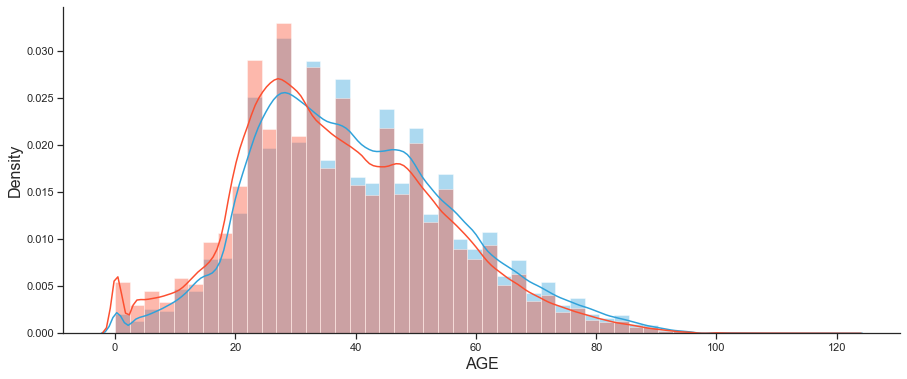

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt

df_positive = df7.loc[df7['target'] == 1]
df_negative = df7.loc[df7['target'] == 0]

five_thirty_eight = [
    '#30a2da',
    '#fc4f30',
    '#e5ae38',
    '#6d904f',
    '#8b8b8b',
]

plt.figure(figsize = (15,6))
plt.rcParams['axes.titlesize'] = 20
plt.rcParams['axes.labelsize'] = 16
plt.rcParams['axes.titlesize'] = 16

sns.set_palette(sns.color_palette(five_thirty_eight))

sns.distplot(df_positive['AGE'])
sns.distplot(df_negative['AGE'])

sns.set(style='ticks')
sns.despine()

### 3.1.4 Class imbalance for each feature 📊

<Figure size 432x288 with 0 Axes>

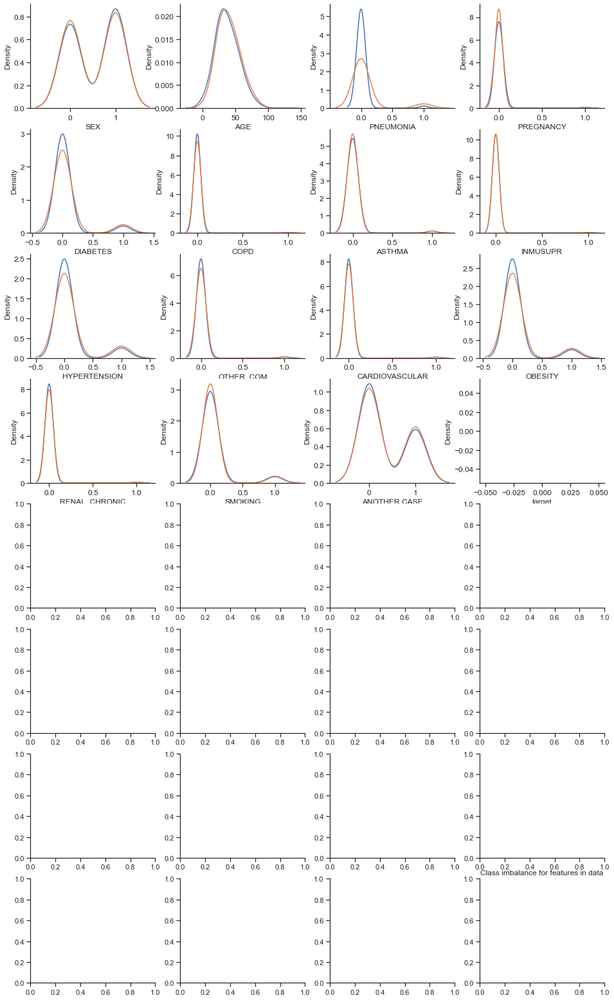

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt

five_thirty_eight = [
    '#30a2da',
    '#fc4f30',
    '#e5ae38',
    '#6d904f',
    '#8b8b8b',
]
    
var = df7.columns.values

i = 0
t0 = df7.loc[df7['target'] == 0]
t1 = df7.loc[df7['target'] == 1]

plt.figure()
fig, ax = plt.subplots(8,4,figsize=(16,28))
plt.title('Class imbalance for features in data')

for feature in var:
    i += 1
    plt.subplot(8,4,i)
    sns.kdeplot(t0[feature], bw=0.5, label="Negative = 0")
    sns.kdeplot(t1[feature], bw=0.5, label="Positive = 1")
    sns.set_palette(sns.color_palette(five_thirty_eight))
    sns.set(style='ticks')
    sns.despine()
    plt.xlabel(feature, fontsize=12)
    locs, labels = plt.xticks()
    plt.tick_params(axis='both', which='major', labelsize=12)
plt.show();

ValueError: num must be 1 <= num <= 15, not 16

<Figure size 432x288 with 0 Axes>

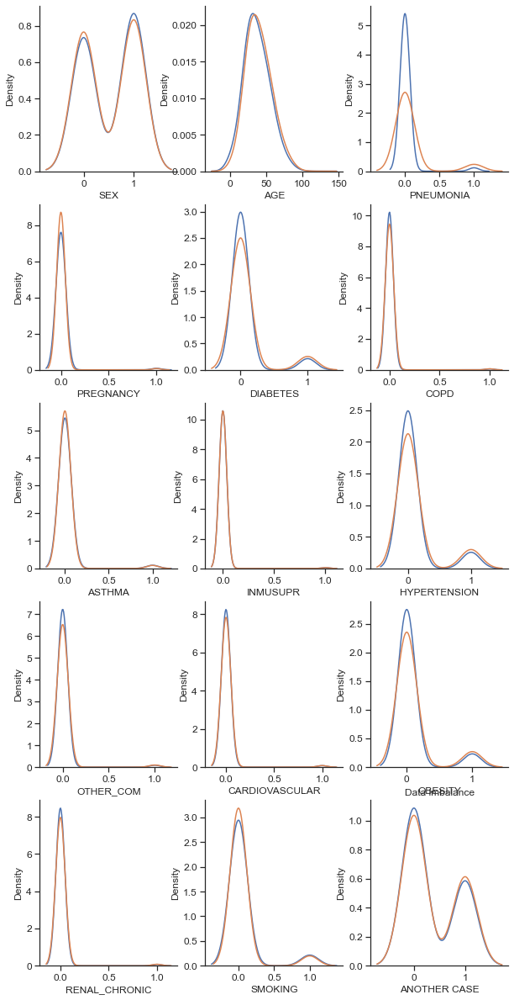

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt

five_thirty_eight = [
    '#30a2da',
    '#fc4f30',
    '#e5ae38',
    '#6d904f',
    '#8b8b8b',
]
    
var = df7.columns.values

i = 0
t0 = df7.loc[df7['target'] == 0]
t1 = df7.loc[df7['target'] == 1]

plt.figure()
fig, ax = plt.subplots(5,3,figsize=(10,21))
plt.title('Data imbalance')

for feature in var:
    i += 1
    plt.subplot(5,3,i)
    sns.kdeplot(t0[feature], bw=0.5, label="Negative = 0")
    sns.kdeplot(t1[feature], bw=0.5, label="Positive = 1")
    sns.set_palette(sns.color_palette("Paired"))
    sns.set(style='ticks')
    sns.despine()
    plt.xlabel(feature, fontsize=12)
    locs, labels = plt.xticks()
    plt.tick_params(axis='both', which='major', labelsize=12)
plt.show();


fig.savefig("imbalance2.png")

In [ ]:
from imblearn.over_sampling import SMOTE
sm = SMOTE(random_state = 42)
X_train_oversampled, y_train_oversampled = sm.fit_sample(X_train, y_train)

AttributeError: 'SMOTE' object has no attribute 'fit_sample'

In [ ]:
df7.target.value_counts(normalize=True).round(3)

0    0.621
1    0.379
Name: target, dtype: float64

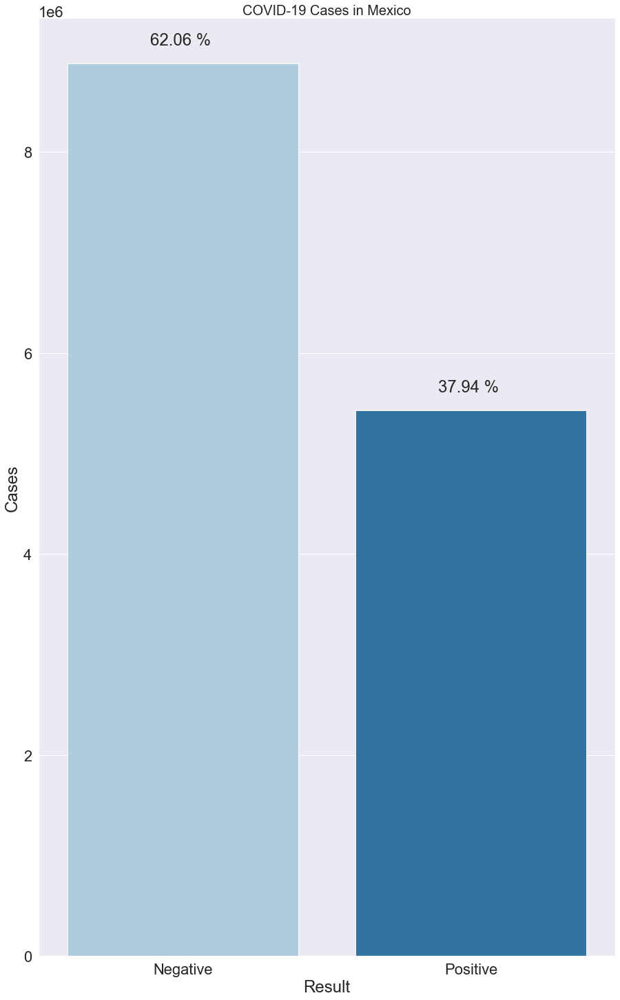

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt
plt.figure(figsize = (15,25))
plt.rcParams['axes.titlesize'] = 50
plt.rcParams['axes.labelsize'] = 25
plt.rcParams['axes.titlesize'] = 40
sns.set(font_scale=2)
sns.set_palette(sns.color_palette("Paired"))
total = float(len(df7))
results = ['Negative', 'Positive']  
ax = sns.countplot(x='target', data=df7)
ax.set_xticklabels(results)
for p in ax.patches:
    height = p.get_height()
    ax.text(p.get_x() + p.get_width()/2.,
            p.get_height(),
            '{:1.2f} % \n'.format(height/total*100),
            ha='center')
    
plt.title('COVID-19 Cases in Mexico', fontsize=20)
plt.xlabel('Result')
plt.ylabel('Cases')
sns.set(style='ticks')
sns.despine()
fig = ax.get_figure()
fig.savefig("imbalance.png") 

In [ ]:
from sklearn.model_selection import train_test_split
X = df7.drop('target',axis=1)
y = df7.target
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)
from sklearn import preprocessing
normalized_X = preprocessing.normalize(X)
nx_train,nx_test,ny_train, ny_test=train_test_split(normalized_X, y, test_size=0.2, random_state=42)
standardized_X = preprocessing.scale(X)
sx_train,sx_test,sy_train, sy_test=train_test_split(standardized_X, y, test_size=0.2, random_state=42)

In [ ]:
from imblearn.over_sampling import SMOTE
sm = SMOTE(random_state = 42)
X_train_oversampled, y_train_oversampled = sm.fit_sample(X_train, y_train)

AttributeError: 'SMOTE' object has no attribute 'fit_sample'

In [ ]:
oversample= BorderlineSMOTE()
X,y= oversample.fit_resample(X,y)

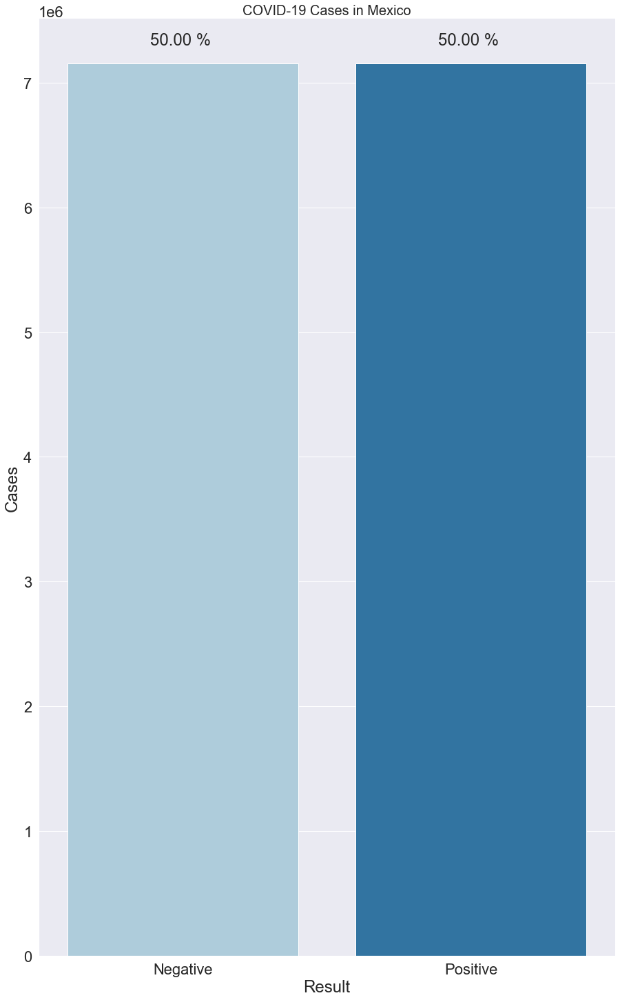

In [ ]:

plt.figure(figsize = (15,25))

plt.rcParams['axes.titlesize'] = 50
plt.rcParams['axes.labelsize'] = 25
plt.rcParams['axes.titlesize'] = 40

# five_thirty_eight = [
#     '#30a2da',
#     '#fc4f30',
#     '#e5ae38',
#     '#6d904f',
#     '#8b8b8b',
# ]
sns.set(font_scale=2)

sns.set_palette(sns.color_palette("Paired"))

total = float(len(df10))
results = ['Negative', 'Positive']  
ax = sns.countplot(x='target', data=df10)
ax.set_xticklabels(results)

# add percentages above each bar
for p in ax.patches:
    height = p.get_height()
    ax.text(p.get_x() + p.get_width()/2.,
            p.get_height(),
            '{:1.2f} % \n'.format(height/total*100),
            ha='center')
    
plt.title('COVID-19 Cases in Mexico', fontsize=20)
plt.xlabel('Result')
plt.ylabel('Cases')

sns.set(style='ticks')
sns.despine()



fig = ax.get_figure()
fig.savefig("balance.png") 


In [ ]:
oversample= BorderlineSMOTE()
nX,ny= oversample.fit_resample(normalized_X, y)

In [ ]:
oversample= BorderlineSMOTE()
sX,sy= oversample.fit_resample(standardized_X, y)

In [ ]:
early_stopping = EarlyStopping()
custom_early_stopping = EarlyStopping(
    monitor='accuracy', 
    patience=1000, 
    min_delta=0.0001, 
    mode='max'
)
model = Sequential()
model.add(Dense(50, input_dim=24, activation='relu'))
model.add(Dense(100, activation='relu'))
model.add(Dense(150, activation='relu'))
model.add(Dense(1, activation='sigmoid'))
model.compile(loss='binary_crossentropy', optimizer='sgd', metrics=['accuracy'])
history = model.fit(X_train, y_train, epochs=500000, batch_size=32,callbacks=[custom_early_stopping])

In [ ]:
def evaluate_model(model, x_train, y_train, x_test, y_test):
    model = model.fit(x_train, y_train)
    predict_train_y = model.predict(x_train)
    predict_test_y = model.predict(x_test)
    print("Accuracy Score")
    train_accuracy = accuracy_score(y_train, predict_train_y)
    test_accuracy = accuracy_score(y_test, predict_test_y)
    print("Train Accuracy is: %s"%(train_accuracy))
    print("\nTest Accuracy is: %s"%(test_accuracy))
    print("Accuracy Error")
    train_error = (1-train_accuracy)
    test_error = (1-test_accuracy)
    print("Train Error: %s"%(train_error))
    print("\nTest Error: %s"%(test_error))
    print("Classification Report")
    train_cf_report = pd.DataFrame(classification_report(y_train, predict_train_y, output_dict = True))
    test_cf_report = pd.DataFrame(classification_report(y_test, predict_test_y, output_dict = True))
    print("Train Classification Report:")
    print(train_cf_report)
    print("Test Classification Report:")
    print(test_cf_report)

In [ ]:
from keras.models import Sequential 
from keras.layers import Dense
from keras.layers import Dropout
from keras import regularizers
from keras.layers import LeakyReLU

In [ ]:
nx_train

array([[0.23399657, 0.23399657, 0.        , ..., 0.        , 0.        ,
        0.00866654],
       [0.10495725, 0.10495725, 0.        , ..., 0.        , 0.        ,
        0.00954157],
       [0.05315292, 0.05315292, 0.        , ..., 0.        , 0.        ,
        0.65776738],
       ...,
       [0.1161744 , 0.1161744 , 0.        , ..., 0.        , 0.        ,
        0.01548992],
       [0.23382097, 0.23382097, 0.        , ..., 0.        , 0.        ,
        0.0167015 ],
       [0.18063114, 0.18063114, 0.        , ..., 0.        , 0.        ,
        0.01204208]])

In [ ]:
model = Sequential()
model.add(Dense(50, input_dim=24, activation='relu'))
model.add(Dense(100, activation='relu'))
model.add(Dense(150, activation='relu'))
model.add(Dense(1, activation='sigmoid'))
model.compile(loss='binary_crossentropy', optimizer='sgd', metrics=['accuracy'])
history = model.fit(nx_train, ny_train, epochs=10000, batch_size=32)

In [ ]:
filename = 'models/model_1' + '.h5'
model.save(filename)
print('>Saved %s' % filename)

>Saved models/model_1.h5


In [ ]:
from sklearn.preprocessing import StandardScaler
X1 = df9.drop("target", axis=1)
y1 = df9["target"]
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
x_train1, x_test1, y_train1, y_test1 = train_test_split(X1, y1, test_size=0.3,random_state=44, shuffle =True)

In [ ]:
forest = RandomForestClassifier(max_samples=0.01)
forest.fit(x_train1, y_train1)
ypred_tr = forest.predict(x_train1)
ypred_ts = forest.predict(x_test1)
print("Training Results:\n")
print(classification_report(y_train1, ypred_tr))
print("\n\nTesting Results:\n")
print(classification_report(y_test1, ypred_ts))

Training Results:

              precision    recall  f1-score   support

           0       0.80      0.94      0.86     10016
           1       0.63      0.29      0.40      3394

    accuracy                           0.78     13410
   macro avg       0.71      0.62      0.63     13410
weighted avg       0.75      0.78      0.75     13410



Testing Results:

              precision    recall  f1-score   support

           0       0.80      0.94      0.86      4365
           1       0.58      0.26      0.36      1383

    accuracy                           0.78      5748
   macro avg       0.69      0.60      0.61      5748
weighted avg       0.75      0.78      0.74      5748



In [ ]:
from sklearn.linear_model import LogisticRegression
logistic_regression = LogisticRegression()
logistic_regression.fit(X_train,y_train)
y_predtr = logistic_regression.predict(X_test)
y_predts = logistic_regression.predict(X_test)
print("Training Results:\n")
print(classification_report(y_train, y_predtr))
print("\n\nTesting Results:\n")
print(classification_report(y_test1, y_predts))

Training Results:

              precision    recall  f1-score   support

           0       0.79      0.95      0.86     10016
           1       0.64      0.24      0.35      3394

    accuracy                           0.77     13410
   macro avg       0.71      0.60      0.61     13410
weighted avg       0.75      0.77      0.73     13410



Testing Results:

              precision    recall  f1-score   support

           0       0.80      0.95      0.87      4365
           1       0.60      0.23      0.33      1383

    accuracy                           0.78      5748
   macro avg       0.70      0.59      0.60      5748
weighted avg       0.75      0.78      0.74      5748



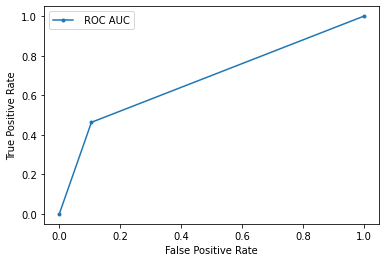

In [ ]:
lr_probs = y_predts
lr_auc = roc_auc_score(y_test, lr_probs)
lr_fpr, lr_tpr, _ = roc_curve(y_test, lr_probs)
plt.plot(lr_fpr, lr_tpr, marker='.', label=' ROC AUC')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.legend()
plt.show()

In [ ]:
def conf_plot(cf_matrix,title1):
    group_names = ['True Neg','False Pos','False Neg','True Pos']
    group_counts = ["{0:0.0f}".format(value) for value in
    cf_matrix.flatten()]
    group_percentages = ["{0:0.0%}".format(value) for value in
    cf_matrix.flatten()/np.sum(cf_matrix)]
    labels = [f"{v1}\n\n{v2}" for v1, v2 in
    zip(group_names,group_percentages)]
    labels = np.asarray(labels).reshape(2,2)
    ax = sns.heatmap(cf_matrix, annot=labels, fmt='', cmap='Blues')
    ax.set_title(title1+'\n');
    ax.set_xlabel('\nPredicted Values')
    ax.set_ylabel('Actual Values ');
    ax.xaxis.set_ticklabels(['False','True'])
    ax.yaxis.set_ticklabels(['False','True'])
    plt.plot()

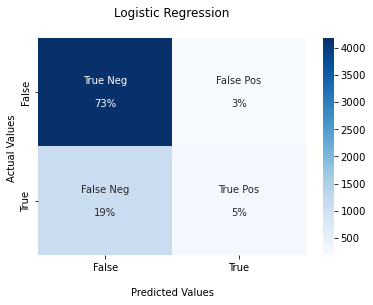

In [ ]:
cf=confusion_matrix(y_test, y_pred)
conf_plot(cf,'Logistic Regression')

In [ ]:
from sklearn.ensemble import RandomForestRegressor
regressor = RandomForestRegressor(n_estimators = 1000, random_state = 42)
regressor.fit(X_train, y_train)


RandomForestRegressor(n_estimators=1000, random_state=42)

[[27891  1808]
 [ 2136 27898]]
              precision    recall  f1-score   support

           0       0.93      0.94      0.93     29699
           1       0.94      0.93      0.93     30034

    accuracy                           0.93     59733
   macro avg       0.93      0.93      0.93     59733
weighted avg       0.93      0.93      0.93     59733



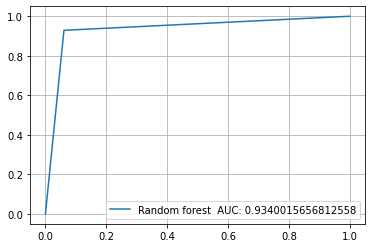

In [ ]:

clf = RandomForestClassifier(n_estimators = 100)  
clf.fit(X_train, y_train)
y_pred = clf.predict(X_test)
print(confusion_matrix(y_test, y_pred))
print(classification_report(y_test, y_pred))
fpr, tpr, _ = roc_curve(y_test,  y_pred)
auc = roc_auc_score(y_test, y_pred)
plt.plot(fpr,tpr,label='Random forest  AUC: '+str(auc))
plt.legend(loc=4)
plt.grid(True)
plt.show()

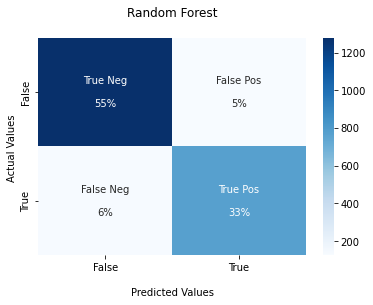

In [ ]:
cf=confusion_matrix(y_test, y_pred)
conf_plot(cf,'Random Forest')

In [ ]:
new_pipeline = Pipeline([ ('classifier', RandomForestClassifier(random_state=42))])

In [ ]:
rf_param_grid = [{
                'classifier': [RandomForestClassifier()],
                'classifier__n_estimators': np.arange(100,2000, 200),
                'classifier__max_depth': [None, 10, 20, 30, 50, 70, 80, 100],
                'classifier__min_samples_split': [2, 3, 5, 7, 10],
                'classifier__min_samples_leaf': [1,2,3,4,5,],
                'classifier__max_features': ['auto', 'sqrt', 'log2'],
                'classifier__bootstrap': [True, False]
               }]

In [ ]:
random_search = RandomizedSearchCV(estimator = new_pipeline, param_distributions = rf_param_grid, scoring = 'accuracy', n_jobs = -1, cv = 10, random_state = 42)

In [ ]:
best_rf_model = random_search.fit(X_train, y_train)

In [ ]:
best_rf_model.best_params_

{'classifier': RandomForestClassifier(max_depth=100, min_samples_leaf=3, min_samples_split=10),
 'classifier__bootstrap': True,
 'classifier__max_depth': 100,
 'classifier__max_features': 'auto',
 'classifier__min_samples_leaf': 3,
 'classifier__min_samples_split': 10,
 'classifier__n_estimators': 100}

In [ ]:
print("Best Score: %s" %(best_rf_model.best_score_))

Best Score: 0.9099959128860864


In [ ]:
model = Sequential()
model.add(Dense(50, input_dim=24, activation='relu'))
model.add(Dense(100, activation='relu'))
model.add(Dense(100, activation='relu'))
model.add(Dense(100, activation='relu'))
model.add(Dense(100, activation='relu'))
model.add(Dense(100, activation='relu'))
model.add(Dense(100, activation='relu'))
model.add(Dense(75, activation='relu'))
model.add(Dense(75, activation='relu'))
model.add(Dense(75, activation='relu'))
model.add(Dense(75, activation='relu'))
model.add(Dense(75, activation='relu'))
model.add(Dense(50, activation='relu'))
model.add(Dense(50, activation='relu'))
model.add(Dense(50, activation='relu'))
model.add(Dense(50, activation='relu'))
model.add(Dense(50, activation='relu'))
model.add(Dense(50, activation='relu'))
model.add(Dense(25, activation='relu'))
model.add(Dense(25, activation='relu'))
model.add(Dense(25, activation='relu'))
model.add(Dense(25, activation='relu'))
model.add(Dense(25, activation='relu'))
model.add(Dense(1, activation='sigmoid'))
model.compile(loss='binary_crossentropy', optimizer='adam', metrics=['accuracy'])
history = model.fit(X_train, y_train, epochs=20000, batch_size=32)

In [ ]:
filename = 'models/model_2' + '.h5'
ann=Sequential()
model.save(filename)
print('>Saved %s' % filename)

>Saved models/model_2.h5


In [ ]:
model = Sequential()
model.add(Dense(50, input_dim=24, activation='relu'))
model.add(Dense(100))
model.add(LeakyReLU(alpha=0.05))
model.add(Dense(150))
model.add(LeakyReLU(alpha=0.05))
model.add(Dense(1, activation='sigmoid'))
model.compile(loss='binary_crossentropy', optimizer='sgd', metrics=['accuracy'])
history = model.fit(X_train, y_train, epochs=200, batch_size=32)

In [ ]:
filename = 'models/model_3' + '.h5'
model.save(filename)
print('>Saved %s' % filename)

>Saved models/model_3.h5


In [ ]:
model = Sequential()
model.add(Dense(50, input_dim=24, activation='relu'))
model.add(Dense(100, activation='relu'))
model.add(Dense(150, activation='relu'))
model.add(Dense(1, activation='sigmoid'))
model.compile(loss='binary_crossentropy', optimizer='adam', metrics=['accuracy'])
history = model.fit(X_train, y_train, epochs=200, batch_size=32)

In [ ]:
filename = 'models/model_4' + '.h5'
model.save(filename)
print('>Saved %s' % filename)

>Saved models/model_4.h5


In [ ]:

def load_all_models(n_models):
	all_models = list()
	for i in range(n_models):
		filename = 'models/model_' + str(i + 1) + '.h5'
		model = load_model(filename)
		all_models.append(model)
		print('>loaded %s' % filename)
	return all_models
def stacked_dataset(members, inputX):
	stackX = None
	for model in members:
		# make prediction
		yhat = model.predict(inputX, verbose=0)
		if stackX is None:
			stackX = yhat
		else:
			stackX = dstack((stackX, yhat))
	stackX = stackX.reshape((stackX.shape[0], stackX.shape[1]*stackX.shape[2]))
	return stackX

def fit_stacked_model(members, inputX, inputy,col):
	stackedX = stacked_dataset(members, inputX)
	model = LogisticRegression()
	ann=model.fit(stackedX, inputy)
	result_tbl.iloc[0,col] = model.score(stackedX, inputy)
	col += 1
	return model
def stacked_prediction(members, model, inputX):
	stackedX = stacked_dataset(members, inputX)
	yhat = model.predict(stackedX)
	return yhat
col = 0
n_members = 4
members = load_all_models(n_members)
print('Loaded %d models' % len(members))
for model in members:
	testy_enc = to_categorical(y)
	_, acc = model.evaluate(X, y, verbose=0)

>loaded models/model_1.h5
>loaded models/model_2.h5
>loaded models/model_3.h5
>loaded models/model_4.h5


In [ ]:
evaluate_model(ann, X_train, y_train, X_test, y_test)

Accuracy Score
Train Accuracy is: 0.8626119618607339

Test Accuracy is: 0.8639514731369151
Accuracy Error
Train Error: 0.13738803813926614

Test Error: 0.13604852686308488
Classification Report
Train Classification Report:
                     0            1  accuracy    macro avg  weighted avg
precision     0.836205     0.928105  0.862612     0.882155      0.871441
recall        0.966495     0.695554  0.862612     0.831024      0.862612
f1-score      0.896642     0.795176  0.862612     0.845909      0.857738
support    4268.000000  2654.000000  0.862612  6922.000000   6922.000000
Test Classification Report:
                     0           1  accuracy    macro avg  weighted avg
precision     0.836005    0.930029  0.863951     0.883017      0.872832
recall        0.965812    0.705752  0.863951     0.835782      0.863951
f1-score      0.896233    0.802516  0.863951     0.849374      0.859526
support    1404.000000  904.000000  0.863951  2308.000000   2308.000000


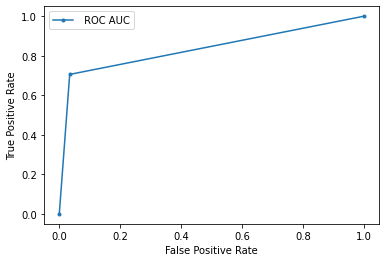

In [ ]:
ann.fit(X_train,y_train)
ann_predict_test = ann.predict(X_test)
lr_probs = ann_predict_test
lr_auc = roc_auc_score(y_test, lr_probs)
lr_fpr, lr_tpr, _ = roc_curve(y_test, lr_probs)
plt.plot(lr_fpr, lr_tpr, marker='.', label=' ROC AUC')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.legend()
plt.show()

In [ ]:
def check_metric(y_test, y_predict):
    print("Accuracy Score")
    test_accuracy = accuracy_score(y_test, y_predict)
    print("est Accuracy is: %s"%(test_accuracy))
    print("Accuracy Error")
    test_error = (1-test_accuracy)
    print("Test Error: %s"%(test_error))
    print("Classification Report")
    test_cf_report = pd.DataFrame(classification_report(y_test, y_predict, output_dict = True))
    print("Test Classification Report:")
    print(test_cf_report)
    

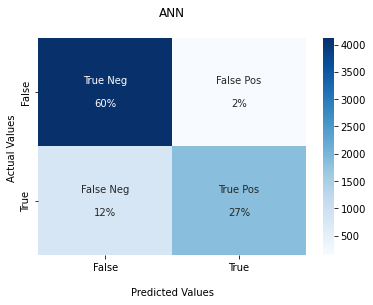

In [ ]:
cf=confusion_matrix(y_test, y_pred)
conf_plot(cf,'ANN')

In [ ]:
ada = AdaBoostClassifier(random_state = 42)
evaluate_model(ada, X_train, y_train, X_test, y_test)

Accuracy Score
Train Accuracy is: 0.9040739670615429

Test Accuracy is: 0.9042461005199307
Accuracy Error
Train Error: 0.09592603293845714

Test Error: 0.0957538994800693
Classification Report
Train Classification Report:
                     0            1  accuracy    macro avg  weighted avg
precision     0.913303     0.888368  0.904074     0.900836      0.903743
recall        0.932990     0.857573  0.904074     0.895282      0.904074
f1-score      0.923041     0.872699  0.904074     0.897870      0.903739
support    4268.000000  2654.000000  0.904074  6922.000000   6922.000000
Test Classification Report:
                     0           1  accuracy    macro avg  weighted avg
precision     0.912770    0.890286  0.904246     0.901528      0.903964
recall        0.931624    0.861726  0.904246     0.896675      0.904246
f1-score      0.922101    0.875773  0.904246     0.898937      0.903955
support    1404.000000  904.000000  0.904246  2308.000000   2308.000000


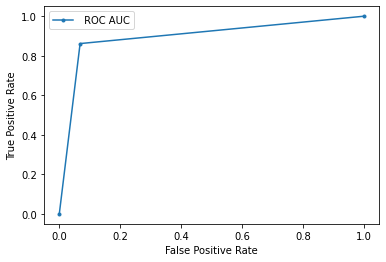

In [ ]:
ada.fit(X_train,y_train)
ada_predict_test = ada.predict(X_test)
lr_probs = ann_predict_test
lr_auc = roc_auc_score(y_test, lr_probs)
lr_fpr, lr_tpr, _ = roc_curve(y_test, lr_probs)
plt.plot(lr_fpr, lr_tpr, marker='.', label=' ROC AUC')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.legend()
plt.show()

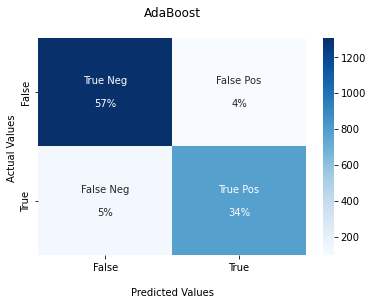

In [ ]:
cf=confusion_matrix(y_test, y_pred)
conf_plot(cf,'AdaBoost')

In [ ]:
xgb = XGBClassifier(random_state=42, silent = True)
xgb_test_prediction = xgb.predict(X_test)

In [ ]:
check_metric(y_test, xgb_test_prediction)

Accuracy Score
est Accuracy is: 0.9202772963604853
Accuracy Error
Test Error: 0.07972270363951472
Classification Report
Test Classification Report:
                     0           1  accuracy    macro avg  weighted avg
precision     0.915531    0.928571  0.920277     0.922051      0.920639
recall        0.957265    0.862832  0.920277     0.910048      0.920277
f1-score      0.935933    0.894495  0.920277     0.915214      0.919703
support    1404.000000  904.000000  0.920277  2308.000000   2308.000000


In [ ]:
xgboost_params = [{
    'classifier': [XGBClassifier()],
    'classifier__iterations': [10],
    'classifier__learning_rate': [0.0001, 0.001, 0.003, 0.005, 0.01, 0.05, 0.1, 0.5, 1.0],
    'classifier__depth': [2,4,6,8,10,12],
    'classifier__l2_leaf_reg': [2,3,5,7,9,11,12,15,18,20,25,27],
    'classifier__random_strength': [1],
    'classifier__border_count': [50, 100, 150, 200, 254],
}]

In [ ]:
xgb_new_pipeline = Pipeline([ ('classifier', XGBClassifier(random_state=42, task_type = 'CPU', silent = True, eval_metric = 'accuracy'))])
xgb_random_search = RandomizedSearchCV(estimator = xgb_new_pipeline, param_distributions = xgboost_params, scoring = 'accuracy', n_jobs = -1, cv = 10, random_state = 42)
xgb_random_search.fit(X_train, y_train)
xgb_random_search.best_params_

{'classifier': <catboost.core.CatBoostClassifier at 0x7f468d15f410>,
 'classifier__border_count': 50,
 'classifier__depth': 10,
 'classifier__iterations': 10,
 'classifier__l2_leaf_reg': 7,
 'classifier__learning_rate': 0.5,
 'classifier__random_strength': 1}

In [ ]:
xgb_random_search.best_score_

0.9088394264694843

In [ ]:
xgboost_model = XGBClassifier(random_strength=1, learning_rate=0.5, l2_leaf_reg=7, iterations=10, depth=10, border_count=50, 
                                    silent = True, eval_metric='Accuracy', task_type='CPU')

In [ ]:
evaluate_model(xgboost_model, X_train, y_train, X_test, y_test)

Accuracy Score
Train Accuracy is: 0.9422132331696041

Test Accuracy is: 0.9207105719237435
Accuracy Error
Train Error: 0.05778676683039585

Test Error: 0.0792894280762565
Classification Report
Train Classification Report:
                     0            1  accuracy    macro avg  weighted avg
precision     0.936766     0.951885  0.942213     0.944325      0.942563
recall        0.971884     0.894499  0.942213     0.933191      0.942213
f1-score      0.954002     0.922300  0.942213     0.938151      0.941847
support    4268.000000  2654.000000  0.942213  6922.000000   6922.000000
Test Classification Report:
                     0           1  accuracy    macro avg  weighted avg
precision     0.920744    0.920653  0.920711     0.920699      0.920709
recall        0.951567    0.872788  0.920711     0.912177      0.920711
f1-score      0.935902    0.896082  0.920711     0.915992      0.920305
support    1404.000000  904.000000  0.920711  2308.000000   2308.000000


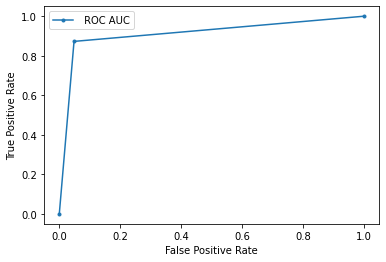

In [ ]:
xgb.fit(X_train,y_train)

xgb_predict_test = xgb.predict(X_test)
lr_probs = xgb_predict_test
lr_auc = roc_auc_score(y_test, lr_probs)
lr_fpr, lr_tpr, _ = roc_curve(y_test, lr_probs)
plt.plot(lr_fpr, lr_tpr, marker='.', label=' ROC AUC')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.legend()
plt.show()

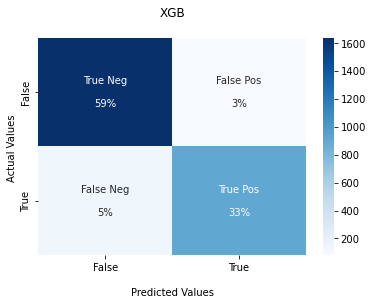

In [ ]:
cf=confusion_matrix(y_test, y_pred)
conf_plot(cf,'XGB')

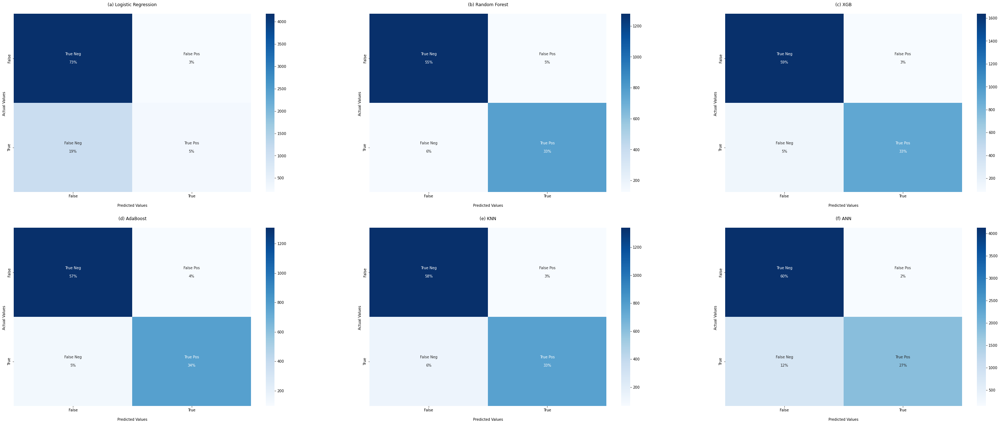

In [ ]:
fig, axes = plt.subplots(2, 3, figsize=(50, 20))
plt.subplot(231)
conf_plot(m1,'(a) Logistic Regression')
plt.subplot(232)
conf_plot(m2,'(b) Random Forest')
plt.subplot(233)
conf_plot(m3,'(c) XGB')
plt.subplot(234)
conf_plot(m4,'(d) AdaBoost')
plt.subplot(235)
conf_plot(m5,'(e) KNN')
plt.subplot(236)
conf_plot(m6,'(f) ANN')

fig.savefig("confusion_matrix.png", bbox_inches='tight', dpi=800)

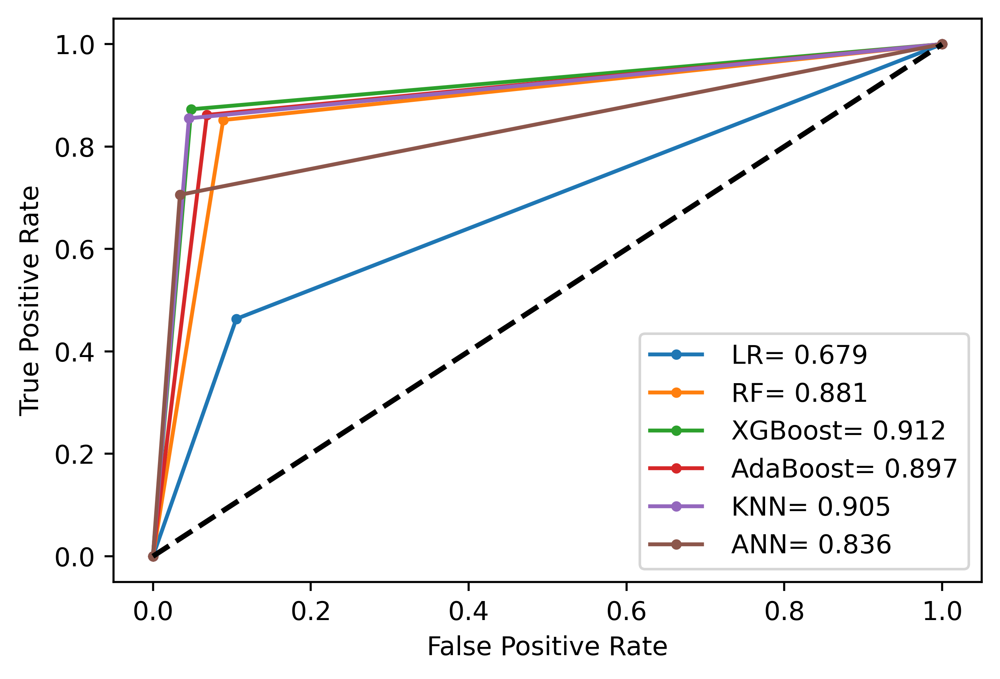

In [ ]:
from sklearn import metrics
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image
import io
from io import BytesIO
fig=plt.figure(0, dpi=500).clf()
lw = 2
lr = LogisticRegressionClassifier(random_state= 21)
lr.fit(x_train1,y_train1)
rf_predict_test = lr.predict(x_test1)
lr_probs = rf_predict_test
lr_auc = roc_auc_score(y_test1, lr_probs)
lr_fpr, lr_tpr, _ = roc_curve(y_test1, lr_probs)
plt.plot(lr_fpr, lr_tpr, marker='.', label=' LR= '+str(lr_auc.round(3)))
rf.fit(x_train,y_train)
rf_predict_test = rf.predict(x_test)
lr_probs = rf_predict_test
lr_auc = roc_auc_score(y_test, lr_probs)
lr_fpr, lr_tpr, _ = roc_curve(y_test, lr_probs)
plt.plot(lr_fpr, lr_tpr, marker='.', label=' RF= '+str(lr_auc.round(3)))
xgb.fit(x_train,y_train)
xgb_predict_test = xgb.predict(x_test)
lr_probs = xgb_predict_test
lr_auc = roc_auc_score(y_test, lr_probs)
lr_fpr, lr_tpr, _ = roc_curve(y_test, lr_probs)
plt.plot(lr_fpr, lr_tpr, marker='.', label=' XGBoost= '+str(lr_auc.round(3)))
ada.fit(x_train,y_train)
ada_predict_test = ada.predict(x_test)
lr_probs = ada_predict_test
lr_auc = roc_auc_score(y_test, lr_probs)
lr_fpr, lr_tpr, _ = roc_curve(y_test, lr_probs)
plt.plot(lr_fpr, lr_tpr, marker='.', label=' AdaBoost= '+str(lr_auc.round(3)))
knn_predict_test = KNN.predict(x_test)
lr_probs = knn_predict_test
lr_auc = roc_auc_score(y_test, lr_probs)
lr_fpr, lr_tpr, _ = roc_curve(y_test, lr_probs)
plt.plot(lr_fpr, lr_tpr, marker='.', label=' KNN= '+str(lr_auc.round(3)))
ann.fit(x_train,y_train)
ann_predict_test = ann.predict(x_test)
lr_probs = ann_predict_test
lr_auc = roc_auc_score(y_test, lr_probs)
lr_fpr, lr_tpr, _ = roc_curve(y_test, lr_probs)
plt.plot(lr_fpr, lr_tpr, marker='.', label=' ANN= '+str(lr_auc.round(3)))
plt.plot([0, 1], [0, 1], color="black", lw=lw, linestyle="--")
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.legend()
plt.show()
fig.savefig("roc_auc_curve.png", bbox_inches='tight', dpi=800)
png1 = BytesIO()
fig.savefig(png1, format='png')
png2 = Image.open(png1)
png2.save('ROCAUC.tiff')
png1.close()